# REINFORCEMENT LEARNING: 
# OpenAI Lunar Lander

In this notebook, we will be attempting to solve OpenAI's LunarLander game by using Tensorflow agents and multiple Reinforcement Learning models.

These models include:
- Deep Q Network (DQN)
- Deep Double Q Network
- Dueling Deep Q Network
- Dueling Deep Double Q Network
- Deep Deterministic Policy Gradients Network (DDPG)
- SARSA

### Introduction To OpenAI's LunarLander-v2

<br> __About LunarLander-v2__ <br><br>
LunarLander-v2 is a reinforcement learning environment developed by OpenAI. The objective of the game is to land a lunar lander spacecraft on a designated landing pad on the surface of the moon. The lander is controlled by applying thrust to its engines in four different directions: left, right, down, and up. The environment is simulated and the lander is subject to the laws of physics, including gravity and the thrust of the engines.

The game is designed to be a challenging test of an agent's ability to learn and make decisions in a complex, dynamic environment. The lander must navigate through a rocky, uneven terrain and avoid obstacles while also controlling its descent to the landing pad. The lander has a limited amount of fuel, and the game ends when the lander crashes or successfully lands on the pad.

The game is implemented using the OpenAI Gym, a toolkit for developing and comparing reinforcement learning algorithms. The game state is represented by a number of variables including the lander's position, velocity, fuel level, and angle. The agent's actions are represented by the thrust applied to the engines in each direction. The agent receives a reward for each successful landing, and a penalty for crashing or using too much fuel. The agent's goal is to learn a policy, a mapping of states to actions, that maximizes the expected reward over time. <br><br>

<i>The LunarLander-v2 Environment is:<i>
- __Fully Observable__ :
All necessary state information is known observed at every frame.

- __Single Agent__: 
There is no competition nor cooperation

- __Deterministic__:
There is no stochasticity in the effects of actions or rewards obtained

- __Episodic__:
Reward is dependent only on current state and action

- __Discrete Action Space__:
Only 4 Actions: Thrust, Left, Right, Nothing

- __Static__:
There is no prenalty or state change during action deliberation

- __Finite Horizon__:
Episode terminates after a successful land, crash or set number of steps

- __Mixed Observation Space__:
    - X Distance From Target Site
    - Y Distance From Target Site
    - X Velocity
    - Y Velocity
    - Angle Of Ship
    - Angular Velocity Of Ship
    - Left Leg Is Grounded
    - Right Leg Is Grounded
    
### ‎
Finally, after each step a reward is granted. <br>
The total reward of an episode is the sum of the rewards for all steps within that episode.<br><br>
__Reward System__:
- Moving from top of screen to landing pad with 0 speed: + 100-140 pts
- Lander moves away from landing pad: - same reward as moving same distance towards the pad
- Crashing/Landing: +/- 100 pts
- Grounding Each Leg: + 10 pts
- Thrusting Main Engine: - 0.3 pts

<br>
A score of 200 or more is considered a solution.
    
### ‎
__Evaluation Of RL Model Performance__: <br>
There are multiple ways to assess and evaluate the performance of a RL model: <br>
- score
- average score
- success/crash rate
- fuel consumption
- number of episodes required 

## Deep Q Network (DQN)

In [2]:
import gym
import random
from keras import Sequential
from collections import deque
from keras.layers import Dense
from keras.optimizers import Adam
import matplotlib.pyplot as plt
from keras.activations import relu, linear

import numpy as np
env = gym.make('LunarLander-v2')
env.seed(0)
np.random.seed(0)


class DQN:
    
    def __init__(self, action_space, state_space):

        self.action_space = action_space
        self.state_space = state_space
        self.epsilon = 1.0
        self.gamma = .99
        self.batch_size = 64
        self.epsilon_min = .01
        self.lr = 0.001
        self.epsilon_decay = .996
        self.memory = deque(maxlen=1000000)
        self.model = self.build_model()

    def build_model(self):
        model = Sequential()
        model.add(Dense(150, input_dim=self.state_space, activation=relu))
        model.add(Dense(120, activation=relu))
        model.add(Dense(self.action_space, activation=linear))
        model.compile(loss='mse', optimizer=Adam(lr=self.lr))
        return model

    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action, reward, next_state, done))

    def act(self, state):
        if np.random.rand() <= self.epsilon:
            return random.randrange(self.action_space)
        act_values = self.model.predict(state)
        return np.argmax(act_values[0])

    def replay(self):
        if len(self.memory) < self.batch_size:
            return

        minibatch = random.sample(self.memory, self.batch_size)
        states = np.array([i[0] for i in minibatch])
        actions = np.array([i[1] for i in minibatch])
        rewards = np.array([i[2] for i in minibatch])
        next_states = np.array([i[3] for i in minibatch])
        dones = np.array([i[4] for i in minibatch])

        states = np.squeeze(states)
        next_states = np.squeeze(next_states)

        targets = rewards + self.gamma*(np.amax(self.model.predict_on_batch(next_states), axis=1))*(1-dones)
        targets_full = self.model.predict_on_batch(states)
        ind = np.array([i for i in range(self.batch_size)])
        targets_full[[ind], [actions]] = targets

        self.model.fit(states, targets_full, epochs=1, verbose=0)
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay


def train_dqn(episode):
    score, score_array, fuel_array = [], [], []
    successCount = 0
    agent = DQN(env.action_space.n, env.observation_space.shape[0])
    for e in range(episode):
        state = env.reset()
        state = np.reshape(state, (1, 8))
        score = 0
        max_steps = 3000
        for i in range(max_steps):
            action = agent.act(state)
            env.render()
            next_state, reward, done, _ = env.step(action)
            score += reward
            next_state = np.reshape(next_state, (1, 8))
            agent.remember(state, action, reward, next_state, done)
            state = next_state
            agent.replay()
            if done:
                print("episode: {}/{}, score: {}".format(e, episode, score))
                break
        score.append(score)
        if score >= 200:
            successCount += 1

        # Average score of last 100 episode
        is_solved = np.mean(score[-100:])
        score_array.append(is_solved)
        if is_solved > 200:
            print('\n Task Completed! \n')
            break
        print("Average over last 100 episode: {0:.2f} \n".format(is_solved))
    return score, successCount, fuel_array


if __name__ == '__main__':

    print(env.observation_space)
    print(env.action_space)
    episodes = 400
    score, successCount = train_dqn(episodes)
    plt.plot([i+1 for i in range(0, len(loss), 2)], loss[::2])
    plt.show()

Box(-inf, inf, (8,), float32)
Discrete(4)


Exception ignored in: <function Viewer.__del__ at 0x000001CB1F5BDE50>
Traceback (most recent call last):
  File "C:\Users\rutsm\anaconda3\envs\dele_env\lib\site-packages\gym\envs\classic_control\rendering.py", line 165, in __del__
    self.close()
  File "C:\Users\rutsm\anaconda3\envs\dele_env\lib\site-packages\gym\envs\classic_control\rendering.py", line 83, in close
    self.window.close()
  File "C:\Users\rutsm\anaconda3\envs\dele_env\lib\site-packages\pyglet\window\win32\__init__.py", line 299, in close
    super(Win32Window, self).close()
  File "C:\Users\rutsm\anaconda3\envs\dele_env\lib\site-packages\pyglet\window\__init__.py", line 823, in close
    app.windows.remove(self)
  File "C:\Users\rutsm\anaconda3\envs\dele_env\lib\_weakrefset.py", line 109, in remove
    self.data.remove(ref(item))
KeyError: <weakref at 0x000001CB1F56FDB0; to 'Win32Window' at 0x000001CB0F76BA00>


1/1 [==============================] - 0s 13ms/step
episode: 0/400, score: -448.85015340410496


AttributeError: 'numpy.float64' object has no attribute 'append'

## Deep Double Deep Q Network

In [ ]:
import numpy as np
import gym
from keras.layers import Dense, Activation
from keras.models import Sequential, load_model
import keras
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

!pip3 install box2d-py
!pip3 install gym[Box_2D]

env = gym.make('LunarLander-v2')

class replayBuffer:
    def __init__(self,maxSize,stateDim):
        self.state=np.zeros((maxSize,stateDim))
        self.action=np.zeros(maxSize,dtype= np.int8)
        self.reward=np.zeros(maxSize)
        self.done=np.zeros(maxSize,)
        self.nextState=np.zeros((maxSize,stateDim))
        self.maxSize=maxSize
        self.curser=0
        self.size=0

    def save(self,state,action,reward,nextState,done):
        self.state[self.curser]=state
        self.action[self.curser]=action
        self.reward[self.curser]=reward
        self.nextState[self.curser]=nextState
        self.done[self.curser]=done
        self.curser=(self.curser+1)%self.maxSize
        if self.size<self.maxSize:
            self.size+=1 

    def sample(self,batchSize):
        batchSize=min(self.size,batchSize-1)
        indexes=np.random.choice([i for i in range(self.size-1)],batchSize)
        return self.state[indexes],self.action[indexes],self.reward[indexes],self.nextState[indexes],self.done[indexes]

class Agent:
    def __init__(self,stateShape,actionShape,exploreRate,exploreRateDecay,minimumExploreRate,gamma,copyNetsCycle):
        self.gamma=gamma
        self.exploreRate=exploreRate
        self.exploreRateDecay=exploreRateDecay
        self.minimumExploreRate=minimumExploreRate
        self.actionShape=actionShape
        self.memory=replayBuffer(1000000,stateShape)
        self.model=self.buildModel(stateShape,actionShape)
        self.model.compile(optimizer='Adam',loss='mse')
        self.tModel=self.buildModel(stateShape,actionShape)
        self.tModel.compile(optimizer='Adam',loss='mse')
        self.learnThreshold=0
        self.copyNetsCycle=copyNetsCycle

    def buildModel(self,input,output):
        inputLayer=keras.Input(shape=(input,))
        layer=Dense(256,activation='relu')(inputLayer)
        layer=Dense(256,activation='relu')(layer)
        outputLayer=Dense(output)(layer)
        model=keras.Model(inputs=inputLayer,outputs=outputLayer)
        model.compile(optimizer='Adam',loss='mse')
        return model
    
    def getAction(self,state):
        q=self.model.predict(np.expand_dims(state,axis=0))[0]
        if np.random.random()<=self.exploreRate:
            return np.random.choice([i for i in range(env.action_space.n)])
        else:
            return np.argmax(q)

    def exploreDecay(self):
        self.exploreRate=max(self.exploreRate*self.exploreRateDecay,self.minimumExploreRate)

    def saveModel(self,modelName="DoubleDQN_LunarLanderV2.h"):
        self.model.save_weights(f"{modelName}")

    def loadModel(self,modelName="DoubleDQN_LunarLanderV2.h"):
        self.model.load_weights(f"{modelName}")
        self.tModel.set_weights(self.model.get_weights())
    
    def learn(self,batchSize=64):
        if self.memory.size>batchSize:
            states,actions,rewards,nextStates,done=self.memory.sample(batchSize)
            qState=self.model.predict(states)
            qNextState=self.model.predict(nextStates)
            qNextStateTarget=self.tModel.predict(nextStates)
            maxActions=np.argmax(qNextState,axis=1)
            batchIndex = np.arange(batchSize-1, dtype=np.int32)
            qState[batchIndex,actions]=(rewards+(self.gamma*qNextStateTarget[batchIndex,maxActions.astype(int)]*(1-done)))
            _=self.model.fit(x=states,y=qState,verbose=0)
            self.learnThreshold+=1
            self.exploreDecay()
        if(self.learnThreshold%self.copyNetsCycle)==0:
            self.tModel.set_weights(self.model.get_weights())
            self.saveModel()
            self.learnThreshold=0

agent=Agent(stateShape=env.observation_space.shape[0],actionShape=env.action_space.n\
            ,exploreRate=1.0,exploreRateDecay=0.9995,minimumExploreRate=0.01,gamma=0.99,copyNetsCycle=100)
#agent.loadModel()

averageRewards, totalRewards, fuel_array = [], [], []
successCount = 0
for i in range(1,200):
    done=False
    state=env.reset()
    rewards=0
    while not done:
        action=agent.getAction(state)
        nextState,reward,done,info=env.step(action)
        agent.memory.save(state,action,reward,nextState,int(done))
        rewards+=reward
        state=nextState
        agent.learn(batchSize=128)
        if rewards >= 200:
            successCount += 1
        fuel_used = abs(action)
        fuel_array.append(fuel_used)
    totalRewards.append(rewards)
    averageRewards.append(sum(totalRewards)/len(totalRewards))
    print(f"episode: {i}   reward: {rewards}  avg so far:{averageRewards[-1]} exploreRate:{agent.exploreRate}")

  Using cached box2d-py-2.3.8.tar.gz (374 kB)
  Running setup.py clean for box2d-py
Failed to build box2d-py
    Running setup.py install for box2d-py: started
    Running setup.py install for box2d-py: finished with status 'error'


  ERROR: Command errored out with exit status 1:
   command: 'C:\Users\rutsm\anaconda3\python.exe' -u -c 'import io, os, sys, setuptools, tokenize; sys.argv[0] = '"'"'C:\\Users\\rutsm\\AppData\\Local\\Temp\\pip-install-tadndq0f\\box2d-py_2544913377694740b49e4125797a190c\\setup.py'"'"'; __file__='"'"'C:\\Users\\rutsm\\AppData\\Local\\Temp\\pip-install-tadndq0f\\box2d-py_2544913377694740b49e4125797a190c\\setup.py'"'"';f = getattr(tokenize, '"'"'open'"'"', open)(__file__) if os.path.exists(__file__) else io.StringIO('"'"'from setuptools import setup; setup()'"'"');code = f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' bdist_wheel -d 'C:\Users\rutsm\AppData\Local\Temp\pip-wheel-yjwopa89'
       cwd: C:\Users\rutsm\AppData\Local\Temp\pip-install-tadndq0f\box2d-py_2544913377694740b49e4125797a190c\
  Complete output (28 lines):
  Using setuptools (version 58.0.4).
  running bdist_wheel
  running build
  running build_py
  creating build


1/1 [==============================] - 0s 45ms/step


1/1 [==============================] - 0s 28ms/step
episode: 1   reward: -62.277440431818995  avg so far:-62.277440431818995 exploreRate:1.0
4/4 [==============================] - 0s 3ms/step
episode: 2   reward: -116.6340776459176  avg so far:-89.4557590388683 exploreRate:0.978234852950612
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step
episode: 3   reward: -320.2224689971814  avg so far:-166.3779956916393 exploreRate:0.9314453533126285
1/1 [==============================] - 0s 21ms/step


4/4 [==============================] - 0s 3ms/step
episode: 4   reward: -134.0903026767894  avg so far:-158.30607243792684 exploreRate:0.8793853022912325
1/1 [==============================] - 0s 23ms/step


4/4 [==============================] - 0s 4ms/step
episode: 5   reward: -75.8825673295636  avg so far:-141.82137141625418 exploreRate:0.847011070778718
1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 6   reward: -92.4646373732816  avg so far:-133.59524907575874 exploreRate:0.7968755432391246
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 7   reward: -131.88798063649722  avg so far:-133.35135358443569 exploreRate:0.7602799769313064
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 8   reward: -145.2196180530445  avg so far:-134.83488664301177 exploreRate:0.7167105056246272
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 21ms/step


4/4 [==============================] - 0s 3ms/step
episode: 9   reward: -378.0013959730965  avg so far:-161.85338767968787 exploreRate:0.6831127983279641
1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step
episode: 10   reward: -222.6743421226936  avg so far:-167.93548312398843 exploreRate:0.6504391454381077
1/1 [==============================] - 0s 23ms/step


4/4 [==============================] - 0s 3ms/step
episode: 11   reward: -282.914885103087  avg so far:-178.38815603117922 exploreRate:0.6258671417354306
1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 4ms/step
episode: 12   reward: -267.5963927932658  avg so far:-185.82217576135312 exploreRate:0.5980215177320586
1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 13   reward: -197.94215954367587  avg so far:-186.7544822061472 exploreRate:0.5490037949732016
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 14   reward: -83.29194190268996  avg so far:-179.36430075590025 exploreRate:0.49575400473526615
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 3ms/step
episode: 15   reward: -96.11894184040108  avg so far:-173.8146101615336 exploreRate:0.45877526161398063
1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 16   reward: -44.240327494233966  avg so far:-165.7162174948274 exploreRate:0.41656242527848575
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 23ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 23ms/step


4/4 [==============================] - 0s 3ms/step
episode: 17   reward: -225.65521522731717  avg so far:-169.2420408908562 exploreRate:0.30473976410205267
1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step
episode: 18   reward: -81.45267771624106  avg so far:-164.364854047822 exploreRate:0.29118150496971895
1/1 [==============================] - 0s 30ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 3ms/step
episode: 19   reward: -21.59153250806864  avg so far:-156.85046870362447 exploreRate:0.2612348123665393
1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 20   reward: -51.49696199738975  avg so far:-151.58279336831274 exploreRate:0.24271824523285251
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 21   reward: -51.61182116477135  avg so far:-146.82227088242982 exploreRate:0.23168754082155946
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 28ms/step


4/4 [==============================] - 0s 3ms/step
episode: 22   reward: -75.18210452814397  avg so far:-143.56589968450774 exploreRate:0.21515767919546944
1/1 [==============================] - 0s 23ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 3ms/step
episode: 23   reward: 16.471303503969025  avg so far:-136.60776041544352 exploreRate:0.19006006249438467
1/1 [==============================] - 0s 27ms/step


4/4 [==============================] - 0s 4ms/step
episode: 24   reward: 8.617781834119967  avg so far:-130.55669615504505 exploreRate:0.1793475665569085
1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 25ms/step


4/4 [==============================] - 0s 3ms/step
episode: 25   reward: 32.442847972435175  avg so far:-124.03671438994584 exploreRate:0.1596999314680663
1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 3ms/step
episode: 26   reward: -2.769799953734804  avg so far:-119.37260229624543 exploreRate:0.15282379979492705
1/1 [==============================] - 0s 23ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 25ms/step


4/4 [==============================] - 0s 3ms/step
episode: 27   reward: 16.462861935040408  avg so far:-114.34165917656817 exploreRate:0.13987700350185184
1/1 [==============================] - 0s 27ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 33ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 25ms/step


4/4 [==============================] - 0s 4ms/step
episode: 28   reward: -193.30295817585585  avg so far:-117.16170556939987 exploreRate:0.11371686546587427
1/1 [==============================] - 0s 30ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 3ms/step
episode: 29   reward: -9.571393781444115  avg so far:-113.45169481809106 exploreRate:0.10497179721437197
4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 25ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 30   reward: -47.5874873038654  avg so far:-111.25622123428353 exploreRate:0.08693359709135116
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 35ms/step


4/4 [==============================] - 0s 3ms/step
episode: 31   reward: -283.18157932499685  avg so far:-116.80220052753236 exploreRate:0.07830554686649538
1/1 [==============================] - 0s 30ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 32ms/step


4/4 [==============================] - 0s 3ms/step
episode: 32   reward: -120.63181590170952  avg so far:-116.9218760079754 exploreRate:0.07102941297901945
1/1 [==============================] - 0s 27ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step
episode: 33   reward: -43.610928653693705  avg so far:-114.70033214875475 exploreRate:0.06520738154721743
4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 27ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 27ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 27ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 30ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 3ms/step
episode: 34   reward: -43.0268188599101  avg so far:-112.59228764025931 exploreRate:0.039545331024084154
1/1 [==============================] - 0s 29ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 28ms/step


4/4 [==============================] - 0s 4ms/step
episode: 35   reward: -40.05435436264675  avg so far:-110.51977526089897 exploreRate:0.0361408978042713
1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 33ms/step


4/4 [==============================] - 0s 3ms/step
episode: 36   reward: 16.62018348556758  avg so far:-106.9881097401638 exploreRate:0.0318772867407459
1/1 [==============================] - 0s 30ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 27ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 27ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 28ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 28ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step
episode: 37   reward: 1.1173234316064793  avg so far:-104.06634127606189 exploreRate:0.01933213428298192
4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 27ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step
episode: 38   reward: -8.975899835132651  avg so far:-101.5639612381427 exploreRate:0.017676681076111155
4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 28ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 25ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 28ms/step


4/4 [==============================] - 0s 4ms/step
episode: 39   reward: -7.644010235524583  avg so far:-99.1557573662807 exploreRate:0.010720108490413834
1/1 [==============================] - 0s 22ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 29ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 25ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 25ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 33ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 24ms/step


4/4 [==============================] - 0s 4ms/step
episode: 40   reward: -19.027915539130806  avg so far:-97.15256132060195 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step
episode: 41   reward: -30.657982777633332  avg so far:-95.53074233174905 exploreRate:0.01
1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step
episode: 42   reward: 2.7040332813815837  avg so far:-93.19181910286498 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 3ms/step
episode: 43   reward: 37.923467587470725  avg so far:-90.14262638913624 exploreRate:0.01
1/1 [==============================] - 0s 29ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 26ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 29ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 29ms/step


4/4 [==============================] - 0s 3ms/step


1/1 [==============================] - 0s 29ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step
episode: 44   reward: -24.674838154775472  avg so far:-88.65472211108259 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 3ms/step
episode: 45   reward: 62.11054830339151  avg so far:-85.30438276853872 exploreRate:0.01
1/1 [==============================] - 0s 28ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 31ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 28ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 32ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 29ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 27ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step
episode: 46   reward: -40.32224629431902  avg so far:-84.32651023649046 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step
episode: 47   reward: -15.064640359515884  avg so far:-82.85285343059739 exploreRate:0.01
1/1 [==============================] - 0s 31ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 31ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 33ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 29ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 31ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 29ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step
episode: 48   reward: 38.62250207165697  avg so far:-80.32211685763376 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step
episode: 49   reward: 7.0202991488808575  avg so far:-78.53961857178652 exploreRate:0.01
1/1 [==============================] - 0s 32ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 29ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 36ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 31ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 33ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 35ms/step


4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 31ms/step


4/4 [==============================] - 0s 4ms/step
episode: 50   reward: 24.600220092499875  avg so far:-76.4768217985008 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step
episode: 51   reward: 20.975192582741997  avg so far:-74.56599798710387 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step
episode: 52   reward: -132.0373424993163  avg so far:-75.67121615080026 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 3ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step
episode: 53   reward: 70.79634978478163  avg so far:-72.90767717088363 exploreRate:0.01
1/1 [==============================] - 0s 33ms/step


4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 33ms/step


4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 31ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 31ms/step


4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 42ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 30ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step
episode: 54   reward: -99.59817363391296  avg so far:-73.40194562390269 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step
episode: 55   reward: -119.07346331759663  avg so far:-74.23233685469712 exploreRate:0.01
1/1 [==============================] - 0s 29ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step
episode: 56   reward: -330.4623010851076  avg so far:-78.80787193024017 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step
episode: 57   reward: -76.70897369405114  avg so far:-78.77104915416669 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step
episode: 58   reward: -70.78177631581518  avg so far:-78.63330307074683 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step
episode: 59   reward: 51.509089153304814  avg so far:-76.42749981271207 exploreRate:0.01
1/1 [==============================] - 0s 35ms/step


4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 33ms/step


4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 33ms/step


4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 32ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 34ms/step


4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 34ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 33ms/step


4/4 [==============================] - 0s 4ms/step
episode: 60   reward: 49.167119673337154  avg so far:-74.33425615461125 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step
episode: 61   reward: -22.49395832328311  avg so far:-73.4844152065567 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 35ms/step


4/4 [==============================] - 0s 4ms/step
episode: 62   reward: -41.72702865208852  avg so far:-72.97219929438786 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step
episode: 63   reward: 49.23185198098852  avg so far:-71.03245244874697 exploreRate:0.01
1/1 [==============================] - 0s 35ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step
episode: 64   reward: 26.977114701959508  avg so far:-69.50105296201718 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step
episode: 65   reward: -46.73515992598914  avg so far:-69.1508084537706 exploreRate:0.01
1/1 [==============================] - 0s 37ms/step


4/4 [==============================] - 0s 4ms/step
episode: 66   reward: -3.9975779842727377  avg so far:-68.16363829514184 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step
episode: 67   reward: -57.40408783876812  avg so far:-68.00304798982282 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 36ms/step


4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 32ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 35ms/step


4/4 [==============================] - 0s 4ms/step
episode: 68   reward: -61.260981653747066  avg so far:-67.90389995546877 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 6ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 6ms/step


4/4 [==============================] - 0s 5ms/step
episode: 69   reward: 63.8735992073548  avg so far:-65.99408112702206 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 33ms/step


4/4 [==============================] - 0s 5ms/step


1/1 [==============================] - 0s 33ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step
episode: 70   reward: -141.6031957833162  avg so far:-67.0742113363977 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step
episode: 71   reward: 3.82429052835667  avg so far:-66.07564088759833 exploreRate:0.01
1/1 [==============================] - 0s 36ms/step


4/4 [==============================] - 0s 4ms/step


1/1 [==============================] - 0s 35ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step
episode: 72   reward: -6.805956200709204  avg so far:-65.25245082250265 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 5ms/step


4/4 [==============================] - 0s 4ms/step
episode: 73   reward: -93.69052855298537  avg so far:-65.6420135311394 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step


4/4 [==============================] - 0s 5ms/step


In [ ]:
plt.plot(averageRewards)
plt.title('Episodes vs Average Score')
plt.xlabel('Episodes')
plt.ylabel('Average Score')

In [ ]:
plt.plot(totalRewards)
plt.title('Episodes vs Score')
plt.xlabel('Episodes')
plt.ylabel('Score')

## Dueling Deep Q Network

In [9]:
# WRITTEN BY MOHAMMAD ASADOLAHI
# Mohammad.E.Asadolahi@gmail.com
# https://github.com/mohammadAsadolahi

import numpy as np
import gym
from keras.layers import Dense, Activation
from keras.models import Sequential, load_model
import keras
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

!pip3 install box2d-py
!pip3 install gym[Box_2D]

env = gym.make('LunarLander-v2')

class replayBuffer:
    def __init__(self,maxSize,stateDim):
        self.state=np.zeros((maxSize,stateDim))
        self.action=np.zeros(maxSize,dtype= np.int8)
        self.reward=np.zeros(maxSize)
        self.done=np.zeros(maxSize,)
        self.nextState=np.zeros((maxSize,stateDim))
        self.maxSize=maxSize
        self.curser=0
        self.size=0

    def save(self,state,action,reward,nextState,done):
        self.state[self.curser]=state
        self.action[self.curser]=action
        self.reward[self.curser]=reward
        self.nextState[self.curser]=nextState
        self.done[self.curser]=done
        self.curser=(self.curser+1)%self.maxSize
        if self.size<self.maxSize:
            self.size+=1 
    
    def sample(self,batchSize):
        batchSize=min(self.size,batchSize-1)
        indexes=np.random.choice([i for i in range(self.size-1)],batchSize)
        return self.state[indexes],self.action[indexes],self.reward[indexes],self.nextState[indexes],self.done[indexes]

class DuelingNueralNetwork(keras.Model):
    def __init__(self,input,output):
        super(DuelingNueralNetwork, self).__init__()
        # self.inputLayer=keras.Input(shape=(input,))
        self.layer1=Dense(input,activation='relu')
        self.layer2=Dense(256,activation='relu')
        self.Vdense=Dense(64,activation='relu')
        self.Adense=Dense(64,activation='relu')
        self.V=Dense(1,activation='linear')
        self.A=Dense(output,activation='linear')
        
    def call(self,inputs):
        output=self.layer1(inputs)
        output=self.layer2(output)
        outputV=self.Vdense(output)
        outputA=self.Adense(output)
        outputV=self.V(outputV)
        outputA=self.A(outputA)
        return outputV+(outputA-(tf.math.reduce_mean(outputA,axis=1,keepdims=True)))

class Agent:
    def __init__(self,stateShape,actionShape,exploreRate,exploreRateDecay,minimumExploreRate,gamma,copyNetsCycle):
        self.gamma=gamma
        self.exploreRate=exploreRate
        self.exploreRateDecay=exploreRateDecay
        self.minimumExploreRate=minimumExploreRate
        self.actionShape=actionShape
        self.memory=replayBuffer(1000000,stateShape)
        self.model=DuelingNueralNetwork(stateShape,actionShape)
        self.model.compile(optimizer='Adam',loss='mse')
        self.tModel=DuelingNueralNetwork(stateShape,actionShape)
        self.tModel.compile(optimizer='Adam',loss='mse')
        self.learnThreshold=0
        self.copyNetsCycle=copyNetsCycle

    def getAction(self,state):
        if np.random.random()<=self.exploreRate:
            return np.random.choice([i for i in range(env.action_space.n)])
        else:
            return np.argmax(self.model.predict(np.expand_dims(state,axis=0))[0])

    def exploreDecay(self):
        self.exploreRate=max(self.exploreRate*self.exploreRateDecay,self.minimumExploreRate)

    def saveModel(self,modelName="DuelingDQN_LunarLanderV2.h"):
        self.model.save_weights(f"{modelName}")

    def loadModel(self,modelName="DuelingDQN_LunarLanderV2.h"):
        self.model.load_weights(f"{modelName}")
        self.tModel.set_weights(self.model.get_weights())
    
    def learn(self,batchSize=128):
        if self.memory.size>batchSize:
            states,actions,rewards,nextStates,done=self.memory.sample(batchSize)
            qState=self.model.predict(states)
            qNextState=self.model.predict(nextStates)
            qNextStateTarget=self.tModel.predict(nextStates)
            maxActions=np.argmax(qNextState,axis=1)
            batchIndex = np.arange(batchSize-1, dtype=np.int32)
            qState[batchIndex,actions]=(rewards+(self.gamma*qNextStateTarget[batchIndex,maxActions.astype(int)]*(1-done)))
            _=self.model.fit(x=states,y=qState,verbose=0)
            self.learnThreshold+=1
            self.exploreDecay()
        if(self.learnThreshold%self.copyNetsCycle)==0:
            self.tModel.set_weights(self.model.get_weights())
            # self.saveModel()
            self.learnThreshold=0

agent=Agent(stateShape=env.observation_space.shape[0],actionShape=env.action_space.n\
            ,exploreRate=1.0,exploreRateDecay=0.9995,minimumExploreRate=0.01,gamma=0.99,copyNetsCycle=100)
# agent.loadModel()

averageRewards, totalRewards, fuel_array = [], [], []
successCount = 0
fuel_used = 0
for i in range(1,150):
    done=False
    state=env.reset()
    rewards=0
    while not done:
        action=agent.getAction(state)
        nextState,reward,done,info=env.step(action)
        agent.memory.save(state,action,reward,nextState,int(done))
        rewards+=reward
        state=nextState
        agent.learn(batchSize=128)
        
        if rewards >= 200:
            successCount += 1
        fuel_used = abs(action)
        fuel_array.append(fuel_used)
        totalRewards.append(rewards)
        averageRewards.append(sum(totalRewards)/len(totalRewards))
        print(f"episode: {i}   reward: {rewards}  avg so far:{averageRewards[-1]} exploreRate:{agent.exploreRate}")

  Using cached box2d-py-2.3.8.tar.gz (374 kB)
  Running setup.py clean for box2d-py
Failed to build box2d-py
    Running setup.py install for box2d-py: started
    Running setup.py install for box2d-py: finished with status 'error'


  ERROR: Command errored out with exit status 1:
   command: 'C:\Users\rutsm\anaconda3\python.exe' -u -c 'import io, os, sys, setuptools, tokenize; sys.argv[0] = '"'"'C:\\Users\\rutsm\\AppData\\Local\\Temp\\pip-install-h0fjmo64\\box2d-py_58bc25d5c401419d9c9566a4d5b11fa1\\setup.py'"'"'; __file__='"'"'C:\\Users\\rutsm\\AppData\\Local\\Temp\\pip-install-h0fjmo64\\box2d-py_58bc25d5c401419d9c9566a4d5b11fa1\\setup.py'"'"';f = getattr(tokenize, '"'"'open'"'"', open)(__file__) if os.path.exists(__file__) else io.StringIO('"'"'from setuptools import setup; setup()'"'"');code = f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' bdist_wheel -d 'C:\Users\rutsm\AppData\Local\Temp\pip-wheel-wnhy2edl'
       cwd: C:\Users\rutsm\AppData\Local\Temp\pip-install-h0fjmo64\box2d-py_58bc25d5c401419d9c9566a4d5b11fa1\
  Complete output (28 lines):
  Using setuptools (version 58.0.4).
  running bdist_wheel
  running build
  running build_py
  creating build


episode: 1   reward: 1.1460809121335  avg so far:1.1460809121335 exploreRate:1.0
episode: 1   reward: -0.3639054636445156  avg so far:0.39108772424449223 exploreRate:1.0
episode: 1   reward: -0.24535365373820817  avg so far:0.17894059825025876 exploreRate:1.0
episode: 1   reward: -0.1707706208579669  avg so far:0.09151279347320235 exploreRate:1.0
episode: 1   reward: -1.4434336366549736  avg so far:-0.21547649255243284 exploreRate:1.0
episode: 1   reward: -0.5536513958751779  avg so far:-0.271838976439557 exploreRate:1.0
episode: 1   reward: -1.7256307115180347  avg so far:-0.4795235100221967 exploreRate:1.0
episode: 1   reward: -1.1366613290955003  avg so far:-0.5616657374063596 exploreRate:1.0
episode: 1   reward: -1.3803895760036484  avg so far:-0.6526350528060584 exploreRate:1.0
episode: 1   reward: -3.0127633079240006  avg so far:-0.8886478783178525 exploreRate:1.0
episode: 1   reward: -4.292594440529711  avg so far:-1.198097565791658 exploreRate:1.0
episode: 1   reward: -3.463819

4/4 [==============================] - 0s 2ms/step
episode: 2   reward: -40.92415117742209  avg so far:-9.80622741619776 exploreRate:0.9995
4/4 [==============================] - 0s 2ms/step
episode: 2   reward: -43.86377245087053  avg so far:-10.06820853184909 exploreRate:0.9990002500000001
4/4 [==============================] - 0s 2ms/step
episode: 2   reward: -46.80038403724686  avg so far:-10.348606818149836 exploreRate:0.9985007498750001
4/4 [==============================] - 0s 2ms/step
episode: 2   reward: -49.73288596083361  avg so far:-10.646972569230773 exploreRate:0.9980014995000627
4/4 [==============================] - 0s 2ms/step
episode: 2   reward: -51.76394650508331  avg so far:-10.95612274919959 exploreRate:0.9975024987503127
4/4 [==============================] - 0s 2ms/step
episode: 2   reward: -55.739748334650784  avg so far:-11.290328910285046 exploreRate:0.9970037475009376
4/4 [==============================] - 0s 2ms/step
episode: 2   reward: -58.70304770639527 

4/4 [==============================] - 0s 1ms/step
episode: 3   reward: -7.475927542935136  avg so far:-54.7543498315427 exploreRate:0.9680145820581669
4/4 [==============================] - 0s 1ms/step
episode: 3   reward: -7.712778658296553  avg so far:-54.51186750590741 exploreRate:0.9675305747671379
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: -8.726131030967775  avg so far:-54.27706885731798 exploreRate:0.9670468094797544
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: -10.938407741372808  avg so far:-54.05595323937948 exploreRate:0.9665632860750146
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: -12.15925914632542  avg so far:-53.84327966530306 exploreRate:0.9660800044319772
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: -13.033658652230342  avg so far:-53.637170468267335 exploreRate:0.9655969644297613
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: -12.0302

4/4 [==============================] - 0s 2ms/step
episode: 3   reward: -35.15197131682066  avg so far:-50.043861429030315 exploreRate:0.952645784553907
4/4 [==============================] - 0s 1ms/step
episode: 3   reward: -37.529509667004525  avg so far:-49.98848819114525 exploreRate:0.9521694616616301
4/4 [==============================] - 0s 1ms/step
episode: 3   reward: -40.13934893822766  avg so far:-49.94509991249804 exploreRate:0.9516933769307994
4/4 [==============================] - 0s 2ms/step
episode: 3   reward: -40.782461050301  avg so far:-49.90491289994454 exploreRate:0.951217530242334
4/4 [==============================] - 0s 1ms/step
episode: 3   reward: -41.53486672662671  avg so far:-49.86836247997372 exploreRate:0.9507419214772129
4/4 [==============================] - 0s 1ms/step
episode: 3   reward: -43.80706147666708  avg so far:-49.84200899735065 exploreRate:0.9502665505164744
4/4 [==============================] - 0s 1ms/step
episode: 3   reward: -45.38663621

episode: 4   reward: -29.042861772597284  avg so far:-50.31416577912749 exploreRate:0.923097878088044
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -27.56596807030611  avg so far:-50.23545229224576 exploreRate:0.9226363291490001
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -28.832538562879904  avg so far:-50.161649141454845 exploreRate:0.9221750109844257
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -30.223826926654187  avg so far:-50.09313428848302 exploreRate:0.9217139234789336
4/4 [==============================] - 0s 1ms/step
episode: 4   reward: -33.764472993946086  avg so far:-50.037214215556524 exploreRate:0.9212530665171942
4/4 [==============================] - 0s 1ms/step
episode: 4   reward: -36.6776466991126  avg so far:-49.99161842198504 exploreRate:0.9207924399839357
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -38.764760006543  avg so far:-49.95343182873524 exploreRa

episode: 4   reward: -144.3765848230828  avg so far:-56.65283166951469 exploreRate:0.8944664494890561
4/4 [==============================] - 0s 1ms/step
episode: 4   reward: -146.97178059569262  avg so far:-56.90941959260042 exploreRate:0.8940192162643116
4/4 [==============================] - 0s 3ms/step
episode: 4   reward: -148.42756315724577  avg so far:-57.168677789667406 exploreRate:0.8935722066561794
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -149.4921241026259  avg so far:-57.42947848546672 exploreRate:0.8931254205528514
4/4 [==============================] - 0s 1ms/step
episode: 4   reward: -152.33215394717283  avg so far:-57.69680996564054 exploreRate:0.8926788578425751
4/4 [==============================] - 0s 1ms/step
episode: 4   reward: -155.52187412488655  avg so far:-57.97159947170584 exploreRate:0.8922325184136538
4/4 [==============================] - 0s 2ms/step
episode: 4   reward: -158.11684748052517  avg so far:-58.25211837369132 explo

4/4 [==============================] - 0s 1ms/step
episode: 5   reward: 17.149713150982578  avg so far:-54.49058919098734 exploreRate:0.8667230726590923
4/4 [==============================] - 0s 2ms/step
episode: 5   reward: 17.07258831251518  avg so far:-54.318147799412635 exploreRate:0.8662897111227629
4/4 [==============================] - 0s 2ms/step
episode: 5   reward: 19.760398831255284  avg so far:-54.140074370011995 exploreRate:0.8658565662672015
4/4 [==============================] - 0s 2ms/step
episode: 5   reward: 21.528672973631764  avg so far:-53.95861454424786 exploreRate:0.865423637984068
4/4 [==============================] - 0s 1ms/step
episode: 5   reward: 22.700135286514797  avg so far:-53.775220405896754 exploreRate:0.864990926165076
4/4 [==============================] - 0s 1ms/step
episode: 5   reward: 24.472210994078438  avg so far:-53.588472359596096 exploreRate:0.8645584307019936
4/4 [==============================] - 0s 1ms/step
episode: 5   reward: 24.406236

4/4 [==============================] - 0s 2ms/step
episode: 6   reward: -13.920825375647663  avg so far:-45.63997644621779 exploreRate:0.8398402031833945
4/4 [==============================] - 0s 2ms/step
episode: 6   reward: -15.922252053770844  avg so far:-45.57780547468547 exploreRate:0.8394202830818028
4/4 [==============================] - 0s 3ms/step
episode: 6   reward: -17.916668671982503  avg so far:-45.52005779868818 exploreRate:0.839000572940262
4/4 [==============================] - 0s 1ms/step
episode: 6   reward: -19.738496858475937  avg so far:-45.46634621339607 exploreRate:0.8385810726537919
4/4 [==============================] - 0s 2ms/step
episode: 6   reward: -17.930852122614098  avg so far:-45.40909986393499 exploreRate:0.8381617821174651
4/4 [==============================] - 0s 1ms/step
episode: 6   reward: -14.27847017413001  avg so far:-45.34451349528394 exploreRate:0.8377427012264064
4/4 [==============================] - 0s 1ms/step
episode: 6   reward: -16.36

4/4 [==============================] - 0s 2ms/step
episode: 6   reward: -64.32287314841255  avg so far:-45.19807550258549 exploreRate:0.81419825010847
4/4 [==============================] - 0s 1ms/step
episode: 6   reward: -64.76723854898125  avg so far:-45.23431469341215 exploreRate:0.8137911509834158
4/4 [==============================] - 0s 1ms/step
episode: 6   reward: -66.41298951732205  avg so far:-45.273461966654125 exploreRate:0.8133842554079241
4/4 [==============================] - 0s 2ms/step
episode: 6   reward: -68.35407670989065  avg so far:-45.316046126696996 exploreRate:0.8129775632802202
4/4 [==============================] - 0s 2ms/step
episode: 6   reward: -69.22077660166678  avg so far:-45.36006957140228 exploreRate:0.8125710744985801
4/4 [==============================] - 0s 1ms/step
episode: 6   reward: -70.16787260783994  avg so far:-45.405672150513375 exploreRate:0.8121647889613309
4/4 [==============================] - 0s 1ms/step
episode: 6   reward: -61.13772

4/4 [==============================] - 0s 2ms/step
episode: 7   reward: 9.902426110946545  avg so far:-41.58486441720995 exploreRate:0.7897340627103864
4/4 [==============================] - 0s 2ms/step
episode: 7   reward: 8.252872813913934  avg so far:-41.501939729637364 exploreRate:0.7893391956790312
4/4 [==============================] - 0s 1ms/step
episode: 7   reward: 11.839829467251128  avg so far:-41.41333213960931 exploreRate:0.7889445260811917
4/4 [==============================] - 0s 1ms/step
episode: 7   reward: 10.216365141104612  avg so far:-41.32771075108408 exploreRate:0.7885500538181511
4/4 [==============================] - 0s 1ms/step
episode: 7   reward: 8.344545129120984  avg so far:-41.245471916845325 exploreRate:0.7881557787912421
4/4 [==============================] - 0s 2ms/step
episode: 7   reward: 11.051263858737506  avg so far:-41.15903103126585 exploreRate:0.7877617009018465
4/4 [==============================] - 0s 1ms/step
episode: 7   reward: 13.66499084

4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -1.5213846625336662  avg so far:-39.462782803156074 exploreRate:0.7775845491402175
4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -1.081502609662595  avg so far:-39.402052929432195 exploreRate:0.7771957568656473
4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -1.674755106532262  avg so far:-39.34245214298211 exploreRate:0.7768071589872145
4/4 [==============================] - 0s 1ms/step
episode: 8   reward: -3.4288523009066845  avg so far:-39.28580608644887 exploreRate:0.776418755407721
4/4 [==============================] - 0s 1ms/step
episode: 8   reward: -2.7939776720038516  avg so far:-39.22833864012691 exploreRate:0.7760305460300172
4/4 [==============================] - 0s 1ms/step
episode: 8   reward: -4.943525305255891  avg so far:-39.17443170092113 exploreRate:0.7756425307570022
4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -7.383

4/4 [==============================] - 0s 1ms/step
episode: 8   reward: -1.5252233043331085  avg so far:-38.014323744079604 exploreRate:0.7656219474521132
4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -2.7167954565076657  avg so far:-37.961084636556876 exploreRate:0.7652391364783871
4/4 [==============================] - 0s 1ms/step
episode: 8   reward: -1.3310211049006428  avg so far:-37.90591887822607 exploreRate:0.764856516910148
4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -1.4049278385613522  avg so far:-37.85103016989574 exploreRate:0.764474088651693
4/4 [==============================] - 0s 1ms/step
episode: 8   reward: -2.500720889570461  avg so far:-37.79795162743279 exploreRate:0.7640918516073671
4/4 [==============================] - 0s 1ms/step
episode: 8   reward: -1.1159329415160546  avg so far:-37.74295609716905 exploreRate:0.7637098056815635
4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -1.51

4/4 [==============================] - 0s 1ms/step
episode: 8   reward: -9.707849845796078  avg so far:-34.55043393547975 exploreRate:0.7426173305838513
4/4 [==============================] - 0s 1ms/step
episode: 8   reward: -8.067894590073626  avg so far:-34.51385584246123 exploreRate:0.7422460219185594
4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -9.998603139497082  avg so far:-34.48004170080197 exploreRate:0.7418748989076002
4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -10.297229848376809  avg so far:-34.44673204260304 exploreRate:0.7415039614581465
4/4 [==============================] - 0s 1ms/step
episode: 8   reward: -9.252050929528803  avg so far:-34.412076360191655 exploreRate:0.7411332094774175
4/4 [==============================] - 0s 2ms/step
episode: 8   reward: -11.239152929223659  avg so far:-34.38024542141286 exploreRate:0.7407626428726788
4/4 [==============================] - 0s 1ms/step
episode: 8   reward: -14.800

4/4 [==============================] - 0s 2ms/step
episode: 9   reward: -51.136588784937416  avg so far:-32.75444139373593 exploreRate:0.7203039326638141
4/4 [==============================] - 0s 1ms/step
episode: 9   reward: -56.44484456142422  avg so far:-32.78462025127438 exploreRate:0.7199437806974822
4/4 [==============================] - 0s 1ms/step
episode: 9   reward: -60.52564141915907  avg so far:-32.81991417133531 exploreRate:0.7195838088071335
4/4 [==============================] - 0s 2ms/step
episode: 9   reward: -65.362698548347  avg so far:-32.8612645962108 exploreRate:0.71922401690273
4/4 [==============================] - 0s 1ms/step
episode: 9   reward: -68.84455557293728  avg so far:-32.90692867105436 exploreRate:0.7188644048942786
4/4 [==============================] - 0s 2ms/step
episode: 9   reward: -73.1458973578988  avg so far:-32.95792863136722 exploreRate:0.7185049726918316
4/4 [==============================] - 0s 1ms/step
episode: 9   reward: -77.43155866438

4/4 [==============================] - 0s 1ms/step
episode: 9   reward: -353.409118524409  avg so far:-45.5790736454743 exploreRate:0.6990104899044971
4/4 [==============================] - 0s 2ms/step
episode: 9   reward: -366.40451105834546  avg so far:-45.95874871933569 exploreRate:0.6986609846595448
4/4 [==============================] - 0s 1ms/step
episode: 9   reward: -466.40451105834546  avg so far:-46.45572952588298 exploreRate:0.6983116541672151
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: -3.3359537811552284  avg so far:-46.40482069973809 exploreRate:0.6979624983401315
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: -2.340350991246952  avg so far:-46.352857881685615 exploreRate:0.6976135170909614
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: -4.378437101663001  avg so far:-46.30341804566675 exploreRate:0.697264710332416
4/4 [==============================] - 0s 1ms/step
episode: 10   reward: -5.09

4/4 [==============================] - 0s 1ms/step
episode: 10   reward: -9.597528530964292  avg so far:-43.7264842543715 exploreRate:0.6783465185168932
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: -6.906484859299309  avg so far:-43.685799172166995 exploreRate:0.6780073452576348
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: -6.660826994971131  avg so far:-43.64493275696038 exploreRate:0.6776683415850061
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: -7.056509490850657  avg so far:-43.60459270925794 exploreRate:0.6773295074142136
4/4 [==============================] - 0s 1ms/step
episode: 10   reward: -7.467941559483448  avg so far:-43.564794635304445 exploreRate:0.6769908426605066
4/4 [==============================] - 0s 3ms/step
episode: 10   reward: -6.014252218204931  avg so far:-43.523484907672874 exploreRate:0.6766523472391763
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: -

4/4 [==============================] - 0s 1ms/step
episode: 10   reward: -9.150733494492727  avg so far:-42.526854120676205 exploreRate:0.667910625447127
4/4 [==============================] - 0s 1ms/step
episode: 10   reward: -10.74623987102896  avg so far:-42.49290047297359 exploreRate:0.6675766701344035
4/4 [==============================] - 0s 1ms/step
episode: 10   reward: -12.113941290402234  avg so far:-42.460478958371056 exploreRate:0.6672428817993363
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: -10.966057692375827  avg so far:-42.42690281629644 exploreRate:0.6669092603584367
4/4 [==============================] - 0s 1ms/step
episode: 10   reward: -7.012564213264883  avg so far:-42.38918786570748 exploreRate:0.6665758057282575
4/4 [==============================] - 0s 1ms/step
episode: 10   reward: -2.8592161521287007  avg so far:-42.34713470431006 exploreRate:0.6662425178253933
4/4 [==============================] - 0s 1ms/step
episode: 10   reward:

4/4 [==============================] - 0s 1ms/step
episode: 10   reward: 13.894749638520885  avg so far:-41.16075033478191 exploreRate:0.6579642635223334
4/4 [==============================] - 0s 1ms/step
episode: 10   reward: 15.905113898557861  avg so far:-41.10167594116562 exploreRate:0.6576352813905723
4/4 [==============================] - 0s 1ms/step
episode: 10   reward: 17.936059467697717  avg so far:-41.0406234743519 exploreRate:0.657306463749877
4/4 [==============================] - 0s 1ms/step
episode: 10   reward: 18.91377002979996  avg so far:-40.97868711742612 exploreRate:0.6569778105180021
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: 20.231650996181806  avg so far:-40.91551855384139 exploreRate:0.6566493216127431
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: 22.407791246411325  avg so far:-40.85023679116071 exploreRate:0.6563209969519368
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: 20.692

episode: 10   reward: 2.7881612700643243  avg so far:-39.58431969701362 exploreRate:0.6484902655231009
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: 13.94559184329404  avg so far:-39.53052079094296 exploreRate:0.6481660203903393
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: 24.065040129869697  avg so far:-39.46666982616303 exploreRate:0.6478419373801442
4/4 [==============================] - 0s 2ms/step
episode: 10   reward: 26.393220381891535  avg so far:-39.400611761761766 exploreRate:0.6475180164114541
4/4 [==============================] - 0s 1ms/step
episode: 10   reward: 37.33041250706406  avg so far:-39.32372696790523 exploreRate:0.6471942574032484
4/4 [==============================] - 0s 1ms/step
episode: 10   reward: -62.66958749293594  avg so far:-39.347096197660015 exploreRate:0.6468706602745469
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: 1.43964173281782  avg so far:-39.30630945972953 explor

4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -3.5007476955496655  avg so far:-38.28789974098542 exploreRate:0.6385136903022538
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -3.792447496075061  avg so far:-38.254278442501096 exploreRate:0.6381944334571027
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -5.844574246976752  avg so far:-38.22272079479367 exploreRate:0.6378753362403742
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -7.058145843402091  avg so far:-38.192405060405164 exploreRate:0.637556398572254
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -4.72982644272789  avg so far:-38.159885547657176 exploreRate:0.6372376203729679
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -4.256312108288151  avg so far:-38.12696945693934 exploreRate:0.6369190015627815
4/4 [==============================] - 0s 2ms/step
episode: 11   reward: -

4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -22.752341797472756  avg so far:-36.42574489671391 exploreRate:0.6196381100104592
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -25.880265639629474  avg so far:-36.41603451065766 exploreRate:0.619328290955454
4/4 [==============================] - 0s 2ms/step
episode: 11   reward: -29.57410155011579  avg so far:-36.40974018410703 exploreRate:0.6190186268099763
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -28.745664007822448  avg so far:-36.402695996445004 exploreRate:0.6187091174965714
4/4 [==============================] - 0s 2ms/step
episode: 11   reward: -32.514654237692035  avg so far:-36.39912571016516 exploreRate:0.6183997629378232
4/4 [==============================] - 0s 2ms/step
episode: 11   reward: -34.12008130133808  avg so far:-36.397034843735035 exploreRate:0.6180905630563543
4/4 [==============================] - 0s 1ms/step
episode: 11   reward

4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -92.11585132184555  avg so far:-37.15887710612221 exploreRate:0.610105405291698
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -93.36081192855787  avg so far:-37.20919217758366 exploreRate:0.6098003525890522
4/4 [==============================] - 0s 2ms/step
episode: 11   reward: -93.86863916195985  avg so far:-37.25987146826736 exploreRate:0.6094954524127577
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -95.9751829644578  avg so far:-37.312342702848404 exploreRate:0.6091907046865513
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -97.37799691788142  avg so far:-37.36597275125469 exploreRate:0.6088861093342081
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -98.53430959866304  avg so far:-37.420538618201526 exploreRate:0.608581666279541
4/4 [==============================] - 0s 1ms/step
episode: 11   reward: -100

4/4 [==============================] - 0s 1ms/step
episode: 12   reward: 11.374219994980647  avg so far:-36.82342318261466 exploreRate:0.5923658064427851
4/4 [==============================] - 0s 1ms/step
episode: 12   reward: 9.724421556823899  avg so far:-36.78384168198589 exploreRate:0.5920696235395638
4/4 [==============================] - 0s 2ms/step
episode: 12   reward: 7.237359140379342  avg so far:-36.746440491822455 exploreRate:0.5917735887277941
4/4 [==============================] - 0s 2ms/step
episode: 12   reward: 5.574736408855162  avg so far:-36.71051419564191 exploreRate:0.5914777019334302
4/4 [==============================] - 0s 1ms/step
episode: 12   reward: 3.141184344761943  avg so far:-36.67671292461527 exploreRate:0.5911819630824635
4/4 [==============================] - 0s 1ms/step
episode: 12   reward: 1.53424108597847  avg so far:-36.644330760199516 exploreRate:0.5908863721009223
4/4 [==============================] - 0s 1ms/step
episode: 12   reward: 0.13504

4/4 [==============================] - 0s 1ms/step
episode: 12   reward: 14.361176845693501  avg so far:-34.88726588781632 exploreRate:0.5751420092317381
4/4 [==============================] - 0s 2ms/step
episode: 12   reward: 13.945438467155663  avg so far:-34.84772523651675 exploreRate:0.5748544382271222
4/4 [==============================] - 0s 2ms/step
episode: 12   reward: 13.578892437850692  avg so far:-34.80854512512972 exploreRate:0.5745670110080087
4/4 [==============================] - 0s 2ms/step
episode: 12   reward: 13.710576196554936  avg so far:-34.76932190659966 exploreRate:0.5742797275025047
4/4 [==============================] - 0s 1ms/step
episode: 12   reward: 14.05028237767297  avg so far:-34.729887654350655 exploreRate:0.5739925876387535
4/4 [==============================] - 0s 1ms/step
episode: 12   reward: 14.193694264368245  avg so far:-34.690401308976384 exploreRate:0.5737055913449342
4/4 [==============================] - 0s 2ms/step
episode: 12   reward: 14

4/4 [==============================] - 0s 2ms/step
episode: 13   reward: 3.01678631767452  avg so far:-33.328584329370685 exploreRate:0.5589778541726673
4/4 [==============================] - 0s 1ms/step
episode: 13   reward: 1.87609882334265  avg so far:-33.30133612259614 exploreRate:0.558698365245581
4/4 [==============================] - 0s 1ms/step
episode: 13   reward: 3.848893532316228  avg so far:-33.272604313118244 exploreRate:0.5584190160629583
4/4 [==============================] - 0s 2ms/step
episode: 13   reward: 5.295253211053492  avg so far:-33.24279916820003 exploreRate:0.5581398065549269
4/4 [==============================] - 0s 1ms/step
episode: 13   reward: 4.1957924542362415  avg so far:-33.21388905883908 exploreRate:0.5578607366516495
4/4 [==============================] - 0s 1ms/step
episode: 13   reward: 7.273754469729168  avg so far:-33.18264859315345 exploreRate:0.5575818062833237
4/4 [==============================] - 0s 2ms/step
episode: 13   reward: 6.1301178

4/4 [==============================] - 0s 2ms/step
episode: 14   reward: -8.235049619713585  avg so far:-31.68457717445285 exploreRate:0.5427248545885902
4/4 [==============================] - 0s 1ms/step
episode: 14   reward: -8.186053253468852  avg so far:-31.667183744459525 exploreRate:0.5424534921612959
4/4 [==============================] - 0s 2ms/step
episode: 14   reward: -8.86353670341505  avg so far:-31.650317141618515 exploreRate:0.5421822654152153
4/4 [==============================] - 0s 1ms/step
episode: 14   reward: -9.609127415995728  avg so far:-31.634026535760704 exploreRate:0.5419111742825077
4/4 [==============================] - 0s 2ms/step
episode: 14   reward: -9.29642587598403  avg so far:-31.61752904635171 exploreRate:0.5416402186953665
4/4 [==============================] - 0s 2ms/step
episode: 14   reward: -10.708974756183798  avg so far:-31.60209837897889 exploreRate:0.5413693985860188
4/4 [==============================] - 0s 2ms/step
episode: 14   reward: -

4/4 [==============================] - 0s 2ms/step
episode: 14   reward: -117.83834902450604  avg so far:-32.88708591183986 exploreRate:0.526944431857975
4/4 [==============================] - 0s 2ms/step
episode: 14   reward: -119.53793474215243  avg so far:-32.9485404145564 exploreRate:0.5266809596420461
4/4 [==============================] - 0s 2ms/step
episode: 14   reward: -120.61130435050339  avg so far:-33.01066852507089 exploreRate:0.5264176191622251
4/4 [==============================] - 0s 1ms/step
episode: 14   reward: -122.4754363152689  avg so far:-33.07402884220276 exploreRate:0.526154410352644
4/4 [==============================] - 0s 1ms/step
episode: 14   reward: -123.64866775752705  avg so far:-33.13812978977199 exploreRate:0.5258913331474677
4/4 [==============================] - 0s 1ms/step
episode: 14   reward: -123.80187195374353  avg so far:-33.202248419308034 exploreRate:0.525628387480894
4/4 [==============================] - 0s 2ms/step
episode: 14   reward: -

4/4 [==============================] - 0s 1ms/step
episode: 15   reward: -36.73914040433151  avg so far:-34.1986647261203 exploreRate:0.5121348520196947
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -40.812261443356434  avg so far:-34.20317297200799 exploreRate:0.5118787845936849
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -44.41330033097809  avg so far:-34.21012809963671 exploreRate:0.511622845201388
4/4 [==============================] - 0s 1ms/step
episode: 15   reward: -48.05730589243895  avg so far:-34.21955436089798 exploreRate:0.5113670337787873
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -51.43344167552992  avg so far:-34.23126448832291 exploreRate:0.511111350261898
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -55.124170688978566  avg so far:-34.24546768764354 exploreRate:0.5108557945867671
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: -58.

episode: 15   reward: -12.38353668348575  avg so far:-35.35481294511832 exploreRate:0.49774148998679685
4/4 [==============================] - 0s 1ms/step
episode: 15   reward: -6.471012897497837  avg so far:-35.33586032041516 exploreRate:0.4974926192418035
4/4 [==============================] - 0s 1ms/step
episode: 15   reward: -4.494847093846027  avg so far:-35.31563670518462 exploreRate:0.49724387293218264
4/4 [==============================] - 0s 1ms/step
episode: 15   reward: -0.07816523919721519  avg so far:-35.29254530841792 exploreRate:0.49699525099571656
4/4 [==============================] - 0s 1ms/step
episode: 15   reward: 1.915831254485557  avg so far:-35.26817832966029 exploreRate:0.49674675337021873
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: 3.1867010608917967  avg so far:-35.24301152377642 exploreRate:0.49649837999353363
4/4 [==============================] - 0s 2ms/step
episode: 15   reward: 13.902671630677013  avg so far:-35.2108691541528

4/4 [==============================] - 0s 2ms/step
episode: 16   reward: 40.62657519956369  avg so far:-33.39269716515568 exploreRate:0.48326901640068853
4/4 [==============================] - 0s 2ms/step
episode: 16   reward: 43.41874668563962  avg so far:-33.34417445899599 exploreRate:0.48302738189248823
4/4 [==============================] - 0s 2ms/step
episode: 16   reward: 45.066342120650745  avg so far:-33.29467287024621 exploreRate:0.482785868201542
4/4 [==============================] - 0s 1ms/step
episode: 16   reward: 45.064882496845385  avg so far:-33.24523466496729 exploreRate:0.48254447526744126
4/4 [==============================] - 0s 1ms/step
episode: 16   reward: 43.609395156246066  avg so far:-33.1967765124949 exploreRate:0.48230320302980756
4/4 [==============================] - 0s 2ms/step
episode: 16   reward: 44.5149152384829  avg so far:-33.14780884283455 exploreRate:0.48206205142829267
4/4 [==============================] - 0s 2ms/step
episode: 16   reward: 44.6

4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 0.12563193896775943  avg so far:-31.193019580378266 exploreRate:0.4694520746233903
4/4 [==============================] - 0s 1ms/step
episode: 17   reward: 1.7546476479040927  avg so far:-31.17294178194543 exploreRate:0.4692173485860786
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 0.9883105297331405  avg so far:-31.153355148381678 exploreRate:0.4689827399117856
4/4 [==============================] - 0s 1ms/step
episode: 17   reward: -1.1912631572341603  avg so far:-31.135118939013967 exploreRate:0.4687482485418297
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: -3.552645048970545  avg so far:-31.11834127849691 exploreRate:0.4685138744175588
4/4 [==============================] - 0s 1ms/step
episode: 17   reward: -3.019891057129599  avg so far:-31.101260153742277 exploreRate:0.4682796174803501
4/4 [==============================] - 0s 1ms/step
episode: 17   rewar

4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 30.122534497878558  avg so far:-29.74647166078563 exploreRate:0.4562582963821671
4/4 [==============================] - 0s 1ms/step
episode: 17   reward: 29.77387467290523  avg so far:-29.7114184532864 exploreRate:0.45603016723397605
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 27.99844848959336  avg so far:-29.6774514921664 exploreRate:0.4558021521503591
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 25.37051031268857  avg so far:-29.645070338163542 exploreRate:0.4555742510742839
4/4 [==============================] - 0s 1ms/step
episode: 17   reward: 22.962455602373414  avg so far:-29.614142927263757 exploreRate:0.4553464639487468
4/4 [==============================] - 0s 1ms/step
episode: 17   reward: 24.590738803191854  avg so far:-29.582295170665372 exploreRate:0.4551187907167724
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 24.6

4/4 [==============================] - 0s 1ms/step
episode: 17   reward: 37.24982967382138  avg so far:-27.963472508975812 exploreRate:0.44343532443553363
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 35.705502354266656  avg so far:-27.92719389082012 exploreRate:0.4432136067733159
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 38.363106467401494  avg so far:-27.889443150297215 exploreRate:0.4429919999699293
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 41.27620026045133  avg so far:-27.85007738853811 exploreRate:0.44277050396994433
4/4 [==============================] - 0s 1ms/step
episode: 17   reward: 45.109871849052254  avg so far:-27.808575710928558 exploreRate:0.4425491187179594
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 46.32450635045252  avg so far:-27.76643069554403 exploreRate:0.44232784415860044
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 

episode: 17   reward: 45.4648775436755  avg so far:-25.37844643761926 exploreRate:0.4311883315744751
4/4 [==============================] - 0s 1ms/step
episode: 17   reward: 42.8815981244129  avg so far:-25.340754530075344 exploreRate:0.4309727374086879
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 46.64800078143459  avg so far:-25.301025636415574 exploreRate:0.4307572510399836
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 50.3103774951032  avg so far:-25.259320505068903 exploreRate:0.4305418724144636
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 54.307732448458424  avg so far:-25.215457741588455 exploreRate:0.4303266014782564
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 51.942390676035544  avg so far:-25.172946530339075 exploreRate:0.4301114381775173
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 49.57757954350613  avg so far:-25.131784346377707 explor

4/4 [==============================] - 0s 1ms/step
episode: 17   reward: 52.32686364952613  avg so far:-24.149749251091766 exploreRate:0.4249796700755054
4/4 [==============================] - 0s 1ms/step
episode: 17   reward: 49.578801958168526  avg so far:-24.109679386304126 exploreRate:0.42476718024046767
4/4 [==============================] - 0s 1ms/step
episode: 17   reward: 47.27719785968199  avg so far:-24.070903244399734 exploreRate:0.42455479665034745
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 45.51877546735287  avg so far:-24.033123831418326 exploreRate:0.4243425192520223
4/4 [==============================] - 0s 2ms/step
episode: 17   reward: 42.852695291485475  avg so far:-23.996832014205683 exploreRate:0.42413034799239635
4/4 [==============================] - 0s 1ms/step
episode: 17   reward: 41.07586171364221  avg so far:-23.961543134743724 exploreRate:0.42391828281840016
4/4 [==============================] - 0s 1ms/step
episode: 17   rewar

4/4 [==============================] - 0s 1ms/step
episode: 18   reward: -31.10245020515159  avg so far:-22.600043960719038 exploreRate:0.41303577244015544
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: -31.12925488798745  avg so far:-22.604540118297987 exploreRate:0.4128292545539354
4/4 [==============================] - 0s 1ms/step
episode: 18   reward: -29.916786718694134  avg so far:-22.608392724515266 exploreRate:0.41262283992665844
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: -28.71018520406667  avg so far:-22.61160588537864 exploreRate:0.41241652850669513
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: -27.299626878700387  avg so far:-22.61407326484881 exploreRate:0.4122103202424418
4/4 [==============================] - 0s 1ms/step
episode: 18   reward: -25.495119575306056  avg so far:-22.615588807358257 exploreRate:0.4120042150823206
4/4 [==============================] - 0s 2ms/step
episode: 18   r

4/4 [==============================] - 0s 1ms/step
episode: 18   reward: -50.171178985644126  avg so far:-22.964815137180672 exploreRate:0.40142755366374583
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: -52.25693614806004  avg so far:-22.979805987237416 exploreRate:0.401226839886914
4/4 [==============================] - 0s 1ms/step
episode: 18   reward: -51.024724191694055  avg so far:-22.994151213940462 exploreRate:0.40102622646697056
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: -49.01772315129906  avg so far:-23.007455698571015 exploreRate:0.4008257133537371
4/4 [==============================] - 0s 1ms/step
episode: 18   reward: -50.884084538217955  avg so far:-23.02170027130461 exploreRate:0.4006253004970603
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: -50.311811330130276  avg so far:-23.035638019547115 exploreRate:0.4004249878468118
4/4 [==============================] - 0s 2ms/step
episode: 18   r

4/4 [==============================] - 0s 1ms/step
episode: 18   reward: -63.69802146200857  avg so far:-24.073063618492455 exploreRate:0.39014557961515944
4/4 [==============================] - 0s 1ms/step
episode: 18   reward: -53.33051925892343  avg so far:-24.087612328408134 exploreRate:0.3899505068253519
4/4 [==============================] - 0s 1ms/step
episode: 18   reward: 0.9460148186090294  avg so far:-24.075170167798284 exploreRate:0.3897555315719392
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: -18.882399345383277  avg so far:-24.072590549903396 exploreRate:0.38956065380615323
4/4 [==============================] - 0s 1ms/step
episode: 18   reward: -38.836803508310766  avg so far:-24.079921340846 exploreRate:0.38936587347925017
4/4 [==============================] - 0s 2ms/step
episode: 18   reward: -52.02769049452331  avg so far:-24.09379120146817 exploreRate:0.3891711905425106
4/4 [==============================] - 0s 1ms/step
episode: 18   rewa

4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 5.593688634951591  avg so far:-23.524445352725216 exploreRate:0.3793703664893159
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 7.564907921105627  avg so far:-23.509404543207157 exploreRate:0.37918068130607124
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: 5.165662381824234  avg so far:-23.495538456686347 exploreRate:0.3789910909654182
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: 2.899593003706799  avg so far:-23.482781022437727 exploreRate:0.3788015954199355
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 7.517504023666573  avg so far:-23.467805039323668 exploreRate:0.37861219462222556
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 8.499944236964547  avg so far:-23.452369139141975 exploreRate:0.37842288852491446
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 43.13481023536861  avg so far:-22.31042447360596 exploreRate:0.3688927479639852
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 43.14398527416298  avg so far:-22.27959338093155 exploreRate:0.36870830159000323
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: 44.292017770487696  avg so far:-22.248250814476084 exploreRate:0.36852394743920824
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: 44.92029847859151  avg so far:-22.216642085396995 exploreRate:0.3683396854654887
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: 44.57815314132686  avg so far:-22.185224025553755 exploreRate:0.36815551562275595
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: 44.26959149869864  avg so far:-22.15398057678824 exploreRate:0.3679714378649446
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: 46

4/4 [==============================] - 0s 4ms/step
episode: 19   reward: 51.61456594237172  avg so far:-20.65223879654541 exploreRate:0.3587045049399047
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 49.04563571512134  avg so far:-20.620252621918674 exploreRate:0.35852515268743473
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 49.996882922029776  avg so far:-20.587859440476493 exploreRate:0.358345890111091
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 47.401336917058124  avg so far:-20.556686035452408 exploreRate:0.3581667171660355
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 45.37679984808582  avg so far:-20.52646903917214 exploreRate:0.35798763380745247
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 43.39110991412479  avg so far:-20.497189341987855 exploreRate:0.35780863999054874
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: 4

4/4 [==============================] - 0s 2ms/step
episode: 19   reward: -8.214028606986293  avg so far:-19.571832977725045 exploreRate:0.3487976453165298
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: -9.859302554087996  avg so far:-19.567487326528788 exploreRate:0.34862324649387155
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: -8.02849682590851  avg so far:-19.56232677621545 exploreRate:0.3484489348706246
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: -7.140303188132711  avg so far:-19.556773792939598 exploreRate:0.3482747104031893
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: -8.633246831688789  avg so far:-19.55189286042787 exploreRate:0.34810057304798775
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: -8.669137909872923  avg so far:-19.54703231779698 exploreRate:0.3479265227614638
4/4 [==============================] - 0s 2ms/step
episode: 19   reward:

4/4 [==============================] - 0s 1ms/step
episode: 19   reward: -43.7898053054809  avg so far:-19.59718164637468 exploreRate:0.33899481552382116
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: -39.77745879894316  avg so far:-19.60598630481821 exploreRate:0.33882531811605926
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: -34.94257701213961  avg so far:-19.612674743853237 exploreRate:0.33865590545700125
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: -27.895932894577  avg so far:-19.6162855800131 exploreRate:0.33848657750427275
4/4 [==============================] - 0s 2ms/step
episode: 19   reward: -19.597719223204038  avg so far:-19.61627749009728 exploreRate:0.3383173342155206
4/4 [==============================] - 0s 1ms/step
episode: 19   reward: -23.878046925969343  avg so far:-19.618133661454365 exploreRate:0.33814817554841287
4/4 [==============================] - 0s 1ms/step
episode: 19   reward

4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 8.800638536793427  avg so far:-19.17540285501494 exploreRate:0.3297972054203499
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 7.032200351217454  avg so far:-19.164236428425152 exploreRate:0.3296323068176397
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 8.460220720861326  avg so far:-19.152471327424607 exploreRate:0.3294674906642309
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 11.477238346629541  avg so far:-19.139431859704704 exploreRate:0.3293027569188988
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 13.48803812749151  avg so far:-19.12554782992292 exploreRate:0.3291381055404394
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 13.10771053059185  avg so far:-19.111837384001817 exploreRate:0.3289735364876692
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 11.2

4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 53.85797838328174  avg so far:-18.073237937924006 exploreRate:0.320688720376851
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 57.80081598523234  avg so far:-18.041663217190276 exploreRate:0.32052837601666256
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 58.723788782913125  avg so far:-18.009730832830833 exploreRate:0.32036811182865427
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 58.98115992053875  avg so far:-17.977717988442734 exploreRate:0.32020792777273993
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 62.25563873473896  avg so far:-17.94437079113468 exploreRate:0.3200478238088536
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 63.767436778548905  avg so far:-17.910423218401117 exploreRate:0.3198877998969492
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 

4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 74.56147997049706  avg so far:-16.145304340947714 exploreRate:0.3118317975007209
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 77.42429729973975  avg so far:-16.10725244926789 exploreRate:0.3116758816019705
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 78.30396884718552  avg so far:-16.06887390402543 exploreRate:0.31152004366116953
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 75.68682771709861  avg so far:-16.031589994386614 exploreRate:0.311364283639339
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 78.1096641274314  avg so far:-15.993352279471171 exploreRate:0.31120860149751933
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 78.30120367223549  avg so far:-15.955067847497276 exploreRate:0.3110529971967706
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 75.95

4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 80.66668592824131  avg so far:-15.078643320838292 exploreRate:0.3074954931435454
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 82.01190983986854  avg so far:-15.039604095602783 exploreRate:0.3073417453969737
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 79.97307746952654  avg so far:-15.001415718767925 exploreRate:0.3071880745242752
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 77.53020276092198  avg so far:-14.964239495995852 exploreRate:0.3070344804870131
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 76.7928971399835  avg so far:-14.927389240318751 exploreRate:0.3068809632467696
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 76.81934692535124  avg so far:-14.890557953218924 exploreRate:0.30672752276514625
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 78.

4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 67.54662534096855  avg so far:-14.122865402136702 exploreRate:0.3032194890367895
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 66.62453638484256  avg so far:-14.090759079358579 exploreRate:0.30306787929227114
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 67.75667887851685  avg so far:-14.058228301155925 exploreRate:0.302916345352625
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 68.50161754987698  avg so far:-14.025427408882969 exploreRate:0.3027648871799487
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 67.64776392147249  avg so far:-13.992991669673136 exploreRate:0.30261350473635873
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 65.73558306873238  avg so far:-13.961340786489968 exploreRate:0.30246219798399054
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 6

4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 61.983725906503096  avg so far:-12.400711512192794 exploreRate:0.2948450391160612
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 65.13089151332791  avg so far:-12.37055530720426 exploreRate:0.2946976165965032
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 66.95418325400269  avg so far:-12.339713651465066 exploreRate:0.2945502677882049
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 64.4916084979631  avg so far:-12.309853052106563 exploreRate:0.29440299265431086
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 66.00039671500045  avg so far:-12.27942948964848 exploreRate:0.2942557911579837
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 63.946901279474346  avg so far:-12.249827031097363 exploreRate:0.29410866326240476
4/4 [==============================] - 0s 3ms/step
episode: 20   reward: 61

episode: 20   reward: 51.70683822327949  avg so far:-10.678292497234704 exploreRate:0.28670187845611733
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 53.130832709674706  avg so far:-10.6540027655229 exploreRate:0.2865585275168893
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 51.751980172866155  avg so far:-10.630256196672676 exploreRate:0.28641524825313086
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 50.856977685473296  avg so far:-10.60686812748966 exploreRate:0.2862720406290043
4/4 [==============================] - 0s 3ms/step
episode: 20   reward: 49.43362101098823  avg so far:-10.584039044167046 exploreRate:0.28612890460868984
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 46.8805538079981  avg so far:-10.562197693786139 exploreRate:0.2859858401563855
4/4 [==============================] - 0s 3ms/step
episode: 20   reward: 45.88004897612939  avg so far:-10.540753071191185 ex

4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 30.32848223610621  avg so far:-9.515827100308636 exploreRate:0.2786442273982822
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 28.074463340457967  avg so far:-9.501821776001345 exploreRate:0.2785049052845831
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 25.431291793823775  avg so far:-9.488811305398059 exploreRate:0.2783656528319408
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 22.459636109563164  avg so far:-9.476916872257716 exploreRate:0.27822647000552486
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 19.225376195067795  avg so far:-9.466234961923766 exploreRate:0.2780873567705221
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 15.788300446190163  avg so far:-9.456839673453484 exploreRate:0.27794831309213686
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 11

4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 67.14320789611551  avg so far:-9.19298598574457 exploreRate:0.27476942634510804
4/4 [==============================] - 0s 3ms/step
episode: 20   reward: 68.4579142373432  avg so far:-9.164353647904198 exploreRate:0.2746320416319355
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 69.83116384478417  avg so far:-9.135236243741764 exploreRate:0.27449472561111954
4/4 [==============================] - 0s 3ms/step
episode: 20   reward: 69.6006949585446  avg so far:-9.10622521529582 exploreRate:0.27435747824831397
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 73.65837308071231  avg so far:-9.075741017028415 exploreRate:0.2742202995091898
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 76.62004121942422  avg so far:-9.044188814437675 exploreRate:0.2740831893594352
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 76.4668680

4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 24.728463704599633  avg so far:-8.248366315288829 exploreRate:0.26718072283537003
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 27.518762872223686  avg so far:-8.235444664570796 exploreRate:0.26704713247395234
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 29.74104828199803  avg so far:-8.221729788100385 exploreRate:0.26691360890771537
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 31.479592832144387  avg so far:-8.207397180656253 exploreRate:0.2667801521032615
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 33.68707498712717  avg so far:-8.192278280559616 exploreRate:0.2666467620272099
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 33.82027939655102  avg so far:-8.177122235221553 exploreRate:0.2665134386461963
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 38.

4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 12.220383263142057  avg so far:-7.589867882428244 exploreRate:0.2599315732812503
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 12.02423186502333  avg so far:-7.582919919357947 exploreRate:0.25980160749460973
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 12.51536906507389  avg so far:-7.575802961502269 exploreRate:0.2596717066908624
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 11.829459509552642  avg so far:-7.568933842043489 exploreRate:0.259541870837517
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 11.368817814141474  avg so far:-7.562232585264938 exploreRate:0.25941209990209824
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 12.36295288911175  avg so far:-7.555184412122251 exploreRate:0.2592823938521472
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 11.44

episode: 20   reward: 8.378176490360492  avg so far:-7.305362304974168 exploreRate:0.2528791077120392
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 11.771928486464148  avg so far:-7.298733642433709 exploreRate:0.2527526681581832
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 9.687356575734727  avg so far:-7.292833645831359 exploreRate:0.2526262918241041
4/4 [==============================] - 0s 3ms/step
episode: 20   reward: 10.27211960124974  avg so far:-7.286734703731677 exploreRate:0.25249997867819207
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 12.28763346803289  avg so far:-7.279940407247206 exploreRate:0.252373728688853
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 15.873481388992623  avg so far:-7.271906603709301 exploreRate:0.2522475418245086
4/4 [==============================] - 0s 3ms/step
episode: 20   reward: 16.94098356949097  avg so far:-7.263508098619742 exploreRa

4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 6.287427448950721  avg so far:-7.142144964996884 exploreRate:0.24936259404858624
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 7.723109270861353  avg so far:-7.137029598776699 exploreRate:0.24923791275156196
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 9.224125950302302  avg so far:-7.131401406293356 exploreRate:0.24911329379518618
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 9.13209861669539  avg so far:-7.125808730907185 exploreRate:0.2489887371482886
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 11.979629732604991  avg so far:-7.119241031194735 exploreRate:0.24886424277971447
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 13.976072015460726  avg so far:-7.111991782725095 exploreRate:0.24873981065832462
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 16.

4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 16.349915760138135  avg so far:-6.74523035024231 exploreRate:0.2425968861102361
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 13.871829037098328  avg so far:-6.738267479797413 exploreRate:0.242475587667181
4/4 [==============================] - 0s 3ms/step
episode: 20   reward: 14.569683401334773  avg so far:-6.731073708399326 exploreRate:0.24235434987334742
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 11.869255660112092  avg so far:-6.7247961757066115 exploreRate:0.24223317269841077
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 10.996739958488945  avg so far:-6.718817249885358 exploreRate:0.24211205611206157
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 12.355497330957174  avg so far:-6.712384091510706 exploreRate:0.24199100008400556
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 18.041286089864503  avg so far:-6.547640769553569 exploreRate:0.23922335607671028
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 16.342561859967436  avg so far:-6.539982622136532 exploreRate:0.23910374439867194
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 14.79357755281446  avg so far:-6.532847652178355 exploreRate:0.2389841925264726
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 17.29671239099044  avg so far:-6.524880564233464 exploreRate:0.23886470043020938
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 18.209953045470712  avg so far:-6.5166135743906475 exploreRate:0.2387452680799943
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 17.186539072931687  avg so far:-6.508694044605374 exploreRate:0.2386258954459543
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 1

4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 9.446213335574415  avg so far:-6.164178588110817 exploreRate:0.2327327460258233
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 8.134854614229036  avg so far:-6.159481139621218 exploreRate:0.2326163796528104
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 10.04292361083913  avg so far:-6.154160152839458 exploreRate:0.23250007146298401
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 12.237466884377294  avg so far:-6.148122192551468 exploreRate:0.23238382142725253
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 12.792851984426477  avg so far:-6.141905922719837 exploreRate:0.23226762951653893
4/4 [==============================] - 0s 3ms/step
episode: 20   reward: 14.184694458230002  avg so far:-6.135237090573856 exploreRate:0.23215149570178067
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 14

4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 13.237906348045282  avg so far:-5.851468372731927 exploreRate:0.2263050301402181
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 14.055498180922697  avg so far:-5.845046770617845 exploreRate:0.226191877625148
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 13.621822084002412  avg so far:-5.838769160538961 exploreRate:0.22607878168633544
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 16.05701931558879  avg so far:-5.831710556903846 exploreRate:0.2259657422954923
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 12.840882104971737  avg so far:-5.825692963393735 exploreRate:0.22585275942434457
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 8.859043944076817  avg so far:-5.820962055884885 exploreRate:0.2257398330446324
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 11.3

4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -0.15506356928482323  avg so far:-5.71873068062492 exploreRate:0.22016492021414813
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -0.0306280725091867  avg so far:-5.71692779548764 exploreRate:0.22005483775404105
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: 0.7888758704238994  avg so far:-5.7148663874819645 exploreRate:0.21994481033516405
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: -2.4456003423645116  avg so far:-5.713830826492064 exploreRate:0.21983483792999647
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: 0.8426352292393742  avg so far:-5.711754681445917 exploreRate:0.21972492051103149
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -0.8388448248860871  avg so far:-5.710212133216553 exploreRate:0.21961505805077597
4/4 [==============================] - 0s 2ms/step
episode: 20   r

4/4 [==============================] - 0s 1ms/step
episode: 20   reward: -10.746274365595319  avg so far:-5.675789717161908 exploreRate:0.2141914038007406
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: -6.98161628590429  avg so far:-5.6761965167160335 exploreRate:0.21408430809884024
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -6.482041134556118  avg so far:-5.6764474804712 exploreRate:0.21397726594479083
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -4.0415874036716355  avg so far:-5.67593849539125 exploreRate:0.21387027731181846
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -3.9330218438898576  avg so far:-5.675396037672139 exploreRate:0.21376334217316256
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: -3.5705274192266776  avg so far:-5.674741131443624 exploreRate:0.21365646050207598
4/4 [==============================] - 0s 1ms/step
episode: 20   rewar

4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -18.560794015807357  avg so far:-5.757833530647124 exploreRate:0.2082757709030076
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: -16.233075964615413  avg so far:-5.761040892078222 exploreRate:0.20817163301755612
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -14.825270255246943  avg so far:-5.763815373058684 exploreRate:0.20806754720104736
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -18.05130724992659  avg so far:-5.767575315493466 exploreRate:0.20796351342744684
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -16.96449036262649  avg so far:-5.771000495991212 exploreRate:0.20785953167073312
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -17.80945351194536  avg so far:-5.77468198009395 exploreRate:0.20775560190489778
4/4 [==============================] - 0s 2ms/step
episode: 20   rewa

4/4 [==============================] - 0s 1ms/step
episode: 20   reward: -22.400230259971856  avg so far:-5.88921936805186 exploreRate:0.20548224827181333
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -20.6635863831524  avg so far:-5.893705965991459 exploreRate:0.20537950714767744
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -20.14916212917255  avg so far:-5.898033669744701 exploreRate:0.2052768173941036
4/4 [==============================] - 0s 1ms/step
episode: 20   reward: -21.480950046067207  avg so far:-5.902762931163919 exploreRate:0.20517417898540657
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -24.771380206122128  avg so far:-5.9084876330070495 exploreRate:0.2050715918959139
4/4 [==============================] - 0s 2ms/step
episode: 20   reward: -29.12198443707357  avg so far:-5.9155284266995185 exploreRate:0.20496905609996596
4/4 [==============================] - 0s 2ms/step
episode: 21   rewa

4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 38.049028410241675  avg so far:-5.60579940953722 exploreRate:0.20000710578635655
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 40.91079296810092  avg so far:-5.591901413607241 exploreRate:0.1999071022334634
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 39.647787364664325  avg so far:-5.578388961761879 exploreRate:0.19980714868234667
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 37.80607533407924  avg so far:-5.565434508403909 exploreRate:0.1997072451080055
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 40.37914553338666  avg so far:-5.551719708391435 exploreRate:0.1996073914854515
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 41.708586766870454  avg so far:-5.537616364173212 exploreRate:0.19950758778970878
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 44.3

4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 54.12513369727614  avg so far:-4.6779502012939735 exploreRate:0.19458051135863916
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 55.41986105277701  avg so far:-4.660284765887134 exploreRate:0.19448322110295985
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 53.51445354150927  avg so far:-4.643189632678966 exploreRate:0.19438597949240838
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 54.148660479076824  avg so far:-4.625918231353538 exploreRate:0.19428878650266218
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 55.018723799825835  avg so far:-4.608401449552898 exploreRate:0.19419164210941087
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 53.36876140219688  avg so far:-4.591379381774932 exploreRate:0.19409454628835618
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 41.39678734090319  avg so far:-3.8321364363428363 exploreRate:0.18939584925988537
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 43.42411175058983  avg so far:-3.8184627534183764 exploreRate:0.18930115133525544
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 45.44746907934133  avg so far:-3.8042116883814194 exploreRate:0.1892065007595878
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 44.83364124941993  avg so far:-3.7901463752125935 exploreRate:0.18911189750920804
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 45.66861563042312  avg so far:-3.7758478027911897 exploreRate:0.18901734156045344
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 44.85679392205007  avg so far:-3.7617921259921023 exploreRate:0.1889228328896732
4/4 [==============================] - 0s 2ms/step
episode: 21   reward:

episode: 21   reward: 51.0043427430962  avg so far:-3.0111546220758867 exploreRate:0.18434933419800867
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 51.25330472489003  avg so far:-2.995694662147976 exploreRate:0.18425715953090968
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 49.56768843013542  avg so far:-2.9807236045882255 exploreRate:0.18416503095114423
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 48.466011489321716  avg so far:-2.9660747620216226 exploreRate:0.18407294843566865
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 48.87988292522863  avg so far:-2.951316447849334 exploreRate:0.18398091196145083
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 48.401809842888994  avg so far:-2.936702581517308 exploreRate:0.18388892150547012
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 48.498268913341334  avg so far:-2.922069588204404 

4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 38.29239774476136  avg so far:-2.295029683625521 exploreRate:0.1793475665569085
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 36.52299735197953  avg so far:-2.2841410364907087 exploreRate:0.17925789277363005
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 34.869114627322006  avg so far:-2.273722288407755 exploreRate:0.17916826382724324
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 34.85999225860979  avg so far:-2.2633119395019468 exploreRate:0.17907867969532962
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 36.81970202625841  avg so far:-2.252358179982395 exploreRate:0.17898914035548197
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 35.56634648127927  avg so far:-2.241761737096079 exploreRate:0.17889964578530423
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 3

4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 51.152842215828414  avg so far:-1.6073646984059344 exploreRate:0.17448150691629763
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 51.89917153273116  avg so far:-1.5925838872923608 exploreRate:0.17439426616283948
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 53.300392760761525  avg so far:-1.5774242693282476 exploreRate:0.17430706902975807
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 54.82798882459073  avg so far:-1.5618512673696836 exploreRate:0.17421991549524318
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 51.90993384705763  avg so far:-1.5470922872111332 exploreRate:0.17413280553749558
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 51.411152450521286  avg so far:-1.5324790850208097 exploreRate:0.17404573913472685
4/4 [==============================] - 0s 2ms/step
episode: 21   re

4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 42.44916800077081  avg so far:-0.8386315317269039 exploreRate:0.16974747324559833
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 44.41525243497453  avg so far:-0.8263175496951484 exploreRate:0.16966259950897553
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 47.725684299238026  avg so far:-0.813109714589345 exploreRate:0.16957776820922105
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 44.80694996444741  avg so far:-0.8007028449458756 exploreRate:0.16949297932511645
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 42.063560641469095  avg so far:-0.7890486134378781 exploreRate:0.1694082328354539
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 46.0586984740485  avg so far:-0.7763147871026005 exploreRate:0.16932352871903616
4/4 [==============================] - 0s 2ms/step
episode: 21   reward

4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 36.10121493090364  avg so far:-0.23278487374318574 exploreRate:0.1652244956629483
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 35.543998816520926  avg so far:-0.22319067055459255 exploreRate:0.16514188341511685
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 33.027497192137005  avg so far:-0.21427627702572077 exploreRate:0.1650593124734093
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 34.91298823754077  avg so far:-0.20486130395829477 exploreRate:0.1649767828171726
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 34.8951894263773  avg so far:-0.1954561456704235 exploreRate:0.16489429442576403
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 35.548607201663486  avg so far:-0.18588098806331557 exploreRate:0.16481184727855117
4/4 [==============================] - 0s 2ms/step
episode: 21   r

episode: 21   reward: 27.992909007101474  avg so far:0.20733936019293872 exploreRate:0.1608220343143371
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 27.536925225112967  avg so far:0.21456367577975344 exploreRate:0.16074162329717992
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 27.01029685747586  avg so far:0.2216450006163539 exploreRate:0.16066125248553134
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 26.902510716140622  avg so far:0.228694106485713 exploreRate:0.16058092185928857
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 28.084041600677573  avg so far:0.23605156752485507 exploreRate:0.16050063139835893
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 28.87041935310616  avg so far:0.24361279482498216 exploreRate:0.16042038108265977
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 29.92689435526441  avg so far:0.2514489304005997

4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 31.26422583094511  avg so far:0.6196990672120525 exploreRate:0.15638038026105264
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 29.83426204713564  avg so far:0.6273090080768411 exploreRate:0.1563021900709221
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 31.711647598357672  avg so far:0.63540388791806 exploreRate:0.15622403897588666
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 29.771886540721727  avg so far:0.642989538179139 exploreRate:0.15614592695639873
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 31.37559343750762  avg so far:0.6509886542383082 exploreRate:0.15606785399292053
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 31.972586614893192  avg so far:0.6591389529530246 exploreRate:0.15598982006592407
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 31.3

episode: 21   reward: 25.5422338897771  avg so far:1.036146669146692 exploreRate:0.15221357329324775
4/4 [==============================] - 0s 3ms/step
episode: 21   reward: 26.158025559546935  avg so far:1.0425997590234966 exploreRate:0.15213746650660112
4/4 [==============================] - 0s 4ms/step
episode: 21   reward: 25.590155724366912  avg so far:1.0489037025174215 exploreRate:0.15206139777334782
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 24.071260215206337  avg so far:1.054814448733773 exploreRate:0.15198536707446114
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 26.368200248760893  avg so far:1.0613117243497965 exploreRate:0.15190937439092392
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 26.191612394626684  avg so far:1.0677603516708836 exploreRate:0.15183341970372846
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 28.678330043259262  avg so far:1.0748436173690847 ex

4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 19.067767390353563  avg so far:1.295015269505985 exploreRate:0.14808371337947834
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 19.649210394772773  avg so far:1.2996642551000241 exploreRate:0.1480096715227886
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 20.41742073830772  avg so far:1.3045054190613328 exploreRate:0.1479356666870272
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 19.858831164344753  avg so far:1.3092027167183664 exploreRate:0.1478616988536837
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 19.608014838683804  avg so far:1.3138341548661683 exploreRate:0.14778776800425686
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 19.155648564577486  avg so far:1.3183487840184231 exploreRate:0.14771387412025475
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 19

4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 4.1697322235822964  avg so far:1.465289824260289 exploreRate:0.14413797384554206
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 3.8195861380003358  avg so far:1.4658781041987545 exploreRate:0.14406590485861928
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 5.449285017884216  avg so far:1.4668732095981263 exploreRate:0.14399387190618998
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 5.114648625140498  avg so far:1.467784242419191 exploreRate:0.1439218749702369
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 4.576398490417708  avg so far:1.4685604257520246 exploreRate:0.1438499140327518
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 5.371312972051676  avg so far:1.469534652548405 exploreRate:0.14377798907573544
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: 4.8527

episode: 21   reward: -6.781484644319595  avg so far:1.4824272946832175 exploreRate:0.14029736984686736
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -6.1969742481111965  avg so far:1.480533951107578 exploreRate:0.14022722116194394
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -5.673978116694083  avg so far:1.4787704529395223 exploreRate:0.14015710755136299
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -7.983346288005936  avg so far:1.476438733683498 exploreRate:0.14008702899758732
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -6.3049086365498805  avg so far:1.4745216734789568 exploreRate:0.14001698548308852
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -3.7653107504078216  avg so far:1.473231074359773 exploreRate:0.139946976990347
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -6.372999701718882  avg so far:1.4712989810881456 

4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -17.718953012466525  avg so far:1.3461133778304764 exploreRate:0.1364908204623287
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -18.43033801767711  avg so far:1.3413027596364828 exploreRate:0.13642257505209754
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -16.498739017754488  avg so far:1.3369642280758331 exploreRate:0.1363543637645715
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -16.35601706435364  avg so far:1.3326625063903408 exploreRate:0.1362861865826892
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -16.883320067186865  avg so far:1.3282347031395927 exploreRate:0.13621804348939787
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -15.659771207528534  avg so far:1.3241063906461135 exploreRate:0.13614993446765317
4/4 [==============================] - 0s 2ms/step
episode: 21   rewa

4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -22.77151183059829  avg so far:1.22098021263291 exploreRate:0.13466012170049646
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -22.734653806987883  avg so far:1.2151910308978637 exploreRate:0.13459279163964621
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -21.992816528053787  avg so far:1.2095838775857228 exploreRate:0.1345254952438264
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -24.86028981676912  avg so far:1.2032868066450575 exploreRate:0.1344582324962045
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -23.102380190022227  avg so far:1.1974172903454519 exploreRate:0.1343910033799564
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -22.062318534248558  avg so far:1.1918017095089974 exploreRate:0.13432380787826645
4/4 [==============================] - 0s 1ms/step
episode: 21   reward

4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -35.418010776153764  avg so far:0.7755050531625932 exploreRate:0.13107205820781034
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -36.12075370398586  avg so far:0.766703464718617 exploreRate:0.13100652217870645
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -37.787745310832314  avg so far:0.7575085091317935 exploreRate:0.1309410189176171
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -36.742082308914  avg so far:0.7485672619171903 exploreRate:0.13087554840815832
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -38.913643961361124  avg so far:0.7391126227698056 exploreRate:0.13081011063395426
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -39.4864008282996  avg so far:0.7295259894401894 exploreRate:0.1307447055786373
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -47.097606655281155  avg so far:0.24210966347809848 exploreRate:0.12757959985393574
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -45.550684568013644  avg so far:0.23132473784656488 exploreRate:0.12751581005400878
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -43.63600410547825  avg so far:0.2209957223430742 exploreRate:0.12745205214898178
4/4 [==============================] - 0s 2ms/step
episode: 21   reward: -42.62934184748254  avg so far:0.2109085430658083 exploreRate:0.1273883261229073
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -41.08103692837084  avg so far:0.2011905045928884 exploreRate:0.12732463195984584
4/4 [==============================] - 0s 1ms/step
episode: 21   reward: -43.454145127501135  avg so far:0.19091866091474866 exploreRate:0.1272609696438659
4/4 [==============================] - 0s 1ms/step
episode: 21   r

4/4 [==============================] - 0s 1ms/step
episode: 22   reward: 1.56856803696087  avg so far:-0.33797926886553037 exploreRate:0.1241801992083196
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: 1.6092426048835204  avg so far:-0.33752642656930965 exploreRate:0.12411810910871544
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: 1.4765637062769497  avg so far:-0.3371046432322145 exploreRate:0.1240560500541611
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 2.488122013361649  avg so far:-0.3364479192302169 exploreRate:0.12399402202913402
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 3.301759142750118  avg so far:-0.3356024144516948 exploreRate:0.12393202501811947
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: 4.385332226731383  avg so far:-0.3345055430201932 exploreRate:0.12387005900561042
4/4 [==============================] - 0s 1ms/step
episode: 22   rewa

episode: 22   reward: 3.2616960943821667  avg so far:-0.40346210056594467 exploreRate:0.12093184263885834
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: 1.2414116224045486  avg so far:-0.40308422927649595 exploreRate:0.12087137671753892
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -0.7254455364388477  avg so far:-0.4031582672432305 exploreRate:0.12081094102918016
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -2.6380027263018846  avg so far:-0.4036714347424403 exploreRate:0.12075053555866558
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -4.495614614293906  avg so far:-0.40461081563765416 exploreRate:0.12069016029088625
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -1.3425246560248452  avg so far:-0.4048260816097421 exploreRate:0.12062981521074082
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: 0.5280863366015767  avg so far:-0.40

4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 29.654534311717335  avg so far:-0.22354737114827525 exploreRate:0.11765071889669187
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 30.219370085248205  avg so far:-0.2166410831590746 exploreRate:0.11759189353724353
4/4 [==============================] - 0s 3ms/step
episode: 22   reward: 30.478543216716574  avg so far:-0.2096791452366714 exploreRate:0.11753309759047491
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 29.19825945491142  avg so far:-0.20301067843391674 exploreRate:0.11747433104167967
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: 28.838269033593427  avg so far:-0.19642684716843786 exploreRate:0.11741559387615884
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 27.56427502163152  avg so far:-0.19013475698965274 exploreRate:0.11735688607922076
4/4 [==============================] - 0s 1ms/step
episode: 22

4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -9.453611793013698  avg so far:-0.026508669561904917 exploreRate:0.11457316315055555
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -10.93873139968537  avg so far:-0.028954807811204058 exploreRate:0.11451587656898027
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -11.509358270361023  avg so far:-0.031527735525805095 exploreRate:0.11445861863069579
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -12.838354309644304  avg so far:-0.034397291110416006 exploreRate:0.11440138932138044
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -11.319533924051987  avg so far:-0.03692532351026851 exploreRate:0.11434418862671976
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -10.422709969664831  avg so far:-0.039251367104032125 exploreRate:0.1142870165324064
4/4 [==============================] - 0s 1ms/step

episode: 22   reward: -3.0189827989377394  avg so far:-0.07821048805182819 exploreRate:0.1130364374776608
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -3.425854863081227  avg so far:-0.07895639811756557 exploreRate:0.11297991925892198
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -4.299804006339897  avg so far:-0.07989666267720522 exploreRate:0.11292342929929253
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -3.014178003222044  avg so far:-0.08055017745238224 exploreRate:0.11286696758464289
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -0.6380911744675659  avg so far:-0.08067432374430278 exploreRate:0.11281053410085057
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -1.6134951553464025  avg so far:-0.0810155572330833 exploreRate:0.11275412883380015
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: 1.3217288134501015  avg so far:-0.0

4/4 [==============================] - 0s 1ms/step
episode: 22   reward: 48.73422197004586  avg so far:0.26054273439730763 exploreRate:0.10996953193281216
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: 45.46805265558715  avg so far:0.2704937601338671 exploreRate:0.10991454716684576
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: 45.270050115298154  avg so far:0.2803968315148452 exploreRate:0.10985958989326235
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 44.59573035586764  avg so far:0.2901471799250438 exploreRate:0.10980466009831572
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 44.314761977136705  avg so far:0.29983143307005294 exploreRate:0.10974975776826656
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 44.78447508253064  avg so far:0.3096147283525382 exploreRate:0.10969488288938244
4/4 [==============================] - 0s 2ms/step
episode: 22   reward:

4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 11.197509864319652  avg so far:0.607693268715379 exploreRate:0.10703935737294125
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 11.159374352328292  avg so far:0.6099886093905177 exploreRate:0.10698583769425478
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 13.338774613702734  avg so far:0.6127569404049397 exploreRate:0.10693234477540765
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 11.540306791101917  avg so far:0.6151330112574505 exploreRate:0.10687887860301995
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 9.851552940216154  avg so far:0.617140928633311 exploreRate:0.10682543916371845
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: 10.300542588759473  avg so far:0.6192455584225147 exploreRate:0.1067720264441366
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: 6

episode: 22   reward: -3.2728689577831016  avg so far:0.669703461380522 exploreRate:0.10418725828361576
4/4 [==============================] - 0s 3ms/step
episode: 22   reward: -3.4259578250665053  avg so far:0.6688228633830059 exploreRate:0.10413516465447396
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -4.677892373604312  avg so far:0.6676735264876948 exploreRate:0.10408309707214673
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -5.555724919906559  avg so far:0.6663360241351494 exploreRate:0.10403105552361067
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -5.518292574330394  avg so far:0.6650071396060421 exploreRate:0.10397903999584887
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -3.92618548747662  avg so far:0.664020846882716 exploreRate:0.10392705047585095
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -2.9378067264111998  avg so far:0.66324725848639 

4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -18.6815631658265  avg so far:0.4972577800700694 exploreRate:0.10136044874093404
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -17.272946166785726  avg so far:0.4934817061332109 exploreRate:0.10130976851656358
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -16.549209252795162  avg so far:0.4898609942235172 exploreRate:0.1012591136323053
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -16.619383804724023  avg so far:0.4862269150393737 exploreRate:0.10120848407548916
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -16.58678543059273  avg so far:0.4826013018846419 exploreRate:0.10115787983345143
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -16.646524417919043  avg so far:0.478964544831605 exploreRate:0.1011073008935347
4/4 [==============================] - 0s 1ms/step
episode: 22   rewar

4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -35.64612330745393  avg so far:0.35873103659982225 exploreRate:0.10000094011331903
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -35.42143592173817  avg so far:0.3511713140225271 exploreRate:0.09995093964326238
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -38.15001748204407  avg so far:0.34303840553159626 exploreRate:0.09990096417344076
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -37.29119840419569  avg so far:0.335090309056469 exploreRate:0.09985101369135405
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -37.40612481467742  avg so far:0.3271213024847347 exploreRate:0.09980108818450838
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -36.94567846046298  avg so far:0.3192528625938865 exploreRate:0.09975118764041613
4/4 [==============================] - 0s 1ms/step
episode: 22   rewa

4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -41.69516790044327  avg so far:0.13212402720564334 exploreRate:0.09865966605087727
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -41.93488294140494  avg so far:0.12328642069963272 exploreRate:0.09861033621785184
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -43.415754346773106  avg so far:0.11414148460060462 exploreRate:0.09856103104974293
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -43.39385649701659  avg so far:0.10500498775440192 exploreRate:0.09851175053421805
4/4 [==============================] - 0s 2ms/step
episode: 22   reward: -44.388066174394375  avg so far:0.09566359133152794 exploreRate:0.09846249465895095
4/4 [==============================] - 0s 1ms/step
episode: 22   reward: -45.8397130662597  avg so far:0.08602140479550963 exploreRate:0.09841326341162147
4/4 [==============================] - 0s 1ms/step
episode: 22 

4/4 [==============================] - 0s 2ms/step
episode: 23   reward: -0.42546611374569693  avg so far:-0.38114814741250774 exploreRate:0.0960788860521305
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: -1.296229716400544  avg so far:-0.3813382744785763 exploreRate:0.09603084660910444
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: -2.158120950876421  avg so far:-0.3817073610337067 exploreRate:0.0959828311857999
4/4 [==============================] - 0s 1ms/step
episode: 23   reward: -3.0083938459448496  avg so far:-0.3822528826297422 exploreRate:0.095934839770207
4/4 [==============================] - 0s 1ms/step
episode: 23   reward: -3.408030025228513  avg so far:-0.3828811586145011 exploreRate:0.09588687235032191
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: -3.7258001936022285  avg so far:-0.3835751422215154 exploreRate:0.09583892891414675
4/4 [==============================] - 0s 2ms/step
episode: 23 

episode: 23   reward: 42.29111692829361  avg so far:-0.17443950149275236 exploreRate:0.0935656151548082
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 43.13386872895918  avg so far:-0.1655393148444885 exploreRate:0.0935188323472308
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 42.80824951329945  avg so far:-0.1567096890322543 exploreRate:0.09347207293105718
4/4 [==============================] - 0s 1ms/step
episode: 23   reward: 42.25085335334885  avg so far:-0.1479981929265885 exploreRate:0.09342533689459166
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 40.08572153749714  avg so far:-0.13973495207006278 exploreRate:0.09337862422614437
4/4 [==============================] - 0s 3ms/step
episode: 23   reward: 40.09491533143679  avg so far:-0.13147321689891145 exploreRate:0.09333193491403131
4/4 [==============================] - 0s 1ms/step
episode: 23   reward: 42.055162056922946  avg so far:-0.1228124418478

4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 67.24708705792898  avg so far:0.36043267664599254 exploreRate:0.09102699212024769
4/4 [==============================] - 0s 3ms/step
episode: 23   reward: 69.01872315408134  avg so far:0.37438477794195585 exploreRate:0.09098147862418757
4/4 [==============================] - 0s 3ms/step
episode: 23   reward: 68.73863864365372  avg so far:0.3882743053425474 exploreRate:0.09093598788487547
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 71.95558457980357  avg so far:0.40281164238793865 exploreRate:0.09089051989093304
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 73.31223293698396  avg so far:0.41761859228529774 exploreRate:0.09084507463098758
4/4 [==============================] - 0s 3ms/step
episode: 23   reward: 73.65708623250184  avg so far:0.4324895501817884 exploreRate:0.09079965209367209
4/4 [==============================] - 0s 2ms/step
episode: 23   reward:

4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 89.28726042847538  avg so far:0.8068861584613369 exploreRate:0.08980608216305504
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 87.92094134290416  avg so far:0.8244920709885081 exploreRate:0.08976117912197351
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 87.01436264786506  avg so far:0.8419076843602755 exploreRate:0.08971629853241253
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 87.04479729311399  avg so far:0.8593224095337612 exploreRate:0.08967144038314633
4/4 [==============================] - 0s 1ms/step
episode: 23   reward: 84.88853254212904  avg so far:0.8762945788192782 exploreRate:0.08962660466295476
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 85.28491928761186  avg so far:0.8933399392208923 exploreRate:0.08958179136062329
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 85.

4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 38.808519068703646  avg so far:1.4515661327461733 exploreRate:0.08745689784194956
4/4 [==============================] - 0s 1ms/step
episode: 23   reward: 36.536781043754374  avg so far:1.4585817726004042 exploreRate:0.08741316939302858
4/4 [==============================] - 0s 1ms/step
episode: 23   reward: 34.50701162304898  avg so far:1.465188815753233 exploreRate:0.08736946280833208
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 33.85511669585961  avg so far:1.4716629168685849 exploreRate:0.08732577807692792
4/4 [==============================] - 0s 1ms/step
episode: 23   reward: 34.7491904738464  avg so far:1.47831310223169 exploreRate:0.08728211518788946
4/4 [==============================] - 0s 1ms/step
episode: 23   reward: 34.1927196870425  avg so far:1.4848494472036802 exploreRate:0.08723847413029552
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 33.524

4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 36.739259308266256  avg so far:1.765138200325695 exploreRate:0.08512657986534605
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 36.89501459315905  avg so far:1.7720877307693812 exploreRate:0.08508401657541338
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 37.7985203684745  avg so far:1.7792132119081678 exploreRate:0.08504147456712569
4/4 [==============================] - 0s 1ms/step
episode: 23   reward: 36.74125967927223  avg so far:1.7861268062264128 exploreRate:0.08499895382984213
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 34.21668727062303  avg so far:1.792538542182205 exploreRate:0.08495645435292722
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 35.55839078065691  avg so far:1.7992129545637974 exploreRate:0.08491397612575076
4/4 [==============================] - 0s 2ms/step
episode: 23   reward: 35.58

4/4 [==============================] - 0s 2ms/step
episode: 24   reward: -19.483069686992827  avg so far:1.8189641051441694 exploreRate:0.0828583539821746
4/4 [==============================] - 0s 2ms/step
episode: 24   reward: -20.67358139998567  avg so far:1.8145615712813528 exploreRate:0.08281692480518352
4/4 [==============================] - 0s 2ms/step
episode: 24   reward: -21.827971052540768  avg so far:1.8099348525682761 exploreRate:0.08277551634278094
4/4 [==============================] - 0s 2ms/step
episode: 24   reward: -22.9444907448704  avg so far:1.80509149009568 exploreRate:0.08273412858460955
4/4 [==============================] - 0s 2ms/step
episode: 24   reward: -24.021695943413313  avg so far:1.8000393016305962 exploreRate:0.08269276152031725
4/4 [==============================] - 0s 1ms/step
episode: 24   reward: -25.05827416777783  avg so far:1.7947863555188404 exploreRate:0.0826514151395571
4/4 [==============================] - 0s 2ms/step
episode: 24   reward:

episode: 25   reward: -0.08277121187907482  avg so far:1.587674238761294 exploreRate:0.08069091118365543
4/4 [==============================] - 0s 1ms/step
episode: 25   reward: -0.08571062232280383  avg so far:1.5873500650183487 exploreRate:0.0806505657280636
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: -0.03514533424293631  avg so far:1.5870358106315077 exploreRate:0.08061024044519957
4/4 [==============================] - 0s 1ms/step
episode: 25   reward: 0.6099328814725936  avg so far:1.5868465962765195 exploreRate:0.08056993532497697
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: 1.285647820219459  avg so far:1.586788280927815 exploreRate:0.08052965035731449
4/4 [==============================] - 0s 1ms/step
episode: 25   reward: 3.1004758402764487  avg so far:1.5870812905211849 exploreRate:0.08048938553213583
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: 1.7980219907054977  avg so far:1.5871221151196

4/4 [==============================] - 0s 2ms/step
episode: 25   reward: 32.24220461383169  avg so far:1.7663699681752942 exploreRate:0.07850160472239202
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: 35.57325753822009  avg so far:1.7728501076366792 exploreRate:0.07846235392003083
4/4 [==============================] - 0s 1ms/step
episode: 25   reward: 38.08168266045823  avg so far:1.779808488731509 exploreRate:0.07842312274307081
4/4 [==============================] - 0s 1ms/step
episode: 25   reward: 40.778633910321034  avg so far:1.7872809595921315 exploreRate:0.07838391118169928
4/4 [==============================] - 0s 1ms/step
episode: 25   reward: 42.742147765269266  avg so far:1.7951267195165908 exploreRate:0.07834471922610843
4/4 [==============================] - 0s 1ms/step
episode: 25   reward: 43.58088425135584  avg so far:1.8031301206910477 exploreRate:0.07830554686649538
4/4 [==============================] - 0s 1ms/step
episode: 25   reward: 46

4/4 [==============================] - 0s 2ms/step
episode: 25   reward: 72.99202959189219  avg so far:2.4113361077448507 exploreRate:0.07644812755744189
4/4 [==============================] - 0s 1ms/step
episode: 25   reward: 74.13091194775491  avg so far:2.424945135418477 exploreRate:0.07640990349366317
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: 72.17034542703742  avg so far:2.438177045927227 exploreRate:0.07637169854191633
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: 72.44083679437782  avg so far:2.4514552439068265 exploreRate:0.07633351269264538
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: 73.03661185342717  avg so far:2.464841391566512 exploreRate:0.07629534593629905
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: 74.8802410031114  avg so far:2.478572032372645 exploreRate:0.07625719826333091
4/4 [==============================] - 0s 1ms/step
episode: 25   reward: 74.08225

episode: 25   reward: -28.730823899231922  avg so far:2.877992950281133 exploreRate:0.07441114190713063
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: -33.91331713989311  avg so far:2.871082486327306 exploreRate:0.07437393633617707
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: -39.164368817622886  avg so far:2.8631885048617756 exploreRate:0.07433674936800899
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: -44.48231021431357  avg so far:2.8542990007838234 exploreRate:0.074299580993325
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: -49.865401903767804  avg so far:2.8444023045374274 exploreRate:0.07426243120282834
4/4 [==============================] - 0s 2ms/step
episode: 25   reward: -55.31183119572108  avg so far:2.8334870955471385 exploreRate:0.07422529998722693
4/4 [==============================] - 0s 1ms/step
episode: 25   reward: -61.21082605798756  avg so far:2.8214690221462124

4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -2.69645937835329  avg so far:2.5687322569256246 exploreRate:0.07239221819716682
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -4.728305591961651  avg so far:2.5673756780357033 exploreRate:0.07235602208806824
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -6.918586484247548  avg so far:2.565612488042714 exploreRate:0.07231984407702421
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -8.54429412713886  avg so far:2.563547833403208 exploreRate:0.0722836841549857
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -7.8017832592892455  avg so far:2.561621907893603 exploreRate:0.07224754231290821
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -7.360297196481067  avg so far:2.559778712815696 exploreRate:0.07221141854175177
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -3.

4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 22.56111485198097  avg so far:2.6221848291010668 exploreRate:0.07049855287002275
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 24.529769160172343  avg so far:2.626217889544931 exploreRate:0.07046330359358775
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 27.244256163169954  avg so far:2.630749094822609 exploreRate:0.07042807194179096
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 26.042884807302304  avg so far:2.6350575482109937 exploreRate:0.07039285790582007
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 23.791540818777523  avg so far:2.638950185427289 exploreRate:0.07035766147686717
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 22.805688484912483  avg so far:2.642660034268254 exploreRate:0.07032248264612874
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 23

4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 32.216314625010355  avg so far:2.8145578815818255 exploreRate:0.06862009560557188
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 34.197387533485966  avg so far:2.820278411959497 exploreRate:0.06858578555776909
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 35.35344306842431  avg so far:2.8262075471256103 exploreRate:0.06855149266499021
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 36.53835213353065  avg so far:2.8323504306143863 exploreRate:0.06851721691865771
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 37.099492708835484  avg so far:2.838593305870029 exploreRate:0.06848295831019839
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 38.50451391577435  avg so far:2.8450898305712866 exploreRate:0.0684487168310433
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 39.

4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 19.144736102208125  avg so far:3.104237492422236 exploreRate:0.0667916904563874
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 19.898261956998137  avg so far:3.1072689047804625 exploreRate:0.06675829461115922
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 18.399168027416273  avg so far:3.110028677226345 exploreRate:0.06672491546385365
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 19.29877797466928  avg so far:3.112949779589651 exploreRate:0.06669155300612173
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 19.004840302165974  avg so far:3.115816799348369 exploreRate:0.06665820722961867
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 17.63981348011356  avg so far:3.1184365678694306 exploreRate:0.06662487812600386
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 18.2

episode: 26   reward: 42.331946456434125  avg so far:3.379225706924502 exploreRate:0.0650445260303144
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 40.495759087071775  avg so far:3.385861954623438 exploreRate:0.06501200376729924
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 38.234394513334024  avg so far:3.392091581466253 exploreRate:0.06497949776541559
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 37.91982492213516  avg so far:3.3982627581133786 exploreRate:0.06494700801653289
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 36.98690401641943  avg so far:3.4042650170944913 exploreRate:0.06491453451252463
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 37.38599669789386  avg so far:3.410336436011911 exploreRate:0.06488207724526837
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 35.44886038256536  avg so far:3.4160596450055793 explore

4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 12.622239104793897  avg so far:3.55599089992922 exploreRate:0.06331139311537815
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 12.895292054862047  avg so far:3.5576447517363627 exploreRate:0.06327973741882045
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 10.791377347177354  avg so far:3.5589255117568017 exploreRate:0.06324809755011104
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 10.497028602360356  avg so far:3.5601537119852678 exploreRate:0.063216473501336
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: 11.16137259375359  avg so far:3.5614990604599166 exploreRate:0.06318486526458533
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 9.479638420802562  avg so far:3.562546333395741 exploreRate:0.06315327283195304
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: 9.05

4/4 [==============================] - 0s 3ms/step
episode: 26   reward: -7.555284051677873  avg so far:3.499299611161056 exploreRate:0.0616552677342046
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -7.7149493025163585  avg so far:3.497332199070937 exploreRate:0.0616244401003375
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -8.666170363369789  avg so far:3.495198625564107 exploreRate:0.061593627880287334
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -7.080248342306505  avg so far:3.4933439347594994 exploreRate:0.0615628310663472
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -7.4427184753470215  avg so far:3.4914263365813287 exploreRate:0.061532049650814026
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -7.527564953522858  avg so far:3.4894945358642704 exploreRate:0.061501283625988626
4/4 [==============================] - 0s 1ms/step
episode: 26   reward

4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -12.53239983836568  avg so far:3.3375628879685935 exploreRate:0.06001244272784582
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -10.639731987588512  avg so far:3.335133743916533 exploreRate:0.0599824365064819
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -10.249079882641515  avg so far:3.332773324520085 exploreRate:0.05995244528822866
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -11.82397996452477  avg so far:3.3301401151231005 exploreRate:0.05992246906558455
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -11.273138744642047  avg so far:3.3276035025019843 exploreRate:0.05989250783105176
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -12.78444008550741  avg so far:3.3248053011146954 exploreRate:0.059862561577136236
4/4 [==============================] - 0s 2ms/step
episode: 26   rewa

episode: 26   reward: -15.613178566443667  avg so far:3.2701567112595775 exploreRate:0.05923713753526264
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -12.544961264713226  avg so far:3.2674205316789595 exploreRate:0.05920751896649502
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -13.891923615095623  avg so far:3.2644523005516852 exploreRate:0.05917791520701177
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -16.40836350366135  avg so far:3.261049876510832 exploreRate:0.05914832624940827
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -16.155935302564846  avg so far:3.2576922792120118 exploreRate:0.059118752086283574
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -17.70845416147778  avg so far:3.2540674267845064 exploreRate:0.059089192710240435
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -16.642092875610977  avg so far:3.250628159

4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -41.88395396876405  avg so far:2.966156724220253 exploreRate:0.057658744408051306
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -44.05745933800736  avg so far:2.958096454069031 exploreRate:0.05762991503584728
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -46.365732447101664  avg so far:2.9496433557140747 exploreRate:0.05760110007832936
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -46.449940658913576  avg so far:2.9411787251426853 exploreRate:0.0575722995282902
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -36.07554060875137  avg so far:2.9344943462950077 exploreRate:0.057543513378526055
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -30.817392129430704  avg so far:2.9287129337434963 exploreRate:0.0575147416218368
4/4 [==============================] - 0s 2ms/step
episode: 26   rewa

4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -32.622885077940374  avg so far:2.6811292124662547 exploreRate:0.05612240808789862
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -29.500969862645114  avg so far:2.675663502704857 exploreRate:0.05609434688385467
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -26.00077269752564  avg so far:2.670794011076358 exploreRate:0.05606629971041275
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -22.542619831153992  avg so far:2.6665132956532287 exploreRate:0.05603826656055755
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -19.427684572013455  avg so far:2.662762795251316 exploreRate:0.056010247427277275
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -18.908442106277683  avg so far:2.6591016946230863 exploreRate:0.05598224230356364
4/4 [==============================] - 0s 2ms/step
episode: 26   re

4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -11.468386036223993  avg so far:2.5047249014885558 exploreRate:0.054654335124829166
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -11.130615761939326  avg so far:2.502429775977122 exploreRate:0.05462700795726676
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -10.730575120390938  avg so far:2.5002027472163735 exploreRate:0.054599694453288126
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -10.651276061016047  avg so far:2.4979898111894117 exploreRate:0.05457239460606148
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -10.35852030525366  avg so far:2.4958268720715715 exploreRate:0.05454510840875845
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -10.275818210876162  avg so far:2.4936785718053063 exploreRate:0.054517835854554074
4/4 [==============================] - 0s 2ms/step
episode: 26 

4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -5.757283634062415  avg so far:2.455103164963537 exploreRate:0.05392127759537131
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -5.732350151339258  avg so far:2.4537312726518237 exploreRate:0.05389431695657363
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -5.7543881407509145  avg so far:2.4523561479385716 exploreRate:0.053867369798095345
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -5.719948849029857  avg so far:2.4509872526291967 exploreRate:0.0538404361131963
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -5.817349191367293  avg so far:2.4496025036015636 exploreRate:0.053813515895139705
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -5.824636047132081  avg so far:2.4482169981510054 exploreRate:0.05378660913719214
4/4 [==============================] - 0s 1ms/step
episode: 26   rewa

episode: 26   reward: -9.390274512947014  avg so far:2.3289663060515204 exploreRate:0.052510782706272026
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -9.416819343222297  avg so far:2.327015502920932 exploreRate:0.05248452731491889
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -9.423996589692445  avg so far:2.325064155844776 exploreRate:0.05245828505126143
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -9.400520180684943  avg so far:2.323117354527072 exploreRate:0.05243205590873581
4/4 [==============================] - 0s 1ms/step
episode: 26   reward: -9.547097938799345  avg so far:2.3211468672605835 exploreRate:0.052405839880781444
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -9.454022039706107  avg so far:2.3191924823797594 exploreRate:0.05237963696084105
4/4 [==============================] - 0s 2ms/step
episode: 26   reward: -9.524404354045162  avg so far:2.3172270663763697

4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -16.455675382254622  avg so far:2.2935499897472833 exploreRate:0.0518064758191305
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -13.884475689822466  avg so far:2.290875051638889 exploreRate:0.051780572581220936
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -14.386942673803985  avg so far:2.288117931829756 exploreRate:0.051754682294930326
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -15.524501892594541  avg so far:2.2851736971480334 exploreRate:0.05172880495378286
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -16.640302008856168  avg so far:2.282046036314121 exploreRate:0.051702940551305976
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -17.730148746287625  avg so far:2.2787393286501088 exploreRate:0.051677089081030324
4/4 [==============================] - 0s 2ms/step
episode: 27  

4/4 [==============================] - 0s 1ms/step
episode: 27   reward: 22.153403687924897  avg so far:2.267764896789169 exploreRate:0.050426075131651635
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: 23.26495072339577  avg so far:2.271205930192415 exploreRate:0.05040086209408581
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 25.17325806586295  avg so far:2.274958519433062 exploreRate:0.05037566166303877
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 26.7341516870025  avg so far:2.278965595640069 exploreRate:0.050350473832207254
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 27.16560508993175  avg so far:2.2830420312656696 exploreRate:0.050325298595291154
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: 27.239581640317372  avg so far:2.2871292470549016 exploreRate:0.05030013594599351
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: 28.

4/4 [==============================] - 0s 1ms/step
episode: 27   reward: 18.73476919375939  avg so far:2.4709598256983414 exploreRate:0.04910700918176323
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 18.598535253724165  avg so far:2.4735800654104496 exploreRate:0.04908245567717235
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: 16.59047864333887  avg so far:2.4758732588116725 exploreRate:0.049057914449333766
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: 16.13368773017532  avg so far:2.478091516806047 exploreRate:0.0490333854921091
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 15.135213012137264  avg so far:2.480146911657514 exploreRate:0.04900886879936305
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 14.707586768153892  avg so far:2.482132207948551 exploreRate:0.048984364364963374
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 13

4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 13.160534409168232  avg so far:2.5342274515754544 exploreRate:0.04782244789985886
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 13.607748573784404  avg so far:2.5360112017562226 exploreRate:0.04779853667590893
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 12.259821837980065  avg so far:2.5375772849638607 exploreRate:0.04777463740757098
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 12.980630332566156  avg so far:2.539258936018225 exploreRate:0.04775075008886719
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 12.90318491544811  avg so far:2.540927576491487 exploreRate:0.04772687471382276
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 13.911736973847793  avg so far:2.5427580351839136 exploreRate:0.047703011276465854
4/4 [==============================] - 0s 2ms/step
episode: 27   reward:

4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 3.5026329782419134  avg so far:2.6298993457438735 exploreRate:0.046571488698685194
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 2.4110633390549996  avg so far:2.629864393498755 exploreRate:0.04654820295433586
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: 3.167778982958956  avg so far:2.6299502949023736 exploreRate:0.046524928852858694
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 3.49494966682909  avg so far:2.6300884075276216 exploreRate:0.04650166638843227
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: 2.913190243763794  avg so far:2.6301336025844915 exploreRate:0.04647841555523806
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 3.5551059799867613  avg so far:2.6302812438258965 exploreRate:0.04645517634746044
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -0.7072788156359913  avg so far:2.5848481830448113 exploreRate:0.04535325260123632
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 1.4185014954393842  avg so far:2.584663459147503 exploreRate:0.045330575974935707
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -0.8263347634714941  avg so far:2.584123316911142 exploreRate:0.04530791068694824
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -0.5604385055481809  avg so far:2.5836254445516644 exploreRate:0.04528525673160477
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -0.04066493412472294  avg so far:2.583210011533036 exploreRate:0.04526261410323897
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: 0.07552780216331617  avg so far:2.5828131007686532 exploreRate:0.04523998279618736
4/4 [==============================] - 0s 2ms/step
episode: 27   r

4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -7.919723121527654  avg so far:2.531343505686966 exploreRate:0.0441668836231473
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -10.81245056375468  avg so far:2.529247731528109 exploreRate:0.04414480018133573
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -11.61006479411434  avg so far:2.527027362098831 exploreRate:0.04412272778124506
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -14.180095089670091  avg so far:2.5244041681199065 exploreRate:0.04410066641735444
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -17.208410449103155  avg so far:2.521306395024581 exploreRate:0.04407861608414577
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -20.606118257405186  avg so far:2.5176762859910813 exploreRate:0.044056576776103695
4/4 [==============================] - 0s 2ms/step
episode: 27   reward

4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -64.66458429755882  avg so far:2.357920554321548 exploreRate:0.04357449023809031
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -64.13389918608719  avg so far:2.3475214583346213 exploreRate:0.043552702992971266
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -68.87059378066016  avg so far:2.3363849274137465 exploreRate:0.04353092664147478
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -67.95754465138305  avg so far:2.325394631982415 exploreRate:0.043509161178154045
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -67.0905234859618  avg so far:2.3145433082184717 exploreRate:0.04348740659756497
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -67.8107156877913  avg so far:2.3035828113450725 exploreRate:0.04346566289426619
4/4 [==============================] - 0s 2ms/step
episode: 27   reward:

4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -84.99762971908828  avg so far:1.6470170669433961 exploreRate:0.0424346508552562
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -85.47931807822134  avg so far:1.6335028223109833 exploreRate:0.04241343352982857
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -84.05320049819544  avg so far:1.6202139415230634 exploreRate:0.042392226813063656
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -82.68597103508394  avg so far:1.607141188386669 exploreRate:0.04237103069965713
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -81.37555568455686  avg so far:1.5942756539877632 exploreRate:0.0423498451843073
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -80.11996025984364  avg so far:1.5816087440646764 exploreRate:0.04232867026171515
4/4 [==============================] - 0s 2ms/step
episode: 27   reward:

4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -162.53154181765436  avg so far:0.7318428090814348 exploreRate:0.04130396554444624
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -162.7999777092111  avg so far:0.706687937443488 exploreRate:0.04128331356167402
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -162.87115730020162  avg so far:0.6815298560473567 exploreRate:0.04126267190489319
4/4 [==============================] - 0s 2ms/step
episode: 27   reward: -162.77351539063295  avg so far:0.6563945269305367 exploreRate:0.04124204056894074
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -162.76014263679272  avg so far:0.6312689830861757 exploreRate:0.041221419548656275
4/4 [==============================] - 0s 1ms/step
episode: 27   reward: -162.41669141683593  avg so far:0.6062039622714299 exploreRate:0.04120080883888195
4/4 [==============================] - 0s 2ms/step
episode: 27   

4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -19.573487628102612  avg so far:-0.46103249704245675 exploreRate:0.040203407717810544
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -21.26324301988339  avg so far:-0.46420598453640655 exploreRate:0.04018330601395164
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -22.911596632890678  avg so far:-0.46762993063896213 exploreRate:0.040163214360944666
4/4 [==============================] - 0s 3ms/step
episode: 28   reward: -24.198407810261358  avg so far:-0.47124908236682894 exploreRate:0.040143132753764195
4/4 [==============================] - 0s 1ms/step
episode: 28   reward: -26.15603446887235  avg so far:-0.47516564006528966 exploreRate:0.040123061187387316
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -27.720199605216038  avg so far:-0.47931947966967303 exploreRate:0.04010299965679363
4/4 [==============================] - 0s 2ms/step

4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 18.350087051234187  avg so far:-0.494202706686618 exploreRate:0.039151750493813
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 17.18619376968859  avg so far:-0.49152710189297766 exploreRate:0.0391321746185661
4/4 [==============================] - 0s 1ms/step
episode: 28   reward: 17.664086143292877  avg so far:-0.48877999745279216 exploreRate:0.039112608531256816
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 17.12524598879882  avg so far:-0.4861152431432231 exploreRate:0.03909305222699119
4/4 [==============================] - 0s 1ms/step
episode: 28   reward: 15.889994674487632  avg so far:-0.4836381428682827 exploreRate:0.0390735057008777
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 15.635249620954571  avg so far:-0.48120031955251996 exploreRate:0.03905396894802726
4/4 [==============================] - 0s 1ms/step
episode: 28   re

4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 8.631798703761216  avg so far:-0.37785103943446374 exploreRate:0.038127602950699974
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 8.010812266617627  avg so far:-0.3765916694740896 exploreRate:0.03810853914922462
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 7.444177225043835  avg so far:-0.3754177323839488 exploreRate:0.03808948487965001
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 6.784661738957242  avg so far:-0.37434312943162384 exploreRate:0.03807044013721019
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 5.890765134793553  avg so far:-0.3734029871350715 exploreRate:0.03805140491714159
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 4.2308397213664755  avg so far:-0.37271217802651907 exploreRate:0.03803237921468302
4/4 [==============================] - 0s 3ms/step
episode: 28   

4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -7.382440044023772  avg so far:-0.4015244307708573 exploreRate:0.03713024547895885
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -8.646887209246547  avg so far:-0.4027525157840351 exploreRate:0.037111680356219374
4/4 [==============================] - 0s 1ms/step
episode: 28   reward: -8.07491753640325  avg so far:-0.4038950571124966 exploreRate:0.03709312451604126
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -8.642535311038733  avg so far:-0.40512177543499905 exploreRate:0.037074577953783244
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -5.984393240253973  avg so far:-0.40595239497717844 exploreRate:0.037056040664806354
4/4 [==============================] - 0s 3ms/step
episode: 28   reward: -5.629598074368566  avg so far:-0.4067299546198387 exploreRate:0.037037512644473955
4/4 [==============================] - 0s 2ms/step
episode:

4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -0.8166957801572816  avg so far:-0.4332368841735875 exploreRate:0.036158977292917754
4/4 [==============================] - 0s 1ms/step
episode: 28   reward: -1.1928192712786891  avg so far:-0.4333491321988727 exploreRate:0.0361408978042713
4/4 [==============================] - 0s 1ms/step
episode: 28   reward: 0.35518973784539476  avg so far:-0.43323262231854703 exploreRate:0.03612282735536917
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 1.8945971687960526  avg so far:-0.4328887266484164 exploreRate:0.036104765941691486
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 0.5853369991031911  avg so far:-0.43273832403013696 exploreRate:0.03608671355872064
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: 0.9030300380513421  avg so far:-0.4325410461742691 exploreRate:0.03606867020194128
4/4 [==============================] - 0s 2ms/step
episode

4/4 [==============================] - 0s 1ms/step
episode: 28   reward: -12.728966225955293  avg so far:-0.44823204794315546 exploreRate:0.03569183678705916
4/4 [==============================] - 0s 1ms/step
episode: 28   reward: -10.488281860481997  avg so far:-0.44971004732671777 exploreRate:0.03567399086866563
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -9.706416045866316  avg so far:-0.451072529811048 exploreRate:0.035656153873231296
4/4 [==============================] - 0s 1ms/step
episode: 28   reward: -10.688336951399913  avg so far:-0.4525791176582281 exploreRate:0.03563832579629468
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -10.721889834889607  avg so far:-0.4540901992823057 exploreRate:0.03562050663339653
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -13.32081340220061  avg so far:-0.45598319960640726 exploreRate:0.03560269638007984
4/4 [==============================] - 0s 2ms/step
episod

episode: 28   reward: -10.62915557878933  avg so far:-0.5536019269068861 exploreRate:0.03475819508538265
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -8.438767114006804  avg so far:-0.5547537184913296 exploreRate:0.034740815987839964
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -6.920666933613034  avg so far:-0.5556834560720396 exploreRate:0.034723445579846045
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -6.558146287224092  avg so far:-0.5565599839387382 exploreRate:0.034706083857056126
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -5.316551438443388  avg so far:-0.5572549746606691 exploreRate:0.0346887308151276
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -2.183836447199191  avg so far:-0.5574924318099448 exploreRate:0.03467138644972004
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -3.253177930689012  avg so far:-0.557885

4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -11.687318866077337  avg so far:-0.6073626169176054 exploreRate:0.03383205147818386
4/4 [==============================] - 0s 1ms/step
episode: 28   reward: -10.498095120716137  avg so far:-0.6087960564109096 exploreRate:0.03381513545244477
4/4 [==============================] - 0s 2ms/step
episode: 28   reward: -13.06082744693858  avg so far:-0.6106004371369678 exploreRate:0.03379822788471855
4/4 [==============================] - 0s 1ms/step
episode: 28   reward: -15.54845419352188  avg so far:-0.6127647161512224 exploreRate:0.03378132877077619
4/4 [==============================] - 0s 1ms/step
episode: 28   reward: -14.157600485122153  avg so far:-0.6147268827119888 exploreRate:0.03376443810639081
4/4 [==============================] - 0s 1ms/step
episode: 28   reward: -2.5459463149311397  avg so far:-0.6150066074269684 exploreRate:0.03374755588733761
4/4 [==============================] - 0s 2ms/step
episode: 

4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 3.792943543123367  avg so far:-0.8690067598961894 exploreRate:0.03294705880319906
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 4.779948561417353  avg so far:-0.8681943112666318 exploreRate:0.03293058527379746
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 3.8347581060668974  avg so far:-0.8675180166998596 exploreRate:0.03291411998116057
4/4 [==============================] - 0s 1ms/step
episode: 29   reward: 5.252197557844182  avg so far:-0.8666381151075456 exploreRate:0.03289766292116999
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 5.449243857580781  avg so far:-0.8657301389757618 exploreRate:0.032881214089709405
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 5.6108853537538845  avg so far:-0.8647991895014584 exploreRate:0.032864773482664554
4/4 [==============================] - 0s 2ms/step
episode: 29   r

4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 31.487084402264767  avg so far:-0.7991478877811442 exploreRate:0.03208521612948697
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 32.856841902551714  avg so far:-0.7943440068518931 exploreRate:0.03206917352142223
4/4 [==============================] - 0s 1ms/step
episode: 29   reward: 35.849193943537976  avg so far:-0.7891144452776974 exploreRate:0.032053138934661524
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 36.842078177211654  avg so far:-0.7837446974719768 exploreRate:0.032037112365194194
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 38.96511240950252  avg so far:-0.7780735807496235 exploreRate:0.0320210938090116
4/4 [==============================] - 0s 1ms/step
episode: 29   reward: 37.70187987511323  avg so far:-0.7725842863907272 exploreRate:0.0320050832621071
4/4 [==============================] - 0s 2ms/step
episode: 29   r

episode: 29   reward: 47.90919403445749  avg so far:-0.6369991784265945 exploreRate:0.03167070484583276
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 49.386736275202004  avg so far:-0.6298854504041786 exploreRate:0.03165486949340984
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 53.49341418760675  avg so far:-0.6221898298101206 exploreRate:0.03163904205866314
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 51.58246825189786  avg so far:-0.614768070060091 exploreRate:0.03162322253763381
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 53.183002288091764  avg so far:-0.6071209100944688 exploreRate:0.031607410926364994
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 51.18189125712227  avg so far:-0.5997603341753077 exploreRate:0.03159160722090181
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 52.74118107640199  avg so far:-0.5921802657639

4/4 [==============================] - 0s 1ms/step
episode: 29   reward: 66.28759005678639  avg so far:-0.13960647804925702 exploreRate:0.03082682843750961
4/4 [==============================] - 0s 1ms/step
episode: 29   reward: 64.61757474664992  avg so far:-0.13046772822923175 exploreRate:0.030811415023290857
4/4 [==============================] - 0s 1ms/step
episode: 29   reward: 65.77821427656777  avg so far:-0.12116778720978812 exploreRate:0.030796009315779214
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 65.33527664986653  avg so far:-0.11193296152735636 exploreRate:0.030780611311121326
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 65.11439407201401  avg so far:-0.10273189973675947 exploreRate:0.030765221005465766
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 64.16123062150555  avg so far:-0.09366787117240936 exploreRate:0.030749838394963036
4/4 [==============================] - 0s 2ms/step
episode:

4/4 [==============================] - 0s 1ms/step
episode: 29   reward: 57.570137305229935  avg so far:0.24654477396256402 exploreRate:0.030020447619077715
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 57.55449367764541  avg so far:0.2545722216308205 exploreRate:0.03000543739526818
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: 66.12389256395184  avg so far:0.2637976166367478 exploreRate:0.029990434676570546
4/4 [==============================] - 0s 2ms/step
episode: 29   reward: -33.87610743604816  avg so far:0.2590167869136439 exploreRate:0.029975439459232263
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: -0.056305175934027146  avg so far:0.2589726365408005 exploreRate:0.02996045173950265
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 0.11835728437037801  avg so far:0.25895295078521174 exploreRate:0.029945471513632898
4/4 [==============================] - 0s 2ms/step
episode: 30

4/4 [==============================] - 0s 1ms/step
episode: 30   reward: 13.88542190689985  avg so far:0.27550168570088285 exploreRate:0.0296177949271257
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 17.38341103157401  avg so far:0.2778890579233045 exploreRate:0.02960298602966214
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 19.1848064739684  avg so far:0.2805271097463887 exploreRate:0.02958818453664731
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 18.86123621581284  avg so far:0.2831192845658735 exploreRate:0.029573390444378986
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 21.479576516021268  avg so far:0.2860759671201286 exploreRate:0.0295586037491568
4/4 [==============================] - 0s 1ms/step
episode: 30   reward: 20.89675766716823  avg so far:0.2889505391842915 exploreRate:0.02954382444728222
4/4 [==============================] - 0s 3ms/step
episode: 30   reward: 20.

4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 26.016214397061617  avg so far:0.35270194124179216 exploreRate:0.029235160440740943
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 29.804697343216628  avg so far:0.3567970462754371 exploreRate:0.029220542860520574
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 29.02345723107744  avg so far:0.3607824015075798 exploreRate:0.029205932589090315
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 29.900856383251856  avg so far:0.36488861140217865 exploreRate:0.029191329622795772
4/4 [==============================] - 0s 1ms/step
episode: 30   reward: 31.561045991029236  avg so far:0.3692244220178322 exploreRate:0.029176733957984376
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 33.33578220051844  avg so far:0.37380565572801844 exploreRate:0.029162145591005384
4/4 [==============================] - 0s 2ms/step
episode: 30 

4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 36.86524212232554  avg so far:0.6400674819236284 exploreRate:0.028470415126412487
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 36.26430773512199  avg so far:0.6449845613236558 exploreRate:0.028456179918849283
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 38.9169271988315  avg so far:0.6502663640613742 exploreRate:0.02844195182888986
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 41.31254501591546  avg so far:0.6558772759769053 exploreRate:0.028427730852975418
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 40.92781134974926  avg so far:0.6614335582718518 exploreRate:0.02841351698754893
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: 41.59939382416286  avg so far:0.6670809524318588 exploreRate:0.028399310229055157
4/4 [==============================] - 0s 3ms/step
episode: 30   reward: 

episode: 30   reward: -37.816695313551506  avg so far:0.6731536973467396 exploreRate:0.0281026037246569
4/4 [==============================] - 0s 3ms/step
episode: 30   reward: -43.62343743796289  avg so far:0.6670614691614405 exploreRate:0.028088552422794573
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: -49.61972920905207  avg so far:0.6601463439306631 exploreRate:0.028074508146583178
4/4 [==============================] - 0s 3ms/step
episode: 30   reward: -55.54873085992263  avg so far:0.6524179131312883 exploreRate:0.028060470892509886
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: -60.70241934700783  avg so far:0.6439830991004746 exploreRate:0.02804644065706363
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: -65.94751953850657  avg so far:0.6348296279475388 exploreRate:0.0280324174367351
4/4 [==============================] - 0s 2ms/step
episode: 30   reward: -62.24413237446761  avg so far:0.6261876595579

4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -10.069387881561013  avg so far:0.5540888748303221 exploreRate:0.027367484293298792
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -6.619233256714298  avg so far:0.5531094479964137 exploreRate:0.027353800551152146
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -3.879406644520989  avg so far:0.5525043263455581 exploreRate:0.027340123650876572
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -5.221215277574875  avg so far:0.5517162128315094 exploreRate:0.027326453589051135
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -7.326341321982529  avg so far:0.5506410036688488 exploreRate:0.02731279036225661
4/4 [==============================] - 0s 3ms/step
episode: 31   reward: -8.624420980033891  avg so far:0.5493889482671427 exploreRate:0.027299133967075482
4/4 [==============================] - 0s 2ms/step
episode: 31  

4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 14.515898822206406  avg so far:0.559585914391001 exploreRate:0.027000414775799373
4/4 [==============================] - 0s 1ms/step
episode: 31   reward: 15.429995168222113  avg so far:0.5616088240976846 exploreRate:0.026986914568411475
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 16.24678835787572  avg so far:0.5637422815968384 exploreRate:0.02697342111112727
4/4 [==============================] - 0s 3ms/step
episode: 31   reward: 17.79379343043196  avg so far:0.5660855498069342 exploreRate:0.02695993440057171
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 15.881471807976668  avg so far:0.5681681424447055 exploreRate:0.026946454433371424
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 13.85114684809206  avg so far:0.5699741218744331 exploreRate:0.02693298120615474
4/4 [==============================] - 0s 2ms/step
episode: 31   reward

4/4 [==============================] - 0s 3ms/step
episode: 31   reward: 40.86091743159218  avg so far:0.7626192867212876 exploreRate:0.02629412685490455
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 39.39594702008723  avg so far:0.7678371861990517 exploreRate:0.0262809797914771
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 39.56804320642353  avg so far:0.7730769169242678 exploreRate:0.026267839301581362
4/4 [==============================] - 0s 4ms/step
episode: 31   reward: 37.890302297005015  avg so far:0.778088694588335 exploreRate:0.026254705381930574
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 37.85155538601615  avg so far:0.7830938878773086 exploreRate:0.02624157802923961
4/4 [==============================] - 0s 4ms/step
episode: 31   reward: 36.821503147448944  avg so far:0.7879586839436654 exploreRate:0.02622845724022499
4/4 [==============================] - 0s 3ms/step
episode: 31   reward: 3

4/4 [==============================] - 0s 1ms/step
episode: 31   reward: 38.24086279052711  avg so far:0.8950100111770702 exploreRate:0.025941453866979908
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 36.87417547465656  avg so far:0.8998517774889366 exploreRate:0.025928483140046418
4/4 [==============================] - 0s 3ms/step
episode: 31   reward: 37.253767426587494  avg so far:0.9047433161930672 exploreRate:0.025915518898476396
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 35.678929016027745  avg so far:0.909421667558577 exploreRate:0.02590256113902716
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 35.65161824290137  avg so far:0.914095086522169 exploreRate:0.025889609858457646
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 36.48330291840076  avg so far:0.9188791090953874 exploreRate:0.025876665053528418
4/4 [==============================] - 0s 2ms/step
episode: 31   reward

4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 33.64109229024728  avg so far:1.1530291759442688 exploreRate:0.025262866679751934
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 32.94184667960658  avg so far:1.1572767464284566 exploreRate:0.02525023524641206
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 32.98717622329995  avg so far:1.161529238008533 exploreRate:0.025237610128788855
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 32.160888885433216  avg so far:1.165670215786709 exploreRate:0.025224991323724463
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 32.11888848317292  avg so far:1.16980447760952 exploreRate:0.0252123788280626
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 31.848782256122067  avg so far:1.1739015633171206 exploreRate:0.02519977263864857
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 30.

4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 23.128204907033282  avg so far:1.2457241378338033 exploreRate:0.02492402558703743
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 21.431574902009956  avg so far:1.2484116429282217 exploreRate:0.024911563574243914
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 19.592331892186863  avg so far:1.2508535918431922 exploreRate:0.024899107792456795
4/4 [==============================] - 0s 1ms/step
episode: 31   reward: 19.59913526951868  avg so far:1.2532957962459175 exploreRate:0.024886658238560566
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 20.041660220309105  avg so far:1.255796243999985 exploreRate:0.02487421490944129
4/4 [==============================] - 0s 3ms/step
episode: 31   reward: 20.381053001129462  avg so far:1.2583411883455777 exploreRate:0.02486177780198657
4/4 [==============================] - 0s 2ms/step
episode: 31   rewa

4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 6.975805833681996  avg so far:1.3178385654404923 exploreRate:0.024272052705940208
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 5.906732816789309  avg so far:1.318445241042204 exploreRate:0.02425991667958724
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 6.138726392117045  avg so far:1.3190824229524585 exploreRate:0.024247786721247448
4/4 [==============================] - 0s 1ms/step
episode: 31   reward: 5.282192185632875  avg so far:1.319606228102165 exploreRate:0.024235662827886827
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 4.030337978280179  avg so far:1.3199644588078843 exploreRate:0.024223544996472883
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 5.562753183697385  avg so far:1.320525080996691 exploreRate:0.02421143322397465
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: 5.

4/4 [==============================] - 0s 1ms/step
episode: 31   reward: -3.1828112430945  avg so far:1.3199774161424063 exploreRate:0.023946501019128014
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -4.24339099682019  avg so far:1.3192445260866872 exploreRate:0.02393452776861845
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -3.689632361662415  avg so far:1.318584768857005 exploreRate:0.023922560504734142
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -5.33702037603669  avg so far:1.3177082239939872 exploreRate:0.023910599224481778
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -4.454923129784786  avg so far:1.3169480671130578 exploreRate:0.02389864392486954
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -3.7338100356012527  avg so far:1.3162830561712915 exploreRate:0.023886694602907106
4/4 [==============================] - 0s 2ms/step
episode: 31   rewar

episode: 31   reward: -14.122615560149194  avg so far:1.2279074059150443 exploreRate:0.023331764508754512
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -14.372757924780963  avg so far:1.2258662355198207 exploreRate:0.023320098626500137
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -15.158730471435325  avg so far:1.2237227770285914 exploreRate:0.02330843857718689
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -15.231135044876405  avg so far:1.2215704084449543 exploreRate:0.0232967843578983
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -12.773478338919386  avg so far:1.2197400332491182 exploreRate:0.02328513596571935
4/4 [==============================] - 0s 1ms/step
episode: 31   reward: -11.387485312983927  avg so far:1.2180913834065352 exploreRate:0.023273493397736492
4/4 [==============================] - 0s 2ms/step
episode: 31   reward: -12.887220531774828  avg so far:1.216247

4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 5.208394480237466  avg so far:1.120392402745928 exploreRate:0.022721442645830182
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 5.470897411729031  avg so far:1.120957697055827 exploreRate:0.02271008192450727
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 3.2293890263769414  avg so far:1.1212316260319635 exploreRate:0.022698726883545017
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 1.4680905743795802  avg so far:1.1212766843520916 exploreRate:0.022687377520103247
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -0.027114796175474076  avg so far:1.1211275232297995 exploreRate:0.022676033831343197
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -1.8595232432998807  avg so far:1.1207404257276528 exploreRate:0.022664695814427527
4/4 [==============================] - 0s 2ms/step
episode: 32   

4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 24.05368417084144  avg so far:1.14622104182944 exploreRate:0.02241668869404159
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 27.935871517807783  avg so far:1.149689855823481 exploreRate:0.02240548034969457
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 28.471798612441017  avg so far:1.1532271562839442 exploreRate:0.022394277609519724
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 29.670689927408937  avg so far:1.1569187372251901 exploreRate:0.022383080470714963
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 30.96068237157306  avg so far:1.1607763302402494 exploreRate:0.022371888930479606
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 28.751904858733386  avg so far:1.16434707289956 exploreRate:0.022360702986014367
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 42.61743115801219  avg so far:1.2654838744404 exploreRate:0.02211602228953501
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 42.52569399284638  avg so far:1.2708077725201943 exploreRate:0.022104964278390243
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 41.009395251406794  avg so far:1.2759346706596455 exploreRate:0.02209391179625105
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 39.4866828130745  avg so far:1.2808638177368403 exploreRate:0.022082864840352923
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 40.38032211125961  avg so far:1.285906956946633 exploreRate:0.022071823407932747
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 40.73119125583079  avg so far:1.2909940454556457 exploreRate:0.022060787496228782
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 43.

4/4 [==============================] - 0s 1ms/step
episode: 32   reward: 45.867086787336824  avg so far:1.5711709860835903 exploreRate:0.021537502310081225
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 45.836221980610226  avg so far:1.5768438107657032 exploreRate:0.021526733558926186
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 45.66878577547107  avg so far:1.582493726445445 exploreRate:0.021515970192146724
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 45.36678651343403  avg so far:1.5881035013060458 exploreRate:0.021505212207050654
4/4 [==============================] - 0s 1ms/step
episode: 32   reward: 47.19606609374859  avg so far:1.5939461816279064 exploreRate:0.02149445960094713
4/4 [==============================] - 0s 1ms/step
episode: 32   reward: 47.25371001339308  avg so far:1.599794748789654 exploreRate:0.021483712371146657
4/4 [==============================] - 0s 2ms/step
episode: 32   reward

4/4 [==============================] - 0s 1ms/step
episode: 32   reward: 50.21462035108616  avg so far:1.8903496691729627 exploreRate:0.02097411549346502
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 48.545238558394665  avg so far:1.8962884279419572 exploreRate:0.02096362843571829
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 46.20199293505984  avg so far:1.9019274383157787 exploreRate:0.02095314662150043
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 45.830329255267166  avg so far:1.9075177159712828 exploreRate:0.02094267004818968
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 43.450497072753485  avg so far:1.9128037548256895 exploreRate:0.020932198713165588
4/4 [==============================] - 0s 1ms/step
episode: 32   reward: 42.77643111129621  avg so far:1.9180026896038667 exploreRate:0.020921732613809006
4/4 [==============================] - 0s 2ms/step
episode: 32   reward

4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 47.283101055104304  avg so far:2.1879796445291246 exploreRate:0.02041525324721763
4/4 [==============================] - 0s 1ms/step
episode: 32   reward: 45.844585321843034  avg so far:2.1934988108600115 exploreRate:0.02040504562059402
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 46.37822861123052  avg so far:2.199084037734031 exploreRate:0.020394843097783725
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 46.67728194167187  avg so far:2.2047056502092506 exploreRate:0.020384645676234835
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 48.09151482099225  avg so far:2.2105045645490438 exploreRate:0.02037445335339672
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 48.73345492839389  avg so far:2.2163831279005533 exploreRate:0.020364266126720022
4/4 [==============================] - 0s 2ms/step
episode: 32   reward:

4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 23.815369547678735  avg so far:2.4170203910280725 exploreRate:0.01988122268175231
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 23.03369291528337  avg so far:2.4196094494889864 exploreRate:0.019871282070411438
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 23.802910419700865  avg so far:2.4222944445882093 exploreRate:0.019861346429376234
4/4 [==============================] - 0s 1ms/step
episode: 32   reward: 21.524834770968095  avg so far:2.424692754735903 exploreRate:0.019851415756161547
4/4 [==============================] - 0s 3ms/step
episode: 32   reward: 23.129815425680274  avg so far:2.4272919416140026 exploreRate:0.019841490048283467
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 21.969401122966286  avg so far:2.429744823399035 exploreRate:0.019831569303259328
4/4 [==============================] - 0s 2ms/step
episode: 32   rew

4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 4.679212426929152  avg so far:2.5176700703312895 exploreRate:0.019361161506791118
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 5.1375075239455565  avg so far:2.517996896360932 exploreRate:0.019351480926037723
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 4.717145508892666  avg so far:2.518271207027332 exploreRate:0.019341805185574705
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 3.4496092631180595  avg so far:2.518387362933555 exploreRate:0.01933213428298192
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 3.613931985622384  avg so far:2.5185239815421956 exploreRate:0.01932246821584043
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 1.8881738552215512  avg so far:2.518445384269587 exploreRate:0.019312806981732513
4/4 [==============================] - 0s 1ms/step
episode: 32   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -3.155155059573138  avg so far:2.4882768580237995 exploreRate:0.018845276953136633
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -1.5745278820815198  avg so far:2.487773412578929 exploreRate:0.018835854314660064
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -2.4690456733784387  avg so far:2.4871592607903086 exploreRate:0.018826436387502737
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -2.2170917956917355  avg so far:2.486576474484996 exploreRate:0.018817023169308986
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -4.094599355789645  avg so far:2.4857612662810724 exploreRate:0.018807614657724334
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -4.903545788959794  avg so far:2.4848460684788383 exploreRate:0.018798210850395472
4/4 [==============================] - 0s 2ms/step
episode: 32 

4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -4.445792669471748  avg so far:2.465291019830683 exploreRate:0.018601813424353197
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -6.926386531930422  avg so far:2.4641309806073926 exploreRate:0.018592512517641022
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -8.729168463970199  avg so far:2.46274857978677 exploreRate:0.018583216261382204
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -8.390674031574639  avg so far:2.46140832014101 exploreRate:0.018573924653251514
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -7.722613492920439  avg so far:2.460150878257684 exploreRate:0.01856463769092489
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -4.535389100476618  avg so far:2.459287231346729 exploreRate:0.01855535537207943
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -16.0517458272854  avg so far:2.388834479427402 exploreRate:0.018115219561353143
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -15.468773999012814  avg so far:2.386643092940908 exploreRate:0.018106161951572466
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -18.03272656978739  avg so far:2.384137648810512 exploreRate:0.018097108870596682
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -17.791441680803494  avg so far:2.3816624213133193 exploreRate:0.018088060316161385
4/4 [==============================] - 0s 1ms/step
episode: 32   reward: -15.821148102767264  avg so far:2.3794294955866166 exploreRate:0.018079016286003304
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -14.894877668468155  avg so far:2.3773107286095465 exploreRate:0.018069976777860302
4/4 [==============================] - 0s 2ms/step
episode: 32  

4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -22.8498272064371  avg so far:2.3169549359532016 exploreRate:0.017872247104238775
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -23.7940086898866  avg so far:2.313761324942213 exploreRate:0.017863310980686657
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -24.0370220285535  avg so far:2.3105387759201395 exploreRate:0.017854379325196314
4/4 [==============================] - 0s 1ms/step
episode: 32   reward: -20.741129027947746  avg so far:2.3077200344425326 exploreRate:0.017845452135533717
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -21.591860541008682  avg so far:2.304797968104906 exploreRate:0.01783652940946595
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -21.154843793189897  avg so far:2.301930041239222 exploreRate:0.01782761114476122
4/4 [==============================] - 0s 2ms/step
episode: 32   rewa

4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -18.776341060664432  avg so far:2.1611883977964608 exploreRate:0.017404737536190026
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -8.474031559605791  avg so far:2.1598959904617416 exploreRate:0.01739603516742193
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -4.189204792340351  avg so far:2.1591245322864316 exploreRate:0.01738733714983822
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: 0.9322007483099757  avg so far:2.158975470959257 exploreRate:0.017378643481263303
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -0.5980183315365022  avg so far:2.158640559175669 exploreRate:0.017369954159522673
4/4 [==============================] - 0s 2ms/step
episode: 32   reward: -4.624402579707489  avg so far:2.1578166744266247 exploreRate:0.017361269182442914
4/4 [==============================] - 0s 2ms/step
episode: 32   r

episode: 33   reward: 4.459667273121318  avg so far:2.026088956782086 exploreRate:0.01695793624324048
4/4 [==============================] - 0s 1ms/step
episode: 33   reward: 3.6963434345853905  avg so far:2.026290653977812 exploreRate:0.01694945727511886
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 4.273649623379584  avg so far:2.0265620085986042 exploreRate:0.0169409825464813
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 3.2920768502392104  avg so far:2.026714793198585 exploreRate:0.01693251205520806
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 2.34012858196054  avg so far:2.0267526268283245 exploreRate:0.016924045799180457
4/4 [==============================] - 0s 1ms/step
episode: 33   reward: 1.333498022760848  avg so far:2.0266689509557754 exploreRate:0.016915583776280867
4/4 [==============================] - 0s 1ms/step
episode: 33   reward: 0.27609233898256313  avg so far:2.0264576817532687 expl

4/4 [==============================] - 0s 1ms/step
episode: 33   reward: 37.781000860337144  avg so far:2.039273947014719 exploreRate:0.016506086421798894
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 37.232720620335385  avg so far:2.043496316141692 exploreRate:0.016497833378587994
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 35.56185246173024  avg so far:2.0475172321860287 exploreRate:0.0164895844618987
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 33.96199621687401  avg so far:2.051345285320812 exploreRate:0.016481339669667753
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 36.06862676165433  avg so far:2.0554250744160787 exploreRate:0.01647309899983292
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 38.958397830123005  avg so far:2.0598504219104674 exploreRate:0.016464862450333004
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 65.9610992616786  avg so far:2.3616956135571834 exploreRate:0.01607431344505887
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 66.91080228442185  avg so far:2.3693910244621508 exploreRate:0.016066276288336342
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 66.52338453408126  avg so far:2.3770384190872096 exploreRate:0.016058243150192174
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 68.8553242535591  avg so far:2.384961933489411 exploreRate:0.016050214028617078
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 69.6217706396104  avg so far:2.392974900800354 exploreRate:0.01604218892160277
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 71.17333773896347  avg so far:2.401170844894511 exploreRate:0.016034167827141968
4/4 [==============================] - 0s 1ms/step
episode: 33   reward: 70.41

4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 66.8484288132329  avg so far:2.7611108050105213 exploreRate:0.01565383496288761
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 66.2138713882611  avg so far:2.7686280139411275 exploreRate:0.015646008045406164
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 66.18180487488587  avg so far:2.7761396435148002 exploreRate:0.01563818504138346
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 64.96975419002294  avg so far:2.783505936840219 exploreRate:0.01563036594886277
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 63.221805059456926  avg so far:2.7906634805544086 exploreRate:0.01562255076588834
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 61.96099296090934  avg so far:2.797670032298678 exploreRate:0.015614739490505396
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 61.3

4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 47.42368879512496  avg so far:3.0841158254883125 exploreRate:0.015244355529265051
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 46.56387252813117  avg so far:3.0892347043089674 exploreRate:0.01523673335150042
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 46.98477779076113  avg so far:3.0944019253903625 exploreRate:0.01522911498482467
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 44.71976681331115  avg so far:3.099301332745344 exploreRate:0.015221500427332259
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 42.66002352486956  avg so far:3.103957178595894 exploreRate:0.015213889677118593
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 42.09972870757096  avg so far:3.108545996144608 exploreRate:0.015206282732280035
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 40

4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 45.97575052502283  avg so far:3.215717571541221 exploreRate:0.015039888864782964
4/4 [==============================] - 0s 1ms/step
episode: 33   reward: 45.46439086068298  avg so far:3.220675754065472 exploreRate:0.015032368920350573
4/4 [==============================] - 0s 1ms/step
episode: 33   reward: 44.57977737571363  avg so far:3.2255289694634595 exploreRate:0.015024852735890399
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 45.04554565919125  avg so far:3.2304356944065225 exploreRate:0.015017340309522455
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 44.519026881298885  avg so far:3.2352794990976173 exploreRate:0.015009831639367695
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 45.17268987695543  avg so far:3.2401988434234656 exploreRate:0.015002326723548013
4/4 [==============================] - 0s 2ms/step
episode: 33   reward

4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 46.60514284639832  avg so far:3.347508182860889 exploreRate:0.014838164632855939
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 46.327865071110736  avg so far:3.3525363013550686 exploreRate:0.014830745550539511
4/4 [==============================] - 0s 1ms/step
episode: 33   reward: 46.5421772602615  avg so far:3.357588312228727 exploreRate:0.014823330177764242
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 46.37343632264154  avg so far:3.3626194055632785 exploreRate:0.01481591851267536
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 44.88669607055405  avg so far:3.3674754547581083 exploreRate:0.014808510553419023
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 43.13784515354644  avg so far:3.3721258721690983 exploreRate:0.014801106298142314
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 32.37686096407548  avg so far:3.5630963391377377 exploreRate:0.014450021838181974
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 31.60175468918172  avg so far:3.5663562691865742 exploreRate:0.014442796827262884
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 29.98650513349756  avg so far:3.569427665241481 exploreRate:0.014435575428849254
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 27.76092414381688  avg so far:3.572239649023717 exploreRate:0.01442835764113483
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 27.102691677185685  avg so far:3.574974476084173 exploreRate:0.014421143462314264
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 25.610490468815023  avg so far:3.5775352565597953 exploreRate:0.014413932890583108
4/4 [==============================] - 0s 2ms/step
episode: 33   reward:

4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 13.818494546867864  avg so far:3.608781182028597 exploreRate:0.014256209265307086
4/4 [==============================] - 0s 1ms/step
episode: 33   reward: 12.478415221518738  avg so far:3.60980918782826 exploreRate:0.014249081160674432
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 12.710462891289897  avg so far:3.610863846966452 exploreRate:0.014241956620094096
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 12.090689623545131  avg so far:3.611846445550065 exploreRate:0.014234835641784049
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 11.408087341821822  avg so far:3.612749729166827 exploreRate:0.014227718223963157
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 9.400375687771621  avg so far:3.61342021410179 exploreRate:0.014220604364851177
4/4 [==============================] - 0s 2ms/step
episode: 33   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 24.297353505161396  avg so far:3.628957206248195 exploreRate:0.013883289497761141
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 27.707456626200734  avg so far:3.6317309073678765 exploreRate:0.013876347853012262
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 26.190278195026984  avg so far:3.63432921965625 exploreRate:0.013869409679085757
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 30.11037118212798  avg so far:3.637378401040849 exploreRate:0.013862474974246215
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 30.711128775136885  avg so far:3.6404960599968708 exploreRate:0.013855543736759093
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 34.714341909428356  avg so far:3.6440739351666385 exploreRate:0.013848615964890714
4/4 [==============================] - 0s 2ms/step
episode: 34   rewa

4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 18.671782355241888  avg so far:3.7765437333104885 exploreRate:0.013520124718405855
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 17.456044362498844  avg so far:3.7781099687844057 exploreRate:0.013513364656046653
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 16.26294239115161  avg so far:3.779539256983875 exploreRate:0.01350660797371863
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 16.676248876995654  avg so far:3.7810155286894624 exploreRate:0.013499854669731772
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 15.657018921836308  avg so far:3.782374805717406 exploreRate:0.013493104742396907
4/4 [==============================] - 0s 1ms/step
episode: 34   reward: 15.61184380191117  avg so far:3.7837286016657004 exploreRate:0.013486358190025709
4/4 [==============================] - 0s 2ms/step
episode: 34   rewa

4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 11.919327997362416  avg so far:3.950281468808037 exploreRate:0.013166459752260214
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 6.777832273126848  avg so far:3.950603256768014 exploreRate:0.013159876522384085
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 1.7792049905292533  avg so far:3.9503561700285696 exploreRate:0.013153296584122894
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: -3.0474088583006536  avg so far:3.9495599742123986 exploreRate:0.013146719935830834
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: -7.75496731735873  avg so far:3.9482284011416855 exploreRate:0.01314014657586292
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: -12.166245287750169  avg so far:3.9463953362242825 exploreRate:0.01313357650257499
4/4 [==============================] - 0s 2ms/step
episode: 34   rew

episode: 34   reward: 49.17685657493291  avg so far:4.283688725668399 exploreRate:0.012822046099314997
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 45.47449634083297  avg so far:4.288348319290023 exploreRate:0.01281563507626534
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 40.39893867676429  avg so far:4.292432765660058 exploreRate:0.012809227258727207
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 34.938552363534356  avg so far:4.295898737114239 exploreRate:0.012802822645097845
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 30.23578088210655  avg so far:4.298832117431438 exploreRate:0.012796421233775297
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 27.27766267305993  avg so far:4.30143035697866 exploreRate:0.01279002302315841
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: 24.6803683396022  avg so far:4.303734363534073 exploreRa

4/4 [==============================] - 0s 3ms/step
episode: 34   reward: -44.91323645406472  avg so far:4.18416856363828 exploreRate:0.012480398439046154
4/4 [==============================] - 0s 1ms/step
episode: 34   reward: -45.7411100946698  avg so far:4.178555197474764 exploreRate:0.012474158239826632
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: -46.26052836690763  avg so far:4.172884699041443 exploreRate:0.012467921160706719
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: -45.49628708898758  avg so far:4.1673013838674295 exploreRate:0.012461687200126366
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: -45.07474975986619  avg so far:4.161766703509586 exploreRate:0.012455456356526303
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: -46.066109099634666  avg so far:4.1561218534530395 exploreRate:0.012449228628348042
4/4 [==============================] - 0s 2ms/step
episode: 34   rewa

4/4 [==============================] - 0s 2ms/step
episode: 34   reward: -131.02527273530475  avg so far:3.9791227128284783 exploreRate:0.012313003665594404
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: -147.6642767976803  avg so far:3.9621242373761176 exploreRate:0.012306847163761608
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: -169.19190838720274  avg so far:3.942716701775963 exploreRate:0.012300693740179728
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: -182.10143038555876  avg so far:3.921866746930358 exploreRate:0.012294543393309638
4/4 [==============================] - 0s 2ms/step
episode: 34   reward: -195.15134972020795  avg so far:3.8995591251837043 exploreRate:0.012288396121612984
4/4 [==============================] - 0s 1ms/step
episode: 34   reward: -208.32876877431417  avg so far:3.8757800408252168 exploreRate:0.012282251923552178
4/4 [==============================] - 0s 2ms/step
episode: 3

4/4 [==============================] - 0s 1ms/step
episode: 35   reward: 4.7226626469044355  avg so far:3.813722062883982 exploreRate:0.012147854093713408
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: 5.123994002109364  avg so far:3.813868494705532 exploreRate:0.012141780166666552
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: 2.068409526974771  avg so far:3.813673449564429 exploreRate:0.01213570927658322
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -0.6416165163454544  avg so far:3.8131756518028745 exploreRate:0.012129641421944929
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -2.5232043452712283  avg so far:3.8124677554787683 exploreRate:0.012123576601233957
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -4.544408124237311  avg so far:3.8115342349381387 exploreRate:0.012117514812933342
4/4 [==============================] - 0s 2ms/step
episode: 35   rew

episode: 35   reward: 2.114797269711298  avg so far:3.7441408149901547 exploreRate:0.011836003547024746
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: 0.5961012708998883  avg so far:3.743791032818589 exploreRate:0.011830085545251234
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -0.8699775994744154  avg so far:3.7432784488132236 exploreRate:0.01182417050247861
4/4 [==============================] - 0s 1ms/step
episode: 35   reward: -1.8472531134537646  avg so far:3.7426574166467863 exploreRate:0.01181825841722737
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: -2.3522305615455994  avg so far:3.7419804325328028 exploreRate:0.011812349288018758
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: 1.9419642103265118  avg so far:3.7417805195805363 exploreRate:0.011806443113374749
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: 1.4549536840221389  avg so far:3.7415265687

4/4 [==============================] - 0s 2ms/step
episode: 35   reward: 94.91731099320099  avg so far:4.002044048030998 exploreRate:0.011520629316776831
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: 96.4939827808055  avg so far:4.012259636581116 exploreRate:0.011514869002118443
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: 103.8439678797684  avg so far:4.023284673383235 exploreRate:0.011509111567617384
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: 111.87692436808449  avg so far:4.035194306741749 exploreRate:0.011503357011833576
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: 121.8089424005737  avg so far:4.048197922518919 exploreRate:0.01149760533332766
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: 139.7024745720556  avg so far:4.063174106737239 exploreRate:0.011491856530660996
4/4 [==============================] - 0s 2ms/step
episode: 35   reward: 39.7

4/4 [==============================] - 0s 2ms/step
episode: 36   reward: -11.262572315736563  avg so far:4.046709433486183 exploreRate:0.011219267971215599
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: -5.619127060013429  avg so far:4.045648070085118 exploreRate:0.011213658337229992
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: -1.1049898793288175  avg so far:4.0450825630638825 exploreRate:0.011208051508061378
4/4 [==============================] - 0s 1ms/step
episode: 36   reward: -1.865413216327104  avg so far:4.0444336997661114 exploreRate:0.011202447482307348
4/4 [==============================] - 0s 3ms/step
episode: 36   reward: -2.653696124070981  avg so far:4.043698449511025 exploreRate:0.011196846258566194
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 3.2461299451758725  avg so far:4.043610910436902 exploreRate:0.011191247835436912
4/4 [==============================] - 0s 1ms/step
episode: 36   r

4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 43.78704270157278  avg so far:4.104235457959279 exploreRate:0.011068788254601713
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 43.485399044450254  avg so far:4.108546949483967 exploreRate:0.011063253860474413
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 42.6525457434747  avg so far:4.112766325378218 exploreRate:0.011057722233544176
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 46.738805728470275  avg so far:4.117432047729695 exploreRate:0.011052193372427405
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 45.876154110503784  avg so far:4.122002335796104 exploreRate:0.011046667275741192
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 50.03362572396629  avg so far:4.127026588738561 exploreRate:0.011041143942103322
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 4

4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 71.1289017281586  avg so far:4.396936941212893 exploreRate:0.01077924635281676
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 69.20657422214738  avg so far:4.403991435311177 exploreRate:0.010773856729640352
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 67.41656612517657  avg so far:4.41084957361003 exploreRate:0.010768469801275531
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 65.76623604841951  avg so far:4.41752662078326 exploreRate:0.010763085566374894
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 64.24952010609003  avg so far:4.424037175025404 exploreRate:0.010757704023591707
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 62.76958565394732  avg so far:4.430385292583768 exploreRate:0.010752325171579912
4/4 [==============================] - 0s 2ms/step
episode: 36   reward: 61.3380

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -23.562413859079882  avg so far:4.429998325635139 exploreRate:0.0106346684765556
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -24.485046852548876  avg so far:4.4268601614091585 exploreRate:0.010629351142317323
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -24.988770496681738  avg so far:4.423668014837472 exploreRate:0.010624036466746166
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -25.816805027377896  avg so far:4.420386713509107 exploreRate:0.010618724448512794
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -26.304912927219007  avg so far:4.4170531668409145 exploreRate:0.010613415086288538
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -26.975463226889886  avg so far:4.413647599863943 exploreRate:0.010608108378745394
4/4 [==============================] - 0s 2ms/step
episode: 37  

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 17.706150314664168  avg so far:4.35995302120411 exploreRate:0.010356482457930277
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 21.595321171118577  avg so far:4.361812886117233 exploreRate:0.010351304216701312
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 24.424136792690962  avg so far:4.363977573634127 exploreRate:0.010346128564592962
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 23.708175728118192  avg so far:4.366064551534061 exploreRate:0.010340955500310667
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 25.631657352198953  avg so far:4.368358574489903 exploreRate:0.010335785022560513
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 29.61949392607456  avg so far:4.371082243495575 exploreRate:0.010330617130049232
4/4 [==============================] - 0s 2ms/step
episode: 37   reward:

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 53.999074344751406  avg so far:4.6035502683176555 exploreRate:0.010085573343246926
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 53.25278287601516  avg so far:4.60877014306097 exploreRate:0.010080530556575304
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 52.67360572834521  avg so far:4.613926760975924 exploreRate:0.010075490291297017
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 53.66224143960339  avg so far:4.619188326592598 exploreRate:0.01007045254615137
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 52.96309512716029  avg so far:4.624373771921415 exploreRate:0.010065417319878294
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 52.4913525661741  avg so far:4.629507510530837 exploreRate:0.010060384611218356
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 54.2

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 56.27627923038216  avg so far:4.913522874631176 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 57.18384490134429  avg so far:4.919098375647359 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 57.49485682152891  avg so far:4.924705858416758 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 55.484095578487214  avg so far:4.930097709725286 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 55.5396050434191  avg so far:4.9354943302556435 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 55.45732021479071  avg so far:4.940881026692847 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 56.98049097585384  avg so far:4.9464289595232485 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 48.32862551573034  avg so far:5.205346509009469 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 47.93726298020647  avg so far:5.209877514891263 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 46.773908729393085  avg so far:5.214284218794412 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 47.008937589408376  avg so far:5.218714903981587 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 45.23031610864673  avg so far:5.22295611674443 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 46.36402436213305  avg so far:5.227316590326347 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 48.03874171050204  avg so far:5.231853621390376 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 36.942588061527644  avg so far:5.426895728574096 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 38.53081463893396  avg so far:5.430385126582989 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 38.60419827501893  avg so far:5.433881523415665 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 37   reward: 39.830718566870516  avg so far:5.437506440376721 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 40.15784386526168  avg so far:5.441165063919912 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 40.03696836600102  avg so far:5.444810180693917 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 40.10322155303824  avg so far:5.448461509325643 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 26.44054575369384  avg so far:5.5958582486950945 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 25.40023633045442  avg so far:5.597933526708482 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 26.95738873957664  avg so far:5.6001715249495625 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 25.33461186181412  avg so far:5.6022390409618055 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 26.97459171645675  avg so far:5.604477921401308 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 29.071162433425076  avg so far:5.606935938004641 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 29.452117857357266  avg so far:5.609433338708386 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 24.937914448827556  avg so far:5.6663224316393235 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 22.113969752695667  avg so far:5.668040919500681 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 19.941518048055556  avg so far:5.6695320892800956 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 17.32120250589712  avg so far:5.6707492281515695 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 18.88555553212623  avg so far:5.672129508734813 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 18.16231418872281  avg so far:5.673433966664838 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 18.245507727833957  avg so far:5.674746839864627 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 14.772725883023709  avg so far:5.7618064234775055 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 17.273096653594177  avg so far:5.763002153219909 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 18.394393564432967  avg so far:5.764314096656887 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 18.80422958790213  avg so far:5.765668330273175 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 19.82523191725562  avg so far:5.767128305723536 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 19.710430408902848  avg so far:5.768576057992582 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 37   reward: 23.455971744821333  avg so far:5.770412373989968 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 14.061153043229176  avg so far:5.849974699393745 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 18.1194053693734  avg so far:5.851241809862606 exploreRate:0.01
4/4 [==============================] - 0s 9ms/step
episode: 37   reward: 15.909142534718333  avg so far:5.852280420015938 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 13.753131332255611  avg so far:5.853096202247454 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 37   reward: 15.91689937288125  avg so far:5.854135207323918 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 16.774210238181155  avg so far:5.85526249905829 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 19.068246717427638  avg so far:5.856626349617577 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 12.080566818066991  avg so far:5.879335045446068 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 11.011129543240944  avg so far:5.879863497150095 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 9.162793330861609  avg so far:5.880201525345493 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 8.168741371709949  avg so far:5.880437141514171 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 7.4474562794635135  avg so far:5.880598457052358 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 37   reward: 8.825849970469422  avg so far:5.880901622416579 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: 10.982635738317214  avg so far:5.881426708266302 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -0.43261451214572455  avg so far:5.885908761368322 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -2.0513955403935613  avg so far:5.885096179027847 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -2.0486804345964558  avg so far:5.884284040977522 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -2.6296981269577158  avg so far:5.883412599609258 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -4.403285156880186  avg so far:5.882359821208226 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -3.6458358293912285  avg so far:5.881384770486716 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -5.557528320680177  avg so far:5.880214309718153 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -7.920200727934622  avg so far:5.797291172963773 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -9.805546184471417  avg so far:5.795702774576576 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -12.38570777037902  avg so far:5.793852060962472 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -10.497990391693074  avg so far:5.792193858168309 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -11.369539198025016  avg so far:5.7904472946576035 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -12.342857642898462  avg so far:5.788602041280423 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -11.617596621590963  avg so far:5.786830958795393 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -15.941203853277887  avg so far:5.677141543737199 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -16.92046208301283  avg so far:5.674854105370284 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -17.03564165578852  avg so far:5.672555472196077 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -15.9002929361545  avg so far:5.67037220649338 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -17.19717326374024  avg so far:5.668058146032924 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -17.731506821631616  avg so far:5.665690487936428 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -17.913681542918376  avg so far:5.663304877654068 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -25.296616146336724  avg so far:5.503665301743812 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -26.573131923458316  avg so far:5.500436635691954 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -28.189354273070464  avg so far:5.497045956252666 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -26.823418091044985  avg so far:5.493793418862378 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -25.69419659280246  avg so far:5.490655162672836 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -27.034884643959508  avg so far:5.487382646342558 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -28.100951032167995  avg so far:5.484003538326611 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -37.87269537459702  avg so far:5.297459716112243 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -39.761244463948465  avg so far:5.292949786757819 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 37   reward: -39.85564267368854  avg so far:5.288431312732554 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -38.13663216017084  avg so far:5.284085764501502 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -39.75939568758921  avg so far:5.279578712124867 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -39.52963929144634  avg so far:5.275095548742819 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -40.63530402662119  avg so far:5.270502671634439 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -50.57734538373608  avg so far:5.009233212533957 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -50.6964303183012  avg so far:5.003688153452647 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -51.323143461446115  avg so far:4.998081820058112 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -48.65545067435806  avg so far:4.99274209747706 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 37   reward: -47.483042868896085  avg so far:4.987520106735059 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -52.56753222104492  avg so far:4.9817932358566726 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -50.74880364164898  avg so far:4.976248454553568 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -68.19362312949244  avg so far:4.662004097533873 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -68.28444107625623  avg so far:4.654783107118728 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -64.73510530293325  avg so far:4.647914861210577 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -64.47269450162227  avg so far:4.641073945794619 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 37   reward: -64.63542794110674  avg so far:4.634218280095767 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -61.363706784708896  avg so far:4.627687711615181 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -60.807960148764266  avg so far:4.621213421730904 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -75.40562742875088  avg so far:4.271726102787991 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -77.7126849857156  avg so far:4.263655182224051 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -80.31577980218752  avg so far:4.255329615240646 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -78.2144148409092  avg so far:4.247212514408348 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -77.21557468823902  avg so far:4.239195312636608 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -79.19222835680092  avg so far:4.230985174507358 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -76.02349551911678  avg so far:4.223088443158974 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -79.72659023274836  avg so far:4.050356378156114 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -78.04070616834849  avg so far:4.042297173115224 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -77.31029503814914  avg so far:4.034311250644303 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -76.17750026693173  avg so far:4.026438085006536 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 37   reward: -76.56433967948257  avg so far:4.018528498416636 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -75.29323591272477  avg so far:4.0107452045588206 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 37   reward: -74.49638774796364  avg so far:4.003041629546308 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -8.690822752925591  avg so far:3.8621700919839705 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -9.450677366531044  avg so far:3.860870136173159 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -10.015240686083306  avg so far:3.859515311839801 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -10.542571670410043  avg so far:3.8581092699592725 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -5.346995239552929  avg so far:3.8572106849817724 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -2.575104816784723  avg so far:3.8565828357380663 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 1.7559270081550027  avg so far:3.8563778136975055 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 66.86122585289118  avg so far:4.110723812681006 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 63.08675229943289  avg so far:4.116451308892208 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: 57.33116241914719  avg so far:4.121618789093243 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 54.108026594823414  avg so far:4.126472309610355 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 49.28141777840618  avg so far:4.130856284898587 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 50.69183374423258  avg so far:4.135376329307803 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 52.236813498729674  avg so far:4.140045465123123 exploreRate:0.01
4/4 [===========================

episode: 38   reward: 46.01716412758522  avg so far:4.386327056129382 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 44.9500285508082  avg so far:4.390245118671126 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 46.7807092459106  avg so far:4.394339233421681 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 44.76930867380332  avg so far:4.398238313039293 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 46.4867087615564  avg so far:4.402302475886774 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 43.916343677654666  avg so far:4.4061176773159305 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 45.82850205264329  avg so far:4.410116748987617 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 43.4315070758

4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 57.52034917421571  avg so far:4.682266777734326 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 58.569922950080525  avg so far:4.687443305704773 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 57.858816999391706  avg so far:4.692550535912599 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 55.012667852558224  avg so far:4.697383432312584 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 55.63626379336695  avg so far:4.702275286760011 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 54.1949404831898  avg so far:4.707027799262068 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 52.733544485728586  avg so far:4.711639082669314 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 42.5230484519324  avg so far:4.885682665271652 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 43.09835443770638  avg so far:4.889333790034927 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 38   reward: 43.81475416183231  avg so far:4.893052660807048 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 44.35855876147764  avg so far:4.8968227702931655 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 44.33168728817435  avg so far:4.900589592770755 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 43.59367828501462  avg so far:4.904285207736585 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 42.931877008911  avg so far:4.907916913571861 exploreRate:0.01
4/4 [==============================]

episode: 38   reward: 19.494123684568635  avg so far:4.985677850143597 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 20.997430779986544  avg so far:4.987199590585513 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 23.17244784430832  avg so far:4.988927733534646 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 24.64771382079149  avg so far:4.990795729171976 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 25.327268573259285  avg so far:4.992727935617969 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 25.169450919334633  avg so far:4.994644781806808 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: 23.938898512488418  avg so far:4.996444368938059 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 22.1453

episode: 38   reward: 28.869239129564903  avg so far:5.0392382426161255 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 29.242353370350557  avg so far:5.041532376751456 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 27.03591143316315  avg so far:5.043616954427166 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 28.357324795428465  avg so far:5.0458263657085345 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 26.639836177549082  avg so far:5.0478726094128685 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 29.834503422498308  avg so far:5.050221162645111 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: 29.157916865888602  avg so far:5.052505169817374 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 29.

episode: 38   reward: 21.725615025515552  avg so far:5.122277538351373 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 21.836578041859564  avg so far:5.1238534671184395 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: 22.10910657530557  avg so far:5.125454792008435 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 22.004568359933096  avg so far:5.127045960331204 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 22.633476926622315  avg so far:5.12869610935244 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 22.453298573168404  avg so far:5.130328965381075 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 23.605049363094384  avg so far:5.132070056738884 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 22.526

episode: 38   reward: 25.616233032816595  avg so far:5.173858849394289 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 23.80298656655006  avg so far:5.175606094537523 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 23.295126560167713  avg so far:5.177305383711829 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 21.248766953089014  avg so far:5.178812460003031 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 19.805999692646942  avg so far:5.180183973105013 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 17.9655236232797  avg so far:5.181382673615999 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 15.021656538752659  avg so far:5.182305170462829 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 15.15366

episode: 38   reward: 3.0125827242548624  avg so far:5.2015888457960955 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 1.7121218507556974  avg so far:5.201263275074408 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 2.62620196955155  avg so far:5.201023041721901 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 1.037624808886725  avg so far:5.200634665021076 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 3.00453094731731  avg so far:5.200429823707981 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 1.9030329020844523  avg so far:5.200122288087609 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 2.6385508999427874  avg so far:5.199883402385087 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 3.8292759

4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -2.8071203529859083  avg so far:5.186205812237494 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -4.741170760198577  avg so far:5.185284392470236 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -1.8567947754416614  avg so far:5.184630835238876 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 0.3003343364835125  avg so far:5.18417757832548 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -0.3210863717054686  avg so far:5.183666743775046 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 0.43356934882384257  avg so far:5.183226022175959 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: 0.1924713338289215  avg so far:5.18276301496858 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -7.343655566163176  avg so far:5.133774445212224 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -6.99763595717225  avg so far:5.132654278046722 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -6.474210549726766  avg so far:5.1315826443261265 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -9.054053344030626  avg so far:5.130273039822032 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -10.030068659690523  avg so far:5.1288735806048695 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -7.554958980833213  avg so far:5.127702837337246 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -9.364004310170355  avg so far:5.126365347060595 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -17.11711115389795  avg so far:5.040312116088626 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -19.088015767209328  avg so far:5.038095661203149 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -21.482419657630302  avg so far:5.0356596811058925 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -20.04980545141331  avg so far:5.033355725821862 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -19.141151957797696  avg so far:5.031135640627298 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -18.19839066094283  avg so far:5.029002534447172 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -16.65165857607711  avg so far:5.027011839275882 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -35.171988742618815  avg so far:4.878712534356519 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -38.65278055379452  avg so far:4.8747337853310055 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -39.1452991637377  avg so far:4.870710751795174 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -36.2023294107717  avg so far:4.866957389813765 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -39.28879436687398  avg so far:4.862922690274593 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -39.81403616064731  avg so far:4.858840738803518 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -42.8548336762962  avg so far:4.854481733284141 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -52.770155901593746  avg so far:4.6298215748707 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -50.82991694826706  avg so far:4.624778405049554 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -52.67811973773647  avg so far:4.619568103345355 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -51.8816532639805  avg so far:4.614431161680901 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -47.782865216994544  avg so far:4.609667771101022 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -49.35433213826068  avg so far:4.604762398870373 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -47.15282202172977  avg so far:4.600058019264793 exploreRate:0.01
4/4 [=======================

episode: 38   reward: -46.89609481097669  avg so far:4.380230020254774 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -50.17937035845747  avg so far:4.37529339336564 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -46.46965580186053  avg so far:4.370693289394299 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -47.03381208438608  avg so far:4.366042981327194 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -46.69742204204453  avg so far:4.361423943333221 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -49.96542957754654  avg so far:4.356510154121853 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -47.84309384639451  avg so far:4.351789198708945 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -50.38

4/4 [==============================] - 0s 4ms/step
episode: 38   reward: -55.67976166408503  avg so far:4.08000495161266 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -57.83269475325769  avg so far:4.074431248002211 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -57.52424931884152  avg so far:4.068886313213586 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: -57.82603291328176  avg so far:4.063315213373217 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: -56.49457458856332  avg so far:4.057864948788397 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -59.255916112723376  avg so far:4.052167164315619 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: -56.73574699241737  avg so far:4.046697181938517 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -81.83729369693215  avg so far:3.715339918404668 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 38   reward: -82.07977286344092  avg so far:3.7076549387574227 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -79.22851701828584  avg so far:3.7002267101898414 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -77.64866646036332  avg so far:3.6929412997321522 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -77.90162716857124  avg so far:3.685634541563593 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -77.33172531051761  avg so far:3.678380121806064 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 38   reward: -76.95874098824697  avg so far:3.67116039567928 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 9.338044065935385  avg so far:3.423270901532008 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 11.258781198573718  avg so far:3.423969253608393 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: 14.100454405693426  avg so far:3.424920727198277 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 13.610454526049127  avg so far:3.4258283669950016 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 12.942944634921734  avg so far:3.4266763680881076 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: 12.156247993187298  avg so far:3.4274541274987547 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: 10.409756093155416  avg so far:3.4280761588542696 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 48.16487883593609  avg so far:3.47767772307525 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 52.98734005474846  avg so far:3.482079364463201 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: 57.4029376713716  avg so far:3.4868727557252606 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 58.77771593071647  avg so far:3.491787497340815 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: 60.782111972841136  avg so far:3.4968795180034675 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 62.92589845409647  avg so far:3.5021611585061416 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 64.29098839259467  avg so far:3.5075631692796323 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 54.91503171651796  avg so far:3.8246113950880454 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 56.068727120665145  avg so far:3.8292331321479867 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 57.356597214257604  avg so far:3.833967971960646 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 55.01966199933079  avg so far:3.8384952755187007 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 39   reward: 53.30039102277634  avg so far:3.8428697245986743 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 54.78172545910037  avg so far:3.847374398788142 exploreRate:0.01
4/4 [==============================] - 0s 8ms/step
episode: 39   reward: 52.4236000814315  avg so far:3.8516697587388578 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 34.39137138607243  avg so far:4.04005630454495 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 33.31772615121833  avg so far:4.042633564214552 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 37.609625061511245  avg so far:4.04558814492904 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 41.427194730996725  avg so far:4.048878200076555 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 45.11828992851763  avg so far:4.052492510710053 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 49.923821262269065  avg so far:4.0565290584706615 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 39   reward: 53.02455919790412  avg so far:4.0608377280825785 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 40   reward: -1.2598313351176933  avg so far:4.276765053721518 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -2.5270669845613702  avg so far:4.276169062828186 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -3.8142485291409662  avg so far:4.2754604338019995 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -5.112868806369844  avg so far:4.274638194422058 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -6.415402088823241  avg so far:4.273702031861129 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -7.715153951856676  avg so far:4.27265221960336 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -9.006237261380532  avg so far:4.271489546502845 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -2.3538654806438988  avg so far:4.257616972146789 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 1.9874543944576457  avg so far:4.257418600722665 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 4.791596523834173  avg so far:4.257465274197816 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 6.3016668174759305  avg so far:4.257643869475055 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 10.827603654768476  avg so far:4.258217815468354 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 12.851036485350328  avg so far:4.2589684110894135 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 18.048833139479658  avg so far:4.260172871280556 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 91.11915695395459  avg so far:4.486563641095821 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 88.6441824139399  avg so far:4.493881694902155 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 86.95217260306134  avg so far:4.50105135761915 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 84.62772415239174  avg so far:4.508017682849091 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 82.9852290878239  avg so far:4.51484000845154 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 80.76995952148017  avg so far:4.521468582818111 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 79.15984387697397  avg so far:4.5279560556815746 exploreRate:0.01
4/4 [==============================] 

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 97.0449531632555  avg so far:4.892314898336783 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 97.44669622679575  avg so far:4.900324104059218 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 97.76646895813032  avg so far:4.908359592927788 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 96.70549020417184  avg so far:4.916301895282109 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 96.46673264401193  avg so far:4.924222167861807 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 96.05091005007871  avg so far:4.932105099339507 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 95.47712632994333  avg so far:4.9399370361296295 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 154.8377001857361  avg so far:5.386043907339478 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 147.08896398072898  avg so far:5.398247052368189 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 138.90143385060534  avg so far:5.40974306432016 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 139.16378486389036  avg so far:5.421259685794206 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 138.70057717616797  avg so far:5.432734444080076 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 138.8191988845528  avg so far:5.444217438608353 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 138.5170735412683  avg so far:5.45567244903296 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 125.04207560282012  avg so far:6.022352312780665 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 123.60259333441819  avg so far:6.032429467479125 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 123.10556168165826  avg so far:6.04246230081653 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 120.43984129282883  avg so far:6.052264989676171 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 122.13662061130456  avg so far:6.062211382926247 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 119.9611091924551  avg so far:6.0719696846577005 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 121.89893154302342  avg so far:6.081892323384538 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 110.61896459414089  avg so far:6.290595415426934 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 110.48471221274104  avg so far:6.299503941144899 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 108.41691739431543  avg so far:6.308234163719334 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 108.19208112405158  avg so far:6.316943673632168 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 107.72392619472295  avg so far:6.3256116779505795 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 105.59518819089463  avg so far:6.334096257139721 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 104.92075987324185  avg so far:6.342521747577812 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 98.92387925346613  avg so far:6.732985918347486 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 99.38511228573725  avg so far:6.740869863749748 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 96.97991932367667  avg so far:6.748547822522822 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 97.83564936798523  avg so far:6.756297278158815 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 95.35635035072399  avg so far:6.763834500878727 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 96.18053588130178  avg so far:6.771440548971651 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 95.25273836948584  avg so far:6.778966388711424 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 83.91120960995721  avg so far:7.123267747200719 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 86.37324646105677  avg so far:7.129979296888545 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 84.91551926571664  avg so far:7.136566267840263 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 82.31177212728203  avg so far:7.142931653603129 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 82.63395954114404  avg so far:7.14932324008078 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 83.02402802569189  avg so far:7.155746767407703 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 82.0757022805222  avg so far:7.162088929052764 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 72.05831629668569  avg so far:7.436261113965037 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 71.40359498884114  avg so far:7.441652831250512 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 70.4313498548566  avg so far:7.446961697413479 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 70.2851111162301  avg so far:7.452257344591873 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 69.11493125965217  avg so far:7.457453491378344 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 67.6367155160209  avg so far:7.4625242077606035 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 68.78753358127848  avg so far:7.467691029681028 exploreRate:0.01
4/4 [==============================]

episode: 40   reward: 60.316715833493625  avg so far:7.705199912767965 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 56.50010418714773  avg so far:7.709293445005748 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 58.661725590424425  avg so far:7.713567619332182 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 61.24938498502702  avg so far:7.718058125737626 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 62.293771940673366  avg so far:7.722635473201765 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 62.32157773588842  avg so far:7.7272143848306385 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 58.64464227480457  avg so far:7.73148419010443 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 61.626378

episode: 40   reward: 43.39201970745733  avg so far:7.919128897071142 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 44.900480933675844  avg so far:7.92221685231802 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 42.95548053657176  avg so far:7.92514189729458 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 44.4181594721552  avg so far:7.9281885676548125 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 41.62290878584288  avg so far:7.931001383433942 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 43.456694575965805  avg so far:7.933966800227976 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 41.61787126122993  avg so far:7.936778243718587 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 42.830372882

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 41.563282637565926  avg so far:8.000922024143348 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 40.52487817559842  avg so far:8.003631224988949 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 39.10210812168488  avg so far:8.00622146960803 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 40.915412493195  avg so far:8.008962303373634 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 43.58949561336787  avg so far:8.011925372436759 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 44.63480721609141  avg so far:8.014974992042358 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 45.04641878964676  avg so far:8.018058376205357 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 25.79487600302553  avg so far:8.107583032112482 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 22.68732597810201  avg so far:8.108791865786802 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 19.650851246847708  avg so far:8.10974876011453 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 22.00682908870579  avg so far:8.110900801922421 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 19.38325019251265  avg so far:8.111835181016467 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 20.080326248531854  avg so far:8.112827181933792 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 22.775148873556073  avg so far:8.11404235860308 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 19.373509155712302  avg so far:8.18801873308016 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 40   reward: 22.362432942147255  avg so far:8.189188528756404 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 22.64098555556604  avg so far:8.190381118047279 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 19.323746635694885  avg so far:8.191299788359816 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 21.962092721320982  avg so far:8.19243599239719 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 25.175789831606703  avg so far:8.193837143609072 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 22.755775691823693  avg so far:8.195038425455978 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 11.110601240639042  avg so far:8.240740765088098 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 11.685885113735688  avg so far:8.241023780314308 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 9.554026798749963  avg so far:8.2411316333633 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 7.48848415239305  avg so far:8.241069814268354 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 6.473387531980664  avg so far:8.240924636682752 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 4.837977632573797  avg so far:8.240645179755422 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: 5.1852052178623875  avg so far:8.240394281417279 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -3.595630356470246  avg so far:8.213958170806425 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -2.175763534169427  avg so far:8.213108573807082 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -1.3564889072894093  avg so far:8.212326104675348 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -4.670120312807907  avg so far:8.211272842765654 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -4.311334757598225  avg so far:8.210249084786554 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -3.760210958783257  avg so far:8.209270546403198 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -5.781214282908378  avg so far:8.20812697236124 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -31.19731647512216  avg so far:8.110734580496471 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -33.690162979194675  avg so far:8.107331984032516 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -31.81261402994097  avg so far:8.104082761664456 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -28.44777625827507  avg so far:8.101107921669344 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -30.656326066929353  avg so far:8.097953833616886 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -32.715105277991526  avg so far:8.094632728635878 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -34.572638701582605  avg so far:8.09116102225425 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -27.64570869984147  avg so far:7.961753626160517 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -29.240753600125778  avg so far:7.958739080562406 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -26.789003132886076  avg so far:7.955923674452096 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -28.438153508571876  avg so far:7.952975114362732 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -28.038231523420933  avg so far:7.95005943009201 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -26.91034978672347  avg so far:7.947235581633784 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 40   reward: -28.113873464919653  avg so far:7.944314707743735 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 41   reward: -3.6667110284572777  avg so far:7.828463624906923 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 41   reward: -5.178627563697367  avg so far:7.827414412098292 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 41   reward: -6.990573353138889  avg so far:7.8262192203120975 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 41   reward: -4.321687776202204  avg so far:7.825239471381013 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 41   reward: -6.305676077996117  avg so far:7.824099881417353 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 41   reward: -5.3804704999477  avg so far:7.823035082580052 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 41   reward: -5.350738407803743  avg so far:7.821972852819499 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 41   reward: 4.312401801183184  avg so far:7.700967564956008 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 41   reward: 16.57717697525754  avg so far:7.701680341749576 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 41   reward: 22.037998509749464  avg so far:7.702831483404306 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 41   reward: -77.96200149025054  avg so far:7.695953536156321 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: 1.1454534332170863  avg so far:7.695427645011255 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: 2.534562896762426  avg so far:7.695013350658823 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: 4.059020109566493  avg so far:7.6947214905495676 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 42   reward: -17.325043133873358  avg so far:7.673608356737368 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: -19.080067356198846  avg so far:7.6714648044809035 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: -20.813194918412798  avg so far:7.669182745538194 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: -19.290641055647963  avg so far:7.667023022410646 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 42   reward: -21.787181598059473  avg so far:7.664663666064885 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: -22.833627338171876  avg so far:7.662220871430986 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: -23.81645373555153  avg so far:7.659699753810693 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 2ms/step
episode: 42   reward: 35.24915635719344  avg so far:7.5920202467251094 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: 36.27418584307971  avg so far:7.594308048080806 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: 36.147283204151194  avg so far:7.596585363055767 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: 35.666792310004254  avg so far:7.598823995079608 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: 35.379372665654216  avg so far:7.601039349838028 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 42   reward: 34.96973827288652  avg so far:7.603221687683738 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 42   reward: 38.07634678687802  avg so far:7.605651373945833 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 43   reward: -48.5365078265547  avg so far:7.530592115520762 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: -43.7773686546286  avg so far:7.526517791628906 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: -38.416277376313644  avg so far:7.522869800905709 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: -34.561606926124696  avg so far:7.519528437132224 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: -29.57570025193181  avg so far:7.516583436442397 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: -26.563003682520012  avg so far:7.513878063169478 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: -25.778213179488198  avg so far:7.5112354142376905 exploreRate:0.01
4/4 [===================

episode: 43   reward: 64.916665618855  avg so far:7.53562818682142 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 68.98715622447313  avg so far:7.540486783282334 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 71.76532315515594  avg so far:7.545564246826635 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 74.40159149976112  avg so far:7.550849308269555 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 74.19178403918782  avg so far:7.55611694993669 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 76.94349416756721  avg so far:7.561601251013012 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 77.0309151245614  avg so far:7.567091594320808 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 76.54311360446091

4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 76.59907463863958  avg so far:7.698267753383866 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 77.44423222412877  avg so far:7.703769525449082 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 75.04991132650275  avg so far:7.7090815732327265 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 43   reward: 75.4186591553201  avg so far:7.714421866440556 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 77.73542417702028  avg so far:7.7199440275060605 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 77.90515189356013  avg so far:7.725478702047978 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 76.6008513656896  avg so far:7.730909657154714 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 39.44625357250692  avg so far:7.95734347578338 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 40.04996268538078  avg so far:7.9598639045283415 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 39.7187490829063  avg so far:7.962357927237497 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 35.932181135851636  avg so far:7.964554222738762 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 34.27100885547769  avg so far:7.96661974210377 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 30.848860049389994  avg so far:7.9684162593611525 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 32.531816175515274  avg so far:7.970344615454429 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 43   reward: 29.665731386613444  avg so far:8.08901245706365 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 27.301855742824216  avg so far:8.090514751479613 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 24.875990136153902  avg so far:8.091827142049173 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 22.38907059502749  avg so far:8.09294490011758 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 19.84041643522103  avg so far:8.093863245296998 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 43   reward: 17.227339550397076  avg so far:8.094577188571062 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 43   reward: 14.544639807147774  avg so far:8.09508133603226 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -49.41855490298342  avg so far:7.985674019587472 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -46.3672437469852  avg so far:7.981442574062632 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -44.41022514917682  avg so far:7.977364131923193 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -42.570723586741344  avg so far:7.973429510010009 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -43.54906846515102  avg so far:7.969419352944695 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -43.9892706960402  avg so far:7.965375560427847 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 44   reward: -41.50378055407071  avg so far:7.961525820652399 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 38.65487834777959  avg so far:8.000649453903415 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 38.64475169457414  avg so far:8.00302478157109 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 37.1330640708903  avg so far:8.005282574106303 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 35.3340405277354  avg so far:8.007400589912987 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 34.08308786191451  avg so far:8.009421334431895 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 35.531394375209146  avg so far:8.01155399410185 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 35.68638134148439  avg so far:8.013698332188584 exploreRate:0.01
4/4 [==============================] 

4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 17.306189368395305  avg so far:8.119870390538786 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 15.00897150955776  avg so far:8.120402080059433 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 15.104151850081454  avg so far:8.120941032812174 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 12.71254348983573  avg so far:8.12129535046454 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 12.483377660770877  avg so far:8.121631930889718 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 10.40590487483276  avg so far:8.121808172919188 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: 10.046699666021794  avg so far:8.121956675580282 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -99.07591925284719  avg so far:7.946934760105619 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -102.70249827989748  avg so far:7.938431768248246 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -106.41503142932531  avg so far:7.929644810879446 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -100.21504286844971  avg so far:7.921335576328594 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -37.49771838224045  avg so far:7.917846097690106 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -39.18179832980519  avg so far:7.914227779765277 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 44   reward: -35.593905894983905  avg so far:7.910885627846798 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 45   reward: 2.516530307865968  avg so far:7.854372457787135 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: 2.0833056105914687  avg so far:7.853930873362374 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: -0.3108621392884565  avg so far:7.853306176115805 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: -1.2628875472553414  avg so far:7.8526087395215605 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: -2.275277485052024  avg so far:7.851833962423598 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: -5.182081086502741  avg so far:7.850836952169721 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: -4.220247803680446  avg so far:7.8499136628354815 exploreRate:0.01
4/4 [===================

episode: 45   reward: 27.348074425150372  avg so far:7.8268154200642135 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: 30.635602472774575  avg so far:7.828553364825926 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: 30.124148537958416  avg so far:7.830252076839117 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: 29.55714566265429  avg so far:7.831907333092797 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: 29.235068980106757  avg so far:7.833537801718303 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: 29.295717416903738  avg so far:7.835172641725554 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: 29.39789969758804  avg so far:7.836815015634905 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 45   reward: 29.543

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 1.8301360952448193  avg so far:7.813106771865518 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 4.119726543097278  avg so far:7.812826545748009 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 5.200842015748851  avg so far:7.812628382897694 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 3.6711103151902087  avg so far:7.812314203101934 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 3.0281083534489612  avg so far:7.811951295884332 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 2.643900617288031  avg so far:7.8115593017491225 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 2.2364855081769326  avg so far:7.811136467180024 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 29.255650396218666  avg so far:7.847891718057302 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 28.13162866197595  avg so far:7.849424185339253 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 26.986160635698266  avg so far:7.85086988575856 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 27.629515899896695  avg so far:7.852363966889708 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 28.014076461679952  avg so far:7.853886869865371 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 27.47776175215688  avg so far:7.855369035641979 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 27.518758014956273  avg so far:7.856854073704007 exploreRate:0.01
4/4 [=========================

episode: 46   reward: -9.5542785943087  avg so far:7.85810733465713 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: -12.787644824367778  avg so far:7.856554088181128 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -13.67901797331411  avg so far:7.854934019568965 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -15.87319841064004  avg so far:7.853149144254521 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -18.162360250071085  avg so far:7.85119235528165 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -17.85238174199641  avg so far:7.8492591743176545 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -20.180333394481224  avg so far:7.847151210674066 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: -21.9

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -78.01634792315801  avg so far:7.640193354471273 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -76.56135334878934  avg so far:7.633885177463237 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -81.59106794449433  avg so far:7.627201159699962 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -79.59165125806693  avg so far:7.6206679123278445 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -83.97826921253011  avg so far:7.613807082642813 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -88.71304206647646  avg so far:7.606592669135539 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -92.18346833343597  avg so far:7.599119437576896 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 3.26698455328611  avg so far:7.349868485615341 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 3.2156645368763788  avg so far:7.349560055001439 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 12.943328540710388  avg so far:7.349977344705707 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 16.41640791602007  avg so far:7.350653641182756 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 18.150786693189037  avg so far:7.351459200446723 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 21.347301707894786  avg so far:7.352503043115835 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 24.645618337799032  avg so far:7.3537927079152 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -4.521931510253292  avg so far:7.423860338081344 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -7.117766742863518  avg so far:7.422779979457203 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -9.522069645672154  avg so far:7.421521168846912 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -7.46245945084588  avg so far:7.420415539622451 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -5.693407459990366  avg so far:7.419441475669423 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -7.837255523674994  avg so far:7.418308328239288 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -5.3301349232018955  avg so far:7.417361544485003 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 51.98605714146412  avg so far:7.455690158613001 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 52.75280921366268  avg so far:7.459041528770966 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 54.37517912927037  avg so far:7.46251242746154 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 54.97658852580745  avg so far:7.46602730215442 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 55.86696051160113  avg so far:7.46960751764443 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 56.14688560447296  avg so far:7.473207908035468 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 56.9742860665371  avg so far:7.476868959596632 exploreRate:0.01
4/4 [==============================] -

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 70.32856276568033  avg so far:7.664843041894225 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 69.05865076328514  avg so far:7.669366605681536 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 70.82023325408952  avg so far:7.674019288702858 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 71.78487754255774  avg so far:7.678742351783295 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 68.70157092218643  avg so far:7.683237587773748 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 69.75214694538496  avg so far:7.687809546329848 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 70.43839598777683  avg so far:7.692431376368991 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 57.450690496898424  avg so far:7.8859575217523314 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 56.48399684835133  avg so far:7.889523565142895 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 59.16081152947064  avg so far:7.893285491033593 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 56.61555143795916  avg so far:7.896860125365723 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 59.01490284631591  avg so far:7.900610256883657 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 56.244689687773565  avg so far:7.9041566242128 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 58.48928216537353  avg so far:7.907867115340297 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 49.52992156772985  avg so far:8.0897917952433 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 48.6918947121525  avg so far:8.092758917642957 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 49.880161989902724  avg so far:8.095812436318315 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 50.01065221283452  avg so far:8.098875043345679 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 48.173672535147084  avg so far:8.101802989388771 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 46.357743145865875  avg so far:8.104597841825687 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 47.88565969793387  avg so far:8.107503902301696 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 25.58482342380757  avg so far:8.22685599734383 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 21.528128422786327  avg so far:8.227824066661546 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 24.916060092170046  avg so far:8.229038551489834 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 28.267708144023732  avg so far:8.230496757689263 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 28.545393060545706  avg so far:8.231974957231055 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 26.122237316649414  avg so far:8.233276635225774 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 25.979132550944023  avg so far:8.234567712411348 exploreRate:0.01
4/4 [========================

episode: 46   reward: 18.470407658067955  avg so far:8.292929289355397 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 46   reward: 21.882453239377767  avg so far:8.293914322984712 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 21.258440036553377  avg so far:8.294853985644243 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 20.750367846742  avg so far:8.29575668993915 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 24.213732852167162  avg so far:8.296910250063958 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 27.86782652330998  avg so far:8.298328432402599 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 25.676608515787127  avg so far:8.299587636814119 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 29.3654300

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 11.568686742630321  avg so far:8.325116779511395 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 7.703218933317912  avg so far:8.32507179594205 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 10.334776070333177  avg so far:8.325217152825775 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 6.468178366191251  avg so far:8.325082847568913 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 9.274240230977197  avg so far:8.325151487819376 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 8.084759934460218  avg so far:8.3251341046714 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 7.915098597073373  avg so far:8.325104456406208 exploreRate:0.01
4/4 [==============================

episode: 46   reward: -2.2739378156145245  avg so far:8.3112341668697 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 0.3435203446341366  avg so far:8.310660124087116 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -1.5139490251669752  avg so far:8.30995235021281 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -4.15599039663948  avg so far:8.30905435693037 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -9.016476797482824  avg so far:8.307806389549082 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -6.356296475039356  avg so far:8.306750202364942 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -3.5858997246750985  avg so far:8.305893691747222 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -0.6380

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -43.7578571160657  avg so far:8.190493504932972 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -43.373286843490455  avg so far:8.18679346328914 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -41.8431743396202  avg so far:8.183203740407393 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -39.128786840997854  avg so far:8.179809279897894 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -39.19428514629035  avg so far:8.176410607509187 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -39.08036093170886  avg so far:8.173020595203647 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -38.65663618189499  avg so far:8.169661463378304 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -38.364237526259735  avg so far:8.013332463758656 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -41.34245001199097  avg so far:8.009805035051128 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -38.89408153421849  avg so far:8.006453081462242 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -37.27697370180088  avg so far:8.003217164156021 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -34.88485627804871  avg so far:8.000152635864332 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -33.98726525245956  avg so far:7.997152677455619 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -34.13096908156266  avg so far:7.994142880945009 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -65.01911553907796  avg so far:7.834638029473041 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -64.26671031551822  avg so far:7.829505530302697 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -61.04333196593906  avg so far:7.824603200065937 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -63.22901453490698  avg so far:7.819546003074124 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -60.492471269002166  avg so far:7.814684283817695 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -58.442976979803674  avg so far:7.8099691072404385 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -57.4919141836197  avg so far:7.8053222785710545 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -37.161768830534  avg so far:7.629075475554347 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -39.67442616520461  avg so far:7.625721330929745 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 46   reward: -41.8108561553759  avg so far:7.622216185050115 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -43.8815099277692  avg so far:7.6185647333583155 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -40.50760981422144  avg so far:7.61515298129908 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -42.291973268938634  avg so far:7.611615225131913 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: -39.84481779135774  avg so far:7.608251429199358 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 22.141472565699512  avg so far:7.574321076590313 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 21.83444710685461  avg so far:7.575328218763508 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 18.380287321857015  avg so far:7.576091280847059 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 18.193398085181375  avg so far:7.576841037700694 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 19.72088314964043  avg so far:7.577698546676259 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 19.663211093651135  avg so far:7.578551862537797 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 46   reward: 16.821952454919042  avg so far:7.57920446071574 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 47   reward: 11.525804584545416  avg so far:7.580112117965323 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: 9.250101849227624  avg so far:7.580229830641101 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: 10.073486549773863  avg so far:7.580405560604389 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: 11.580926137574279  avg so far:7.580687505813845 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: 9.01618549065465  avg so far:7.580788668462531 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: 9.73418219490247  avg so far:7.580940412069496 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: 11.600283682032519  avg so far:7.58122362396845 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 2ms/step
episode: 47   reward: -44.92192249103077  avg so far:7.460384144898604 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: -43.066294739394934  avg so far:7.456836670428036 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: -41.04671508782606  avg so far:7.453431478644951 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: -38.851410306083196  avg so far:7.450180875501061 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: -36.61324172520797  avg so far:7.447087837272736 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: -24.78537336516571  avg so far:7.444825433875358 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 47   reward: -17.484378458130337  avg so far:7.443075770491585 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 16.345661257974285  avg so far:7.4206250734301324 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 14.27937103735053  avg so far:7.421104739558109 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 17.208454090091276  avg so far:7.421789169582621 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 18.597068473215778  avg so far:7.4225706030001195 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 22.591894341413028  avg so far:7.423631246528187 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 22.696075753228897  avg so far:7.424699025630941 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 26.442417502175257  avg so far:7.42602856411504 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 39.06011069085749  avg so far:7.46222423557164 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 39.91489452576824  avg so far:7.464489376235435 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 41.810197571842444  avg so far:7.4668864803808574 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 43.409794033930105  avg so far:7.469394883448311 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 44.105412443586125  avg so far:7.471951479230596 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 46.67153133484202  avg so far:7.474686778920472 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 49.570852829790404  avg so far:7.47762399396728 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 41.66849066490591  avg so far:7.550936590939796 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 39.59605313293225  avg so far:7.55316876679254 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 37.56669138670487  avg so far:7.555259281706513 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 35.44342355613282  avg so far:7.557201624948916 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 33.72068250839428  avg so far:7.559023721256699 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 32.044051876408936  avg so far:7.560728806782824 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 30.36109718281549  avg so far:7.562316465607141 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 24.29645423673866  avg so far:7.704976448851946 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 27.087191977540133  avg so far:7.706321315319382 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 28.328871670685018  avg so far:7.707752145150463 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 30.659877445345582  avg so far:7.7093444946232115 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 48   reward: 21.261814618385735  avg so far:7.710284659043867 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 23.77700594371358  avg so far:7.71139916523731 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 27.663075391208963  avg so far:7.71278306453855 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 47.41740571370791  avg so far:7.750002372688844 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 43.33339609608073  avg so far:7.752461827604754 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 52.144605174802635  avg so far:7.7555299140894585 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 53.815773587498725  avg so far:7.758713068455278 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 56.7565169351919  avg so far:7.762098999204137 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 69.04693939286162  avg so far:7.7663337173076235 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 48   reward: 72.23453997705012  avg so far:7.770788094856145 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: -32.874667692852434  avg so far:7.76417884987589 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: -35.44217009889085  avg so far:7.761204025519737 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: -37.83093072546564  avg so far:7.758065152215021 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: -39.93752738919657  avg so far:7.754781688595208 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: -41.69993248487709  avg so far:7.751377357751023 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: -43.274640609630616  avg so far:7.747865104311639 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: -42.025658595536946  avg so far:7.744439299115146 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 41.29532419240684  avg so far:7.723365469916122 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 43.113502891232145  avg so far:7.72579277700949 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 44.94021541910314  avg so far:7.7283450314942375 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 46.778041919839126  avg so far:7.731022969835229 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 48.62938061577307  avg so far:7.733827492748618 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 50.49642183558984  avg so far:7.736759650890612 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 53.393976795325855  avg so far:7.739890073732191 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 178.05453183578524  avg so far:8.090258706911111 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 177.4507070914453  avg so far:8.101830205160942 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 176.48352894942042  avg so far:8.113334044659764 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 175.7022805135909  avg so far:8.124782941125739 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 174.96689498270942  avg so far:8.136180038744536 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 174.36362151069554  avg so far:8.147534372178413 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 174.0385307541838  avg so far:8.158864950443697 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 139.42715388752157  avg so far:8.639854406557406 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 137.71819581117913  avg so far:8.648640027398995 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 136.9941313429386  avg so far:8.657375172795819 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 49   reward: 134.3294547394833  avg so far:8.665927784716786 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 134.47611969051414  avg so far:8.674489213223476 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 134.3451230800473  avg so far:8.683040562833357 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 133.92074856505752  avg so far:8.691561873849361 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 130.29625430242797  avg so far:8.875011758641476 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 129.8913100158434  avg so far:8.883232974555687 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 130.16402609730218  avg so far:8.89147159918192 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 131.0815041501874  avg so far:8.899771424786525 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 133.28242862537095  avg so far:8.908219611786496 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 132.69733378798477  avg so far:8.916626913754452 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 135.3105295543655  avg so far:8.92521054041935 exploreRate:0.01
4/4 [===========================

episode: 49   reward: 124.2885662079038  avg so far:9.355385125718163 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 123.37255232103197  avg so far:9.363101501408154 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 122.2439279131056  avg so far:9.370740455621574 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 121.79921270213154  avg so far:9.378348282949123 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 49   reward: 122.13705521263753  avg so far:9.385977940363675 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 121.85356057793133  avg so far:9.393587384385162 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 122.82662615764468  avg so far:9.401261630970188 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 123.136

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 120.45740837556885  avg so far:9.7876256890224 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 117.03248085390817  avg so far:9.794855841733575 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 119.59094604529993  avg so far:9.802257492684335 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 121.64161115522656  avg so far:9.809796377326233 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 120.80996440160615  avg so far:9.817278189676212 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 120.31084404042335  avg so far:9.824725353243695 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 123.18065308400858  avg so far:9.83236492243973 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 111.73248781871521  avg so far:10.186641441494894 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 114.41072929076165  avg so far:10.193641984741085 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 114.23827570244278  avg so far:10.200630005005554 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 110.61856179423839  avg so far:10.207373989679109 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 113.27900116666567  avg so far:10.214295729466697 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 109.62448473614539  avg so far:10.220971138344396 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 111.89284968126655  avg so far:10.227797961586383 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 95.86596385183543  avg so far:10.540121052138327 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 94.18388277705277  avg so far:10.545718198934694 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 92.1619357192977  avg so far:10.551179304155195 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 92.1766608061825  avg so far:10.556640663816777 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 93.93933414958983  avg so far:10.562219220951036 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 90.8570577098161  avg so far:10.567590831767793 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 90.96892693373313  avg so far:10.57296920731813 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 87.28725338406085  avg so far:10.82309181835332 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 90.07688060575053  avg so far:10.828375404272478 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 87.2792264566123  avg so far:10.833471787917059 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 84.1644631088175  avg so far:10.83835986892765 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 86.1949462019642  avg so far:10.84338263679628 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 87.53028972290299  avg so far:10.848493734309349 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 85.98082406112619  avg so far:10.853500887280145 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 61.43678284489441  avg so far:11.056064519212825 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 60.702424787519845  avg so far:11.059361966095683 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 61.36572587004097  avg so far:11.06270302765535 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 60.51639506817088  avg so far:11.065987241497862 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 60.66810372382254  avg so far:11.069281093445689 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 60.62031541213348  avg so far:11.07257133476831 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 62.172104219982536  avg so far:11.075964172752856 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 73.98232091619982  avg so far:11.157394808974644 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 72.9926643422909  avg so far:11.161494203666589 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 72.03204824496815  avg so far:11.165529374633861 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 71.00080252961529  avg so far:11.169495652849093 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 68.3847589612343  avg so far:11.173288008076003 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 68.00503471488511  avg so far:11.177054693303123 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 70.03336645704336  avg so far:11.180955303798434 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 61.69667247047018  avg so far:11.257234744410543 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 63.11742965223549  avg so far:11.260666467207514 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 63.96880574255115  avg so far:11.264154069885693 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 49   reward: 63.94592307253267  avg so far:11.267639697052733 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 60.14150910098276  avg so far:11.270873165091364 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 59.4225015531969  avg so far:11.274058639316562 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 59.06309034732837  avg so far:11.277219916799398 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 53.199949454151685  avg so far:11.425363719288022 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 52.649884322091715  avg so far:11.428081580614684 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 50.23993031558817  avg so far:11.430640209972912 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 51.7389806886401  avg so far:11.43329731877177 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 52.00805884089368  avg so far:11.435971813631841 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 51.655865390861145  avg so far:11.438622742552038 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 52.44007313320675  avg so far:11.44132500646759 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 40.599461109228486  avg so far:11.54393529988098 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 41.27951705831102  avg so far:11.545888504147824 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 39.28353366046633  avg so far:11.54771035276236 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 42.13758867405501  avg so far:11.54971940821496 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 40.90773593642777  avg so far:11.551647431891864 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 42.10839203212169  avg so far:11.553654047639187 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 42.117149880207265  avg so far:11.55566097493793 exploreRate:0.01
4/4 [========================

episode: 49   reward: 26.76914530922048  avg so far:11.63326080490532 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 23.963323754376088  avg so far:11.634067799011573 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 26.393302678981662  avg so far:11.63503371752466 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 24.062769418337695  avg so far:11.635846997787786 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 25.21805422433047  avg so far:11.636735769363925 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 23.431495998843868  avg so far:11.63750752623296 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 25.898423277356535  avg so far:11.638440587980615 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 24.

episode: 49   reward: 11.48711049453078  avg so far:11.676267845269967 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 13.775240966959274  avg so far:11.676404719943699 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 12.498595830674144  avg so far:11.676458331779296 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 9.106619512917547  avg so far:11.676290773663704 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 11.675913854865586  avg so far:11.676290749089521 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 14.102461252143424  avg so far:11.676448919146438 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 13.860622927737339  avg so far:11.67659130337125 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 1

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 12.491250528622613  avg so far:11.676297685960503 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 10.824751352929553  avg so far:11.676242358409787 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 9.542903933003048  avg so far:11.676103757940362 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 9.39626156013267  avg so far:11.675955648916922 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 7.891757816063293  avg so far:11.67570982600976 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 4.94240966912524  avg so far:11.675272456723832 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 4.417951318342937  avg so far:11.674801079668857 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 1.3192284788905957  avg so far:11.625452007591697 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 1.1673956710536322  avg so far:11.624774979279628 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 4.009200020010578  avg so far:11.624281997990188 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 1.7811852417772633  avg so far:11.623644863110506 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 4.665583338545007  avg so far:11.62319450314128 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 2.276258032494528  avg so far:11.62258956258917 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 49   reward: 3.6640678894439205  avg so far:11.622074514590649 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 8.929922019194734  avg so far:11.579793733269419 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 9.420630380205747  avg so far:11.579654459364171 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 9.84799159267866  avg so far:11.579542768002803 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 12.015430395402962  avg so far:11.579570880716597 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 11.419681713665938  avg so far:11.579560569277989 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 15.31546956580048  avg so far:11.57980148686337 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 15.865030564006382  avg so far:11.580077810636725 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 31.28706242816304  avg so far:11.571164171265599 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 34.572023774658604  avg so far:11.572642470616675 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 36.86178255409283  avg so far:11.574267736688878 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 50   reward: 38.433783470153344  avg so far:11.575993815715513 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 41.24427995256811  avg so far:11.577900272863493 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 44.51049603856541  avg so far:11.580016355608832 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 46.061693519545486  avg so far:11.58223183216781 exploreRate:0.01
4/4 [====================

episode: 50   reward: 70.31500117538944  avg so far:11.772299467157314 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 75.68975903408074  avg so far:11.776393066463509 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 73.8662650154983  avg so far:11.780369363098094 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 75.88906367247363  avg so far:11.784474684198848 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 80.16474035333837  avg so far:11.788853263034035 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 78.49359584093317  avg so far:11.793124279974611 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 77.09740631077894  avg so far:11.797305359559143 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 80.911

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 126.1170214529278  avg so far:12.135354121663863 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 122.76834848329426  avg so far:12.142414299989428 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 123.62140351915625  avg so far:12.149528012529736 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 120.27837644797222  avg so far:12.156427505155785 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 121.8296829591753  avg so far:12.163425096902994 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 118.43530271700881  avg so far:12.170205234558992 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 115.05655224504035  avg so far:12.176768956856312 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 50   reward: 133.69190865490265  avg so far:12.546604588529954 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 50   reward: 133.56784900537906  avg so far:12.55430020371607 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 134.5949469331665  avg so far:12.562060148189232 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 50   reward: 134.12366111312969  avg so far:12.569789141129524 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 134.14515607654823  avg so far:12.57751851788173 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 134.04433659885922  avg so far:12.585240502502263 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 133.86805745432565  avg so far:12.592950299524182 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 134.27058100501625  avg so far:12.985869292172286 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 134.31582020755104  avg so far:12.993557161321657 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 135.73913179884775  avg so far:13.001334236316115 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 136.1835761094195  avg so far:13.009138483773864 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 134.36431928097178  avg so far:13.016826490159497 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 135.1905736442689  avg so far:13.02456586347472 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 135.4773355630868  avg so far:13.032322420749667 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 133.4690999867428  avg so far:13.2026110529578 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 133.22331634692688  avg so far:13.210202495417885 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 133.66102934764885  avg so far:13.217820661685183 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 132.29364273577463  avg so far:13.225351386582355 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 132.94561149615924  avg so far:13.232922388929133 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 131.73377086579742  avg so far:13.240415802896305 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 131.696265836415  avg so far:13.24790589774509 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 124.83733985640539  avg so far:13.60084095194872 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 124.359017696635  avg so far:13.607822242635432 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 124.86018049464906  avg so far:13.614834240508369 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 124.26521347427676  avg so far:13.6218078574009 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 122.0890605214928  avg so far:13.628643454367378 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 122.36137199929479  avg so far:13.63549534979525 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 121.93754354913396  avg so far:13.642319675453685 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 100.44811529363093  avg so far:13.93809558438029 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 99.89322072439775  avg so far:13.943494436534051 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 99.17828641706836  avg so far:13.948847708232362 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 100.55257999291432  avg so far:13.954286616244966 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 100.00483165469245  avg so far:13.95969044348928 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 101.17982717225811  avg so far:13.965167375151996 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 99.5283821714941  avg so far:13.970539924115725 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 87.32217390866163  avg so far:14.083040635361016 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 88.28136644881386  avg so far:14.087692859689403 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 85.96120785356196  avg so far:14.092199036178048 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 85.53489477387677  avg so far:14.09667792124718 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 85.60045360190563  avg so far:14.10116035452706 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 86.71687741017945  avg so far:14.105712207912358 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 86.89815061191172  avg so far:14.110274852916996 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 77.55780863723717  avg so far:14.201606923144318 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 77.33409550740933  avg so far:14.20555838390568 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 75.47837179700393  avg so far:14.209393207626615 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 75.34135215277219  avg so far:14.21321897638218 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 76.421523726088  avg so far:14.217111861535477 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 74.01859564372613  avg so far:14.220853897940094 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 74.77036313901182  avg so far:14.224642504449985 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 68.59415345901365  avg so far:14.29889826763302 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 67.77069708981959  avg so far:14.3022392110146 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 67.68843768784302  avg so far:14.305574597649413 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 67.98506600281661  avg so far:14.308928098705524 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 67.81371729658568  avg so far:14.312270476841324 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 68.78472338151013  avg so far:14.3156730911773 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 67.82300458514969  avg so far:14.319015210571052 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 50   reward: 66.94759697452056  avg so far:14.504281913457227 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 50   reward: 64.37872451209608  avg so far:14.507387033778397 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 63.06158915105258  avg so far:14.510409769389257 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 50   reward: 61.07278814280236  avg so far:14.513308323819874 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 61.92278150970565  avg so far:14.51625942703717 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 50   reward: 59.99239625805131  avg so far:14.519090009436711 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 60.87454220316155  avg so far:14.521975143699095 exploreRate:0.01
4/4 [=======================

episode: 50   reward: 58.049810450432624  avg so far:14.660264218908653 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 54.70984271368332  avg so far:14.662749146531336 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 50.20977214778093  avg so far:14.664954570467387 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 53.01385832342063  avg so far:14.667333682307635 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 55.80664897435333  avg so far:14.669885749013098 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 58.478559643590145  avg so far:14.672603240105126 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 60.84069080034174  avg so far:14.675466910093974 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 58.

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 43.60651782200554  avg so far:14.790826000589783 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 40.3770717167267  avg so far:14.792408035197843 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 42.701306028514374  avg so far:14.794133576065489 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 38.54190417427996  avg so far:14.795601753536786 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 40.48347982920635  avg so far:14.797189777651257 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 37.53493225386226  avg so far:14.798595337549644 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 39.289522346424505  avg so far:14.800109179001547 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 39.54579580140271  avg so far:14.862823466481299 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 37.66179075736243  avg so far:14.864228295324164 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 36.29418863169084  avg so far:14.865548687211803 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 36.29222177525998  avg so far:14.86686879522043 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 35.2206511617688  avg so far:14.868122724641731 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 33.41761142094744  avg so far:14.869265427080977 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 34.9719320600105  avg so far:14.870503733513953 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 23.422592897732393  avg so far:14.912462062548837 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 25.47498184248799  avg so far:14.91311066677235 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 26.041346123543022  avg so far:14.913793967488106 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 24.912123839716795  avg so far:14.914407851559588 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 26.60809012795256  avg so far:14.915125783919386 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 26.467439145781803  avg so far:14.915834993408112 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 23.354439558139983  avg so far:14.916353017015524 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 5.370969216659891  avg so far:14.919755300999546 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 5.230777919194829  avg so far:14.919162340327464 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 7.377334157040716  avg so far:14.918700812380381 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 3.477844904647177  avg so far:14.918000723290445 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 5.363331262612952  avg so far:14.917416089535278 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 3.0372083407582524  avg so far:14.91668920457757 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: 4.982418482670573  avg so far:14.916081418054357 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -2.8514197012979716  avg so far:14.885240517847727 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -3.6267269244307165  avg so far:14.884111463966153 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -2.190147415002424  avg so far:14.883070160137466 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -5.019968359810219  avg so far:14.881856412209673 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -2.682861409772084  avg so far:14.880785327520242 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -4.31448023343124  avg so far:14.879614884498233 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -3.385737518112001  avg so far:14.87850121140497 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -9.708429812398832  avg so far:14.82516335459944 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -10.048476540799914  avg so far:14.823651463042461 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -12.274746335432589  avg so far:14.822004444395498 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -12.676532009035565  avg so far:14.820333207221958 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -17.25873652398637  avg so far:14.818383704351634 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -16.03804298002293  avg so far:14.816508617654723 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -19.528504614010526  avg so far:14.814421662970899 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -23.82437161462558  avg so far:14.763299713094769 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -24.699761526660694  avg so far:14.7609051098642 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 50   reward: -24.063644243652284  avg so far:14.758549394230833 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 1.0012182172376651  avg so far:14.75771470601478 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 2.0113279434058335  avg so far:14.756941400987627 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 2.096485182969875  avg so far:14.756173355839723 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 51   reward: 1.2553451708726062  avg so far:14.755354379304391 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -0.8588610354778528  avg so far:14.625593214418677 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 51   reward: 2.4019027252946072  avg so far:14.624853997528916 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 2.469008406543257  avg so far:14.624118927952148 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 2.686988831392034  avg so far:14.623397127849563 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 5.252186892679208  avg so far:14.622830514980878 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 7.010770795766746  avg so far:14.622370293716113 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 7.363779270239747  avg so far:14.621931469520268 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 22.46137144801467  avg so far:14.63610003908403 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 22.314597545230434  avg so far:14.636563604497344 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 23.18733486162016  avg so far:14.637079799562668 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 51   reward: 24.722507828540785  avg so far:14.637688602413627 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 26.514175513304036  avg so far:14.638405478547561 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 23.49085607818439  avg so far:14.63893978869964 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 22.80593154766367  avg so far:14.639432696645741 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 26.05126439809412  avg so far:14.675610139574877 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 23.582316861617127  avg so far:14.676146074752808 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 24.656947659842864  avg so far:14.67674660433073 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 22.251625934936943  avg so far:14.677202345822254 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 21.14139351728619  avg so far:14.677591239527674 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 19.114846305305104  avg so far:14.677858174200463 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 16.88837695559726  avg so far:14.677991145734472 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 31.06743764440106  avg so far:14.662388457538679 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 30.767346021567455  avg so far:14.663354272085247 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 32.14232408284047  avg so far:14.664402423309207 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 31.823022753411127  avg so far:14.665431302623837 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 32.5246475070646  avg so far:14.666502127435232 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 33.9268565541999  avg so far:14.667656894173453 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 33.34875888328078  avg so far:14.668776864316683 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 30.19772510675965  avg so far:14.71971084855243 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 32.300379069889345  avg so far:14.720761632619212 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 51   reward: 32.968322398362105  avg so far:14.721852211197133 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 32.275551710601775  avg so far:14.722901257960975 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 35.50930092094222  avg so far:14.724143423591608 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 36.7479484345304  avg so far:14.725459456158738 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 39.113173060102454  avg so far:14.726916657019393 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 39.12799233229153  avg so far:14.801511685310608 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 37.34497576844116  avg so far:14.802854597330809 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 51   reward: 40.62545911416956  avg so far:14.804392755808106 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 39.05050054248691  avg so far:14.805836922094763 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 51   reward: 41.11128759128891  avg so far:14.807403655309127 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 43.27973068639396  avg so far:14.809099345085261 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 42.50028099034601  avg so far:14.81074841497838 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 39.53947524702467  avg so far:14.85017824348767 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 37.212557796294746  avg so far:14.85150815009206 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 38.31322928899043  avg so far:14.85290335234818 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 37.11135464322876  avg so far:14.854226920837855 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 37.81471450786054  avg so far:14.85559215377798 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 35.5084183847664  avg so far:14.856820099924064 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 36.355397408038584  avg so far:14.858098255530969 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 29.516778782401254  avg so far:14.923369418930953 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 30.15599377317869  avg so far:14.924272306984669 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 28.484475820007805  avg so far:14.925076017482121 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 26.59203505632603  avg so far:14.925767474783067 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 27.67112023735423  avg so far:14.926522799706769 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 27.73793899056814  avg so far:14.927281994740301 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 29.655735709994207  avg so far:14.928154740279247 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 26.22061423143352  avg so far:14.964864819287442 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 25.97025406090886  avg so far:14.965515025434293 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 25.339108781890076  avg so far:14.966127868451748 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 26.554992527515893  avg so far:14.966812465844178 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 25.36183778437782  avg so far:14.96742650242747 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 29.44104486776921  avg so far:14.968281411958795 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 27.514617776762453  avg so far:14.969022439444757 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 18.278939939620713  avg so far:14.985559440032272 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 16.035250553895573  avg so far:14.985621252016365 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 17.69670459530818  avg so far:14.985780887142273 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 18.36992431984722  avg so far:14.985980141936945 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 16.38489644649013  avg so far:14.986062503803566 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 16.464744395684672  avg so far:14.986149556782012 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 17.597787003962104  avg so far:14.986303300082605 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 11.04513295316293  avg so far:14.98151486790949 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 10.948448261494299  avg so far:14.981278157814033 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 9.762249714628647  avg so far:14.980971858826818 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 9.48923475115832  avg so far:14.980649573785287 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 7.943181176978789  avg so far:14.980236601049134 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 7.393754517302138  avg so far:14.979791437213683 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 5.171833545491827  avg so far:14.979215954147808 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 2.14819798578753  avg so far:14.941179773264565 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 1.7995110854877165  avg so far:14.940410984877541 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -1.5739426284070335  avg so far:14.939444950738128 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -0.034799007819082295  avg so far:14.938569059069986 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -1.2969038754431772  avg so far:14.937619449610168 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: 0.2571679961930591  avg so far:14.936760843255424 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -2.4695314832485855  avg so far:14.935742871892975 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -10.303196837829347  avg so far:14.871614511978352 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -10.537787363213095  avg so far:14.870132914201372 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -11.948955658938035  avg so far:14.868569210127374 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -10.867017850197405  avg so far:14.867068767784772 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -11.401004846704883  avg so far:14.865537369567871 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -14.081513339102296  avg so far:14.863849888472577 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -14.51715490364212  avg so far:14.862137209673854 exploreRate:0.01
4/4 [=========

episode: 51   reward: -22.120041796156446  avg so far:14.76603635130771 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -24.128877477149167  avg so far:14.763775676281353 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -21.533946091527916  avg so far:14.761666079526279 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -23.682250166372608  avg so far:14.759431877384946 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -20.77746478181972  avg so far:14.757366739271324 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -20.990958380029674  avg so far:14.75528943523743 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -23.2314199963357  avg so far:14.753082188902068 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   rewa

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -32.14209343717934  avg so far:14.626197062364175 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -29.3003358471019  avg so far:14.623652219486623 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 51   reward: -32.43496800368446  avg so far:14.620926079976533 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -32.10227127319328  avg so far:14.618219528545543 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -32.464384954045485  avg so far:14.615492315588952 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -30.915484248608053  avg so far:14.612855131889898 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -30.767804242669616  avg so far:14.610226806894266 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -44.328186484652846  avg so far:14.456788574183246 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -43.9723003665405  avg so far:14.453414485776438 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -45.768734690435686  avg so far:14.449937054827354 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -44.91470634308276  avg so far:14.446509337095504 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -45.03059043151317  avg so far:14.443075324406786 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -46.841555440453256  avg so far:14.439537155088336 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -48.43151058501655  avg so far:14.435907606090526 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -54.395096493134666  avg so far:14.23311303682351 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -53.73787556058026  avg so far:14.229200587125852 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -54.80606252664978  avg so far:14.225227105882974 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -54.31229005237647  avg so far:14.221282500578901 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -57.01771881885247  avg so far:14.217182650134642 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -55.70340906863512  avg so far:14.213158906581741 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -56.55642512939524  avg so far:14.209086540139346 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -66.55502206431578  avg so far:13.995827446038213 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -64.476293997836  avg so far:13.991324799639091 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -67.51037001768127  avg so far:13.986648587876093 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -68.04335797049585  avg so far:13.981942333914052 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -66.32552089469111  avg so far:13.977335170628606 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -69.08318084857716  avg so far:13.97257034065963 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 51   reward: -68.26924065476182  avg so far:13.967852746958291 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 1.2022729564521932  avg so far:13.730532736079045 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 0.850823061772221  avg so far:13.729796079154182 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -0.17822932572442607  avg so far:13.72900065305153 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -1.4068230279737135  avg so far:13.728135056363836 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 0.8132424364451356  avg so far:13.727396513868273 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 0.5348170922148188  avg so far:13.726642134898599 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -0.5030395331527189  avg so far:13.72582849880345 exploreRate:0.01
4/4 [==============

episode: 52   reward: -22.54902647230506  avg so far:13.649046198085472 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -24.11935720380916  avg so far:13.646892802601014 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -25.99408540796557  avg so far:13.644632769635761 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -27.287714768308604  avg so far:13.642299245461658 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -28.341445037106013  avg so far:13.639905918344876 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -24.65181735200743  avg so far:13.637723183164441 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -25.40241757551546  avg so far:13.635497912943359 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   rewa

4/4 [==============================] - 0s 3ms/step
episode: 52   reward: 27.327257526770595  avg so far:13.639297681634826 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 26.057104120667148  avg so far:13.640003439318203 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 27.010893865476614  avg so far:13.64076332170205 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 26.403416215020552  avg so far:13.641488596060936 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 27.687320677852178  avg so far:13.642286745400737 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 30.004754141549913  avg so far:13.643216483874296 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 30.72957223540442  avg so far:13.644187299541995 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 52   reward: 27.69816555218587  avg so far:13.709627153181867 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 29.046485220382493  avg so far:13.710496047752555 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 27.232811942447324  avg so far:13.711262097825898 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 26.755252097985142  avg so far:13.712001008492651 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 24.64646103693079  avg so far:13.712620384273121 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 20.281848998784668  avg so far:13.712992473121297 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 18.536590655515138  avg so far:13.713265671930902 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 24.148479926691504  avg so far:13.742580548981183 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 26.86478292825394  avg so far:13.743321623267018 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 28.653411835517556  avg so far:13.744163620681308 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 26.457124296604658  avg so far:13.74488150202277 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 24.05270543610356  avg so far:13.745463536124072 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 27.06900400924446  avg so far:13.746215811008218 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 27.87781251330404  avg so far:13.747013665383912 exploreRate:0.01
4/4 [====================

episode: 52   reward: 1.8957060213825025  avg so far:13.73639205975789 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 3.5264309483859737  avg so far:13.73581723929221 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 5.688006379889384  avg so far:13.735364173320281 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 3.0137626795438104  avg so far:13.734760615478928 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 3.9161154776796057  avg so far:13.73420791943965 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 3.548673660757525  avg so far:13.733634603315666 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 2.311370665243725  avg so far:13.732991711215814 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 1.74

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 6.947723535011367  avg so far:13.69202931424661 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 9.853932365928614  avg so far:13.691813908648433 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 9.064858877777112  avg so far:13.691554244524134 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 6.969608442318647  avg so far:13.691177030954986 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 9.361716886929457  avg so far:13.69093408947336 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 10.329834293323596  avg so far:13.690745496734266 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 11.058780215810678  avg so far:13.690597824328893 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -0.3653696884513842  avg so far:13.661887447840627 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 52   reward: 2.190767457623675  avg so far:13.66124567095855 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 2.7534280734958934  avg so far:13.66063544340065 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 0.18626548903272866  avg so far:13.659881674662993 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 52   reward: 1.416593320419758  avg so far:13.659196812082344 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: 0.6939258091730431  avg so far:13.65847160394928 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -0.3394972241305374  avg so far:13.657688675998719 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -14.268527779967208  avg so far:13.599862766777463 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -15.566679512053062  avg so far:13.598235986573389 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -17.619415930879757  avg so far:13.596494901692326 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -15.871404110697704  avg so far:13.594851496471625 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -16.32386173889584  avg so far:13.593183042688702 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -18.058925232122576  avg so far:13.591418022431366 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -17.41821475003931  avg so far:13.589688925031318 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -28.343695817587975  avg so far:13.542091946890327 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -32.65230346737997  avg so far:13.53951944617115 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -30.13183242902283  avg so far:13.537087585614561 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -27.285099094248416  avg so far:13.534814508790694 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -28.329425244968913  avg so far:13.532483537757633 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -30.220402799864686  avg so far:13.530047543863216 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -28.022519921578706  avg so far:13.527734184133484 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -33.39048026448647  avg so far:13.4146024902574 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -35.73168845891597  avg so far:13.41187411125617 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -36.959732701623494  avg so far:13.409077863514808 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -37.46145027661379  avg so far:13.406254076218659 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -34.64861788403343  avg so far:13.403586732082323 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -38.67084098603621  avg so far:13.400696438042353 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -36.59750763186197  avg so far:13.39792153494157 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -38.401918339918  avg so far:13.256391875757354 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -37.38215013882365  avg so far:13.25358936637584 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -38.69838841693213  avg so far:13.250714326100063 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -35.86168835086961  avg so far:13.247996579285997 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -35.58756248689744  avg so far:13.245294301781227 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -36.88649611606209  avg so far:13.242520451816205 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -40.69935383871709  avg so far:13.23953595063824 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -50.15802735859549  avg so far:13.088888537713613 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 52   reward: -49.11192484149554  avg so far:13.08545657935016 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -48.79993282954361  avg so far:13.082042213037946 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -50.926156910436234  avg so far:13.078510921019658 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -53.70994404306961  avg so far:13.074826447308395 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -53.2690319493083  avg so far:13.071166702251212 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 52   reward: -51.47837129604322  avg so far:13.067606134211148 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -62.78679654692006  avg so far:12.881575865646429 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -62.963287546351  avg so far:12.877403980970302 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -61.54757840211231  avg so far:12.87331042272911 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -63.711427173137  avg so far:12.869098304282522 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -61.103237361583794  avg so far:12.86503009025481 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -63.05057184670851  avg so far:12.860855233131131 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -63.2326570471496  avg so far:12.856670822227624 exploreRate:0.01
4/4 [=====================

episode: 52   reward: -71.27595759598381  avg so far:12.647768831756888 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -71.76391593190233  avg so far:12.64313972921981 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -69.66782401148642  avg so far:12.638626076897989 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -70.95935290264092  avg so far:12.634042100422716 exploreRate:0.01
4/4 [==============================] - 0s 1ms/step
episode: 52   reward: -70.59336099122702  avg so far:12.629478694177973 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -70.7041148607421  avg so far:12.62490971596892 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -68.18360941632999  avg so far:12.620479424349824 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -82.17132937058172  avg so far:12.38498950973704 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -80.18948835281222  avg so far:12.37992830598314 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -78.08891241694168  avg so far:12.374982491379876 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 52   reward: -76.92236511159328  avg so far:12.370100987656977 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -77.61727983294745  avg so far:12.365182031670283 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -76.19470034727496  avg so far:12.360341371250552 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -78.03774343555989  avg so far:12.35540050522482 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 52   reward: -84.18168351099574  avg so far:12.092282125914293 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -83.19881617912299  avg so far:12.0870883014032 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -85.98122709638787  avg so far:12.081743396487255 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -83.89887212066641  avg so far:12.076512560173715 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -86.50564489824465  avg so far:12.07114023551658 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -88.43437124078119  avg so far:12.065663394392047 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -85.92173256939081  avg so far:12.060324063748858 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -94.99614450477073  avg so far:11.793649385977151 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -96.65613661165955  avg so far:11.787756016452228 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 52   reward: -96.55251557326947  avg so far:11.781868918066653 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -97.86235228065394  avg so far:11.775911288138447 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -97.74134453001398  avg so far:11.769960880324366 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -96.58821959246173  avg so far:11.764073768487314 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -95.56643059675478  avg so far:11.758242807202736 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -104.10981619077369  avg so far:11.447879452359158 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -101.85401205882012  avg so far:11.441741090049527 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -103.67418407749598  avg so far:11.435504786611228 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -104.75536617253391  avg so far:11.429210589917883 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -102.57986336048727  avg so far:11.42303491828848 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -102.74658302054749  avg so far:11.416850885250952 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 52   reward: -103.24655375718717  avg so far:11.410640442492872 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -22.112194506832694  avg so far:11.264435462550248 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -19.776925341872076  avg so far:11.26275872940033 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: -15.895872323705582  avg so far:11.261291805394004 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: -14.334122020459755  avg so far:11.259909390388557 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -15.755285377334454  avg so far:11.258450371444525 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: -17.201207366524677  avg so far:11.256913423896973 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: -18.5050641903589  avg so far:11.255306232104434 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 24.598703338353502  avg so far:11.28814513640869 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 24.589643454655683  avg so far:11.288861464607207 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 27.738712159227937  avg so far:11.289747293939172 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 28.787723252035992  avg so far:11.290689514388156 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 28.070063426839642  avg so far:11.291592991337996 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: 25.143030440164583  avg so far:11.292338774865097 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: 23.433238365361067  avg so far:11.29299242510686 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 7.406273305595602  avg so far:11.327446845252288 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 6.920817759816311  avg so far:11.327210247717499 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 3.1691123207787717  avg so far:11.326772252553377 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 4.583237630528721  avg so far:11.326410222456097 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 4.915449645412658  avg so far:11.326066065242385 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 6.485315966760405  avg so far:11.325806215003592 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 6.417587026931851  avg so far:11.325542757183511 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 17.679558289193828  avg so far:11.32559029793568 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 20.236794679410796  avg so far:11.326067343138114 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 21.286968660703124  avg so far:11.32660055342223 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 21.35471121644677  avg so far:11.327137332710477 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 25.176257538138564  avg so far:11.327878601254362 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 27.915890050803842  avg so far:11.328766420321454 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 25.756316652463997  avg so far:11.32953856644038 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 2.1486474690300845  avg so far:11.338118245498851 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 2.170831752314546  avg so far:11.337628958218044 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -0.07941580477665244  avg so far:11.337019626694161 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -1.14810483321326  avg so far:11.336353326957802 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -0.8921073525718084  avg so far:11.335700759548681 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -0.10507995767180334  avg so far:11.335090258976791 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: 2.178377999342941  avg so far:11.334601666465204 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -3.1533083968123696  avg so far:11.315156997261477 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -3.710042579716225  avg so far:11.314357444282711 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: -2.7483582417538885  avg so far:11.313609148870269 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -4.061655172773172  avg so far:11.312791054567745 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -6.682588612447772  avg so far:11.311833598879156 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -6.154785503506688  avg so far:11.310904325677283 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -5.943093617885754  avg so far:11.309986413353851 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -3.978988331719073  avg so far:11.264879626057406 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -4.245505864307951  avg so far:11.264056706623494 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: -4.412079245174222  avg so far:11.26322503725367 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 53   reward: -3.5602133261467213  avg so far:11.262438647950573 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -3.4297879715471833  avg so far:11.261659260829491 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -3.7879739464899567  avg so far:11.26086095650065 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -2.1077643425018096  avg so far:11.260151858463255 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 53   reward: -57.360772966943635  avg so far:11.173081282891275 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -55.45425899623671  avg so far:11.169556586267506 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -58.85659686094383  avg so far:11.165852282763103 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -57.66355389010278  avg so far:11.162211478416483 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -60.059535899899565  avg so far:11.158444327915143 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -58.55031126162148  avg so far:11.154757399497651 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -56.29340590024679  avg so far:11.151190223524532 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -35.41417343731643  avg so far:10.996836445038232 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -33.27594758003159  avg so far:10.994501259425855 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -32.77369331897874  avg so far:10.992192810344715 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -29.85738801212798  avg so far:10.990038410216954 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -32.684526978669375  avg so far:10.987735142344953 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -29.635581297946214  avg so far:10.985592901326111 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -27.63187769912848  avg so far:10.983556544513178 exploreRate:0.01
4/4 [=============

episode: 53   reward: -47.655676614740806  avg so far:10.862653472525267 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -45.40544940466423  avg so far:10.85969417396225 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -46.650095795717  avg so far:10.856669730629635 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -44.414834754887615  avg so far:10.853763151723161 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -43.21584209433862  avg so far:10.850919926963943 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -44.457141724205165  avg so far:10.848011731483282 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -46.808210933977655  avg so far:10.844980224954787 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   rewar

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -52.60989329218469  avg so far:10.679137005316118 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -51.88367728968745  avg so far:10.67585631237983 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -49.739842359582546  avg so far:10.672688376840426 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -52.23978995442524  avg so far:10.669389694042017 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -51.144448304833595  avg so far:10.666148786056967 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -52.75333389780456  avg so far:10.662823868227258 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -51.83080997419538  avg so far:10.659547661996987 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -63.31011751130448  avg so far:10.46537965149852 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -59.48038878405828  avg so far:10.46172254763804 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -58.90447178712128  avg so far:10.458095936338056 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -57.75096945466089  avg so far:10.454530008619999 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -56.99050747635455  avg so far:10.451004208134611 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -56.76365104613568  avg so far:10.447490634937838 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -58.3158331819548  avg so far:10.443896294662007 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -69.88906326056964  avg so far:10.251338042859084 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -72.21121077482074  avg so far:10.247039088171478 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -70.63415362016647  avg so far:10.242822792873124 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -71.26842865589589  avg so far:10.238573874428129 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -72.69413719021219  avg so far:10.23425108521444 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -71.58044704826558  avg so far:10.229986793640714 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -71.98333867936432  avg so far:10.22570194840837 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -83.25955946468744  avg so far:10.0012376836787 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -83.5409583193517  avg so far:9.996375317736137 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -85.42050375678926  avg so far:9.99141576271381 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -85.46855435563495  avg so far:9.986454225805371 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -87.50815489923747  avg so far:9.981387201787648 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -86.91385941392645  avg so far:9.976351589761054 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -84.30071045950362  avg so far:9.971452298483744 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -84.39962380255831  avg so far:9.865201847857744 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -84.24623107420783  avg so far:9.860317002382706 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -83.4153901443588  avg so far:9.85547578646187 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -83.67721569873012  avg so far:9.850621484433367 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -84.18292915771849  avg so far:9.845741441325673 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -83.68998587752954  avg so far:9.840887485574823 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -83.7506862394385  avg so far:9.836030883752136 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -94.34965285627761  avg so far:9.724134253287579 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -94.23974293279286  avg so far:9.718745848748028 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -95.27467676836376  avg so far:9.713304365326566 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -99.12015335255244  avg so far:9.707664157111502 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -98.33677142082641  avg so far:9.7020651295125 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -96.48362458978214  avg so far:9.696562710105345 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -96.50225857891986  avg so far:9.691059895384942 exploreRate:0.01
4/4 [========================

episode: 53   reward: -103.01538091954743  avg so far:9.406457184989405 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -103.51361411339316  avg so far:9.40062122078979 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -105.5838178441255  avg so far:9.3946788725177 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -103.63238028564925  avg so far:9.388837982684711 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -101.83976509915483  avg so far:9.383090328536206 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -102.76048812377093  avg so far:9.377295693159143 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -107.69033735064423  avg so far:9.371246936672431 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -1

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -112.53204393128975  avg so far:9.063528827153322 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -113.3617797650562  avg so far:9.057219870256016 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -111.9456781776224  avg so far:9.050984535923961 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -115.44443804487935  avg so far:9.04456956078196 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -114.33063221535366  avg so far:9.038212635711053 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -115.46398680799928  avg so far:9.031797972439184 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -114.52505006883295  avg so far:9.02543234399811 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -121.68517957391218  avg so far:8.700031979017915 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -124.49857384488703  avg so far:8.693187592510341 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -127.04681875627396  avg so far:8.686212974981373 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -126.89531086217828  avg so far:8.679246858563701 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -126.07434091571119  avg so far:8.672323636832592 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -125.13502276689323  avg so far:8.665449383228497 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 53   reward: -123.95728576793857  avg so far:8.658636338167819 exploreRate:0.01
4/4 [===============

episode: 54   reward: 13.538069620838083  avg so far:8.550215222314035 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 11.29831492048305  avg so far:8.550356034965098 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 13.33912203888239  avg so far:8.550601398801955 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 16.787542757371675  avg so far:8.551023416496317 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 16.518524369751905  avg so far:8.551431608563188 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 14.367373373295042  avg so far:8.551729556399497 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 12.72041143488102  avg so far:8.551943104981971 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 10.87539

episode: 54   reward: 29.541868067630787  avg so far:8.588791752773135 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 31.88577344870792  avg so far:8.5899820747482 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 32.81003469165341  avg so far:8.591219496329812 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 30.54904975189634  avg so far:8.592341281874695 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 31.867482310072237  avg so far:8.59353030568201 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 34.818137541574245  avg so far:8.59486993621102 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 33.450897914714474  avg so far:8.5961395908046 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 32.08171970284

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 45.01738742634724  avg so far:8.634149212973538 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 48.03890291706557  avg so far:8.63615955702252 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 49.107131948244486  avg so far:8.63822419187566 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 47.773223971082714  avg so far:8.640220569969788 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 50.73377183348404  avg so far:8.642367761933851 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 50.12250240054949  avg so far:8.6444835555905 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 51.6285024758744  avg so far:8.646675946640194 exploreRate:0.01
4/4 [==============================] 

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 46.28798440495012  avg so far:8.764446594454753 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 47.00139490225958  avg so far:8.766391802182678 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 48.83651816852837  avg so far:8.768430164496563 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 54   reward: 48.00491912425586  avg so far:8.770426018251065 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 47.95099081728951  avg so far:8.77241892592141 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 45.402967989291  avg so far:8.774282033040244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 54   reward: 45.7314283489177  avg so far:8.776161655983785 exploreRate:0.01
4/4 [==============================] -

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 42.72539531068463  avg so far:8.860006081387581 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 40.82601534589793  avg so far:8.861627651380202 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 39.553545362717045  avg so far:8.863184510349022 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 40.45906582752538  avg so far:8.864787141914691 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 41.38610969533407  avg so far:8.86643663078431 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 42.08210717092  avg so far:8.868121251697236 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 45.507793873216855  avg so far:8.869979435723076 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 33.25384525832705  avg so far:8.934871581524153 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 34.23912535066238  avg so far:8.936151578173913 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 33.04310173474664  avg so far:8.9373709484398 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 31.5526216869427  avg so far:8.938514808170643 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 32.0204321114374  avg so far:8.939682212444529 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 31.624186535267906  avg so far:8.94082945890803 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 32.866841517295235  avg so far:8.942039432209254 exploreRate:0.01
4/4 [==============================] 

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 18.92139376305001  avg so far:8.997108886789508 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 18.186801118984704  avg so far:8.997572427381296 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 19.22817778200135  avg so far:8.998088447019883 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 21.143935354843627  avg so far:8.998701038279671 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 20.770585211497693  avg so far:8.99929473830858 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 19.826654219625983  avg so far:8.999840774895464 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 18.26679046371227  avg so far:9.00030809459737 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 20.908030764817866  avg so far:9.024413802265686 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 18.365185207185984  avg so far:9.024883636348726 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 20.862420751449545  avg so far:9.025479026003444 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 23.465959916296608  avg so far:9.026205298743488 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 21.255923142971465  avg so far:9.026820351944265 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 18.938534787701467  avg so far:9.027318803764016 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 21.153096082625105  avg so far:9.027928568285732 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 4.118567084609505  avg so far:9.035597017351936 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 3.553470331705565  avg so far:9.035322044854286 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 4.233804581373357  avg so far:9.035081222431602 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 5.507762226242798  avg so far:9.034904316919981 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 5.08385833539696  avg so far:9.034706170180687 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 4.057525252581861  avg so far:9.034456574828518 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 4.2634162527334825  avg so far:9.034217328999508 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -2.897042144370733  avg so far:9.025722846951899 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -0.0996173031919505  avg so far:9.025266420195026 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 2.3504375158245088  avg so far:9.024932578597328 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 4.515412140827394  avg so far:9.024707046192338 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 1.6264163230702748  avg so far:9.024337057658476 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 2.4320041673119714  avg so far:9.024007391564044 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: 2.6942156360770566  avg so far:9.023690870324147 exploreRate:0.01
4/4 [======================

episode: 54   reward: -4.893763860441887  avg so far:8.99003228863801 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -5.790930049366004  avg so far:8.989295009989865 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -4.736737192628278  avg so far:8.98861038570922 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -5.773429032219662  avg so far:8.987874124391618 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -7.473203801814088  avg so far:8.987053163944449 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -7.348078230663784  avg so far:8.986238525434844 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -6.554689615800611  avg so far:8.985463532758375 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -7.0477

episode: 54   reward: -7.7087004113545365  avg so far:8.96708680354493 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -9.431246187041507  avg so far:8.96617036934536 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -9.775071233158998  avg so far:8.96523690111791 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -11.374447819289477  avg so far:8.964223867712173 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -8.730168373901837  avg so far:8.963342628993033 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -10.844442370620662  avg so far:8.962356185516956 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -9.672233927392561  avg so far:8.961428214294761 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -12.0

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -18.574226267768285  avg so far:8.898793781936895 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -19.658835985259703  avg so far:8.89737526267566 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -19.690007078178716  avg so far:8.895955336070541 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -21.5518389219808  avg so far:8.894443078483471 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -19.350468369163973  avg so far:8.893040301654683 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -21.491103983604386  avg so far:8.891531355275797 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -22.904627517388644  avg so far:8.889952363426332 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -23.557831816742755  avg so far:8.807609303453633 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -25.53670929900283  avg so far:8.805908079033065 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -28.109082655926606  avg so far:8.804079608542454 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -26.927691201954357  avg so far:8.80230983287081 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -27.52120514826086  avg so far:8.800510837527284 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -26.78292529546123  avg so far:8.798748583360634 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -27.55025910832693  avg so far:8.796948503744346 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -46.940899470676506  avg so far:8.695968750533728 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -49.1556165025925  avg so far:8.693111035395754 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -46.01849902884202  avg so far:8.690408560213525 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -44.92465451259884  avg so far:8.68776037968044 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -42.381733946625396  avg so far:8.685238055665709 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -38.07072499768761  avg so far:8.682928891152997 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -36.569165578101526  avg so far:8.680694109461593 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -36.29418432694407  avg so far:8.634638777408668 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -36.53487846173696  avg so far:8.632410604695608 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -37.73622803477736  avg so far:8.630123393200542 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -37.76682916995893  avg so far:8.627834897957216 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -40.08341403571108  avg so far:8.625432370266283 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -39.322125484994736  avg so far:8.623067625846513 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -36.5247021036217  avg so far:8.620841075088045 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -42.15785479986998  avg so far:8.511310480085704 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -45.088045600260244  avg so far:8.508673624864555 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -45.110610720009134  avg so far:8.50603591902311 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -44.17360216897123  avg so far:8.503444564894133 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -44.3788317001589  avg so far:8.500843370783702 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -43.62833197619756  avg so far:8.498279346616323 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -40.09324324782921  avg so far:8.495889442888483 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -53.749518491117  avg so far:8.356763291584835 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -51.29746046403439  avg so far:8.353836626042197 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -49.81559044993884  avg so far:8.350982945357543 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -48.95080542735928  avg so far:8.348171967267147 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -49.447968300586965  avg so far:8.345336877486522 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -49.479486781323196  avg so far:8.342500519824345 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -52.1935697558974  avg so far:8.339531318810232 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -62.77417052378313  avg so far:8.177986397022611 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -65.52124070320608  avg so far:8.174380583279266 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -67.1077025695369  avg so far:8.17069750680408 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -64.98303956320197  avg so far:8.16711873193641 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -69.29816137446555  avg so far:8.163329216228242 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -67.40914984269928  avg so far:8.159632475091476 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -64.94487019548667  avg so far:8.156056633638208 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -69.05510025095126  avg so far:8.07227827084983 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -71.73192147824759  avg so far:8.068379106353367 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -74.99138906478926  avg so far:8.064321075858393 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -71.82434289661126  avg so far:8.060418165898332 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -74.00169098058684  avg so far:8.056409269506222 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -72.11281676114747  avg so far:8.052493035515178 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 54   reward: -72.03434967610765  avg so far:8.048581017016174 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 38.18338105061346  avg so far:8.027931235303118 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 42.77090781385955  avg so far:8.029624115319615 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 43.17910067843829  avg so far:8.031336718933098 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 43.73077146595831  avg so far:8.033076033658897 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 46.22637424947209  avg so far:8.034936761429325 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 47.37782358719808  avg so far:8.03685340228409 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 47.616129129342426  avg so far:8.038781465209219 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 52.49664870730582  avg so far:8.129805844600854 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 52.44298767596685  avg so far:8.131959165064986 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 54.59085118385792  avg so far:8.134216642811282 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 57.69945959111574  avg so far:8.136624943814553 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 57.19991263546149  avg so far:8.13900873973777 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 57.144818588048565  avg so far:8.14138962735611 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 56.92235287032919  avg so far:8.14375947593962 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 65.346435925398  avg so far:8.27848110723902 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 69.58341122941388  avg so far:8.281452027041405 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 72.38399201656745  avg so far:8.28455837226284 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 72.83045617925366  avg so far:8.287686050598207 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 75.86774428228512  avg so far:8.290960595526577 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 73.76498894810565  avg so far:8.294132940521614 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 76.31461016090377  avg so far:8.297428506278417 exploreRate:0.01
4/4 [==============================] -

4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 118.46808031789354  avg so far:8.535378865257895 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 119.07521492893697  avg so far:8.540721276744227 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 120.97865019060166  avg so far:8.546155160801536 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 120.37062857573684  avg so far:8.551559136707153 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 120.49728878092604  avg so far:8.556968710962698 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 119.4826075158766  avg so far:8.562328732166124 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 119.55626586363307  avg so far:8.567691794455042 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 101.3448218896233  avg so far:8.681586226051603 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 98.20678989074372  avg so far:8.685907149052941 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 99.83099622467448  avg so far:8.690306043313347 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 102.89839148453558  avg so far:8.694852546157865 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 99.87074465521985  avg so far:8.699252502344963 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 96.83480458084261  avg so far:8.703505532894521 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 93.7986433671107  avg so far:8.707611648404761 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 103.99827755717793  avg so far:8.923099805076403 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 107.58949700255233  avg so far:8.927848861545284 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 112.29019403361264  avg so far:8.9328237060932 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 116.90478200474637  avg so far:8.9380201618781 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 120.94296498148152  avg so far:8.94341045711943 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 124.54013647393842  avg so far:8.948973340950847 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 127.8238632877564  avg so far:8.954693705223345 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 83.42435337142429  avg so far:9.18509837177893 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 81.8562883931669  avg so far:9.18858681216014 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 80.5343594015021  avg so far:9.192011464038858 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 78.9968838028482  avg so far:9.195361990694268 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 87.67963558777593  avg so far:9.199128934471426 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 88.04381444098841  avg so far:9.20291299501599 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 55   reward: 88.46138133426875  avg so far:9.206716732038558 exploreRate:0.01
4/4 [==============================] - 0

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 3.08132861405094  avg so far:9.397386329847906 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 4.072682092176999  avg so far:9.397131412946447 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 6.776216517423925  avg so far:9.39700594428373 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 6.768974040484554  avg so far:9.39688014093745 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 8.278933908653599  avg so far:9.396826627643097 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 9.7983750558171  avg so far:9.396845847843565 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 10.197191300896527  avg so far:9.396884154714433 exploreRate:0.01
4/4 [==============================] -

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -14.17930336853244  avg so far:9.382419837579492 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -15.728040964382613  avg so far:9.381220904195137 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -16.76716860441128  avg so far:9.37997247308945 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -14.90536498252156  avg so far:9.378813047067506 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -12.846572836428589  avg so far:9.377752017522297 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -10.829175188931126  avg so far:9.376787394302589 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -8.668548132976817  avg so far:9.375926000654813 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 10.272416297875164  avg so far:9.32725886082503 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 14.373191779016743  avg so far:9.327499143344943 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 19.103097350972337  avg so far:9.327964625855664 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 24.214286446166426  avg so far:9.328673430818062 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 28.692231762688078  avg so far:9.32959537331827 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 30.843722255876507  avg so far:9.330619660448463 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 33.59725710067634  avg so far:9.331774939545832 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 74.22952131108612  avg so far:9.452130356078634 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 72.83919378758388  avg so far:9.455140759927014 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 73.03341163717589  avg so far:9.458160101280352 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 71.44344083141517  avg so far:9.461103651509726 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 72.15637522375191  avg so far:9.464080776329148 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 72.8096034276408  avg so far:9.467088635904235 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 73.97437749492265  avg so far:9.470151514630745 exploreRate:0.01
4/4 [==============================

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 79.72930977383191  avg so far:9.633543593871789 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 77.02470028108675  avg so far:9.636735672153677 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 74.83639579866323  avg so far:9.63982380080079 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 76.2355316990028  avg so far:9.642977902718863 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 77.54303749543402  avg so far:9.646193628960527 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 77.9475705219987  avg so far:9.649428208279197 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 77.31713785171456  avg so far:9.652632626977091 exploreRate:0.01
4/4 [==============================] 

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 69.21741596835984  avg so far:9.808300750431295 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 66.76042932457977  avg so far:9.810991232695757 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 65.48776231406785  avg so far:9.81362134139628 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 67.59817786700995  avg so far:9.816350890594467 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 69.6600288249014  avg so far:9.819177572278578 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 68.99109233914902  avg so far:9.821972391604428 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 56   reward: 68.90834504514673  avg so far:9.824763038780242 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 32.82429919108154  avg so far:9.913956867777495 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 30.429706126807194  avg so far:9.914923497501345 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 30.59720972898616  avg so far:9.915897927948059 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 32.75108192840728  avg so far:9.916973739876846 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 30.82071907619134  avg so far:9.917958511410099 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 29.85346131972581  avg so far:9.918897624977477 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 28.973507274015144  avg so far:9.9197951995052 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -2.603646379999966  avg so far:9.927999358139857 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -0.7725057937380553  avg so far:9.927496514852644 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -2.510995796758972  avg so far:9.926912026703045 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -1.6630679503830323  avg so far:9.926367435970167 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 0.3727773791680773  avg so far:9.925918552351469 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -0.3968759533277182  avg so far:9.925433549790592 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -3.816536410714859  avg so far:9.924787932221388 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -35.23574919683534  avg so far:9.864913396581404 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -33.59981512375546  avg so far:9.862876242076327 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -34.58687746268994  avg so far:9.860793017925566 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -35.978596001876014  avg so far:9.858644766495264 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -36.4928403420076  avg so far:9.856472617607851 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -34.7106364022781  avg so far:9.854384187007106 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -32.411615330925386  avg so far:9.8524036800244 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -20.785659493931806  avg so far:9.770634681239846 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -21.771496600513608  avg so far:9.769160198663101 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -23.85674869743421  avg so far:9.767588380362904 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -20.448528000240184  avg so far:9.766176016317816 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -16.79400376776702  avg so far:9.764934596369974 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -13.426957441395652  avg so far:9.763850660492343 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -13.551354151515083  avg so far:9.762761012185946 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -28.00208421268762  avg so far:9.695710975636402 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -29.221114173226326  avg so far:9.69389650225199 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -31.81297451525718  avg so far:9.69196135977367 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -29.77372213343742  avg so far:9.690121467769325 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -28.388467952877015  avg so far:9.688346324912551 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -29.2532824901928  avg so far:9.68653103361966 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -28.233018426980408  avg so far:9.684763469667738 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -43.337358520784136  avg so far:9.566987077917563 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -38.62823430804785  avg so far:9.564745856684956 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -36.02559587459123  avg so far:9.562625868694663 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -38.05505553083955  avg so far:9.560411710720166 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -38.98127940762123  avg so far:9.55815469248804 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -41.00976380385535  avg so far:9.555803571114767 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -37.17175414186427  avg so far:9.553631105741529 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -1.1391970784317753  avg so far:9.50423248617319 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 0.0360453444360469  avg so far:9.50379333092543 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 1.001076696989568  avg so far:9.503398974604575 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 1.453619927026403  avg so far:9.503025642861344 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 0.5536710897882466  avg so far:9.502610609955298 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -0.6043617275671584  avg so far:9.502141913408389 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -1.9679018098233092  avg so far:9.501610031019183 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 6.470570300518169  avg so far:9.480013262754927 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 10.142140344998456  avg so far:9.48004389409663 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 8.289971779622963  avg so far:9.479988841493842 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 6.495424100003152  avg so far:9.479850782249624 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 9.610575926102513  avg so far:9.479856829020699 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 7.744666011266261  avg so far:9.479776570425983 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 9.460468876152174  avg so far:9.479775677419449 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 16.89409672663901  avg so far:9.504182900621831 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 13.83251040059945  avg so far:9.504382620421572 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 10.803322883618069  avg so far:9.504442553991598 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 7.808943099795943  avg so far:9.504364326647583 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 4.850019802970397  avg so far:9.504149593336226 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: 1.9254602362157591  avg so far:9.503799958285612 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 56   reward: -0.9678235015927434  avg so far:9.503316882977225 exploreRate:0.01
4/4 [=========================

episode: 57   reward: 29.804945148608233  avg so far:9.491279665447024 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 32.45107958049061  avg so far:9.492336405904291 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 32.54412243540164  avg so far:9.493397331255428 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 32.59172776139666  avg so far:9.494460349821868 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 36.26675792193647  avg so far:9.495692392968307 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 39.13549604364908  avg so far:9.497056334050203 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 43.18514606663113  avg so far:9.498606494630572 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 40.44092584

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 44.757768730457265  avg so far:9.532557426110865 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 42.623501896610954  avg so far:9.534078429258066 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 44.88475822789237  avg so far:9.535703224946747 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 45.19929875245223  avg so far:9.537342327599909 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 47.36611842154317  avg so far:9.539080862279533 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 51.13799112367233  avg so far:9.540992576905515 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 52.676069811109464  avg so far:9.542974796345533 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 102.33050126694164  avg so far:9.7052660975994 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 105.30001438099937  avg so far:9.709648765318244 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 103.26714208122216  avg so far:9.71393783574945 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 101.58305601101644  avg so far:9.718149310865213 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 99.22588414518421  avg so far:9.722252347071233 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 100.88689427770713  avg so far:9.726431144372784 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 103.620768166126  avg so far:9.730734867937974 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 95.03503392658065  avg so far:9.921722928960607 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 92.6666520938256  avg so far:9.925506765121428 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 94.51776198355397  avg so far:9.929374900620008 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 95.52188716526386  avg so far:9.933288595739562 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 96.85186538677617  avg so far:9.937262743094097 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 99.2187593790719  avg so far:9.941344742757408 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 101.01092059331488  avg so far:9.94550830403618 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 3ms/step
episode: 57   reward: 108.42103954239911  avg so far:10.040737226253317 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 106.19618738306451  avg so far:10.04512868817133 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 104.09695348843786  avg so far:10.049423880425989 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 104.5094157148325  avg so far:10.053737516001584 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 102.09479385874113  avg so far:10.057940495879329 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: 99.70812909116702  avg so far:10.062034111796923 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 101.46630148367677  avg so far:10.06620763206412 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 107.51409933536395  avg so far:10.285167413829619 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 109.10577238327747  avg so far:10.289669081330048 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 110.32766878129547  avg so far:10.294225998366443 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 111.0982800118326  avg so far:10.298817601446222 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 111.91140902183434  avg so far:10.303445822417316 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 111.99644909583654  avg so far:10.308077495002186 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 110.37497324912746  avg so far:10.312634897914885 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 127.445223094378  avg so far:10.552819663806465 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 129.0351495914172  avg so far:10.558203266583982 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 129.1684526959625  avg so far:10.563592436897462 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: 132.08118391539296  avg so far:10.569113454229516 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 121.47367305552905  avg so far:10.574152051276506 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: 123.34120405362894  avg so far:10.579275032014394 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: 119.05804987308272  avg so far:10.584202973450866 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 112.51854867204939  avg so far:10.69235099933671 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 121.72546897401998  avg so far:10.697389714075078 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 121.46646604888474  avg so far:10.702416218423892 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 132.46939738822658  avg so far:10.707941537471436 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 129.57620501422107  avg so far:10.71333507907844 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: 118.20734035079279  avg so far:10.71821230254812 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 109.85868665040596  avg so far:10.72271030510462 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 104.85343927231777  avg so far:10.956526585856047 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 104.8122033176522  avg so far:10.960775179252986 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 103.80449906207448  avg so far:10.964977774033123 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 114.5808201646552  avg so far:10.969667759204473 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 114.64874610534966  avg so far:10.97436039423417 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 116.48506664657164  avg so far:10.979135714725338 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: 116.75631781954456  avg so far:10.98392287901321 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 92.43131576211192  avg so far:11.198076310410467 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 103.82397563048382  avg so far:11.202258633041978 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 103.95379372578495  avg so far:11.20644643939437 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 94.58216463724068  avg so far:11.210210750117103 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 95.53798590955489  avg so far:11.214017873149132 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 95.75996478358725  avg so far:11.217834673605566 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 107.45345958836864  avg so far:11.222179004813347 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 125.10913129222884  avg so far:11.451547343828894 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 124.96085263694933  avg so far:11.456659684741973 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 124.4811584436009  avg so far:11.46174996121283 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 123.97835128248792  avg so far:11.466817135332228 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 123.51548323244221  avg so far:11.471863008794227 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 123.19491815943775  avg so far:11.476893992499843 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 122.597148485769  avg so far:11.48189760626485 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 94.4465163759721  avg so far:11.69753897911894 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 57   reward: 83.89481577598788  avg so far:11.700782488566665 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 84.21205350476987  avg so far:11.704039958064248 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 84.53509233570364  avg so far:11.707311646325225 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: 84.86385699713189  avg so far:11.710597808635477 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 85.19820520737036  avg so far:11.713898693844062 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 85.53820630486382  avg so far:11.71721455386971 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 87.82924092284455  avg so far:11.891327136634919 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 87.39614843053205  avg so far:11.89471072710294 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 87.15934427155001  avg so far:11.89808340292049 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 87.91702025045795  avg so far:11.901489727105977 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 87.46866986908562  avg so far:11.904875656855147 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 87.04841346642537  avg so far:11.908242453656507 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 96.46610554515676  avg so far:11.91203088838283 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 88.52570867281118  avg so far:12.118181514458072 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 87.52467018619775  avg so far:12.121552239444517 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 86.76592066946826  avg so far:12.124888747956499 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 85.93817372747453  avg so far:12.128187960622636 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 84.84280309871833  avg so far:12.13143792107397 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: 83.88938258674706  avg so far:12.13464498005344 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 83.03263021825508  avg so far:12.137813463483822 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 14.7185477306765  avg so far:12.23261458430222 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 15.394302246574693  avg so far:12.232755561145412 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 15.913925273459496  avg so far:12.232919693913038 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 16.811490666143527  avg so far:12.233123830119387 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 57   reward: 17.425576352026937  avg so far:12.233355325996424 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 18.22083299423001  avg so far:12.233622254696359 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 18.32812311903595  avg so far:12.233893942502364 exploreRate:0.01
4/4 [====================

episode: 57   reward: 20.73236185601862  avg so far:12.24846882024927 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 20.850040380097163  avg so far:12.248851418397114 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 20.82930108472018  avg so far:12.249233060067102 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 21.03235083139159  avg so far:12.24962369864437 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 21.13987499873725  avg so far:12.250019084514955 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: 21.2899571223738  avg so far:12.250421109687855 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 21.39109939890873  avg so far:12.250827596915551 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 21.5199

4/4 [==============================] - 0s 3ms/step
episode: 57   reward: 19.742856236973136  avg so far:12.277375379982304 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 9.329815245656361  avg so far:12.277244598185591 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: 7.395498833096041  avg so far:12.277028007131635 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 5.3372085137659155  avg so far:12.276720118068043 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 3.4598331656800534  avg so far:12.2763289691859 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: 1.335009736445644  avg so far:12.275843594364114 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -0.7657830951577402  avg so far:12.275265072131514 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -53.31840564967679  avg so far:12.166158646345718 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -53.82821242383393  avg so far:12.163237765976143 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -54.262417119956  avg so far:12.16029792730007 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 57   reward: -54.81590923268108  avg so far:12.157333853695892 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -55.31962338228571  avg so far:12.154347751238221 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -45.9004287213789  avg so far:12.151778728471932 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -56.54207473263499  avg so far:12.14873904293447 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -52.81944327626992  avg so far:12.082720612842968 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -53.023311633910836  avg so far:12.079842616545259 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -53.41453214708143  avg so far:12.076947581635494 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -53.800398799654104  avg so far:12.074035747018218 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -54.033044815809276  avg so far:12.071113887103838 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -54.562529849766875  avg so far:12.068168883844894 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 57   reward: -57.03489004658057  avg so far:12.065114874964776 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 58   reward: -1.8965088131694745  avg so far:11.891987033790512 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: -2.4170413960970327  avg so far:11.891356068607081 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: -3.0009797083821175  avg so far:11.890699411092331 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: -2.5875832867798447  avg so far:11.890061038839338 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: -2.039037213019495  avg so far:11.889446908146164 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: -1.115898147986538  avg so far:11.888873530796014 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: -0.10790872325417888  avg so far:11.888344642101659 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 11.509959816603589  avg so far:11.858109235044159 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 15.28580608758735  avg so far:11.858260009076558 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 58   reward: 18.618574959392618  avg so far:11.858557361834436 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 22.43510447789127  avg so far:11.859022551274798 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 58   reward: 23.208717387485517  avg so far:11.859521724201576 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 21.545153856065138  avg so far:11.859947690959068 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 19.85011457197812  avg so far:11.860299076986642 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 29.48891300377154  avg so far:11.859495603867764 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 31.49711046107145  avg so far:11.860357318504528 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 36.96541648619789  avg so far:11.861458900740933 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 58   reward: 39.52976986883197  avg so far:11.86267290236298 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 40.804026501746144  avg so far:11.863942705521955 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 45.64359496294778  avg so far:11.865424724223198 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 48.229323820986544  avg so far:11.867020051901392 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 99.7125344503565  avg so far:12.034686097190862 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 95.0318098270752  avg so far:12.0383191514141 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 96.31273269967902  avg so far:12.04200795529873 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 58   reward: 97.69762794761893  avg so far:12.045757052335205 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 99.3684910307674  avg so far:12.049578950706108 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 58   reward: 99.88439127849583  avg so far:12.05342309322122 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 100.210400154374  avg so far:12.05728116661558 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 94.55191643311045  avg so far:12.231023530163958 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 95.62348252466434  avg so far:12.23466496324524 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 93.84048819504866  avg so far:12.238228225110223 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 58   reward: 92.54497821919041  avg so far:12.241734610736303 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 92.35336412604052  avg so far:12.245232324214967 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 90.21190912412536  avg so far:12.248636239377591 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 88.54198599606873  avg so far:12.251966954026882 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 86.62665424327466  avg so far:12.324668546730177 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 58   reward: 88.19184613067488  avg so far:12.327977333750278 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 89.47125476194593  avg so far:12.331341628448413 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 88.39206152312462  avg so far:12.334658567085832 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 58   reward: 89.51463371747732  avg so far:12.338024168653527 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 90.33660313693882  avg so far:12.341425318915958 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 92.1231596494685  avg so far:12.344904072484047 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 58   reward: 95.08910640267855  avg so far:12.425846540403128 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 95.36010311912983  avg so far:12.429459131620566 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 96.33989442114171  avg so far:12.433114085679698 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 96.73183481691535  avg so far:12.436785792667425 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 94.72049826842039  avg so far:12.440369578054002 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 94.93126854072922  avg so far:12.44396223076785 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 94.75581798337085  avg so far:12.4475469296509 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 45.5391078596503  avg so far:12.51740351936588 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 49.0949733617186  avg so far:12.518994886337484 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 51.52619694852298  avg so far:12.520691884600001 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 51.97828768355477  avg so far:12.522408402449177 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 64.32744852493047  avg so far:12.524661971273018 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 66.74113262990632  avg so far:12.527020337041805 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 58   reward: 69.31447588688319  avg so far:12.529490430802129 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 42.77358719614912  avg so far:12.563264284052313 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 47.15182558787684  avg so far:12.564765458537094 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 45.91511970423143  avg so far:12.566212830911267 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 45.13716748354754  avg so far:12.567626316770427 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 59   reward: 46.81709601909773  avg so far:12.569112580860965 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 48.308093832826856  avg so far:12.57066341536962 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 59   reward: 51.82928584729265  avg so far:12.572366905017798 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 87.3706724790922  avg so far:12.708936366791198 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 85.31076421669715  avg so far:12.712079711288315 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 59   reward: 83.17282739159278  avg so far:12.715130224219319 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 59   reward: 83.20436575662173  avg so far:12.718181838381506 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 82.58430122736347  avg so far:12.721206345714362 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 59   reward: 81.69552596926505  avg so far:12.724192117742566 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 78.50245292307022  avg so far:12.72703941498113 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 2.0783319484302583  avg so far:12.786483507466228 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: -0.8913676198855622  avg so far:12.785892748120686 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 0.5736724073452664  avg so far:12.785365313537428 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 1.9931922108714812  avg so far:12.784899229620232 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 3.3754438554109623  avg so far:12.784492878982203 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 3.1439039249527805  avg so far:12.784076564737955 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: 2.1033428851415685  avg so far:12.78361535333457 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 2ms/step
episode: 59   reward: -22.51700341358816  avg so far:12.735202414276232 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 59   reward: -24.254273534332672  avg so far:12.733608658580225 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 59   reward: -25.600846530996783  avg so far:12.731957023285542 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 59   reward: -25.49117874056601  avg so far:12.730310255125453 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 59   reward: -24.309452465859067  avg so far:12.728714538999268 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 59   reward: -124.30945246585907  avg so far:12.722811029456993 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -2.2160970783075116  avg so far:12.72216749934121 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 26.29581694818659  avg so far:12.685295410487258 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 25.57531550495272  avg so far:12.68584948631663 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 25.959987692047864  avg so far:12.686420048887262 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 29.208450712961977  avg so far:12.687130185166128 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 31.085333362602196  avg so far:12.687920927555668 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 29.269854851188054  avg so far:12.688633577285927 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 28.6684419302299  avg so far:12.689320319662174 exploreRate:0.01
4/4 [====================

episode: 60   reward: 54.79534976767639  avg so far:12.71714012505556 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 52.751930611648355  avg so far:12.718858946560223 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 51.72288993872676  avg so far:12.72053344237408 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 55.341629519519635  avg so far:12.722363145133468 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 53.977950218272234  avg so far:12.724134151232334 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 51.79575724050404  avg so far:12.725811332855328 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 55.16093347644313  avg so far:12.727632817258625 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 58.8

episode: 60   reward: 64.80322027531484  avg so far:12.774417901098962 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 65.38854251936402  avg so far:12.776674081399918 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 63.36235376352698  avg so far:12.778843185627101 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 64.39188083971948  avg so far:12.78105624787108 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 65.7380662961015  avg so far:12.783326839563752 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 60   reward: 67.01154368001328  avg so far:12.785651835998348 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 70.17924594623119  avg so far:12.788112440247447 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 74.0936

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 71.21978113640112  avg so far:12.851968629510083 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 67.77360346652435  avg so far:12.85432083452259 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 68.60282253988808  avg so far:12.856708350655579 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 64.77018205715615  avg so far:12.858931530549652 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 60.761235419626104  avg so far:12.860982845378748 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 56.61979239222066  avg so far:12.862856643586554 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 58.28891678941115  avg so far:12.864801751925418 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 80.18203050271968  avg so far:12.90978738899888 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 81.84418244700802  avg so far:12.912736201723268 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 77.26530868091336  avg so far:12.915488899664886 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 72.38167719158002  avg so far:12.918032472456362 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 67.33045868545946  avg so far:12.920359778966757 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 62.39699408968525  avg so far:12.922475883252746 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 57.472721127994674  avg so far:12.92438120551965 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 88.75178626459231  avg so far:12.985186839270852 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 95.83540658777896  avg so far:12.988726690573927 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 95.22147350692781  avg so far:12.992240009672294 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 96.62034084416567  avg so far:12.99581279135446 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 99.39621334434867  avg so far:12.999503854262569 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 103.53168679561692  avg so far:13.003371263504373 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 113.32227518010025  avg so far:13.00765656482503 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 94.07306306820318  avg so far:13.096111276391042 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 93.87904057854222  avg so far:13.099558676608776 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 91.75738613202985  avg so far:13.102915245161112 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 89.73309443257523  avg so far:13.106185148262771 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 87.68069253387581  avg so far:13.109367197562381 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 96.66510730537951  avg so far:13.112932318529563 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 97.02699875462156  avg so far:13.116512575652019 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 106.90303837026318  avg so far:13.195792688894342 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 108.65331022113553  avg so far:13.199861463351196 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 117.19784812380462  avg so far:13.204294077223008 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 105.71380044961332  avg so far:13.20823685974751 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 106.5660804495548  avg so far:13.212215629078818 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 107.92193050866344  avg so far:13.216251841091587 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 109.38093088809175  avg so far:13.220349884177201 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 108.81471503629828  avg so far:13.304975045009044 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 110.11600746187796  avg so far:13.309096592644826 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 98.92114253713837  avg so far:13.312741209330415 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 99.19865787198601  avg so far:13.316397329404598 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 98.32652335420133  avg so far:13.320016013468315 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 96.10590338274997  avg so far:13.323539866844609 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 109.57848974382225  avg so far:13.327636868201422 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 97.65340835498122  avg so far:13.420204227841177 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 98.61481874653333  avg so far:13.423826909923019 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 96.77192011498327  avg so far:13.427370922730445 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 60   reward: 105.28131668346604  avg so far:13.43127644361827 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 118.73019529603194  avg so far:13.435753438467437 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 118.68081637103381  avg so far:13.440227953281118 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 117.74750313200398  avg so far:13.444662409329869 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 113.99217348621234  avg so far:13.625119567173565 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 114.25865923402922  avg so far:13.629388765360687 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 60   reward: 111.46312719284612  avg so far:13.63353901091397 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 98.71369912683343  avg so far:13.637148078535752 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 90.44208856829383  avg so far:13.640405976329593 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 91.16380798532794  avg so far:13.643694210211887 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 90.4121910098242  avg so far:13.646950285912766 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 90.38562418990615  avg so far:13.821513780375032 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 81.24257454330535  avg so far:13.824367219547325 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 78.32573815183741  avg so far:13.827096974125695 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 74.9149127444679  avg so far:13.829682154649197 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 84.9035861362861  avg so far:13.832689810016369 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 97.74945761363233  avg so far:13.836240790373664 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 95.6481478678131  avg so far:13.83970255600128 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 72.7555272016868  avg so far:13.90112417162264 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 81.49498524865616  avg so far:13.903981538086837 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 94.88292918404198  avg so far:13.907404581906679 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 90.67821172430544  avg so far:13.910649607147292 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 79.82880972132543  avg so far:13.913435784082672 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 72.1049499330513  avg so far:13.91589527326902 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 73.19661401089745  avg so far:13.918400692259665 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 67.59542371685912  avg so far:14.044452134101611 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 75.69271169504015  avg so far:14.047052010095241 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 90.71747246042005  avg so far:14.050285275411747 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 87.54648487319017  avg so far:14.053384550084841 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 86.30758327531755  avg so far:14.056431322116266 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 74.82518145494541  avg so far:14.058993674542174 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 67.36714331622171  avg so far:14.061241351299 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 58.598996063767444  avg so far:14.116467201524022 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 61.288802021825326  avg so far:14.118454241743917 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 63.741834651751105  avg so far:14.120544439309732 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 62.93003758704481  avg so far:14.122600268353105 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 60.98502880576835  avg so far:14.12457400497179 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 70.19372064339254  avg so far:14.126935407710942 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 72.94125251823391  avg so far:14.129412321465859 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 49.780816279359314  avg so far:14.229101422059461 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 41.27742512666567  avg so far:14.230238097286582 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 42.02323787785251  avg so far:14.231406017603454 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 42.41781620232539  avg so far:14.232590420082012 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 52.08391575349441  avg so far:14.23418087872874 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 50.50270949610527  avg so far:14.235704766485773 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 58.83492455676068  avg so far:14.237578604550992 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 49.76805645228666  avg so far:14.264300848811803 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 49.22411185756272  avg so far:14.26576826868289 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 49.859196145312886  avg so far:14.267262221584323 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 50.97629945018794  avg so far:14.26880293497426 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 49.79751443375625  avg so far:14.270294046381435 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 48.35604750208799  avg so far:14.271724537965106 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 46.25825345931705  avg so far:14.273066874148803 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 47.9203376479022  avg so far:14.300055342592296 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 46.360320729308995  avg so far:14.301399475804887 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 55.20997956953274  avg so far:14.303114504526379 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 56.626763696132144  avg so far:14.304888783439416 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 43.31541566887798  avg so far:14.306104902780664 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: 44.61983013197097  avg so far:14.30737559884158 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: 43.590062326141286  avg so far:14.308603024197968 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -1.2236589720057003  avg so far:14.315453362527267 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -2.0207377102791586  avg so far:14.314770040024534 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -3.9104056102822655  avg so far:14.314007735538576 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -6.607636756046887  avg so far:14.313132682441768 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -8.635969394312244  avg so far:14.312172870560683 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -10.734910298091343  avg so far:14.311125357567976 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -32.545376628125325  avg so far:14.309165818341407 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -101.14474740919727  avg so far:14.171746105709074 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -105.0318769143762  avg so far:14.166771619083022 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -108.66139940328608  avg so far:14.161646090330628 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -112.21562310884082  avg so far:14.156372680391167 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -99.98782568187765  avg so far:14.151609924889112 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -95.18033904158361  avg so far:14.147048154581336 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -89.98329068230761  avg so far:14.14270359772065 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -38.02044833807626  avg so far:14.04376829274101 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -36.57507131570518  avg so far:14.041660842821845 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -35.56391096480353  avg so far:14.039595664978062 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -35.06668581745044  avg so far:14.037551358684302 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -35.11796556298241  avg so far:14.035505087894125 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -34.871308251950786  avg so far:14.033469255011477 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -34.94075485878813  avg so far:14.031430700894187 exploreRate:0.01
4/4 [===============

episode: 60   reward: -17.332494725013664  avg so far:13.937821133293646 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -17.195181298815264  avg so far:13.9365279122904 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -17.63316922652276  avg so far:13.935216606074873 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -17.9671499710039  avg so far:13.933891536853363 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -15.36434484451613  avg so far:13.932674681083068 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -22.918191299848335  avg so far:13.931144202389618 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -20.695999574160968  avg so far:13.929706138359693 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   rewar

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -18.026308491405644  avg so far:13.878533331703617 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 60   reward: -18.60491189486249  avg so far:13.877187146654856 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -19.83843733300141  avg so far:13.875789955304326 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -9.15841025669926  avg so far:13.874835446759159 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -9.697157332047013  avg so far:13.873858693235817 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -20.92157068122784  avg so far:13.87241693350372 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 60   reward: -23.483171740029334  avg so far:13.8708691568858 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -21.844407133475887  avg so far:13.809952076887063 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -19.58647722343429  avg so far:13.808571260327884 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -18.523941572625485  avg so far:13.807234487977738 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -9.096809045907714  avg so far:13.806287570351895 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -8.360168846524934  avg so far:13.805371184539466 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -9.77307561109142  avg so far:13.804396465779828 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 60   reward: -11.4205769411969  avg so far:13.803353723710174 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 23.242906284354593  avg so far:13.76504723570301 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 21.047791541144836  avg so far:13.765347654162934 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 61   reward: 23.246415335684304  avg so far:13.765738738916534 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 25.139697941577406  avg so far:13.766207884239199 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 27.75736368903258  avg so far:13.766784958102047 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 25.67518299131219  avg so far:13.767276107076443 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 29.650152482233498  avg so far:13.767931152087172 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 5ms/step
episode: 61   reward: 68.85138159846225  avg so far:13.803363726934604 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 71.7143670149841  avg so far:13.805749841614789 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 70.68361328584672  avg so far:13.808093291140734 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 75.35167757738374  avg so far:13.810628870585617 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 74.48094201026494  avg so far:13.81312836851087 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 73.55480753042029  avg so far:13.81558950714323 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 77.7476150506725  avg so far:13.818223164220205 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 119.02292410648816  avg so far:13.893781578937732 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 115.78728524394732  avg so far:13.897975072380198 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 116.743383845048  avg so far:13.902207567905636 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 113.83305483689365  avg so far:13.906319948451687 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 113.41189151697095  avg so far:13.910414659433478 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 115.67666679443542  avg so far:13.914602226388258 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 118.73992986581064  avg so far:13.918915493377494 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 122.86136985416582  avg so far:14.015324159545813 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 126.58483375232976  avg so far:14.019951698376396 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 124.30321019586171  avg so far:14.024485066999633 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 122.1677712709898  avg so far:14.028930285932713 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 126.79259996648678  avg so far:14.033565234746085 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 125.07052471997234  avg so far:14.038129022641078 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 125.92839327530298  avg so far:14.042727693647311 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 107.349384183253  avg so far:14.142837420161735 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 106.26874551443734  avg so far:14.146620203609805 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 103.01957118406219  avg so far:14.15026926749732 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 100.33251812154663  avg so far:14.153807707670339 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 61   reward: 107.71405690172226  avg so far:14.157648913450775 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 111.05419932547285  avg so far:14.161626930956809 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 114.23250790905607  avg so far:14.165735099640996 exploreRate:0.01
4/4 [==================

episode: 61   reward: 165.79077183593955  avg so far:14.448147741805544 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 165.57254449868802  avg so far:14.454339080932785 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 163.9284003835653  avg so far:14.46046255743023 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 175.59331900905596  avg so far:14.46706338723858 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 185.63697347517436  avg so far:14.4740750991052 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 183.50758085007976  avg so far:14.480999012829486 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 161.60004792932827  avg so far:14.487025024499696 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 163

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 149.47565705828973  avg so far:14.803095951729572 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 160.3042639100241  avg so far:14.809043271082048 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 161.97680453041443  avg so far:14.815058466097963 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 162.74207781562652  avg so far:14.8211044471888 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 164.580818649182  avg so far:14.827225082884485 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 154.85282561380748  avg so far:14.832947654323078 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 168.19195874977086  avg so far:14.839214879950191 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 155.6826212366625  avg so far:15.17235140213848 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 157.11005085936677  avg so far:15.178139816128825 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 158.31852031396824  avg so far:15.18397703905101 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 158.93201555919717  avg so far:15.189838803048895 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 159.5030773774274  avg so far:15.19572337483875 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 159.07954666438062  avg so far:15.201590197398975 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 157.81593610436164  avg so far:15.20740502027702 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 181.06690487306625  avg so far:15.510683701179433 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 181.47769411034918  avg so far:15.517436641343375 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 167.89176950776815  avg so far:15.52363626429343 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 154.247966911652  avg so far:15.52928028279082 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 156.5258191658446  avg so far:15.53501651301389 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 158.7032588174019  avg so far:15.540840858740442 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 159.85527849503654  avg so far:15.546711594955408 exploreRate:0.01
4/4 [======================

episode: 61   reward: 155.26365964268317  avg so far:15.836631692739894 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 154.29710821907992  avg so far:15.842252855314038 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 151.79973517478876  avg so far:15.84777217826778 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 148.99815904363456  avg so far:15.853177325091899 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 173.4345799554552  avg so far:15.859573972245556 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 175.0576550400005  avg so far:15.866035982355466 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 172.7444685168363  avg so far:15.872403577133017 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 17

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 154.7908782813103  avg so far:16.15889595981824 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 153.9860531053306  avg so far:16.164478718937872 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 152.7097191045409  avg so far:16.17000932934678 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 152.62302060353306  avg so far:16.17553598026919 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 141.11004561336665  avg so far:16.18059590127818 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 142.09490166987752  avg so far:16.185695298077494 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 142.16347353836014  avg so far:16.190797058829137 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 158.19508151470026  avg so far:16.466142704000095 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 160.19379848597927  avg so far:16.471951290153584 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 159.48679611590245  avg so far:16.47773083530718 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 159.03861407496558  avg so far:16.483491802058964 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 158.61110858913864  avg so far:16.489235028178783 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 156.52750030514719  avg so far:16.494893597165245 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 137.00037038036263  avg so far:16.499762702049612 exploreRate:0.01
4/4 [================

episode: 61   reward: 134.30539909307453  avg so far:16.74716186247707 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 136.58244267620046  avg so far:16.751994125101117 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 137.41298634088653  avg so far:16.756859487690463 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 135.8197635747768  avg so far:16.761660217664538 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 133.52252254692192  avg so far:16.7663679372972 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 130.46451964450898  avg so far:16.77095198566664 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 61   reward: 140.9488369893911  avg so far:16.775958350970775 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 155.

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 132.46850170423454  avg so far:17.017837411895528 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 122.7021194602676  avg so far:17.02208944496929 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 121.71805191064486  avg so far:17.026301545165044 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 129.90418342408526  avg so far:17.030842635476784 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 131.12572860882187  avg so far:17.0354325013539 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 132.56135952902505  avg so far:17.04007974891123 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 132.30981385777997  avg so far:17.044716504104667 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 142.72694003020308  avg so far:17.28393345016476 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 140.23144193725835  avg so far:17.28886892077963 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 125.34173949468897  avg so far:17.29320630318867 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 116.97116201281065  avg so far:17.297207345042708 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 119.08084212328092  avg so far:17.30129274420696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 121.35875306436469  avg so far:17.305469242714693 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 123.31012675166289  avg so far:17.309723724072413 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 119.37568554031975  avg so far:17.411933797488434 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 119.70390356392296  avg so far:17.41603548439514 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 120.18465164589665  avg so far:17.420156118563607 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 119.47556211899727  avg so far:17.424247991624046 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 128.10648325900692  avg so far:17.42868557623103 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 139.492956195372  avg so far:17.433579304756833 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 140.75969995998125  avg so far:17.43852342441107 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 127.91784944266443  avg so far:17.535346703080535 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 139.95192421175486  avg so far:17.540249838319397 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 141.72241177842062  avg so far:17.545223491072527 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 141.2282334919977  avg so far:17.550176953766304 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 140.99394301503253  avg so far:17.55512063682843 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 140.48319734422606  avg so far:17.56004347038365 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 139.95739503593364  avg so far:17.564944853995918 exploreRate:0.01
4/4 [==================

episode: 61   reward: 124.79414597021267  avg so far:17.76559510085494 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 113.72282606189063  avg so far:17.76943001536861 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 102.24308697015549  avg so far:17.77280585587354 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 103.51345441435686  avg so far:17.776232192532685 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 104.39770832243111  avg so far:17.779693590180234 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 104.57350068616825  avg so far:17.783161735592845 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 103.77352282445678  avg so far:17.78659763926044 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 10

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 126.93224257406698  avg so far:17.98129408365083 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 126.4139060590575  avg so far:17.98561789782961 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 125.99613416416973  avg so far:17.9899247089571 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 125.5026343943119  avg so far:17.994211499614412 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 125.08413996424824  avg so far:17.998481262720535 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 124.679062670258  avg so far:18.00273453524296 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 124.41794360077941  avg so far:18.006977058428607 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 96.66626793847269  avg so far:18.189954806984318 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 96.3827530227752  avg so far:18.193065843755853 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 95.11117933125114  avg so far:18.196126043218257 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 93.56464765024809  avg so far:18.199124472626558 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 113.57924493999167  avg so far:18.20291888407054 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 116.1152975951583  avg so far:18.206813878847814 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 117.37484851577837  avg so far:18.210758667209998 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 88.05178748215843  avg so far:18.370235063591853 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 88.35242207308481  avg so far:18.373013236954673 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 98.06975941266887  avg so far:18.376176936139927 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 89.12095996560308  avg so far:18.37898516029956 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 99.11494337439623  avg so far:18.382189858359105 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 61   reward: 110.3263952007993  avg so far:18.385839306852496 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 61   reward: 109.06806053621409  avg so far:18.389438521824886 exploreRate:0.01
4/4 [======================

episode: 62   reward: 14.508666873357324  avg so far:18.40566801304132 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 13.053889275439984  avg so far:18.405456019429216 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 15.636265986251413  avg so far:18.405346331160455 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 13.98606050788622  avg so far:18.405171289142658 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 15.987788532900392  avg so far:18.405075543627916 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 18.87808037687038  avg so far:18.405094277234525 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 17.02107604860877  avg so far:18.40503946463141 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 19.

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 57.61563577189674  avg so far:18.43994873219842 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 61.93946923520293  avg so far:18.441667944928756 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 60.08855249625359  avg so far:18.443313871678605 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 58.28933011388778  avg so far:18.444888564068826 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 58.89759788393078  avg so far:18.4464871694559 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 59.2575360281003  avg so far:18.44809987193194 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 57.59454414738287  avg so far:18.449646734233887 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 76.74438509453128  avg so far:18.552821632349517 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 74.17296934899697  avg so far:18.555015028820716 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 62   reward: 74.12840319479307  avg so far:18.557206494894537 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 76.5539497515865  avg so far:18.559493432720114 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 79.75449316360886  avg so far:18.561906389611835 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 77.22035256132351  avg so far:18.564219237422407 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 80.35215361766879  avg so far:18.56665538197866 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 57.60179490189705  avg so far:18.68649898333955 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 55.60650714201688  avg so far:18.68795172624341 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 55.14613614782442  avg so far:18.689386240680616 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 52.807075212118306  avg so far:18.690728611194128 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 50.63333824845682  avg so far:18.691985353124227 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 48.79962969595046  avg so far:18.693169854042583 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 46.93267208254653  avg so far:18.694280814435537 exploreRate:0.01
4/4 [=======================

episode: 62   reward: 90.61015268902052  avg so far:18.81059259656137 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 90.20277887570712  avg so far:18.813395697832686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 89.97275052183241  avg so far:18.8161895476491 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 89.91161837576534  avg so far:18.818980778021995 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 89.80515342884061  avg so far:18.821767609548804 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 89.71400891189157  avg so far:18.82455064418557 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 89.69167447681478  avg so far:18.827332583568182 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 89.712861

4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 98.9168735769389  avg so far:18.8889416767917 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 88.24034645994128  avg so far:18.891661553048 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 79.12475958841232  avg so far:18.894023727958206 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 79.98752020109461  avg so far:18.896419551349307 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 80.64133285972346  avg so far:18.898840825546728 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 81.07129106428047  avg so far:18.901278769638903 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 81.26511828059833  avg so far:18.903724122715442 exploreRate:0.01
4/4 [============================

episode: 62   reward: 94.10080032577197  avg so far:19.0643522056634 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 95.80171609509682  avg so far:19.067355272383136 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 98.39271699462066  avg so far:19.070459497229432 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 100.22138984710023  avg so far:19.07363503745052 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 100.98039138829176  avg so far:19.07684002869918 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 100.04338652221695  avg so far:19.08000810580109 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 62   reward: 100.40631089432357  avg so far:19.083190135020455 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 62   reward: 99.876

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 97.23627511126186  avg so far:19.243823846223012 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 98.30957914894162  avg so far:19.246911266868207 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 96.61343263858235  avg so far:19.249932216550818 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 94.72978791696428  avg so far:19.25287938205394 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 92.24696311924772  avg so far:19.25572937751455 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 89.86646410606812  avg so far:19.258486209386202 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 104.32836115784838  avg so far:19.261807435081074 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 94.2334225317316  avg so far:19.418338978050894 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 91.70059427946416  avg so far:19.42115535269735 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 89.09530751510076  avg so far:19.423870000564666 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 62   reward: 112.28816187751616  avg so far:19.427488042871012 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 115.0983060139116  avg so far:19.431215283714515 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 113.4195825036137  avg so far:19.43487683528333 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 115.09862599635012  avg so far:19.438603510357776 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 78.98316783594456  avg so far:19.595672207593562 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 89.77522684653822  avg so far:19.598400700056487 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 102.82150375720833  avg so far:19.60163618341926 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 103.00651696200813  avg so far:19.604878607739074 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 102.53391513490817  avg so far:19.608102407946163 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 102.27331726332793  avg so far:19.611315827376888 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 101.6194797614506  avg so far:19.614503581552977 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 72.0123712950418  avg so far:19.673140154196936 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 73.75887408854003  avg so far:19.675240652621508 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 75.07187618136047  avg so far:19.67739197827311 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 75.08713867856348  avg so far:19.67954372953327 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 73.48158588110137  avg so far:19.681632966957604 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 71.502279450068  avg so far:19.683645184815063 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 69.4054280093364  avg so far:19.685575827931647 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 97.46240661564508  avg so far:19.806951693096526 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 97.7376285365342  avg so far:19.809971676698286 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 97.06446597279499  avg so far:19.81296534074138 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 96.75944412304096  avg so far:19.815946953434924 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 96.33619618636037  avg so far:19.818911935193793 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 95.90830231075778  avg so far:19.82186010793879 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 95.65091355417975  avg so far:19.8247980797887 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 82.09177378527376  avg so far:19.9250798669112 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 85.91104024481768  avg so far:19.9276314295104 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 80.77516503042233  avg so far:19.92998420708371 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 80.25668811702906  avg so far:19.932316755663145 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 69.85028062904385  avg so far:19.934246772824967 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 55.72301382584121  avg so far:19.93563044833446 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 57.496267963236015  avg so far:19.9370825722622 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 61.55420564703351  avg so far:20.022941954867676 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 60.482628330357834  avg so far:20.024503080243896 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 60.29622308481765  avg so far:20.026056893038266 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 61.493102362171115  avg so far:20.027656763614644 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 63.23841311499833  avg so far:20.029323845264003 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 61.31858835331933  avg so far:20.03091673382957 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 62   reward: 58.51726514399725  avg so far:20.032401432093984 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 62.95462198963635  avg so far:20.0707627947025 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 62.95018946340026  avg so far:20.072415499526887 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 63.169369765929254  avg so far:20.0740765245121 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 75.37440059453729  avg so far:20.076207804585714 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 74.41156762681624  avg so far:20.07830181413644 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 60.76963490937521  avg so far:20.07986994135118 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 49.397154374076415  avg so far:20.080999701830283 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 55.72544295333846  avg so far:20.11170716710437 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 56.0852567499121  avg so far:20.113092203472245 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 56.3115394430501  avg so far:20.11448584508461 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 58.22386612434011  avg so far:20.115953001207007 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 48.78791566371261  avg so far:20.117056787881726 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 48.28264021812699  avg so far:20.118141038697075 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 47.50986575479059  avg so far:20.11919545877237 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 38.012385781719814  avg so far:20.14817382140543 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 39.42600444270915  avg so far:20.14891524791292 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 39.9951845559225  avg so far:20.149678507250975 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 40.935505459652184  avg so far:20.150477869899607 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 41.261050652497524  avg so far:20.151289690111213 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 39.887082580591766  avg so far:20.152048613121806 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 38.92206786024583  avg so far:20.15277037037964 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 42.1076555925101  avg so far:20.1926741533039 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 39.28481501587339  avg so far:20.193406860095266 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 41.11201880685964  avg so far:20.194209631295923 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 40.63552650872305  avg so far:20.194994055751096 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 38.653807401560094  avg so far:20.195702375526455 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 40.938512861902815  avg so far:20.196498308548453 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 41.82518382741938  avg so far:20.197328202091498 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 31.33899994142083  avg so far:20.210456822924638 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 33.20702268255909  avg so far:20.21095506198385 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 34.77657912033623  avg so far:20.211513431379633 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 35.84570830856751  avg so far:20.21211274118441 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 34.19334627376376  avg so far:20.212648667032788 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 32.2171408420844  avg so far:20.213108803188835 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 29.59605086642971  avg so far:20.213468440676884 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 42.020804495536424  avg so far:20.25661405630668 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 41.56785782850558  avg so far:20.257429298408063 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 39.26792991215603  avg so far:20.258156499869838 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 62   reward: 17.859351922515017  avg so far:20.258064742819105 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 18.36138163928401  avg so far:20.257992195270774 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 18.415757549084542  avg so far:20.257921733054435 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 17.99625779268353  avg so far:20.25783523171808 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 19.47239951075079  avg so far:20.27533333850287 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 14.978980535333836  avg so far:20.275131164482822 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 17.56443015457351  avg so far:20.27502769471376 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 20.145064653825916  avg so far:20.275022734103015 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 21.606295329626036  avg so far:20.275073546034143 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 20.536963759460868  avg so far:20.275083541462312 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 62   reward: 17.934400148208926  avg so far:20.274994209220754 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -39.519745387716235  avg so far:20.237394448147846 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -41.382231254044946  avg so far:20.23504730208065 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -43.232677769754396  avg so far:20.232629852355966 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -45.003690330220685  avg so far:20.23014513248613 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -46.99803507984297  avg so far:20.227584644208697 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -43.10675215600099  avg so far:20.225172550793598 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -45.58827231005434  avg so far:20.22266613580156 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -100.14627463033183  avg so far:20.14939860413942 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 63   reward: -103.63294896255032  avg so far:20.144688648370362 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -106.27592043015328  avg so far:20.13987848898072 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -108.43795770635639  avg so far:20.134986435706917 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -111.84705379141398  avg so far:20.12996505234719 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -115.29872723105679  avg so far:20.12481273382775 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 63   reward: -117.6940144571697  avg so far:20.11956968326125 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 4ms/step
episode: 64   reward: -4.037389928159492  avg so far:19.974680653978446 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: -5.453580988646599  avg so far:19.973715158225602 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: -6.83170804782714  avg so far:19.97269741112233 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: -3.055852551285221  avg so far:19.97182309736849 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 0.8660305509094606  avg so far:19.971097744576294 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 0.48378638874645685  avg so far:19.970357935481886 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 0.921362304334993  avg so far:19.969634793896923 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 56.08256462380214  avg so far:20.009708682213148 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 57.88438436951586  avg so far:20.01114376389272 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 55.34748703768834  avg so far:20.012482616742858 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 55.55659176854158  avg so far:20.013829290575995 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 58.175356029728334  avg so far:20.015275076775623 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 55.75402214151619  avg so far:20.016629022338012 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 60.25681422036374  avg so far:20.018153445007176 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 82.11281248028729  avg so far:20.058510904056376 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 80.03286498624885  avg so far:20.060780940168492 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 80.47080625744236  avg so far:20.063067379944325 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 79.04694640658616  avg so far:20.06529975747164 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 79.37065316693284  avg so far:20.06754421697319 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 80.30508347349239  avg so far:20.069823869533604 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 82.82134672944049  avg so far:20.072198572385446 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 88.24540142875576  avg so far:20.191344451286867 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 92.6832091964826  avg so far:20.194082473070562 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 89.97715308726075  avg so far:20.19671808400134 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 90.55441355420942  avg so far:20.199375297366032 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 93.61636276908307  avg so far:20.202147946917435 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 91.11741535904193  avg so far:20.204826015928468 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 91.48901880857576  avg so far:20.207517915509023 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 77.71101595722112  avg so far:20.314275128067344 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 84.31091995115167  avg so far:20.31668718312626 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 74.15322440304155  avg so far:20.318716223838578 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 77.3802163575512  avg so far:20.320866728856053 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 92.32201418284713  avg so far:20.323580169498747 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 99.75250913892589  avg so far:20.326573421268773 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 99.71829072110877  avg so far:20.32956515798731 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 155.6738446332983  avg so far:20.526484756183805 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 155.54442796429856  avg so far:20.531562909606706 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 155.38750896626436  avg so far:20.536634779404615 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 154.9522621285389  avg so far:20.541689898898756 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 154.69905304143947  avg so far:20.54673511581961 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 154.4821866617845  avg so far:20.551771797962587 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 154.15616778511077  avg so far:20.55679584173302 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 127.73104338524652  avg so far:20.785292620062258 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 126.80325656983716  avg so far:20.78927167590784 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 125.98402440286323  avg so far:20.79321968689403 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 125.38213201665079  avg so far:20.797144813079193 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 114.59227121982725  avg so far:20.800664726255413 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 112.67171016482105  avg so far:20.804112303763617 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 102.28477433754321  avg so far:20.807169854217058 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 98.2704646333631  avg so far:20.980936747159586 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 106.94478800263187  avg so far:20.984156367056794 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 121.16614428990948  avg so far:20.987908360911813 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 124.35116931209393  avg so far:20.991779354131467 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 127.06151955323239  avg so far:20.995751557262167 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 128.93675965457783  avg so far:20.99979368608546 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 130.6355663878859  avg so far:21.003899125991914 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 126.86873760691782  avg so far:21.200473887490435 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 126.72037683734082  avg so far:21.20441767217237 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 126.80271274215247  avg so far:21.208364239241547 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 126.50541684570462  avg so far:21.212299400785998 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 126.46271385180181  avg so far:21.216232672375035 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 64   reward: 126.19919835370382  avg so far:21.220155802632185 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 125.88871113313472  avg so far:21.22406703746386 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 129.3690054629198  avg so far:21.31174010181584 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 129.31236648386823  avg so far:21.315772383266783 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 129.1997077093072  avg so far:21.319800157592937 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 129.20177841171136  avg so far:21.323827708487215 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 128.8855298756088  avg so far:21.3278431526268 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 128.695086597806  avg so far:21.33185118769643 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 128.3316063021852  avg so far:21.335845355269484 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 129.43170190834138  avg so far:21.423843010914307 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 128.9953842264789  avg so far:21.427855077944574 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 128.80448018606904  avg so far:21.43185972588058 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 128.3817854010407  avg so far:21.43584831115973 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 128.0687887026769  avg so far:21.439824926501576 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 127.72844913579296  avg so far:21.443788553597688 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 127.38597620643809  avg so far:21.447739114348433 exploreRate:0.01
4/4 [====================

episode: 64   reward: 129.68103142661082  avg so far:21.639576667354646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 128.82225726684462  avg so far:21.6435660476576 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 128.14929909545387  avg so far:21.64753008417122 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 127.41057322220196  avg so far:21.65146633200843 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 126.37028463402487  avg so far:21.655363571245573 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 127.59626219621434  avg so far:21.659306144972824 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 126.73759714790106  avg so far:21.66321647137216 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 127

4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 120.784836948296  avg so far:21.85607840933537 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 119.98639987183287  avg so far:21.859723260260697 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 118.82962323205997  avg so far:21.86332487591854 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 118.9480191189059  avg so far:21.866930621294323 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 119.96727346552635  avg so far:21.870573952752547 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 121.2024549428147  avg so far:21.874262885087756 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 122.33916105618553  avg so far:21.87799375623196 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 121.32247785894414  avg so far:22.059806672466383 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 121.04461069887454  avg so far:22.06347562995281 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 120.90424794906336  avg so far:22.0671391129891 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 120.510032865461  avg so far:22.07078771362482 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 120.14913127021354  avg so far:22.07442266817069 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 119.89544998247317  avg so far:22.0780479517683 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 119.86802689632967  avg so far:22.081671950395066 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 121.18888090726077  avg so far:22.261574252926287 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 121.15460817789575  avg so far:22.26523221608238 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 120.78920888231862  avg so far:22.26887639335218 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 120.56863197024846  avg so far:22.27251214271701 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 121.9106427180146  avg so far:22.276197257391736 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 121.13603076462408  avg so far:22.279853451537498 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 120.15126449575466  avg so far:22.28347295638381 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 121.22284279697452  avg so far:22.363360116164298 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 121.14100493820519  avg so far:22.367010030986087 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 120.78762330387919  avg so far:22.370646618825017 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 120.35607566066899  avg so far:22.374266993073746 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 120.11663581596174  avg so far:22.37787825328297 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 120.09799104896298  avg so far:22.381488557816006 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 120.06979437289425  avg so far:22.38509755389311 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 119.36031899520334  avg so far:22.464174165927673 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 118.34454210489018  avg so far:22.467713362263687 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 117.63612622742414  avg so far:22.471226148800863 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 116.84305671575706  avg so far:22.474709403906132 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 115.99225903365432  avg so far:22.478161000186844 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 115.02488342349032  avg so far:22.481576638585935 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 113.95027815381209  avg so far:22.484952365686436 exploreRate:0.01
4/4 [===============

episode: 64   reward: 115.83839719558485  avg so far:22.657300489847366 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 115.58314458372611  avg so far:22.66072367720808 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 115.48526313163563  avg so far:22.664143006763993 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 115.47356239891023  avg so far:22.667561653419074 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 115.17105988478501  avg so far:22.670968905923086 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 114.96410613773006  avg so far:22.674368284826652 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 114.83724893340535  avg so far:22.67776274104 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 114

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 115.69364006656862  avg so far:22.851166229641514 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 116.99831068792204  avg so far:22.85462726722913 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 117.75065756360287  avg so far:22.858115707117978 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 117.3043692849835  avg so far:22.861587485296845 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 117.10140283432189  avg so far:22.865051547614396 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 117.02047301665031  avg so far:22.868512380572902 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 117.04101131917515  avg so far:22.871973714014242 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 113.54182216159344  avg so far:22.95016909039851 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 112.89412835119481  avg so far:22.953472089159515 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 113.8453517288727  avg so far:22.95680977569152 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 113.06451236555516  avg so far:22.9601185445598 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 114.29250819779554  avg so far:22.96347216098241 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 113.43401155330476  avg so far:22.966794009316988 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 114.36467983968674  avg so far:22.970149784241 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 64   reward: 113.66321068782102  avg so far:23.045123227212716 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 112.77496156808324  avg so far:23.048414978133177 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 113.89268768441174  avg so far:23.051747489971266 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 115.19896877124984  avg so far:23.055127674897765 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 114.31920761106885  avg so far:23.058475341244186 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 113.39451399219764  avg so far:23.06178884447754 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 64   reward: 114.34157538153039  avg so far:23.0651368413429 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 12.506247802942024  avg so far:23.188423059922133 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 12.535776020491168  avg so far:23.188033053074385 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 14.094164047791034  avg so far:23.18770012724589 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 14.99914691574846  avg so far:23.187400355931953 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: 16.48466971251023  avg so far:23.187154987456516 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 18.448473802722262  avg so far:23.18698152376281 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 21.18637598787114  avg so far:23.186908292475575 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 9.22475152754451  avg so far:23.183362297388882 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 7.36859478887679  avg so far:23.18278448344995 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 5.679469067278276  avg so far:23.182144999491886 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: 4.103696207200884  avg so far:23.181447993471416 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 2.6820825710025122  avg so far:23.180699103491417 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: 8.001318320649716  avg so far:23.180144585306905 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 9.517597467207008  avg so far:23.179645496827703 exploreRate:0.01
4/4 [========================

episode: 65   reward: 68.81629704891947  avg so far:23.234841692767105 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 66.84586884046914  avg so far:23.23643188518817 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 70.39268719952624  avg so far:23.23815128485689 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 72.4564826191377  avg so far:23.239945805997895 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 70.98670198609445  avg so far:23.24168660941703 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 73.57250798978053  avg so far:23.243521558608776 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 71.58255798296598  avg so far:23.24528382752691 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 74.5036385

4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 107.8629475346549  avg so far:23.36398781928927 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: 106.53365794465807  avg so far:23.367014151802383 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 106.60198435443473  avg so far:23.370042750216044 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 108.8220626371212  avg so far:23.37315190535674 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 107.23140410490394  avg so far:23.376202960557737 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 107.02591235073307  avg so far:23.37924631751729 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 105.04205190790411  avg so far:23.382217278538512 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 118.2886939412111  avg so far:23.45144842286392 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 120.31320430990367  avg so far:23.454969388181514 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 121.60457493311671  avg so far:23.45853703768698 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 122.14357014308183  avg so far:23.4621240191171 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 123.25413699157164  avg so far:23.465751104966422 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: 123.96176149667457  avg so far:23.469403645868937 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 122.76098712586331  avg so far:23.47301228055838 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 155.86018796676686  avg so far:23.6639035511211 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 153.19213108881587  avg so far:23.66860256173375 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 131.26619063531192  avg so far:23.672505833447946 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 133.9443538685263  avg so far:23.676505973036406 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 135.7287058064264  avg so far:23.680570547899773 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 133.92349857255854  avg so far:23.684569348292413 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 134.42609673173914  avg so far:23.688586088494933 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 95.83083904025187  avg so far:23.873110043843013 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 81.69697636966158  avg so far:23.875203518602284 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 81.46275832968729  avg so far:23.877288362379385 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: 80.95879364722565  avg so far:23.879354810820352 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 80.18630681540434  avg so far:23.881393145312266 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 79.15337375962599  avg so far:23.883393940990608 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 77.87379767760524  avg so far:23.885348274000695 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 55.03521962756504  avg so far:23.926937973228725 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 56.747485961626495  avg so far:23.928125016086998 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 58.524190657080325  avg so far:23.929376230034233 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 58.22717506186716  avg so far:23.93061661189499 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 59.912148670115045  avg so far:23.93191783900544 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 58.529648454370786  avg so far:23.933168977421357 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 60.85144165744637  avg so far:23.934503984027273 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 65   reward: 2.0621195055905766  avg so far:23.964342417602182 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: 0.863330885685631  avg so far:23.963508596575945 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: -0.5119144244169398  avg so far:23.96262519864694 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: -2.0724397038661913  avg so far:23.96168554206548 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 65   reward: -10.173854189946084  avg so far:23.960453567916066 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: -11.844195208472641  avg so far:23.959161401155214 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 65   reward: -13.68657977046648  avg so far:23.9578028395828 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 5.120085291563493  avg so far:23.829729810330218 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 4.027267530193462  avg so far:23.829016490843163 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: 4.953262157557123  avg so far:23.82833657749638 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 6.507778124126703  avg so far:23.82771270549215 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 6.45923052436058  avg so far:23.827087129848113 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 5.61739148088296  avg so far:23.82643127911341 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 4.737895585755924  avg so far:23.825743800337445 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 10.536249880627278  avg so far:23.7846035895707 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: 13.724729907213721  avg so far:23.784241944760605 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 18.24787264071175  avg so far:23.784042923648233 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 19.66857909048673  avg so far:23.783894986488985 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 24.067792134885376  avg so far:23.783905191275053 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 22.80908518762801  avg so far:23.783870152275604 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: 25.777063967392046  avg so far:23.783941793200597 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 53.01912355019456  avg so far:23.826403917980258 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: 51.844630569468386  avg so far:23.82740912827881 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 50.65356404194903  avg so far:23.828371536075096 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: 50.0691806392769  avg so far:23.829312910392698 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 48.99497319795247  avg so far:23.830215681962777 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 47.91886634404059  avg so far:23.831079786804118 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 49.000533338466234  avg so far:23.8319826296749 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 70.51026834632644  avg so far:23.8581192861727 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 71.1535880261324  avg so far:23.859814403506842 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: 73.55835683860451  avg so far:23.86159558558824 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 77.95053906135263  avg so far:23.863534048960485 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 78.92646966766333  avg so far:23.865507347972052 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 66   reward: 80.5585498650852  avg so far:23.867538992570406 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 82.88566222053574  avg so far:23.869653882673894 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 68.7766135048292  avg so far:23.973687913877672 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: 70.0854197670322  avg so far:23.975337294421124 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 71.54936483066031  avg so far:23.977038919270406 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 66   reward: 70.96939434049604  avg so far:23.978719678790462 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 72.99465071164462  avg so far:23.980472752146433 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 71.5486812350135  avg so far:23.982173986311263 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: 73.88456234822837  avg so far:23.983958636492293 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 66   reward: 80.62778749358216  avg so far:24.026484551512645 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 80.80070547902939  avg so far:24.028513289083755 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 79.9581003472728  avg so far:24.03051177357808 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 79.21229971074715  avg so far:24.03248346714785 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 78.19060498058238  avg so far:24.034418515079587 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 78.73845633057581  avg so far:24.036372998548647 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 66   reward: 78.97987310853131  avg so far:24.038335967470047 exploreRate:0.01
4/4 [=========================

episode: 66   reward: 45.75006883423251  avg so far:24.101536061091107 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 47.182047904073514  avg so far:24.102359189188217 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 45.34783675837467  avg so far:24.103116846817016 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: 48.48729800914299  avg so far:24.103986406091046 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 66   reward: 50.489312970333614  avg so far:24.10492729424724 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 49.08721232860262  avg so far:24.105818118845526 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 53.33562478473877  avg so far:24.10686036547294 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 66   reward: 68.58

4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 7.8762860213376245  avg so far:24.137881703633717 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 8.785783261379782  avg so far:24.13733476222354 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 9.115802078916978  avg so far:24.13679961677704 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 8.953933747568337  avg so far:24.136258743068616 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 6.687522779094689  avg so far:24.135637172252004 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 5.954386906560029  avg so far:24.134989530380253 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 3.5001159592668913  avg so far:24.13425451315538 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 17.45328357518756  avg so far:24.083818599502848 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: 15.998525373234092  avg so far:24.08353112241036 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: 20.11766827508599  avg so far:24.083390118967024 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 22.808385041503865  avg so far:24.083344788676648 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 23.560063587312108  avg so far:24.0833261851072 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: 28.10811838093581  avg so far:24.08346926848008 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 32.28434586427477  avg so far:24.083760803375064 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 30.931441115692348  avg so far:24.093647844574587 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 32.66221904311339  avg so far:24.09395220187926 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 36.46776442120203  avg so far:24.094391706468997 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 37.169947619602446  avg so far:24.09485611974952 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 41.06032631040495  avg so far:24.095458672320575 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 67   reward: 39.08402248471388  avg so far:24.095990993370844 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 42.936627908016156  avg so far:24.096660097601067 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 65.51792726274863  avg so far:24.124658674440024 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 62.70855534074464  avg so far:24.126027820200157 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 60.136604756650144  avg so far:24.127305606621864 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 57.66285941142722  avg so far:24.128495527985976 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 60.689401392178084  avg so far:24.12979275002203 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 62.363998189109026  avg so far:24.13114929447614 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 64.57029887936905  avg so far:24.132584019147426 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 79.15236331744589  avg so far:24.224322661624438 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: 81.92927502251969  avg so far:24.226366255220107 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 83.46107386612323  avg so far:24.228463950085565 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: 83.2907666801909  avg so far:24.23055546546253 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 87.06192751351217  avg so far:24.232780372404743 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 85.48636487837786  avg so far:24.23494933187877 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 83.99844066153955  avg so far:24.237065452951274 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 107.35910842855174  avg so far:24.37159794198422 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 104.58824308498806  avg so far:24.37443315370242 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 101.49033389576408  avg so far:24.377158675040587 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 98.32373076837936  avg so far:24.379772089852153 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 95.37314219293471  avg so far:24.38228104412495 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 97.75721246464744  avg so far:24.38487407276476 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 95.08147007979105  avg so far:24.38737236225543 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 134.94146058444196  avg so far:24.44670439108021 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 133.96905662943902  avg so far:24.450571569224994 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 131.81325467141767  avg so far:24.454362356708298 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 129.58532631696647  avg so far:24.458074215055237 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 129.44811378205756  avg so far:24.461780966911157 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: 128.95188929893743  avg so far:24.4654699380791 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 67   reward: 128.74363674291075  avg so far:24.469151296788585 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 67   reward: 111.24649264653085  avg so far:24.62573128285344 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 111.82593196722821  avg so far:24.628804201085966 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 111.97578501210474  avg so far:24.631882183354307 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 112.40943412543153  avg so far:24.634975229336973 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 112.91958048045262  avg so far:24.638086032904667 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 113.24802858912719  avg so far:24.64120819007165 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 113.53349504204326  avg so far:24.644340185239432 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 67   reward: 110.87983050805086  avg so far:24.802419383976382 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 111.21990292896879  avg so far:24.805458721490712 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 111.58763059781843  avg so far:24.808510777897702 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 112.11804324886009  avg so far:24.811581273149013 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 112.70048729772104  avg so far:24.814672035071386 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 113.29847802946969  avg so far:24.81778360823291 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 113.94126583525131  avg so far:24.82091756569219 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 113.45070639673257  avg so far:24.88968263387263 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 113.38840541101928  avg so far:24.892792107284567 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 113.3834084889816  avg so far:24.895901186631825 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 113.38199872093824  avg so far:24.89900999798461 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 113.33398565507437  avg so far:24.902116904099604 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 113.25535093800929  avg so far:24.90522082941258 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 67   reward: 213.2553509380093  avg so far:24.91183749947893 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: -7.4234634209212205  avg so far:24.86887808395361 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: -7.35873105639989  avg so far:24.867747964756628 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: -5.914974172860215  avg so far:24.866668550978048 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: -3.463997514145424  avg so far:24.86567515478375 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: -5.335558017333673  avg so far:24.86461620551404 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: -7.242870743782666  avg so far:24.86349045652385 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: -9.183093042672303  avg so far:24.862296761008135 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 3.926219878081797  avg so far:24.84321468487812 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 1.9744177670425131  avg so far:24.84241353592321 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 8.678346054332678  avg so far:24.84184728960213 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 7.3887606113  avg so far:24.841235908837835 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 5.80695622049899  avg so far:24.840569162316598 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 4.507934845394461  avg so far:24.8398569610375 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 3.2521784707396106  avg so far:24.839100825188453 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 43.5306363485315  avg so far:24.85707792777106 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 42.77410630495784  avg so far:24.857704375390973 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 42.00582242801927  avg so far:24.85830391801221 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 41.23081314474733  avg so far:24.858876323327273 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 44.23492033545418  avg so far:24.859553712643876 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 43.42247344946668  avg so far:24.860202652330532 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 42.605057525469135  avg so far:24.8608229716647 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 91.23879227274966  avg so far:24.941783364261866 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 92.95133466236126  avg so far:24.944156590743987 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 93.83403953640739  avg so far:24.946560452944617 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 92.61046301890426  avg so far:24.948921453069044 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 91.70556610604675  avg so far:24.951250714920157 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 92.23646766170997  avg so far:24.95359833771583 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 91.57880728748422  avg so far:24.955922851320945 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 121.68079332149968  avg so far:25.103834522154106 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 118.84173497282352  avg so far:25.107099172328265 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 118.04878917210976  avg so far:25.11033597980893 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 117.24629814470866  avg so far:25.1135446150924 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 116.27813541640126  avg so far:25.11671931180508 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 115.04193548731595  avg so far:25.119850739745864 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 113.95110551584888  avg so far:25.122943965415345 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 127.78780929023216  avg so far:25.193912897226504 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 127.73280428869639  avg so far:25.197480584203 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 124.75437461863001  avg so far:25.200944396534585 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 124.34218880501184  avg so far:25.204393627457193 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 121.97446048054104  avg so far:25.207760245424527 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 123.98289906888944  avg so far:25.21119650003658 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 121.60730306495492  avg so far:25.214549874647474 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 146.69853919467744  avg so far:25.408950228810546 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 146.38510127864154  avg so far:25.41315122721489 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 167.2474652354291  avg so far:25.41807637180855 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 166.3618951894857  avg so far:25.422970424338764 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 166.53692409693502  avg so far:25.42787021439684 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 166.74156514483823  avg so far:25.432776769548763 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 166.9829587648985  avg so far:25.437691365132242 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 143.60266059185093  avg so far:25.64570567526599 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 142.74580796126452  avg so far:25.64976432292598 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 138.8446228560475  avg so far:25.653687480259116 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 141.49200092603803  avg so far:25.65770211647752 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 143.90264350577326  avg so far:25.661800017755954 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 140.60309210180668  avg so far:25.665783289591413 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 142.69326504225177  avg so far:25.6698387174513 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 135.20401399767982  avg so far:25.86158210781188 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 133.17837380387908  avg so far:25.86529446396575 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 130.76635225914174  avg so far:25.868923128319242 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 128.58011438896332  avg so far:25.8724759194386 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 130.15069404638686  avg so far:25.876082789423275 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 127.82379751361053  avg so far:25.879608927868357 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 129.31075487606947  avg so far:25.88318625107758 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 133.26915290825252  avg so far:26.056417565706145 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 135.28949756766775  avg so far:26.06018890530019 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 132.65007030153436  avg so far:26.06386885977615 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 114.77268482887527  avg so far:26.06693137499983 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 112.18435065619416  avg so far:26.069904324193093 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 109.47570012340671  avg so far:26.072783563208528 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 108.02182511605419  avg so far:26.075612416173865 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 137.70685280168715  avg so far:26.24766590050807 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 68   reward: 139.61012103170512  avg so far:26.251572256646295 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 130.56193496332665  avg so far:26.25516656293163 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 130.84076863762326  avg so far:26.25877022918739 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 129.96579572778805  avg so far:26.26234349954189 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 142.95028219372625  avg so far:26.266363894342543 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 143.7844316966379  avg so far:26.27041275111437 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 116.84230167357939  avg so far:26.341914048290267 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 114.39657851990913  avg so far:26.344945398623224 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 114.2431927530582  avg so far:26.34797126000759 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 113.28510052879562  avg so far:26.350963932271572 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 114.13372127121552  avg so far:26.35398560991912 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 114.00951183589703  avg so far:26.357002804130396 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 111.83452590442006  avg so far:26.35994492794206 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 100.35600121389723  avg so far:26.487007743750613 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 102.95483425135347  avg so far:26.48963523323649 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 102.32078092022401  avg so far:26.492240756384064 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 103.55875722584223  avg so far:26.49488863532134 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 103.43118601176644  avg so far:26.497531949324518 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 101.3873612530846  avg so far:26.50010486406337 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 104.74207492119021  avg so far:26.502792852590822 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 93.85499563206274  avg so far:26.62734891170835 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 91.51581179449094  avg so far:26.629574243951662 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 90.06551960755749  avg so far:26.63174968789417 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 89.70250572106752  avg so far:26.63391253402541 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 88.51865039908856  avg so far:26.636034636002815 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 89.39453974159413  avg so far:26.638186626713836 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 88.4604789776786  avg so far:26.64030644197755 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 79.03299840175038  avg so far:26.740575825389772 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 76.49631058087131  avg so far:26.74227891403449 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 75.01125222496007  avg so far:26.743931055782536 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 73.36800391635549  avg so far:26.74552684155317 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 73.10170845554353  avg so far:26.747113404001453 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 74.2234894485176  avg so far:26.748738250027827 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 74.62874366074007  avg so far:26.750376853909096 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 97.92951659396742  avg so far:26.833519614977472 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 99.61250740712491  avg so far:26.83600600040305 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 99.35917751353394  avg so far:26.83848356160533 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 99.08939841760476  avg so far:26.84095173756461 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 98.57217479162973  avg so far:26.84340207653619 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 98.35938550276329  avg so far:26.84584497947133 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 97.95998142139992  avg so far:26.848274072805182 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 67.29812768077154  avg so far:26.889434385539825 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 91.59269993431973  avg so far:26.891642763489543 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 92.7609117945616  avg so far:26.893890861408693 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 92.43365383531386  avg so far:26.89612763704686 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 92.05543172228089  avg so far:26.898351352291048 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 91.36904062165038  avg so far:26.90055149184227 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 91.04529103131729  avg so far:26.902740433267997 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 84.92887640147869  avg so far:26.94614158407828 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 84.49986602187727  avg so far:26.948104066583745 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 83.84850613083388  avg so far:26.950044205770336 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 83.19943466077437  avg so far:26.95196208194937 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 82.86419739886098  avg so far:26.9538683975074 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 82.14375075641775  avg so far:26.955750020444185 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 81.67001267650062  avg so far:26.957615364186722 exploreRate:0.01
4/4 [==========================

episode: 68   reward: 62.13860193202308  avg so far:26.989831928380564 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 60.73807397326075  avg so far:26.990981587452097 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 59.46542005758434  avg so far:26.99208781576897 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 58.10830302664761  avg so far:26.993147740666295 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 56.51524465034097  avg so far:26.994153330178854 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 54.993331865382274  avg so far:26.99510701315631 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: 53.53328702785407  avg so far:26.99601090212139 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: 52.1352

4/4 [==============================] - 0s 2ms/step
episode: 68   reward: -32.20577744621334  avg so far:26.970491042221617 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: -31.40254065364666  avg so far:26.96850630754086 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: -30.40187531461816  avg so far:26.966555730170324 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: -21.089366323617178  avg so far:26.964921897441467 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 68   reward: -24.784002838234994  avg so far:26.963162567709517 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: -27.435229983616154  avg so far:26.96131322579038 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 68   reward: -43.13651610390873  avg so far:26.95893024274273 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 68   reward: -73.034403851736  avg so far:26.79564096014997 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 0.826154916482551  avg so far:26.79475965271984 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 1.1158982321470898  avg so far:26.79388823757729 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 1.1507516935481896  avg so far:26.793018064292006 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 0.9360514044381352  avg so far:26.792140664676808 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 0.5375191149390206  avg so far:26.791249801742065 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: -0.19063793395141615  avg so far:26.790334292521937 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 7.1141433554619455  avg so far:26.739146632143186 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 8.173924493089809  avg so far:26.738517792860627 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 10.163177458875131  avg so far:26.73795637366492 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 8.87321510559656  avg so far:26.737351301987765 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 8.87739296286635  avg so far:26.736746412793867 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 5.285696050039846  avg so far:26.736019923466717 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 2.0147014239161236  avg so far:26.73518270731596 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 19.144288230210194  avg so far:26.71769031953495 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 21.950693739092255  avg so far:26.71752900531274 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 25.40601805152216  avg so far:26.717484625543054 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 30.19646083612857  avg so far:26.717602345443254 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 33.328551654377776  avg so far:26.717826035952456 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 32.75875400213957  avg so far:26.718030432094096 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 36.92346172788693  avg so far:26.71837572344935 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 73.26805194833636  avg so far:26.736316973743552 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 76.94068073870018  avg so far:26.73801427127778 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 80.67264901710695  avg so far:26.739837619308403 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 85.93972664787206  avg so far:26.741838900165323 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 84.16954277036446  avg so far:26.743780205819785 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 87.80055406637942  avg so far:26.745844120022557 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 87.8835250773787  avg so far:26.747910699286933 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 119.0962978486982  avg so far:26.875159098514583 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 116.07430477076947  avg so far:26.878169024132003 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 119.12495192482956  avg so far:26.881281683833063 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 122.27923219121624  avg so far:26.884500563966256 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 123.20133131131657  avg so far:26.887750338942553 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 123.69708322162961  avg so far:26.89101662096565 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 125.16783260454866  avg so far:26.894332303016377 exploreRate:0.01
4/4 [=================

episode: 69   reward: 110.25333633174643  avg so far:27.039937631394967 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 107.88397779869386  avg so far:27.04266056976369 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 111.95301101929567  avg so far:27.045520370728614 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 109.54333552039346  avg so far:27.048298823347153 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 111.56952354833467  avg so far:27.051145326722526 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 114.65612280786871  avg so far:27.05409558527581 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 112.11656823464071  avg so far:27.05696012383952 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 1

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 108.57821211292729  avg so far:27.19430353835564 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 108.17516965573738  avg so far:27.197025950314135 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 106.81937209827456  avg so far:27.199702601611676 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 105.69270163149737  avg so far:27.20234119913184 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 105.93927692124545  avg so far:27.204987907784975 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 107.34206307400883  avg so far:27.20768159098384 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 107.7618916775592  avg so far:27.210389204512342 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 101.59799104255669  avg so far:27.3370137066506 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 102.8797672554764  avg so far:27.33954852825817 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 103.00596698646385  avg so far:27.342087414224622 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 102.14400777181447  avg so far:27.344597208895056 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 100.9805777115277  avg so far:27.34706780042341 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 99.57342759560439  avg so far:27.349491015876513 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 102.19741636957964  avg so far:27.352002101371653 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 112.25142771005477  avg so far:27.485092878600515 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 113.736326248767  avg so far:27.487981592960825 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 111.1720635308362  avg so far:27.490784234775287 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 109.55690089416775  avg so far:27.49353259769087 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 107.6320798302167  avg so far:27.49621631716552 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 111.9338355824381  avg so far:27.499043911407878 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 113.2430870927964  avg so far:27.50191515820764 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 107.06820714902767  avg so far:27.636174566675983 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 104.38770397785207  avg so far:27.638740306109398 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 106.48578386298479  avg so far:27.641376008718687 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 107.32549612702431  avg so far:27.644039604123098 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 105.62796560828369  avg so far:27.646646280126845 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 104.7131924034836  avg so far:27.649222205861296 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 106.25378633124213  avg so far:27.651849451562203 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 92.81740740279952  avg so far:27.765723444482614 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 93.51623877738196  avg so far:27.767917322204767 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 96.15389115451399  avg so far:27.770199060346048 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 96.38540132408056  avg so far:27.772488370444268 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 97.73375765347512  avg so far:27.774822513482437 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 96.36213759397  avg so far:27.777110740448492 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 96.5203956494511  avg so far:27.77940409440709 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 93.88801510527998  avg so far:27.887206733273956 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 95.6656963890851  avg so far:27.889464059912726 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 95.15570099633565  avg so far:27.891704251638053 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 92.5452092827887  avg so far:27.89385735890564 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 95.36970256100345  avg so far:27.89610438162375 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 93.67584017819705  avg so far:27.898294849016246 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 90.75210705571905  avg so far:27.90038781335998 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 87.83819857497905  avg so far:28.00787727817911 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 87.78737300626054  avg so far:28.00986449630716 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 87.22159361207999  avg so far:28.01183277503986 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 88.65174381015102  avg so far:28.013848461485647 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 90.09254344842702  avg so far:28.015911904895553 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 90.82684673645575  avg so far:28.01799961794586 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 88.88187385876647  avg so far:28.02002254725888 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 78.71433443564467  avg so far:28.111323470674503 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 77.57282200900345  avg so far:28.112964637923103 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 77.62042371538547  avg so far:28.114607275670785 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 76.91585988839788  avg so far:28.11622642804679 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 78.74872473657244  avg so far:28.117906282673662 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 77.61067731041852  avg so far:28.119548269636294 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 79.81772177582367  avg so far:28.12126336679007 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 81.27965097159863  avg so far:28.15495942243197 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 90.2536462849427  avg so far:28.157017987931617 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 90.42650772725665  avg so far:28.15908214710354 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 90.55926962440505  avg so far:28.161150570183533 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 92.78115137261523  avg so far:28.16329250398321 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 95.18836566100794  avg so far:28.16551408413425 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 95.88001695232244  avg so far:28.16775844139348 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 72.56414019898229  avg so far:28.268660022278095 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 69   reward: 73.66857084069119  avg so far:28.27016223625528 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 71.42830795012634  avg so far:28.271590226385772 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 67.44249355239931  avg so far:28.272886246215243 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 65.6542499531782  avg so far:28.274123015899512 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 66.52910914061512  avg so far:28.27538864767761 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 64.36867860537193  avg so far:28.27658272217914 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 88.76594495662181  avg so far:28.306137477812012 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 90.51213401651835  avg so far:28.308193874391804 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 88.26608305899495  avg so far:28.310175887852008 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 88.67231252131488  avg so far:28.312171198463982 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 88.26448561834765  avg so far:28.314152896623497 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 88.08664774128616  avg so far:28.316128585618163 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 87.5501857394632  avg so far:28.3180864126601 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 59.66132521016681  avg so far:28.346239073639257 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 68.50982455878456  avg so far:28.347565567644313 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 80.63979991476465  avg so far:28.34929258089928 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 81.84442478129023  avg so far:28.351059262940243 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 80.04921593505757  avg so far:28.352766543303247 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 80.02167325725897  avg so far:28.354472801367905 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 71.06209378061354  avg so far:28.355883085057737 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 76.91882019094182  avg so far:28.429096742942313 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 76.50515565071713  avg so far:28.4306816331285 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 74.91200409724917  avg so far:28.432213900228025 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 64.6920656433083  avg so far:28.43340917487673 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 53.83692850483445  avg so far:28.43424655231451 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 55.71558656198874  avg so far:28.435145798804378 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 55.185108914584966  avg so far:28.436027501006684 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 46.320942891616355  avg so far:28.489521670076805 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 46.562133285999664  avg so far:28.490116359501485 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 57.59763527879652  avg so far:28.491074127226117 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 56.8263307212632  avg so far:28.49200645338412 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 56.313651318891914  avg so far:28.492921849852568 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 55.96440526487075  avg so far:28.493825695460746 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 55.21959911127348  avg so far:28.494704977362893 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 59.11339496757  avg so far:28.52872209159191 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 59.000919002258506  avg so far:28.52972295203041 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 58.99543426391589  avg so far:28.53072356658396 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 58.97822341381362  avg so far:28.5317235501575 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 58.92369503358505  avg so far:28.532721677238307 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 69   reward: 58.9206050162435  avg so far:28.53371963728228 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 69   reward: 58.92852282201545  avg so far:28.534717791798872 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 3ms/step
episode: 70   reward: -1.992693738946942  avg so far:28.516540276332805 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 0.35671867170527616  avg so far:28.515617064031822 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 3.068503942571162  avg so far:28.5147828145114 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 5.100193020990507  avg so far:28.514015223710405 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 4.83466537854776  avg so far:28.51323897883759 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 5.946528896004383  avg so far:28.51249923222765 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 7.212939400393168  avg so far:28.51180104624306 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 37.889574704301765  avg so far:28.509749899531283 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 42.347732726104184  avg so far:28.510202742741786 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 40.65256781468399  avg so far:28.510600084443805 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 39.27617977820124  avg so far:28.51095236126624 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 37.63624790440987  avg so far:28.511250954098387 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 41.72984681978775  avg so far:28.51168347146851 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 43.732862794667724  avg so far:28.51218149781812 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 80.63614170226704  avg so far:28.561641194081837 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 84.6058088663371  avg so far:28.563471865267314 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 86.5039353507923  avg so far:28.565364416744874 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 89.1444250756396  avg so far:28.567343090009143 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 89.53373665681195  avg so far:28.569334349556677 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 91.0345235033011  avg so far:28.57137449552159 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 91.13396789297556  avg so far:28.57341775602642 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 133.3047139971575  avg so far:28.703921126216127 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 132.9260981707056  avg so far:28.7073193061002 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 132.74913596833716  avg so far:28.71071149470384 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 132.40401040872217  avg so far:28.714092209978812 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 132.22701856687493  avg so far:28.717466934536468 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 132.16454959559314  avg so far:28.720839402511334 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 131.95133273429764  avg so far:28.724204699767466 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 131.85037726924634  avg so far:28.889292631399503 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 132.7019986426551  avg so far:28.892671291362117 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 133.54801166792112  avg so far:28.896077264622654 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 135.11288271281907  avg so far:28.89953394274841 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 136.84623066612687  avg so far:28.903046803457297 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 138.44681196237877  avg so far:28.906611520839625 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 140.39706843161983  avg so far:28.910239468414087 exploreRate:0.01
4/4 [=================

episode: 70   reward: 162.21907150266674  avg so far:29.108887029473877 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 160.94382167468194  avg so far:29.113170026603445 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 172.76532298832825  avg so far:29.11783678487002 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 170.45022481433196  avg so far:29.122428032897485 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 159.2012064362873  avg so far:29.126653564940213 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 151.4515139460821  avg so far:29.130627086472813 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 151.7919948697098  avg so far:29.134611409469738 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 15

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 165.0951055582055  avg so far:29.342108517926647 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 151.6599371202621  avg so far:29.34607511093512 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 143.5583567532424  avg so far:29.34977873249431 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 145.8171068196927  avg so far:29.35355535716071 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 144.55070820354115  avg so far:29.35729067340087 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 144.12306182726084  avg so far:29.36101188124607 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 142.59179231822154  avg so far:29.36468319894392 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 130.5660581153952  avg so far:29.566540282976025 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 152.23399622439442  avg so far:29.570511003072532 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 152.73010642887297  avg so far:29.574497524579158 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 152.73017828894027  avg so far:29.57848379034269 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 154.24837578793202  avg so far:29.58251893702827 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 156.0745247712282  avg so far:29.586612926924833 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 155.39831997001585  avg so far:29.59068476675405 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 144.39519182455857  avg so far:29.76550830271283 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 146.18462315114147  avg so far:29.769269946541336 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 147.38191959087257  avg so far:29.773070032151814 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 148.5972018066062  avg so far:29.77690913692305 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 150.1248875045852  avg so far:29.780797350232938 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 149.20709522593933  avg so far:29.784655661151934 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 148.64405606485195  avg so far:29.788495533233206 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 149.53982732439803  avg so far:29.98013940381029 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 149.33295247603698  avg so far:29.98398887367232 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 149.16224413046828  avg so far:29.987832589574303 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 149.01413372868623  avg so far:29.991671280874304 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 148.6743407204342  avg so far:29.995498766343843 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 148.22885620354023  avg so far:29.999311638653083 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 149.68662656130837  avg so far:30.00317127473572 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 146.35170656973352  avg so far:30.085768929043425 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 147.45867538941394  avg so far:30.08955112562321 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 148.57084376943618  avg so far:30.0933689155518 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 148.90689115678316  avg so far:30.09719728746226 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 148.49681423566966  avg so far:30.101012199723773 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 148.68548438371036  avg so far:30.104832945033692 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 148.00187593783843  avg so far:30.108631419258604 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 144.77117094289076  avg so far:30.18906197684701 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 145.89616052903946  avg so far:30.192787133749626 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 146.83864382043575  avg so far:30.196542392802062 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 146.55558673904005  avg so far:30.20028829771615 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 146.5000988191407  avg so far:30.204032175211687 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 146.42143531872867  avg so far:30.20777327944937 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 146.64815724864306  avg so far:30.211521440911067 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 141.24380315758577  avg so far:30.391433039838795 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 140.78118963056673  avg so far:30.39498072452162 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 140.66621884912448  avg so far:30.398524486392127 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 140.41221867398602  avg so far:30.402059858015868 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 139.98313368144323  avg so far:30.405581213902096 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 139.77824109590117  avg so far:30.409095759528125 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 139.55013938935357  avg so far:30.41260274978004 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 136.98086591967171  avg so far:30.575332820160334 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 139.27697218129217  avg so far:30.57881997656227 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 141.7004981823057  avg so far:30.582384653629145 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 143.70222438095098  avg so far:30.586013313400983 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 143.4596910518262  avg so far:30.589633960641994 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 142.81010597303785  avg so far:30.593233539549242 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 142.87435433053645  avg so far:30.59683494830541 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 132.12428236614002  avg so far:30.77501511472399 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 131.45071297216447  avg so far:30.77823900667536 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 130.77032687786902  avg so far:30.78144090516302 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 131.84617962387358  avg so far:30.784677047933393 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 112.98941650397974  avg so far:30.787309199944406 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 134.8667281862065  avg so far:30.79064166084945 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 134.50265360934006  avg so far:30.79396225163319 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 134.5477618181032  avg so far:30.864261122113813 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 135.57824813676095  avg so far:30.86761132645905 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 136.62991619280024  avg so far:30.87099496228035 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 138.16849062711339  avg so far:30.8744276033855 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 137.26607760340522  avg so far:30.877831155962358 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 70   reward: 136.5521118870909  avg so far:30.881211651187286 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 136.10157100051927  avg so far:30.88457751790138 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 136.86142955522428  avg so far:30.959175349164322 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 136.66737052285833  avg so far:30.96255433507321 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 136.34162346323876  avg so far:30.965922692724742 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 138.01030097835243  avg so far:30.969344171286576 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 138.968033050657  avg so far:30.97279604231542 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 138.25626119976943  avg so far:30.976224943656426 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 138.8908687789395  avg so far:30.979673907951714 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 137.90817631297818  avg so far:31.14371657320656 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 137.71112140246044  avg so far:31.147117045615676 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 137.25572230975084  avg so far:31.150502770097617 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 137.15724181915976  avg so far:31.153885136296818 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 138.85403315594164  avg so far:31.157321424600678 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 138.65910255262466  avg so far:31.16075127436388 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 138.12145259495358  avg so far:31.16416375207319 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 134.7382558221554  avg so far:31.33121518730514 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 134.56351105676822  avg so far:31.334503363634795 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 134.122465844457  avg so far:31.33777728268438 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 133.9675375873403  avg so far:31.341046058691795 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 133.57693906965082  avg so far:31.34430218624804 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 133.14412132519186  avg so far:31.347544321957425 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 132.88144389622047  avg so far:31.350777885638134 exploreRate:0.01
4/4 [======================

episode: 70   reward: 135.343943699737  avg so far:31.51173389733624 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 134.94825181583604  avg so far:31.515022816824903 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 134.76878778715664  avg so far:31.518305821020967 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 135.01982304886465  avg so far:31.521596597989927 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 134.47543910108897  avg so far:31.52486985785395 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 133.91856180382698  avg so far:31.52812520508947 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 70   reward: 133.10107193696598  avg so far:31.53135435615391 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 70   reward: 132.

4/4 [==============================] - 0s 2ms/step
episode: 71   reward: -18.079369728051212  avg so far:31.524872703385423 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: -14.6313954551465  avg so far:31.523407704078675 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: -12.412356294441352  avg so far:31.52201322780361 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: -10.156241516853587  avg so far:31.52069044455032 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: -9.691310851484666  avg so far:31.519382500747085 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: -8.110316706929591  avg so far:31.518124814323485 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: -7.922958868090546  avg so far:31.516873153516705 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 71   reward: 47.36599798837805  avg so far:31.493452710151548 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: 46.62392655864833  avg so far:31.493932099095485 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: 45.83687174989215  avg so far:31.494386521667824 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: 44.827647384391874  avg so far:31.49480894154055 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: 45.82468165119885  avg so far:31.495262921350772 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 71   reward: 44.80296274579131  avg so far:31.49568450469438 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 71   reward: 45.8487188713242  avg so far:31.496139189471734 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 71   reward: -7.291402135030282  avg so far:31.55121454442756 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 72   reward: 0.2686202702874152  avg so far:31.550225152490242 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 72   reward: 0.595933288749452  avg so far:31.54924617491778 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 72   reward: 0.6017610724318978  avg so far:31.548267443573614 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 72   reward: 0.23537430341809445  avg so far:31.547277187315427 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 72   reward: 0.8881284286791786  avg so far:31.546307636092905 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 72   reward: -1.8059440450268107  avg so far:31.545252952739613 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 2ms/step
episode: 72   reward: -16.0351096250267  avg so far:31.4804512897122 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 72   reward: -17.389049339449507  avg so far:31.478908399624775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 72   reward: -19.184138816915628  avg so far:31.477308934834987 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 72   reward: -21.075331949557373  avg so far:31.47564986674292 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 72   reward: -23.22513266146651  avg so far:31.473923037102224 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 72   reward: -25.62650132704197  avg so far:31.472120510921147 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 72   reward: -28.197995718100763  avg so far:31.470236925068406 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 2.7156349527351473  avg so far:31.349993993823276 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 6.628270973005685  avg so far:31.349214841532916 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 10.399277003307729  avg so far:31.348554585061496 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 12.383378688729502  avg so far:31.347956899016417 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 11.172809399581933  avg so far:31.347321100847395 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 10.131572991258862  avg so far:31.346652530333746 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 8.01325828130571  avg so far:31.345917249743557 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 27.770071436901873  avg so far:31.330034834258786 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 29.639560584358133  avg so far:31.329981649604075 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 29.982171807926942  avg so far:31.329939246978967 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 31.837804209304316  avg so far:31.329955224106797 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 33.03087178780934  avg so far:31.330008732240803 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 34.149896911543856  avg so far:31.33009743865432 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 34.14053201023507  avg so far:31.330185844900672 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 36.54294201680172  avg so far:31.336152300917302 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 34.3866407330451  avg so far:31.33624810470588 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 32.53693014417537  avg so far:31.336285812200366 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 37.30932187604435  avg so far:31.336473389880354 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 35.14394127610899  avg so far:31.336592956137302 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 38.26390684094474  avg so far:31.336810488367945 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 41.87100902636459  avg so far:31.337141273978006 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 50.364019872983235  avg so far:31.353742830786256 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 50.1104552743125  avg so far:31.354330870803924 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 52.099391058610195  avg so far:31.35498122694499 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 53.59233029395267  avg so far:31.35567834438024 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 54.68766625596743  avg so far:31.3564097546596 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 58.33594709666056  avg so far:31.357255481669476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 58.40795343796161  avg so far:31.358103412769605 exploreRate:0.01
4/4 [=========================

episode: 73   reward: 122.54640192822352  avg so far:31.43913793589625 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 112.18238342303589  avg so far:31.441664952843148 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 102.42395560479002  avg so far:31.443886412194445 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 113.52258371763752  avg so far:31.446455063922095 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 124.97700701952067  avg so far:31.449382009688193 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 124.99328164598245  avg so far:31.452309281550637 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 124.8340780077512  avg so far:31.455231388404414 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 131.21482370412377  avg so far:31.59207948437414 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 121.0178889341205  avg so far:31.59487334245492 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 112.57902069096279  avg so far:31.597403385484963 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 111.74694259781131  avg so far:31.599907276119524 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 109.76670141571364  avg so far:31.60234914904257 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 107.38869208840681  avg so far:31.604716584471138 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 107.46755235045912  avg so far:31.60708633537752 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 78.56141667715166  avg so far:31.700244167019306 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 78.12186556293175  avg so far:31.701691947127713 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 78.9353434423827  avg so far:31.703165006584918 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 79.15685672523864  avg so far:31.704644882207653 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 77.8123904522189  avg so far:31.706082738744595 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 76.94297393916686  avg so far:31.70749339395229 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 75.87899624645082  avg so far:31.70887078342039 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 74.82405156887761  avg so far:31.780328893115485 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 75.41808949907966  avg so far:31.78168747843946 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 75.94916681959371  avg so far:31.783062512820116 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 73.82331953613247  avg so far:31.784371281172753 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 74.06798042867091  avg so far:31.785687584418014 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 73.1923816490799  avg so far:31.78697654887028 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 75.3091662254897  avg so far:31.788331325202627 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 66.54824040547022  avg so far:31.846082138161005 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 66.21794263472317  avg so far:31.84715038345242 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 65.4706357373512  avg so far:31.848195337467832 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 63.63798068483652  avg so far:31.84918327286927 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 64.41950048305223  avg so far:31.85019543350851 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 61.60755760345565  avg so far:31.8511201495486 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 63.75349812173767  avg so far:31.852111491581855 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 89.79046157175928  avg so far:31.90824228289257 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 91.69516011988235  avg so far:31.910097176099228 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 93.61415527849557  avg so far:31.912011489321777 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 94.1950216736234  avg so far:31.91394370406969 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 92.17564814359585  avg so far:31.915813153563708 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 92.32862596043827  avg so far:31.9176872326308 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 75.78631279409139  avg so far:31.919048048636057 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 72.11653848046124  avg so far:31.99428646134813 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 70.83309403136302  avg so far:31.995489310850125 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 82.84103453814842  avg so far:31.997063963845704 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 85.35813547178556  avg so far:31.998716469853818 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 87.03284364738272  avg so far:32.00042073490948 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 89.01361521569827  avg so far:32.00218623190514 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 93.6282637314675  avg so far:32.00409451448084 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 62.459001440776824  avg so far:32.06462285896424 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 61.84314792329519  avg so far:32.065543512081085 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 64.18143731253947  avg so far:32.06653639818139 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 62.873507287188566  avg so far:32.06748878853873 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 62.78437226507122  avg so far:32.0684383645087 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 63.74279866099019  avg so far:32.06941750946825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 61.118381034294366  avg so far:32.070315468155265 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 56.03153582374072  avg so far:32.108412686005984 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 54.66258947530421  avg so far:32.10910878108914 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 55.21752867022912  avg so far:32.109821959901836 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 55.995625296294904  avg so far:32.11055910779976 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 55.71841576862192  avg so far:32.11128765540687 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 55.509000363347546  avg so far:32.1120096956077 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 52.89997957079517  avg so far:32.11265118082264 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 47.17332642208615  avg so far:32.1252732097658 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 47.11370109113913  avg so far:32.12573540187414 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 45.607649002728365  avg so far:32.12615112538943 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 45.51712933796804  avg so far:32.12656403212103 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 44.98694658842082  avg so far:32.1269605658703 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 45.517972146647956  avg so far:32.1273734481686 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 45.78092418668474  avg so far:32.1277944123031 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 46.83474408888511  avg so far:32.15091110857544 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 45.744172228202004  avg so far:32.15132955589327 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 48.32365719618175  avg so far:32.151827380422 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 48.85703985137453  avg so far:32.152341592644454 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 47.79286064971384  avg so far:32.15282301714141 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 45.998353569857095  avg so far:32.15324917770507 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 45.518664304670786  avg so far:32.15366054782286 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 58.69136516796538  avg so far:32.1808020103311 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 57.36636262517004  avg so far:32.18157597427243 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 48.380214400771884  avg so far:32.1820737506361 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 45.75585867865363  avg so far:32.18249085369752 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 47.632274812351774  avg so far:32.18296558894699 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 47.65038991169494  avg so far:32.18344085163935 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 46.7877608457416  avg so far:32.18388958020796 exploreRate:0.01
4/4 [==============================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 39.298537540459186  avg so far:32.21307059284043 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 73   reward: 38.57944097025006  avg so far:32.21326589225688 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 38.56363860099761  avg so far:32.213460694941276 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 46.848289993577275  avg so far:32.21390961608541 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 37.084996363377016  avg so far:32.214059031340994 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 36.745446003798754  avg so far:32.214198022414315 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 44.757637453068725  avg so far:32.21458275509016 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 36.41966313774748  avg so far:32.21828585637613 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 35.25391768076582  avg so far:32.218378899710416 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 44.916858219648304  avg so far:32.21876810127108 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 44.8339914818072  avg so far:32.21915473923175 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 43.81529767816417  avg so far:32.219510132990024 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 23.104465781104455  avg so far:32.21923078746897 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 24.43321974408917  avg so far:32.218992179671375 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 17.492170102731723  avg so far:32.21566706381713 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 19.15310286705412  avg so far:32.215267034289454 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 73   reward: 21.50593675053769  avg so far:32.21493908052176 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 23.644221911166422  avg so far:32.214676625929364 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 23.95952069744126  avg so far:32.21442384227108 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 21.85135173599734  avg so far:32.21410652118264 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 22.493852802487623  avg so far:32.213808892543724 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 32.9974850550893  avg so far:32.20865745840952 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 30.88485210324098  avg so far:32.208616952768644 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 43.60404835331077  avg so far:32.20896561817269 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 39.32595218423323  avg so far:32.20918336956683 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 18.212446746235752  avg so far:32.20875513837138 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 20.526452824827835  avg so far:32.208397728400335 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 17.110885051198157  avg so far:32.20793584714244 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 73   reward: 14.877440443835894  avg so far:32.20353055322019 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 74   reward: 0.3078323562026537  avg so far:32.202555447802986 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 74   reward: 0.3792588233676235  avg so far:32.20158258556629 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 74   reward: 1.0676659250529246  avg so far:32.200630827292244 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 74   reward: 1.5544428045477092  avg so far:32.199694007434 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 74   reward: -0.17198346815487198  avg so far:32.198704471532686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 74   reward: -1.7933454478981266  avg so far:32.19766543592458 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 74   reward: -4.762755929712494  avg so far:32.11699239353502 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 74   reward: -2.8151154212822673  avg so far:32.11592628513562 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 74   reward: -0.5052275041526655  avg so far:32.114930736144586 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 74   reward: 2.030753306726119  avg so far:32.11401263990956 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 74   reward: 4.756376863370884  avg so far:32.113177776600445 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 74   reward: 2.703105182801916  avg so far:32.112280307189586 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 74   reward: -0.9190457121154934  avg so far:32.111272363397234 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -12.68263563126791  avg so far:31.962881601020072 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -16.488775533335698  avg so far:31.961405406481823 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: -16.19264513641916  avg so far:31.95993832393169 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -15.902894891218791  avg so far:31.958480158162278 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -16.90747866942338  avg so far:31.956991477009876 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -16.492427960359304  avg so far:31.9555155305212 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -17.9074196104204  avg so far:31.953996569448268 exploreRate:0.01
4/4 [================

episode: 75   reward: -77.54574896332183  avg so far:31.807680019463056 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -77.51193220372865  avg so far:31.80435491035264 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -76.28598375637391  avg so far:31.801067291316603 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: -75.99033109279652  avg so far:31.79778886440629 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -75.98498673068183  avg so far:31.7945107994551 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -71.36805347411101  avg so far:31.791373347301164 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -70.1287885008656  avg so far:31.788273774226283 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: -70

4/4 [==============================] - 0s 2ms/step
episode: 75   reward: 9.945506031652933  avg so far:31.71426755758818 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: 7.061924671397041  avg so far:31.713518997090013 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: 15.36282205920044  avg so far:31.713022528488022 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 75   reward: 19.856802658855624  avg so far:31.71266254002986 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: 24.66109603166266  avg so far:31.712448440973862 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: 28.887960475976787  avg so far:31.712362686716794 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 75   reward: 36.60843046531693  avg so far:31.712511331679412 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 76   reward: -24.605310768161317  avg so far:31.64193992235288 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: -23.597668759322605  avg so far:31.640265436655174 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: -20.17774710747434  avg so far:31.638694717875417 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: -21.473288999792366  avg so far:31.637084824761608 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: -19.81624279386922  avg so far:31.635525254938056 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: -21.353994235413932  avg so far:31.633919171238777 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: -18.257386389482065  avg so far:31.632407038561297 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 2ms/step
episode: 76   reward: 4.891446238759789  avg so far:31.599344268271448 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: 3.7362935878565002  avg so far:31.59850105768313 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: 1.0735596854535818  avg so far:31.597577319103248 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: 3.255762984394115  avg so far:31.596719671753046 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 76   reward: 4.097252405817075  avg so far:31.595887539720913 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 76   reward: 3.1678734100578785  avg so far:31.595027335952768 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: 4.702021262000979  avg so far:31.594213604642473 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 76   reward: 22.036964760742652  avg so far:31.554076166952033 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: 20.88862941109581  avg so far:31.55375394801681 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: 19.062905291046466  avg so far:31.55337659238837 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: 17.731272711417265  avg so far:31.552959031398675 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: 16.391606557112684  avg so far:31.55250102600719 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 76   reward: 15.054334031130171  avg so far:31.55200265218545 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 76   reward: 14.774468083294266  avg so far:31.551495854584818 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -4.424788556030444  avg so far:31.539412750994178 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -5.725693652184043  avg so far:31.538288852378408 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -6.401694475102993  avg so far:31.537144634291444 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -7.910661226846764  avg so far:31.535954978214328 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -9.527604402586654  avg so far:31.534716632032758 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -11.220884598275596  avg so far:31.53342729813962 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -12.964733486165066  avg so far:31.532085456248772 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -7.135870905926321  avg so far:31.45732563021554 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -8.56404035370222  avg so far:31.456120639218522 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -10.392626639667817  avg so far:31.454860666096376 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -12.035843452844153  avg so far:31.453551296711495 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -14.145851365355842  avg so far:31.45217848232499 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -12.821067041614917  avg so far:31.45084563331623 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -13.063288404143929  avg so far:31.449505572685325 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -0.2537651224123565  avg so far:31.425459908905417 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -0.3762478316661472  avg so far:31.424503207610613 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 0.5519268287785077  avg so far:31.423574485620996 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 2.494608389898715  avg so far:31.422704258322145 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 3.3088987789160322  avg so far:31.421858577733786 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 4.267404740960698  avg so far:31.421041779603637 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 6.4140693466431555  avg so far:31.42028959971935 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -6.998852657277151  avg so far:31.405254639343664 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -7.691366243998369  avg so far:31.404079472645435 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -9.712384520262555  avg so far:31.40284363062581 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -11.761267992593211  avg so far:31.401546281233752 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -12.147368132658007  avg so far:31.400237405469934 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -13.898762585706965  avg so far:31.398875971274304 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -13.100649463772932  avg so far:31.39753860499928 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 28.635912395016067  avg so far:31.365900936252004 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 29.850165233508452  avg so far:31.365855451445174 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 77   reward: 30.340674279870996  avg so far:31.365824688319247 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 28.505621213602918  avg so far:31.365738863333508 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 26.95923013217216  avg so far:31.3656066429497 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 25.20343960444099  avg so far:31.36542174835541 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 21.612208222490466  avg so far:31.365129113907155 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -5.87412479590059  avg so far:31.331530134798587 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -4.957815822201703  avg so far:31.330442976441574 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -3.6249011120129317  avg so far:31.32939581356184 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -0.8197264239922353  avg so far:31.328432745973394 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -0.5356964716474997  avg so far:31.32747824430435 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 0.9926067941920089  avg so far:31.326569579331608 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 2.3326540870679286  avg so far:31.325701107997407 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 9.512370915457318  avg so far:31.298634188735967 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 7.388748019659606  avg so far:31.297919094640708 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 5.937535878011703  avg so far:31.297160641932134 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 4.3666944134603645  avg so far:31.296355256854426 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 2.706697324195641  avg so far:31.29550027740131 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 0.40825735084761394  avg so far:31.29457661583054 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -1.9163757942327013  avg so far:31.293583495038398 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -7.839371665246261  avg so far:31.239849366936543 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -3.060161349430233  avg so far:31.238825210873227 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -4.080527969722383  avg so far:31.237770649987624 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -4.91499325770009  avg so far:31.23669123745642 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -0.07216921265973308  avg so far:31.23575647718741 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 4.824462266350091  avg so far:31.23496796265656 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 10.325453972035852  avg so far:31.23434372352381 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 44.75873474594913  avg so far:31.240343766712336 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 45.38051973146055  avg so far:31.240765270154217 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 41.57114224627941  avg so far:31.24107319840556 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 77   reward: 41.557626442825054  avg so far:31.24138070543243 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 41.276645745765435  avg so far:31.24167981914451 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 41.11722936433139  avg so far:31.24197416356182 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 41.26358414745526  avg so far:31.24227285246215 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -5.0399508287934704  avg so far:31.227961312055793 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -2.2355921414889264  avg so far:31.22696546188011 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 0.4425385677913001  avg so far:31.22604936775756 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 3.5197382997959026  avg so far:31.225224897855227 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 6.63228480406768  avg so far:31.224493095793278 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 7.030013832472474  avg so far:31.223773171989805 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 8.528344118227631  avg so far:31.223097873577114 exploreRate:0.01
4/4 [===================

episode: 77   reward: -0.2231386521169465  avg so far:31.174767285307983 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 12.91798846198948  avg so far:31.17422486511595 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 14.133102738197325  avg so far:31.173718577878454 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 10.320590016409042  avg so far:31.173099055342465 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 11.503937323375839  avg so far:31.17251472446305 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 10.589600511589854  avg so far:31.17190326601694 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 8.093761027807773  avg so far:31.17121770197814 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -14

4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -27.812077223391224  avg so far:31.136167810768775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -28.96225251281919  avg so far:31.134383786654915 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -28.541434586708448  avg so far:31.132612360082444 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -30.515713031054947  avg so far:31.130782435614776 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -14.269593562471446  avg so far:31.129434843569715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -10.990192664304107  avg so far:31.128184669116365 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -7.651161687324038  avg so far:31.12703367343916 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -4.0900041846505  avg so far:31.098975865586826 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -2.1990860014424127  avg so far:31.097989022427946 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -0.48070876031965937  avg so far:31.097053163204325 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 0.7065245869317205  avg so far:31.096152542988104 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 1.1745396029248816  avg so far:31.095265845316145 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 11.904887489683292  avg so far:31.094697174114952 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 11.310849591332572  avg so far:31.094110933928185 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -8.92264149629753  avg so far:31.060457627829123 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -6.64247805868534  avg so far:31.059342090350977 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -4.44792947398906  avg so far:31.05829154827682 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -2.50235374422851  avg so far:31.057298629777044 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -1.0832256259813435  avg so far:31.056347754824948 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -0.8005027300615528  avg so far:31.055405300222116 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -0.909314372336943  avg so far:31.054459682387233 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -9.250361977264216  avg so far:31.015209432993302 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -8.585049948992772  avg so far:31.014039696495935 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -8.581067473220886  avg so far:31.01287014673461 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 0.8935200067704319  avg so far:31.011980515645877 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -0.2355639798786069  avg so far:31.011057588496527 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -0.7667892848005704  avg so far:31.01011902606303 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -14.309123141659576  avg so far:31.00878055646358 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -15.316754854395963  avg so far:30.97737369943144 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -16.15037845573086  avg so far:30.975982761701818 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -14.69211669046409  avg so far:30.974634944228388 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -17.485221221417095  avg so far:30.97320477494006 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -15.996928635310002  avg so far:30.971818611935483 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -15.654108680103086  avg so far:30.970442647605314 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -16.213272342724512  avg so far:30.969050263653052 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -12.090850378054068  avg so far:30.940808248760263 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -13.549003780071882  avg so far:30.939496251944313 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -11.813903779971795  avg so far:30.938235498795425 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -11.46281905877375  avg so far:30.936985172817675 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -11.533926649032082  avg so far:30.935732823812224 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -12.683478297791996  avg so far:30.934446652581414 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -13.8962604024494  avg so far:30.933124797736802 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 1.9774047985052974  avg so far:30.873220176529536 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 1.7628813366324294  avg so far:30.872363133049593 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -0.30648749247245477  avg so far:30.871445217112782 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 1.7806446368790845  avg so far:30.870588799290708 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -0.04141408344666786  avg so far:30.869678793023738 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: 0.49967903889333454  avg so far:30.86878476889203 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: 2.3244829798628417  avg so far:30.867944513916054 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -6.314267626067034  avg so far:30.846576284789972 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -4.837969386111039  avg so far:30.845526554082465 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -5.172379842327353  avg so far:30.84446704808463 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -3.843357809589272  avg so far:30.843446697900557 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -5.865300741331527  avg so far:30.84236693358491 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -4.182484718825744  avg so far:30.841336730289054 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -7.751596982236733  avg so far:30.84020161061752 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -17.79287022326683  avg so far:30.81312436337479 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -16.932585893568977  avg so far:30.811720985846808 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -16.4180818599367  avg so far:30.810332813056466 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -16.257745567859097  avg so far:30.808949434312613 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -17.670289051176166  avg so far:30.80752462201326 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -17.25534638506898  avg so far:30.806112088332927 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -18.16648834218109  avg so far:30.80467286064813 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -33.17740206870464  avg so far:30.767214218759356 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -36.426530560588276  avg so far:30.76524083418434 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -35.13985715511204  avg so far:30.763305352172377 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -33.923018401304745  avg so far:30.761405718560447 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -32.796400227161435  avg so far:30.759539280773886 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -33.538378929640615  avg so far:30.75765116430562 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -32.34864272617074  avg so far:30.75579809445125 exploreRate:0.01
4/4 [==============

episode: 77   reward: -48.53531761335532  avg so far:30.648371043354583 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -51.882642286972995  avg so far:30.645951133859487 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -54.301430353561194  avg so far:30.643460446546772 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -54.113303216378  avg so far:30.640975421078014 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -56.825176755937946  avg so far:30.638411032894098 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 77   reward: -58.82437180012003  avg so far:30.635788183123275 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   reward: -58.72350706694722  avg so far:30.633168444183077 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 77   rewar

4/4 [==============================] - 0s 2ms/step
episode: 78   reward: -5.8576352724443215  avg so far:30.52480001595307 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 78   reward: -8.011465666834106  avg so far:30.52367193815433 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -7.847342936721552  avg so far:30.522548730646722 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -7.909338448579822  avg so far:30.52142377419737 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -7.678303680961524  avg so far:30.520305646125273 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -9.650805225718774  avg so far:30.519129848938917 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 78   reward: -9.548402755451933  avg so far:30.517957117785013 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -6.150633287861539  avg so far:30.44007091806371 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 78   reward: -5.198633499790791  avg so far:30.43902936841243 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -3.4110837512188743  avg so far:30.438040119680196 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 78   reward: -0.18531117051447588  avg so far:30.437145197230965 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: 0.7645014892821032  avg so far:30.436278083154168 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: 3.5810611148934903  avg so far:30.43549332476113 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 78   reward: 5.648871568855683  avg so far:30.434769035655993 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 2ms/step
episode: 78   reward: -17.53808421715508  avg so far:30.416834836632212 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 78   reward: -18.406662006084158  avg so far:30.415409124941668 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 78   reward: -19.797063047283345  avg so far:30.413942896121593 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -20.341209661296464  avg so far:30.412460864044114 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 78   reward: -22.332345201970803  avg so far:30.41092077977449 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 78   reward: -20.69290981169858  avg so far:30.409428653563754 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 78   reward: -19.646009512418402  avg so far:30.407967180916575 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -31.319902450279827  avg so far:30.303704766746556 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -32.55814685698594  avg so far:30.301872059702134 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -34.723006805046126  avg so far:30.299976345907645 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -35.65836120455627  avg so far:30.298053474426375 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -37.79495850886336  avg so far:30.29606842903725 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -38.793851147716126  avg so far:30.294054380542125 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -39.42887211566996  avg so far:30.29202193843467 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 20.958163384491176  avg so far:30.233756052236778 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 18.769634321959305  avg so far:30.233422366076272 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 18.57669507400969  avg so far:30.23308308362169 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 17.27931881432444  avg so far:30.23270606038782 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 15.413119079544142  avg so far:30.232274744372194 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 13.299782352244627  avg so far:30.231781947736803 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 11.15249403976394  avg so far:30.231226687764508 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 7.695523208768676  avg so far:30.19192333492371 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 6.405922787769653  avg so far:30.191232122540033 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 9.736100574125484  avg so far:30.19063772125132 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 13.453424604116215  avg so far:30.190151372291098 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 15.879956817590358  avg so far:30.189735559577027 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 14.451641431396371  avg so far:30.189278269533787 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 17.1915030391024  avg so far:30.188900613862742 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 16.643133181546773  avg so far:30.18125443703429 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 17.036277375148867  avg so far:30.18087306947418 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 79   reward: 15.191105606988422  avg so far:30.18043819270194 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 14.979846325645003  avg so far:30.179997212375074 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 15.674268331536766  avg so far:30.179576402741443 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 17.965823821065115  avg so far:30.17922209337205 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 20.240480843076412  avg so far:30.178933788285452 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 1.1866750655257563  avg so far:30.170010474658785 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 1.4545711734698115  avg so far:30.169178721695598 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 1.7651039820779568  avg so far:30.168356011348322 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -0.7078861299642998  avg so far:30.167461721765363 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -0.3786596418619772  avg so far:30.166577019319057 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -0.0915162399762372  avg so far:30.165700684365994 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -2.7231264420512207  avg so far:30.164748185680065 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 18.712016872048014  avg so far:30.13590571484511 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 16.80743255990922  avg so far:30.135520264914373 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 14.071434851331366  avg so far:30.13505571646401 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 16.83049603562775  avg so far:30.134670980346463 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 14.29122554731075  avg so far:30.134212838959815 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 15.825674573378508  avg so far:30.133799094106404 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 15.940850253306463  avg so far:30.133388703496852 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 45.65280145218317  avg so far:30.13881204667844 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 42.61365813140712  avg so far:30.139172227018694 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 39.7405624286294  avg so far:30.139449435420403 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 37.213396316123735  avg so far:30.139653666354974 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 34.95448038282183  avg so far:30.13979267053294 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 32.89089015909171  avg so far:30.139872092499182 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 31.171257459349263  avg so far:30.139901866903536 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 36.656862759429295  avg so far:30.153216061114254 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 39.668901282382734  avg so far:30.15349035949773 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 37.0194198807826  avg so far:30.153688270529706 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 39.53994230484632  avg so far:30.1539588223423 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 36.87152370193444  avg so far:30.15415244558781 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 34.31323391076185  avg so far:30.154272321116416 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 32.0197361465644  avg so far:30.154326087078644 exploreRate:0.01
4/4 [==========================

episode: 79   reward: 40.29110179376411  avg so far:30.174036613975048 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 40.6398366593217  avg so far:30.174337822748587 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 40.79030507468251  avg so far:30.17464334458506 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 40.38389954319743  avg so far:30.174937153040183 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 40.295483999039654  avg so far:30.175228400179556 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 41.14372297113336  avg so far:30.175544040311095 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 79   reward: 41.04033865610643  avg so far:30.175856687274226 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 41.401

episode: 79   reward: 44.00184067949417  avg so far:30.183485106282774 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 44.463930646770194  avg so far:30.18389577073151 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 44.33826750105048  avg so far:30.184302797955958 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 45.60094510246929  avg so far:30.184746110651627 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 46.948392829147245  avg so far:30.185228143222538 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 45.36167891725849  avg so far:30.185664524002743 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 45.88688401562872  avg so far:30.186115980901775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 44.1

4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 41.36509676173722  avg so far:30.190294544438753 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 43.290914862927266  avg so far:30.190670674795296 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 41.19034047023515  avg so far:30.19098647594357 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 44.33573932168829  avg so far:30.191392560947182 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 44.141863963801335  avg so far:30.191793056781673 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 43.00981473503315  avg so far:30.19216103122269 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 45.55704657823554  avg so far:30.192602107311306 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 39.91944363306584  avg so far:30.199434561510632 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 39.26525116072506  avg so far:30.199694632556824 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 39.23037383397616  avg so far:30.199953688185094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 36.331436777437474  avg so far:30.20012957192593 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 37.57960935130143  avg so far:30.200341248817082 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 37.931079308741104  avg so far:30.200562995025383 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 37.08026806244719  avg so far:30.20076032479441 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 35.68056243659976  avg so far:30.20371522341004 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 37.69821092156745  avg so far:30.203930045426784 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 38.663028178779925  avg so far:30.204172509830972 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 39.382177859705415  avg so far:30.2044355728408 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 41.86177909245167  avg so far:30.204769689880628 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 39.4342348630208  avg so far:30.205034212685163 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 40.19785728040059  avg so far:30.20532060564251 exploreRate:0.01
4/4 [=========================

episode: 79   reward: 31.437079144339176  avg so far:30.21025623594381 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 33.862225569603694  avg so far:30.21036075112135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 31.915723544486582  avg so far:30.210409555253605 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 32.73448602339799  avg so far:30.210481787295393 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 30.630073785647237  avg so far:30.210493794506675 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 29.778373682369416  avg so far:30.21048142913976 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 29.679881254643938  avg so far:30.210466246143383 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 79   reward: 32

4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 25.651124763134742  avg so far:30.207603085641065 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 25.355886703567133  avg so far:30.207464457251383 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 23.674252434355786  avg so far:30.207277788717345 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 23.09879421613395  avg so far:30.207074689186697 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 25.726685122918354  avg so far:30.206946681713585 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 27.59401272509266  avg so far:30.206872030723456 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 26.104841506035015  avg so far:30.206754839896252 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 43.106021322640515  avg so far:30.20281110041006 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 40.36733163951712  avg so far:30.20310106790419 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 32.511318531187804  avg so far:30.203166913502912 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 19.711752135609974  avg so far:30.202867637636356 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 29.5132559111143  avg so far:30.202847966480054 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 41.349672616136544  avg so far:30.203165920289447 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 40.738082442134704  avg so far:30.203466411362268 exploreRate:0.01
4/4 [====================

episode: 79   reward: 27.85205116480295  avg so far:30.204810658774225 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 17.44851157435739  avg so far:30.204447324612488 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 16.510912391463027  avg so far:30.204057306528373 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 7.069337806214374  avg so far:30.203398404204307 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 8.126248913297564  avg so far:30.20276964054827 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 8.74768618801353  avg so far:30.20215861091672 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 18.497311092224002  avg so far:30.20182527243296 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 30.1441

4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 38.87793156197977  avg so far:30.201603413622358 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 38.412088490185205  avg so far:30.20183689819726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 38.11851998136111  avg so far:30.202062021415234 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 37.58139853503438  avg so far:30.20227185837925 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 37.135529439547476  avg so far:30.20246900514851 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 36.88806543714357  avg so far:30.202659104282176 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 36.40003869130934  avg so far:30.20283531638303 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 27.35066521446924  avg so far:30.201624655247983 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 26.830472453566774  avg so far:30.201528940980875 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 26.230806552404047  avg so far:30.20141620682641 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 25.69630075264529  avg so far:30.201288304164677 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 25.260077173049297  avg so far:30.201148024493683 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 24.81951877671429  avg so far:30.200995245806734 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 24.293459798223687  avg so far:30.200827541967307 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 8.965380076690282  avg so far:30.18965862024312 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: 8.098073621521712  avg so far:30.189032388278985 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 6.949700350557106  avg so far:30.188373639709404 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 79   reward: -3.619621545398666  avg so far:30.18741533603909 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: -3.0920464509699244  avg so far:30.186472040636964 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 79   reward: 8.241882154034712  avg so far:30.185850046082198 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 1.081273386481655  avg so far:30.185025133190084 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -17.600841993367542  avg so far:30.123336746110905 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: -15.180442034853932  avg so far:30.122054551596396 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -15.709031424322566  avg so far:30.120757469862774 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -14.450795155421085  avg so far:30.119496070326186 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -11.816950295923558  avg so far:30.118309279337783 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -12.168966156277117  avg so far:30.11711259383999 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -10.897436239520557  avg so far:30.11595195801359 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -1.1295840596837425  avg so far:30.07418635629499 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -3.134053978685789  avg so far:30.07324795230678 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -4.0346901403774815  avg so far:30.072284151744665 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -3.8763657988015074  avg so far:30.071324879352733 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -2.311532414348884  avg so far:30.070409876744904 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: -1.0228643036230356  avg so far:30.06953133712634 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 0.5299550659936894  avg so far:30.068696720782114 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 32.65537625114615  avg so far:30.054460876663118 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 33.87620999204003  avg so far:30.054568701657907 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 36.789400751566006  avg so far:30.054758709615303 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 35.30495560734562  avg so far:30.05490682779218 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 32.30487252726843  avg so far:30.054970301871776 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 29.397657801253217  avg so far:30.0549517588651 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 26.514581599811663  avg so far:30.05485188664983 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 32.99798887709103  avg so far:30.072127363721474 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 80   reward: 31.89018716712901  avg so far:30.072178576673682 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 31.929415749494108  avg so far:30.072230891740094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 31.74953073735764  avg so far:30.072278136961366 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 30.768734453184784  avg so far:30.07229775379139 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 32.02893368498582  avg so far:30.072352864086884 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 80   reward: 32.06611587180172  avg so far:30.072409018516055 exploreRate:0.01
4/4 [=====================

episode: 80   reward: 34.746835982551914  avg so far:30.078070951839525 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 33.7052594731381  avg so far:30.07817296811069 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 35.469412936155095  avg so far:30.078324594839454 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 34.6212809898105  avg so far:30.078452360297593 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 80   reward: 35.38394551473574  avg so far:30.078601567034596 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 34.52135842698789  avg so far:30.078726507467675 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 35.14702320801872  avg so far:30.078869035496375 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 35.150

4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 50.27997735933108  avg so far:30.0888381102389 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 50.911433288609636  avg so far:30.089422833924793 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 52.78136183685067  avg so far:30.090060033155474 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 55.22883831892597  avg so far:30.090765920844966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 54.97387053948297  avg so far:30.091464609692572 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 57.497326638742884  avg so far:30.09223411304872 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 58.02204881462738  avg so far:30.093018305959255 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 58.58098614305161  avg so far:30.110156773052235 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 57.14732236553264  avg so far:30.110915412901626 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 58.085566052822614  avg so far:30.111700335759092 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 57.85343698474944  avg so far:30.112478701591954 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 58.32253476341976  avg so far:30.113270185124357 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 58.21267995451529  avg so far:30.11405854215854 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 58.561207709054905  avg so far:30.114856632977947 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 56.07785790289791  avg so far:30.151100417921402 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 55.670633789378606  avg so far:30.15181535091962 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 53.2514779656035  avg so far:30.152462472799236 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 53.68249867445689  avg so far:30.153121632846343 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 52.9833652316064  avg so far:30.153761171296644 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 50.82435663259727  avg so far:30.15434019579204 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 50.41039097091902  avg so far:30.1549075921723 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 49.26693219184702  avg so far:30.16724213895072 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 50.72586373324581  avg so far:30.16781763993312 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 49.26736113026898  avg so far:30.168352281728282 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 49.9858688616206  avg so far:30.168907005775306 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 50.73876610775763  avg so far:30.16948277297852 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 48.220100589436925  avg so far:30.16998801041285 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 49.25448003304238  avg so far:30.170522171071788 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 35.28410795307867  avg so far:30.175630276933767 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 38.490953012038034  avg so far:30.175862866867902 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 38.43132878762432  avg so far:30.176093776073564 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 37.352414574292716  avg so far:30.176294495476082 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 38.28229809012624  avg so far:30.176521211468547 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 37.63644427200681  avg so far:30.176729851464646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 36.73619654398084  avg so far:30.176913302261507 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 38.67291037405532  avg so far:30.200109524881825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 39.83464474564413  avg so far:30.200378593366217 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 39.87822562141572  avg so far:30.200648863893136 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 38.9781560830912  avg so far:30.200893984036654 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 40.48811071210104  avg so far:30.201181256215598 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 40.080229884648304  avg so far:30.201457122531213 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 50.25956097474341  avg so far:30.202017217020554 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 28.84806469932523  avg so far:30.215891444667957 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 28.798189790641533  avg so far:30.215851913628892 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 26.015176349984863  avg so far:30.21573478571333 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 25.025314590961766  avg so far:30.21559006467068 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 24.96093340678694  avg so far:30.215443556650328 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 26.428303096461793  avg so far:30.215337968213596 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 26.560797803302112  avg so far:30.215236079617497 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 10.670197489921534  avg so far:30.20174024136964 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 9.378453759854604  avg so far:30.201160512354875 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 9.761887796235822  avg so far:30.20059149028594 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 9.867334202016817  avg so far:30.200025435407504 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 8.29060163608056  avg so far:30.199415518816018 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 7.765712718781228  avg so far:30.198791024681338 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 7.077142926138075  avg so far:30.198147397910976 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 7.7188596226130315  avg so far:30.164314986673578 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 10.286132865930231  avg so far:30.163762415869087 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 12.324203480882588  avg so far:30.1632665281989 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 10.728104233975388  avg so far:30.162726302429103 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 11.830498369476464  avg so far:30.162216748326955 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 9.140816453527716  avg so far:30.16163246347803 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 9.099279711688698  avg so far:30.161047056636487 exploreRate:0.01
4/4 [====================

episode: 80   reward: 3.6078602797981514  avg so far:30.14636210762297 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 3.2578183765965774  avg so far:30.145615245122805 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 3.581864045434706  avg so far:30.144877424630078 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 3.647298527746423  avg so far:30.14414146254539 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 3.526924791092859  avg so far:30.14340219809125 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 1.4039148151306304  avg so far:30.142604012028283 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 3.548493498738304  avg so far:30.141865430349352 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 3.212

4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 34.15719901948669  avg so far:30.11730756385368 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 33.7135600996794  avg so far:30.117407299072934 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 33.479951572145595  avg so far:30.117500550252196 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 32.88173963723196  avg so far:30.11757720691018 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 32.672199634760304  avg so far:30.11764804860697 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 33.63447431888761  avg so far:30.117745570271612 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 30.48504665461927  avg so far:30.11775575525579 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 8.880831661263333  avg so far:30.109347870674746 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 17.322472186391884  avg so far:30.10899352617316 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 18.72318738005657  avg so far:30.10867801626249 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 18.973743867901693  avg so far:30.108369466768245 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 16.947483131944598  avg so far:30.108004788158837 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 28.538707389612874  avg so far:30.107961305271655 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 29.149120833716584  avg so far:30.107934737970346 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 14.266863389422085  avg so far:30.095681499764535 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 13.899238227102641  avg so far:30.095233366200464 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 13.785926564510046  avg so far:30.094782122341307 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 13.751859073158537  avg so far:30.09432996090236 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 13.315682529043283  avg so far:30.093865757072454 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 13.00672995230955  avg so far:30.093393031575726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 12.86759387687092  avg so far:30.092916483061195 exploreRate:0.01
4/4 [==================

episode: 80   reward: 32.13113814098545  avg so far:30.090405774018585 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 31.874710369413073  avg so far:30.09045506828594 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 31.545907388265515  avg so far:30.09049527637257 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 31.199184618722388  avg so far:30.09052590399605 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 30.81265648437214  avg so far:30.090545852354623 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 30.413033229642977  avg so far:30.09055476059962 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 29.900865742274334  avg so far:30.09054952086098 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 29.27

4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 28.609191111774518  avg so far:30.0910535275113 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 27.942603535173333  avg so far:30.090994264829803 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 27.504700722993224  avg so far:30.090922926672864 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 28.991415102239486  avg so far:30.090892599605578 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 80   reward: 30.439744379696613  avg so far:30.090902221510365 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 30.628057636772446  avg so far:30.090917036729916 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 80   reward: 30.380213514327167  avg so far:30.09092501556156 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 15.574331648063989  avg so far:30.067157722926932 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 16.656025076001125  avg so far:30.066788361814073 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 15.346398125609879  avg so far:30.066382953104732 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 15.892963280702796  avg so far:30.0659926190552 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 16.345573674129035  avg so far:30.065614770989967 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 15.254247336674434  avg so far:30.065206890411815 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 16.31145522608049  avg so far:30.064828145253905 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 9.838149663556207  avg so far:30.057189341741328 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 12.293621065360025  avg so far:30.056700485526548 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 10.776808884764925  avg so far:30.056169914454923 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 13.345229760241526  avg so far:30.0557100520439 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 13.583826578552433  avg so far:30.05525678062195 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 12.219520618383102  avg so far:30.054765992361798 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 11.756122537141037  avg so far:30.05426248007697 exploreRate:0.01
4/4 [====================

episode: 81   reward: 20.527994624593195  avg so far:30.038887790686335 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 22.391937650912283  avg so far:30.038677663456735 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 22.963757880109053  avg so far:30.038483260143366 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 23.65216747244873  avg so far:30.038307782982635 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 25.327421832625976  avg so far:30.038178345259034 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 23.812884763924348  avg so far:30.038007301914124 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 24.877438225163843  avg so far:30.037865516352763 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward:

4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 46.45274532032504  avg so far:30.023947922872914 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 45.66642273014079  avg so far:30.0243770952502 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 46.56783432805552  avg so far:30.024830974841763 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 48.13358034141043  avg so far:30.025327785523974 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 50.27632591877407  avg so far:30.025883353221243 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 49.84367436098689  avg so far:30.02642702136038 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 49.38369931801858  avg so far:30.02695804136687 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 54.69674312347737  avg so far:30.054256153318512 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 53.02692219928377  avg so far:30.054885472462875 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 51.28581573514864  avg so far:30.055467062115326 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 52.24891312518347  avg so far:30.0560750017982 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 50.433073146833586  avg so far:30.056633168674278 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 54.59803541722973  avg so far:30.05730538852331 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 55.67839252400109  avg so far:30.05800716307576 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 44.79004794023652  avg so far:30.09447691635404 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 44.292692956050644  avg so far:30.09486527018445 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 43.67198632181325  avg so far:30.095236625482492 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 42.58853325029152  avg so far:30.09557832715704 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 42.11013727078904  avg so far:30.095906925984917 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 42.34541684679665  avg so far:30.09624194157185 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 41.80838847284856  avg so far:30.09656225188311 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 61.76515168021376  avg so far:30.134331228515986 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 62.48012875904011  avg so far:30.135214607299318 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 62.38212237430794  avg so far:30.13609526130612 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 62.51580230914887  avg so far:30.136979517875236 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 60.42089021423263  avg so far:30.137806517812326 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 59.11694297036864  avg so far:30.138597865066625 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 57.59190507509264  avg so far:30.13934752529464 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 67.83217817595826  avg so far:30.178828411036644 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 69.72341557583482  avg so far:30.17990674292923 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 67.83287188622069  avg so far:30.180933464635753 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 71.55018081368995  avg so far:30.182061491230865 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 70.32082810276123  avg so far:30.183155936128248 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 68.71702811264628  avg so far:30.184206592475082 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 70.07499056507446  avg so far:30.18529421643486 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 66.07245272709798  avg so far:30.2372545237227 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 68.08636426360064  avg so far:30.23828504838345 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 66.04039731645884  avg so far:30.23925981252808 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 66.63052866733281  avg so far:30.240250590335176 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 66.14154431426843  avg so far:30.24122800161513 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 81   reward: 64.1057529822286  avg so far:30.242149936848186 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 64.6983917688067  avg so far:30.243087955573365 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 62.44613613539174  avg so far:30.288219361571304 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 65.14303678845653  avg so far:30.28916691532911 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 63.18079135316286  avg so far:30.29006107393826 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 64.25488003942243  avg so far:30.29098438223396 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 61.98568973049172  avg so far:30.291845955761243 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 65.41663793900298  avg so far:30.29280074514863 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 81   reward: 62.99306495551859  avg so far:30.293689604976578 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 63.67890951933546  avg so far:30.31295293816914 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 61.31033080073976  avg so far:30.313794983639706 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 64.67989810923837  avg so far:30.31472851535746 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 62.6287091704331  avg so far:30.315606278726154 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 64.28772361424392  avg so far:30.31652905795569 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 62.501115549428896  avg so far:30.317403259022928 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 81   reward: 63.005736462563306  avg so far:30.318291118794328 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 61.517058812920325  avg so far:30.33787501202326 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 60.5075732662702  avg so far:30.338693950629512 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 58.08536915858475  avg so far:30.339447097265268 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 57.76727156678052  avg so far:30.340191568913642 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 55.58738405347363  avg so far:30.340876833210377 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 55.02063667039973  avg so far:30.341546677956796 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 53.01319457643436  avg so far:30.342162002909934 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 54.409299088656006  avg so far:30.36432568937656 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 54.0448639834907  avg so far:30.36496750795565 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 55.496202804901166  avg so far:30.36564862661833 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 53.80710987120481  avg so far:30.3662839310046 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 55.99827460855093  avg so far:30.366978583723576 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 56.929505460596765  avg so far:30.36769843540046 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 54.87122265252228  avg so far:30.36836246955176 exploreRate:0.01
4/4 [===========================

episode: 81   reward: 75.33405441964553  avg so far:30.406277464229312 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 74.8457472189922  avg so far:30.40748012369062 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 74.22569703571655  avg so far:30.408665938177304 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 74.05420188620475  avg so far:30.40984704758515 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 73.56673135255414  avg so far:30.411014901790512 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 73.1327308945231  avg so far:30.412170948766367 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 72.5641900750578  avg so far:30.413311548915903 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 72.3129454

episode: 81   reward: 49.26757462701068  avg so far:30.429558316045682 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 50.06454220348758  avg so far:30.43008929265098 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 48.995446626848214  avg so far:30.430591330437192 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 50.30584394881179  avg so far:30.431128775412137 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 49.333729349433206  avg so far:30.431639905166453 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 48.347272912297626  avg so far:30.432124334039372 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 47.56464944119023  avg so far:30.432587575579152 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 81   reward: 48.

episode: 81   reward: 41.85545345261577  avg so far:30.44110824647274 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 41.32226017599383  avg so far:30.441402276032814 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 40.44353682312983  avg so far:30.441672545556894 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 40.824366437515934  avg so far:30.441953090664622 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 40.77149139744623  avg so far:30.44223219194284 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 39.44359165521104  avg so far:30.442475399623348 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 39.86199346329013  avg so far:30.442729898652406 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 39.166

4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 61.482680820860956  avg so far:30.46999514968941 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 61.071610750964425  avg so far:30.4708208145196 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 60.48467515852694  avg so far:30.471630599063737 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 60.079007116761396  avg so far:30.47242939513868 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 59.63980696455944  avg so far:30.473216298974258 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 59.29127376617891  avg so far:30.473993757561875 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 58.66294273608679  avg so far:30.47475422343483 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 28.305755420504962  avg so far:30.484718043122214 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 30.293298408680975  avg so far:30.48471288231138 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 31.819474003082014  avg so far:30.484748867459682 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 30.961955481645948  avg so far:30.48476173259904 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 29.028405607175273  avg so far:30.48472247136743 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 28.3462229228107  avg so far:30.484664822100722 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 27.85788134972423  avg so far:30.484594011677164 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 48.99855317317688  avg so far:30.497881971074477 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 48.4586358831609  avg so far:30.498365475904265 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 49.83345867715873  avg so far:30.498885964038248 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 50.485700608767615  avg so far:30.499423981606547 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 50.05882200069491  avg so far:30.49995047953438 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 49.705282342962725  avg so far:30.5004674328294 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 50.47220443809576  avg so far:30.50100500111658 exploreRate:0.01
4/4 [=========================

episode: 81   reward: 39.475687785287754  avg so far:30.522051865817275 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 40.951864298388394  avg so far:30.522332222046312 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 42.58235080693148  avg so far:30.522656389951724 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 43.9646208766867  avg so far:30.52301769423316 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 43.38092539813203  avg so far:30.523363290462267 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 43.099413044351785  avg so far:30.523701301797907 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 42.80809742319261  avg so far:30.52403146537254 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 42.56

4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 45.71312991772548  avg so far:30.546539105607966 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 45.22239911715647  avg so far:30.546933003831477 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 81   reward: 44.87195424705803  avg so far:30.54731747526773 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 81   reward: 44.54939583096893  avg so far:30.54769326910444 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 45.95158076060433  avg so far:30.548106674206057 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 47.5325361457818  avg so far:30.548562485205778 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 81   reward: 49.044169816572015  avg so far:30.549058838353172 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 6.929824608351855  avg so far:30.554116260672664 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 8.520491184659141  avg so far:30.55352532506477 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 10.523623306676576  avg so far:30.55298814315101 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 12.39055202411735  avg so far:30.55250105786569 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 14.062168275644419  avg so far:30.5520588273746 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 15.76770359045319  avg so far:30.55166235767128 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 17.496279573158127  avg so far:30.551312262935696 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 17.239133573603862  avg so far:30.52898192905482 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 15.659432025056713  avg so far:30.528583729978607 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 14.083634338893756  avg so far:30.52814335428862 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 12.520962281715935  avg so far:30.527661156852012 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 10.250538585587675  avg so far:30.527118189317633 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 8.550265563567605  avg so far:30.526529723280422 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 11.85219923297694  avg so far:30.526029701043285 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 56.6041754044749  avg so far:30.515256527191312 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 58.01870431369392  avg so far:30.51599195282334 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 57.950236871769675  avg so far:30.516725508397528 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 58.23066470401726  avg so far:30.517466522814523 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 60.951040089816274  avg so far:30.518280232971122 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 62.00663139820607  avg so far:30.519122122473426 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 63.085010363508104  avg so far:30.51999279830801 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 57.28749469189023  avg so far:30.558368799498506 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 55.1994870575335  avg so far:30.559026720579812 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 53.32279988000492  avg so far:30.559634500073575 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 56.73625410773349  avg so far:30.56033338192133 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 59.69959760462997  avg so far:30.561111341773493 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 62.519461991812136  avg so far:30.561964542794662 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 63.62828433944128  avg so far:30.562847300010652 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 63.4680617441626  avg so far:30.58418388381589 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 67.11740082563026  avg so far:30.585158596788915 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 64.66440522807648  avg so far:30.586067813122924 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 62.214977227216124  avg so far:30.586911633239083 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 62.71603064992027  avg so far:30.58776877546021 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 65.1300870293839  avg so far:30.588690272545815 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 62.982592200163225  avg so far:30.589554432550287 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 39.278520281059585  avg so far:30.61760044833172 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 39.08365496874157  avg so far:30.617825987253863 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 39.51732914663293  avg so far:30.618063067097207 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 39.86194945841521  avg so far:30.618309314636868 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 40.750033652719296  avg so far:30.618579206068354 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 42.44600016169589  avg so far:30.61889425950208 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 42.64759330790986  avg so far:30.619214665954814 exploreRate:0.01
4/4 [======================

episode: 82   reward: 32.34519831462761  avg so far:30.644441840887428 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 31.216024539960184  avg so far:30.64445704579004 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 27.314643301409042  avg so far:30.64436847042376 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 22.53141848697503  avg so far:30.644152666040522 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 21.852615577875685  avg so far:30.64391881746789 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 20.12007516313352  avg so far:30.643638898230357 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 15.994920336108716  avg so far:30.643249273564503 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 15.1

4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 52.865479290038905  avg so far:30.641243696224898 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 51.681983597548225  avg so far:30.64180257690651 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 52.64413694435247  avg so far:30.642386983779666 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 54.43722930254229  avg so far:30.643018984903666 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 57.54336114245595  avg so far:30.643733450446618 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 82   reward: 58.75048563161103  avg so far:30.644479938074927 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 62.98272496013612  avg so far:30.645338787171205 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 58.61692504407362  avg so far:30.682455692386256 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 59.94122553776533  avg so far:30.683231704741587 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 58.06165029789485  avg so far:30.683957826438792 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 60.685372045305634  avg so far:30.684753493288067 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 58.89302520181388  avg so far:30.685501584404 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 57.48309532793155  avg so far:30.6862122451058 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 58.56191594298401  avg so far:30.686951477217438 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 58.68578739112842  avg so far:30.727953863133685 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 61.91910957996832  avg so far:30.728779900096523 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 59.0568611724233  avg so far:30.72953009424584 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 62.43408146335977  avg so far:30.7303696830221 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 59.934258954942436  avg so far:30.731143029664892 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 62.16285525159393  avg so far:30.731975349128458 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 60.22517525814166  avg so far:30.732756315629427 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 64.771675320111  avg so far:30.78084326957951 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 63.234938135575646  avg so far:30.781701480253986 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 62.326335659274896  avg so far:30.782535619243834 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 60.41162344326541  avg so far:30.78331908446738 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 59.21735672161282  avg so far:30.78407092977363 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 57.582719412663835  avg so far:30.784779513816012 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 57.463866489152174  avg so far:30.785484917876598 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 60.75914042973629  avg so far:30.799048656103224 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 60.05111893258209  avg so far:30.799821620649162 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 63.827003722527394  avg so far:30.80069431670153 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 65.16695075169442  avg so far:30.801602371883984 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 66.30734383066145  avg so far:30.802540510744628 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 69.74241524047339  avg so far:30.803569359685913 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 67.13762803998985  avg so far:30.804529333758683 exploreRate:0.01
4/4 [======================

episode: 82   reward: 69.17390447933266  avg so far:30.844724002991352 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 84.87329709908227  avg so far:30.846149596624326 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 85.07644176561071  avg so far:30.847580475045667 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 85.22505972236522  avg so far:30.849015199175565 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 85.18800877963366  avg so far:30.850448870052578 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 85.1241579327428  avg so far:30.851880780694554 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 85.13475801481289  avg so far:30.853312895437956 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 85.055

4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 84.38526498832422  avg so far:30.88600006739569 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 84.43728599854336  avg so far:30.88741198697835 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 84.34494510156318  avg so far:30.888821397537935 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 84.39905583214409  avg so far:30.89023216037565 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 84.37134620790759  avg so far:30.8916421183005 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 82   reward: 84.29547550658275  avg so far:30.893050001707344 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 82   reward: 84.31555690478707  avg so far:30.894458340275424 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 15.729200007000752  avg so far:30.898935034170016 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 13.910944206586732  avg so far:30.89848746354014 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 14.421491261554777  avg so far:30.898053367162607 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 14.794625507717102  avg so far:30.897629123844744 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 12.753366208374974  avg so far:30.897151127508817 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 12.593190915294818  avg so far:30.89666893677614 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 10.682073952660737  avg so far:30.896136427227287 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 7.405926376132256  avg so far:30.86581292979958 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 6.787856928037954  avg so far:30.865179482744736 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 5.374947712754207  avg so far:30.86450889893515 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 3.8858835965186973  avg so far:30.8637991779107 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 3.043419888546185  avg so far:30.863067332293575 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 5.421928604017893  avg so far:30.86239809281631 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 10.34358366848316  avg so far:30.86185835127527 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 60.415064323401815  avg so far:30.866671699964435 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 62.163443199282604  avg so far:30.86749445480813 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 65.12647832670773  avg so far:30.86839505901086 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 64.85686805268892  avg so far:30.869288528504136 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 66.72348182498257  avg so far:30.870231018207534 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 65.86433369662207  avg so far:30.871150874756133 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 69.40221636367934  avg so far:30.872163677444835 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 87.36864698738233  avg so far:30.935002150894874 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 87.54366954600053  avg so far:30.936488137701414 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 87.81714216452117  avg so far:30.937981225007874 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 89.22068431593304  avg so far:30.93951107520844 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 91.532705659193  avg so far:30.94110153125821 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 91.52843395543793  avg so far:30.942691791696127 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 92.66600532763488  avg so far:30.944311826172136 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 87.11144376604271  avg so far:31.024042606989628 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 86.08407902474755  avg so far:31.025485820441908 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 86.49881282170479  avg so far:31.02693982880323 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 87.18602973112209  avg so far:31.02841177307766 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 85.47639378133262  avg so far:31.029838831367965 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 84.40495510064582  avg so far:31.031237733642094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 85.48366840939488  avg so far:31.0326648337227 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 90.89234475872705  avg so far:31.065365062747496 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 89.76548121706462  avg so far:31.06690256022397 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 87.84661776061736  avg so far:31.068389718820104 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 87.10091634401202  avg so far:31.069857268822073 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 84.67169069036463  avg so far:31.07126111967906 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 84.55175260306135  avg so far:31.07266175586489 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 84.2169738407661  avg so far:31.074053551174046 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 78.4775232014067  avg so far:31.13694251762196 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 79.83707299038775  avg so far:31.13821622313975 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 78.95374415026514  avg so far:31.139466760014088 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 79.46424961949411  avg so far:31.140730582564483 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 78.53300980709817  avg so far:31.141969985232627 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 77.26557440498152  avg so far:31.14317617797877 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 77.21385034796906  avg so far:31.144380955022967 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 40.918625966455025  avg so far:31.16056789781875 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 37.96972204940302  avg so far:31.160745854438762 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 35.00804191743238  avg so far:31.16084640054118 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 36.12449309036181  avg so far:31.160976118212417 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 31.998751612630425  avg so far:31.16099801168167 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 28.497501773859604  avg so far:31.16092840872774 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 29.64502454452002  avg so far:31.160888795895502 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 55.690946165221426  avg so far:31.18332880459997 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 52.27654612297845  avg so far:31.1838792682686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 49.00494232430902  avg so far:31.184344327325388 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 46.0749303107249  avg so far:31.184732902414332 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 43.316152006129066  avg so far:31.185049467810284 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 46.036512629905  avg so far:31.185437001749747 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 43.39594492045283  avg so far:31.18575561431416 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 63.27130608170202  avg so far:31.22388492692569 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 61.42461892103195  avg so far:31.22467191673661 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 62.8936296384516  avg so far:31.225497144944914 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 62.38504214121269  avg so far:31.226309077743103 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 60.49353546055606  avg so far:31.22707168200552 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 59.238118445343275  avg so far:31.227801535486936 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 59.19604351339992  avg so far:31.228530254663017 exploreRate:0.01
4/4 [=========================

episode: 83   reward: 60.5815530812787  avg so far:31.247132678558124 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 57.5625470907187  avg so far:31.247817922273775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 54.32397939518599  avg so far:31.248418801387224 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 54.919167548391506  avg so far:31.249035146882523 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 57.856041926272546  avg so far:31.249727929436794 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 54.993730140425114  avg so far:31.250346150131225 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 58.28032521778019  avg so far:31.251049909219635 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 55.4

4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 65.91485540573403  avg so far:31.28030444414603 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 63.40285133960743  avg so far:31.281139685491244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 72.81578717787976  avg so far:31.2822196295238 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 74.39365755670488  avg so far:31.283340542602694 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 74.89737169699293  avg so far:31.284474493805295 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 76.04117305867022  avg so far:31.28563812375004 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 77.20156605020438  avg so far:31.286831861476916 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 80.80868954789746  avg so far:31.349551924608914 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 80.66535480133867  avg so far:31.350832355684513 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 80.72794310851206  avg so far:31.352114345266834 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 80.62733486938531  avg so far:31.35339365623405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 80.4246206212466  avg so far:31.354667637930007 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 80.46567253502316  avg so far:31.355942619235265 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 80.06703415681137  avg so far:31.357207185474557 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 72.28958236422324  avg so far:31.415072801458265 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 71.13866888075285  avg so far:31.416102683910868 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 72.3294062447022  avg so far:31.4171633834743 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 73.54657373512701  avg so far:31.418255582949364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 74.74152143004746  avg so far:31.419378703855855 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 76.01257121441257  avg so far:31.420534716623468 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 76.33333811628754  avg so far:31.421698984650213 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 71.13652028974975  avg so far:31.44573990337752 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 70.47461155558018  avg so far:31.446751014042086 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 71.52851257502314  avg so far:31.447789374746755 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 72.58230488881574  avg so far:31.4488549805577 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 73.79510500694721  avg so far:31.449951948410625 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 73.01540563245784  avg so far:31.45102866205906 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 74.08001231163104  avg so far:31.452132896838222 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 73.8908089124571  avg so far:31.50586856117886 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 73.09294345363428  avg so far:31.506944385757 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 73.90546127713046  avg so far:31.50804117332177 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 73.51524664159238  avg so far:31.509127810123164 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 73.52875802759051  avg so far:31.510214740209754 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 73.57085568173483  avg so far:31.511302702986306 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 73.44997927282768  avg so far:31.512387482908448 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 65.15774262741493  avg so far:31.56183688352583 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 66.35145660511851  avg so far:31.562735561447965 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 67.31432022095161  avg so far:31.563659064784297 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 68.4458806112018  avg so far:31.56461174912449 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 65.99864543589352  avg so far:31.56550117269899 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 56.03764367539851  avg so far:31.566133266471663 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 56.76665204405691  avg so far:31.566784156746674 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 66.91828515451981  avg so far:31.586638407124962 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 67.0289843491522  avg so far:31.587553260792706 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 66.81933352178348  avg so far:31.588462655771313 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 67.02839582936325  avg so far:31.589377399936023 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 66.9550673393098  avg so far:31.590290204239643 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 66.79636886350687  avg so far:31.59119886545165 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 66.57305179158297  avg so far:31.59210171614401 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 63.19002521955057  avg so far:31.610879941270152 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 62.977374992037184  avg so far:31.611689002505955 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 62.96724334313698  avg so far:31.61249776067827 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 64.80182935513365  avg so far:31.613353795642404 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 66.6457973438122  avg so far:31.614257345718446 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 67.38418898619511  avg so far:31.61517989315198 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 67.4232437871293  avg so far:31.616103400241627 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 65.33130706680268  avg so far:31.659421703342687 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 65.20563231483436  avg so far:31.660285739675242 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 65.06991079976231  avg so far:31.661146235864912 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 65.14881049776952  avg so far:31.662008719813244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 64.9794674463319  avg so far:31.66286679797144 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 64.81047518568178  avg so far:31.66372047971415 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 64.66499996855686  avg so far:31.664570371022133 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 62.56057800030448  avg so far:31.682546338319696 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 62.554458368906865  avg so far:31.683340920772284 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 62.5721594826734  avg so far:31.68413591790416 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 62.23871070688606  avg so far:31.684922292239225 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 62.266954614699216  avg so far:31.685709352984606 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 62.11335423753869  avg so far:31.68649242025394 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 61.98501742150076  avg so far:31.687272144506377 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 66.03014512157515  avg so far:31.705475600348574 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 67.05126144534637  avg so far:31.706384676397157 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 66.64730906658183  avg so far:31.70728331649772 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 66.28011218275358  avg so far:31.70817246673989 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 65.97601209423132  avg so far:31.709053750548843 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 65.94989994162485  avg so far:31.7099343175076 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 65.58454196413342  avg so far:31.710805443559302 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 62.020599423466656  avg so far:31.753328674363143 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 61.86561230644003  avg so far:31.75410203347227 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 61.678775893897864  avg so far:31.75487055455349 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 83   reward: 61.64796024736235  avg so far:31.755638244779046 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 83   reward: 61.47653646884217  avg so far:31.756401493321007 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -0.028920465664525635  avg so far:31.75558525023637 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 84   reward: 2.9487747895456793  avg so far:31.754845513950077 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 6.18526468551683  avg so far:31.71690152339524 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 84   reward: 8.43206852374928  avg so far:31.71630436921373 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 84   reward: 12.981741385879939  avg so far:31.715823921888926 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 15.861417009653643  avg so far:31.715417346509717 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 84   reward: 20.859729904674513  avg so far:31.715138966997927 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 84   reward: 22.992375899566255  avg so far:31.71491528920047 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 27.201815757882056  avg so far:31.714799562764977 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 75.59077437741672  avg so far:31.7452180963542 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 73.2880781041046  avg so far:31.746281961242104 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 73.7160145766893  avg so far:31.747356730323165 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 72.38110625011387  avg so far:31.748397260643 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 69.79436828695675  avg so far:31.749371499376643 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 68.83989049089679  avg so far:31.750321247641605 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 68.2916049487543  avg so far:31.751256908104068 exploreRate:0.01
4/4 [==============================

4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 64.87969791908482  avg so far:31.807754043473363 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 61.1885161363422  avg so far:31.80850537353583 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 59.133629557188414  avg so far:31.809204118592437 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 60.144994280961356  avg so far:31.809928689389544 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 58.450971243274196  avg so far:31.810609906597115 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 55.33153440158078  avg so far:31.81121132633413 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 56.10544095030275  avg so far:31.81183250326136 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 54.08891090110862  avg so far:31.83709779886841 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 84   reward: 53.72319225169274  avg so far:31.837656687899383 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 52.40387592699683  avg so far:31.838181858840855 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 51.93061062620704  avg so far:31.838694918152623 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 53.332620913001605  avg so far:31.83924375062191 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 54.43573611941002  avg so far:31.839820721625102 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: 53.529232131029346  avg so far:31.840374517397077 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -95.63163168404884  avg so far:31.793401955842285 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -99.73534177720053  avg so far:31.790047999708744 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -103.25859218505877  avg so far:31.78660437474547 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -110.35463480760343  avg so far:31.782979986985193 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -114.65080675127308  avg so far:31.77924624092491 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -117.58066414112955  avg so far:31.775437982118635 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 84   reward: -120.66457327095657  avg so far:31.77155128847867 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 2ms/step
episode: 85   reward: -1.6296269359928568  avg so far:31.526967745489166 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: -3.2461773787775554  avg so far:31.526082301785653 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: -5.335185304146728  avg so far:31.52514371121183 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: -7.720007249420171  avg so far:31.524144445770045 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: -10.357483907371053  avg so far:31.52307807712961 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: -13.508257823911539  avg so far:31.52193154143603 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: -16.353543273437413  avg so far:31.520712622607835 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 15.698881868605802  avg so far:31.459666413451764 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 17.406451045452545  avg so far:31.459309070777064 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 17.35924919558458  avg so far:31.45895054606502 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 16.079691922873124  avg so far:31.45855950488362 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 14.754913225618553  avg so far:31.45813479991847 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 14.036355828269096  avg so far:31.45769184705758 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 13.334369034763613  avg so far:31.4572310689936 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 47.004328148802266  avg so far:31.45750937277867 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 44.33156313171006  avg so far:31.45783626645764 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 45.785932168337006  avg so far:31.4582000714521 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 43.207219260452796  avg so far:31.458498383479245 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 43.76883314093694  avg so far:31.458810939584392 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 43.94085918456714  avg so far:31.459127847402836 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 41.68725007170665  avg so far:31.459387523502773 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 53.96040307985252  avg so far:31.480375219864765 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 51.74106299306589  avg so far:31.48088894201221 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 49.77269691691543  avg so far:31.48135273024687 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 50.32241890870596  avg so far:31.481830432794435 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 49.87006935798188  avg so far:31.482296642391443 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 49.50685215869873  avg so far:31.48275361968821 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 49.02465913800986  avg so far:31.483198349064498 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 55.96884542804149  avg so far:31.51132068094862 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 56.76659552463628  avg so far:31.511960135938967 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 58.345484970727725  avg so far:31.512639534481476 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 58.59800168489017  avg so far:31.51332529193522 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 58.96399980988227  avg so far:31.5140202809098 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 58.12919341019415  avg so far:31.514694099819884 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 57.9726046466546  avg so far:31.515363920340054 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 34.881516115001084  avg so far:31.53444572676622 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 34.88295124720816  avg so far:31.53453039188684 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 34.76293338218235  avg so far:31.53461201821715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 32.308283553751885  avg so far:31.534631579087282 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 30.04598351265898  avg so far:31.534593942294464 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 26.347690340416747  avg so far:31.534462807552035 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 26.857970442863916  avg so far:31.53434457996097 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 32.68372316235836  avg so far:31.53052927515677 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 34.378432172270735  avg so far:31.530601181001774 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 33.65982985016278  avg so far:31.530654939899673 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 35.743613665215896  avg so far:31.530761306258118 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 36.90445194887101  avg so far:31.530896974683035 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 36.397972831138716  avg so far:31.531019849609983 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 38.16716915041421  avg so far:31.53118738260084 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 27.507480542450327  avg so far:31.520909956127696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 27.564671485829052  avg so far:31.52081020728825 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 85   reward: 30.26982549430211  avg so far:31.520778666943016 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 85   reward: 31.458012627044823  avg so far:31.520777084499493 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 29.924413570605676  avg so far:31.520736838350146 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 32.73103548337825  avg so far:31.520767350593502 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 33.590046982037535  avg so far:31.520819516868528 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 39.79011869793026  avg so far:31.53191937604364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 41.006322584178726  avg so far:31.53215791784353 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 42.84355324410984  avg so far:31.532442703344834 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 39.62188762044488  avg so far:31.53264636510005 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 38.33038045813322  avg so far:31.53281750213318 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 37.98960380386486  avg so far:31.53298005150889 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 38.67073323885481  avg so far:31.53315973967915 exploreRate:0.01
4/4 [===========================

episode: 85   reward: 31.00718471974127  avg so far:31.535644276055603 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 32.85224764504418  avg so far:31.535677378999033 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 34.609065205873975  avg so far:31.535754650277426 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 32.092066140336684  avg so far:31.53576863673852 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 31.50641594437985  avg so far:31.53576789878869 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 29.0735329637648  avg so far:31.535705997817406 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 32.457555917314004  avg so far:31.53572917268591 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 33.293

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 68.4379468412782  avg so far:31.553312053893936 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 68.30681454188392  avg so far:31.55423483635114 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 67.98159047857955  avg so far:31.55514940716817 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 56.529761931492786  avg so far:31.55577642161732 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 48.867964958969644  avg so far:31.556211051777428 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 45.62989842831815  avg so far:31.5565643690615 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 56.04547628931203  avg so far:31.557179143172064 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 61.48179035802329  avg so far:31.593156386251405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 61.18756361545049  avg so far:31.59389837966319 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 60.83566829047512  avg so far:31.594631513341948 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 60.40904386010272  avg so far:31.5953539144337 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 59.949705361057084  avg so far:31.59606476359753 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 59.57593622747448  avg so far:31.596766206889264 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 60.486427028919195  avg so far:31.597490440051008 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 53.742776143112756  avg so far:31.610367128564707 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 53.151372077804126  avg so far:31.6109068275337 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 52.910784059032785  avg so far:31.611440471799657 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 52.26512001967329  avg so far:31.611957913351652 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 51.75420649198587  avg so far:31.612462529259528 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 51.133734056754115  avg so far:31.612951575819324 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 50.815785093311376  avg so far:31.61343263282412 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 32.73722881930376  avg so far:31.635488709952398 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 43.780281424024864  avg so far:31.63579256525811 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 55.4693306683724  avg so far:31.63638885092494 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 54.256054107670444  avg so far:31.636954752835244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 33.478307432560555  avg so far:31.63700081889848 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 44.62375576520459  avg so far:31.637325707071653 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 44.0821932508287  avg so far:31.637637031120878 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 36.097769485523855  avg so far:31.64662512386964 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 32.9693607695721  avg so far:31.646658194741097 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 46.3753734083071  avg so far:31.647026431033247 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 45.06078866991196  avg so far:31.64736178347303 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 55.906334444933954  avg so far:31.647968257789564 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 52.96656727688845  avg so far:31.648501209441253 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 35.60081138242386  avg so far:31.64860001225544 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 48.90381270070501  avg so far:31.659827978620502 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 48.6999949669533  avg so far:31.660253429708792 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 48.38383296810336  avg so far:31.660670965961717 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 49.87120767412277  avg so far:31.661125615602405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 49.51311385094845  avg so far:31.66157130248882 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 49.450214089586154  avg so far:31.662015396826423 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 85   reward: 48.93954856298183  avg so far:31.662446720519316 exploreRate:0.01
4/4 [=======================

episode: 85   reward: 33.58173043651497  avg so far:31.67157330914879 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 32.04131243549548  avg so far:31.67158252773676 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 44.28197713168201  avg so far:31.671896930853368 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 43.29803274924843  avg so far:31.672186787144028 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 31.580707574427137  avg so far:31.67218450649252 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 23.52407816979821  avg so far:31.671981372608975 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 85   reward: 22.159245753966992  avg so far:31.671744224162868 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 33.953

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 8.070077388890684  avg so far:31.657082336778945 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 9.153992733733133  avg so far:31.656522056687244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 9.039922473620582  avg so far:31.655958964453134 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 7.243371233228012  avg so far:31.65535117209813 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 4.043436839341721  avg so far:31.65466374425107 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 5.919302346726176  avg so far:31.65402305112725 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 4.497324011584912  avg so far:31.653346990009485 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 21.34387353015713  avg so far:31.62218219738172 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 21.09138862095816  avg so far:31.621920367606073 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 20.58628108631448  avg so far:31.62164599254625 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 20.049491892861706  avg so far:31.621358285468038 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 19.69420283260967  avg so far:31.621061759712802 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 19.26026741443447  avg so far:31.62075446072848 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 85   reward: 20.850518001320136  avg so far:31.620486710909724 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 86   reward: 10.726633976263864  avg so far:31.596468691536185 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: 11.146799854322278  avg so far:31.595960953209705 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: 11.412716477644649  avg so far:31.59545984229093 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: 11.629148810058027  avg so far:31.59496412971751 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: 11.637601888509879  avg so far:31.594468651621202 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: 9.97830583681382  avg so far:31.593932004083598 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: 9.85562683359179  avg so far:31.593392337611306 exploreRate:0.01
4/4 [=====================

episode: 86   reward: -22.349094763215064  avg so far:31.543482469920956 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -23.384944647916374  avg so far:31.54212052930163 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -26.2962467587599  avg so far:31.54068647278849 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 86   reward: -30.26368426179162  avg so far:31.53915412035414 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -34.20573054468068  avg so far:31.537524108833715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -34.99486116240274  avg so far:31.53587461372348 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -38.59358308247765  avg so far:31.53413598178932 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -3

4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -10.493748457780399  avg so far:31.455052114496173 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -12.3852473114233  avg so far:31.453966609273557 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 86   reward: -14.26543150773746  avg so far:31.452834604764373 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -16.14081340074698  avg so far:31.451656223323745 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -18.019523439749875  avg so far:31.45043138599611 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 86   reward: -19.9117215353658  avg so far:31.449159762294762 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 86   reward: -21.830196932675634  avg so far:31.44784070513753 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -8.770031749956992  avg so far:31.391700527715994 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -8.20775887910079  avg so far:31.390721385233814 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -9.584497279379573  avg so far:31.38970825056205 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -11.020502794925644  avg so far:31.3886596608465 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -12.49546660221807  avg so far:31.387574655499538 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -13.992763040747914  avg so far:31.38645268507661 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -15.49886379414377  avg so far:31.38529353464941 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 4ms/step
episode: 87   reward: 7.5091687710131065  avg so far:31.316216624892718 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 7.178889152471892  avg so far:31.31562062678233 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 9.539030491977634  avg so far:31.31508293319876 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 87   reward: 8.634206039539027  avg so far:31.31452292537442 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 11.50790535193073  avg so far:31.314033897238193 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 11.86671654419153  avg so far:31.31355375212911 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 14.254007485419713  avg so far:31.3131325703627 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 20.385493958678104  avg so far:31.304161538340043 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 32.89367618707737  avg so far:31.304200732388836 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 39.16117853236761  avg so far:31.304394463964925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 45.30822791148886  avg so far:31.304739751669825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 51.063456251240886  avg so far:31.3052269235348 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 87   reward: 56.317561755613944  avg so far:31.305843613661086 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 59.38618450299098  avg so far:31.306535929757967 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 41.90344053730934  avg so far:31.327767909103112 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 42.63856547788156  avg so far:31.32804643157464 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 43.33257124798576  avg so far:31.328342029437696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 44.18863736069577  avg so far:31.328658691885526 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 87   reward: 44.88573242153118  avg so far:31.328992503072328 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 45.49595775279973  avg so far:31.329341322820433 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 87   reward: 46.0623051232538  avg so far:31.329704069682442 exploreRate:0.01
4/4 [========================

episode: 87   reward: 56.85257311256084  avg so far:31.356869717801967 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 57.698704279903986  avg so far:31.35751747845121 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 58.29967138588875  avg so far:31.35817998500216 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 57.0888289293133  avg so far:31.35881268513357 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 56.31878900855249  avg so far:31.359426419828875 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 55.217941245464566  avg so far:31.360013056534697 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 54.44282353744942  avg so far:31.36058060615189 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 55.08117

episode: 87   reward: 75.2728153553377  avg so far:31.406579264584042 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 87   reward: 73.84208047977572  avg so far:31.407621342606124 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 87   reward: 72.6869592381948  avg so far:31.40863500412162 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 71.49290646693323  avg so far:31.409619295238965 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 87   reward: 70.48659304271648  avg so far:31.410578828050443 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 69.3742247426465  avg so far:31.41151100027248 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 69.83658022592464  avg so far:31.4124544792723 exploreRate:0.01
4/4 [==============================] - 0s 7ms/step
episode: 87   reward: 70.614326611

episode: 87   reward: 61.454720224730586  avg so far:31.449438653995497 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 62.56210958204125  avg so far:31.45020163086852 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 87   reward: 61.652365182996725  avg so far:31.450942261181968 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 62.23183193117243  avg so far:31.451697064754065 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 62.990752420735596  avg so far:31.452470440967396 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 63.62485154852161  avg so far:31.453259327758325 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 64.01073133389298  avg so far:31.454057637642492 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 87   reward: 66.

episode: 87   reward: 60.65726910815381  avg so far:31.472112777736495 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 60.26188753122189  avg so far:31.472818305716533 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 87   reward: 60.88466426468985  avg so far:31.47353906063503 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 87   reward: 60.19600955370431  avg so far:31.47424290474631 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 59.873520126889275  avg so far:31.474938811953592 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 58.680116015957836  avg so far:31.475605442122767 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 56.32682490368909  avg so far:31.47621437646551 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 55.085

episode: 87   reward: 58.71548648992429  avg so far:31.49773929839017 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 59.308038233704096  avg so far:31.498419889133046 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 62.070702564654965  avg so far:31.499168054531463 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 63.201247773341294  avg so far:31.499943849356217 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 87   reward: 61.91562255013939  avg so far:31.500688145910743 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 59.26899958731545  avg so far:31.501367642593596 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 56.79005151027509  avg so far:31.501986447102556 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 54.

episode: 87   reward: 61.858932284037834  avg so far:31.537272598818966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 60.203539363143086  avg so far:31.53797317721391 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 58.11006112042554  avg so far:31.53862255984651 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 58.62401595374982  avg so far:31.539284470731015 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 57.75157288579129  avg so far:31.539925029085286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 58.8163266011812  avg so far:31.540591575235815 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 56.94444461120033  avg so far:31.541212347247544 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 87   reward: 58.426

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 37.957106557673534  avg so far:31.56094047142892 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 37.80599868916773  avg so far:31.561092886575544 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 36.110007828797976  avg so far:31.56120390341367 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 37.038987548164876  avg so far:31.561337586146117 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 36.571447979821066  avg so far:31.561459852549067 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 35.79097208765062  avg so far:31.561563066767313 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 35.00682028409167  avg so far:31.561647140493303 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 33.52559548932524  avg so far:31.566008045223164 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 32.73839899305382  avg so far:31.566036619216533 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 87   reward: 28.878174880028975  avg so far:31.565971111143632 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 29.03527513409544  avg so far:31.565909434988992 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 87   reward: 26.82599925039367  avg so far:31.565793920398672 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 27.49811504238361  avg so far:31.565694790923654 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 27.837928722791055  avg so far:31.565603947349434 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 34.377747343819465  avg so far:31.566077159578146 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 33.26572013402132  avg so far:31.566118527513076 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 33.93463264099627  avg so far:31.566176173827323 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 35.11646807158659  avg so far:31.56626258085365 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 34.067833667743926  avg so far:31.56632346262461 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 33.74696674437472  avg so far:31.566376532551153 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 34.62384784746344  avg so far:31.56645093987429 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 1.0359315044394624  avg so far:31.55421816883097 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 1.6874557480577  avg so far:31.553492225453866 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 0.5225580162376633  avg so far:31.55273800397733 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 87   reward: -0.7748307906637775  avg so far:31.551952286283505 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 0.6172632707002932  avg so far:31.551200440639672 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -1.0327685385765635  avg so far:31.550408529664622 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 0.6797324434911398  avg so far:31.549658276278322 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 2ms/step
episode: 87   reward: 0.19231669927837247  avg so far:31.532248398643727 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -1.2925269133853432  avg so far:31.53145110023926 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 0.34893909493381736  avg so far:31.53069371003729 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 4.040842099506602  avg so far:31.530026026864004 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 3.0780586806650847  avg so far:31.529334992269828 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 5.935570915336628  avg so far:31.528713392131948 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: 6.067009013777507  avg so far:31.52809501436927 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -1.7700626075527128  avg so far:31.49200044201616 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 87   reward: -0.06025876818470155  avg so far:31.491235093468877 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -2.2152262233499345  avg so far:31.490417511269907 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -0.2562726515922764  avg so far:31.4896474838574 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -0.2409812413310805  avg so far:31.488877864688245 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -0.8466899908432157  avg so far:31.488093591880688 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -2.1651468544566845  avg so far:31.48727737979642 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -4.126923752481903  avg so far:31.445132729400612 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -4.600322498427063  avg so far:31.444259556385717 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -5.007581449741747  avg so far:31.443376560382465 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -7.136734996341655  avg so far:31.442442032573034 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -7.340675012437713  avg so far:31.441502610108035 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 87   reward: -8.89391341549843  avg so far:31.440525610809846 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -7.681167291757114  avg so far:31.439578033110326 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -15.732618321668149  avg so far:31.390183413495926 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -17.73541102551109  avg so far:31.388994996473908 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -16.88472712362798  avg so far:31.387827215688187 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -17.40566911401859  avg so far:31.386646889692646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -16.53460639374709  avg so far:31.385487691500014 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -17.086895847587964  avg so far:31.384315190023532 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -16.25231922479772  avg so far:31.383162932406222 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -24.361841546163646  avg so far:31.320040170628292 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -26.381871018439522  avg so far:31.318646168956782 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -25.541629608231876  avg so far:31.31727253326617 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 87   reward: -25.88920787001947  avg so far:31.31589056731851 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -26.706806179920132  avg so far:31.314488917479224 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -29.82536183947935  avg so far:31.313012002467097 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 87   reward: -32.37005301226725  avg so far:31.311473689867103 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -27.6292869737982  avg so far:31.264691009401872 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -26.687103443191365  avg so far:31.263292862415152 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -25.0630859543762  avg so far:31.261933963046836 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -22.15190000554389  avg so far:31.260645361228576 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -18.748721695059814  avg so far:31.25943892083834 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -14.209453019153134  avg so far:31.25834204264038 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: -13.054115921468103  avg so far:31.25727308770324 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 88   reward: 34.66388260445864  avg so far:31.251590872806446 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 88   reward: 34.20169802055616  avg so far:31.251661952874578 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 88   reward: 33.70762466187795  avg so far:31.251721125569652 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 88   reward: 33.18846440180402  avg so far:31.251767787336053 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: 33.13260342972965  avg so far:31.25181310103356 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: 31.441549364992614  avg so far:31.251817672110555 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: 31.119871929901525  avg so far:31.251814493384444 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 2ms/step
episode: 88   reward: 39.31768235904531  avg so far:31.257130651147843 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: 38.51439938945664  avg so far:31.257305272628557 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: 34.608651054965705  avg so far:31.25738590942224 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: 33.8464251782608  avg so far:31.257448202845772 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: 35.205763329102595  avg so far:31.257543198758633 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: 36.63274553428846  avg so far:31.25767252226781 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 88   reward: 34.8548175743088  avg so far:31.257759064913113 exploreRate:0.01
4/4 [========================

episode: 89   reward: -18.69511249065858  avg so far:31.224017601079204 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: -19.686617064422627  avg so far:31.222794228865684 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: -20.67727233084461  avg so far:31.221547110772654 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: -21.66400173815834  avg so far:31.220276342844908 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: -22.643992349643362  avg so far:31.218982088707453 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: -23.614608553513627  avg so far:31.2176645752967 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 89   reward: -18.989129815958474  avg so far:31.216458261159477 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   rewa

4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 30.42485677422598  avg so far:31.211176600012084 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 31.986597632447715  avg so far:31.211195208181614 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 31.118356677608094  avg so far:31.211192980342048 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 89   reward: 33.078503311739055  avg so far:31.21123778897909 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 31.78314368154109  avg so far:31.211251512305203 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 32.59735697731929  avg so far:31.211284772184392 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 33.37162461847397  avg so far:31.21133660872932 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 52.7465706671429  avg so far:31.2177679923332 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 89   reward: 52.73035031221949  avg so far:31.218283547784587 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 54.44196599650861  avg so far:31.218840096923024 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 56.53341035262874  avg so far:31.219446739072506 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 58.557585225412915  avg so far:31.220101858614473 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 63.37735051792975  avg so far:31.220872442800317 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 89   reward: 65.30385932483989  avg so far:31.22168915388251 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -16.940289041938733  avg so far:31.21635538171964 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 90   reward: -19.92220538527598  avg so far:31.21513144412051 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -22.571809172561068  avg so far:31.213844151666237 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -24.99935311990756  avg so far:31.212498823376187 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -27.0995078699168  avg so far:31.211103298506178 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: -28.898360470344834  avg so far:31.209664791260476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -27.770424516863113  avg so far:31.208253345372807 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 4ms/step
episode: 90   reward: 57.48001696339534  avg so far:31.180495917363167 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 60.64042469344393  avg so far:31.181200060218373 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 61.665137405182705  avg so far:31.181928661220905 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 61.12987926712418  avg so far:31.182644434418947 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: 63.746347457302505  avg so far:31.18342270699902 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 64.66020233337687  avg so far:31.184222782990286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 64.92492996587887  avg so far:31.185029147428377 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 86.98752143208213  avg so far:31.208379678153477 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 85.32917304789204  avg so far:31.209672392847253 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 85.95799180449931  avg so far:31.21098006522434 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 85.10119066486979  avg so far:31.212267210791353 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 83.5004933964269  avg so far:31.21351606378965 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 82.70003578860477  avg so far:31.214745739445842 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 82.49217862366154  avg so far:31.215970392138257 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 58.14537637714294  avg so far:31.27162621741483 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 57.12387673995805  avg so far:31.2722428924428 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 58.805811740845414  avg so far:31.272899657675453 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 61.01188277154638  avg so far:31.27360901229605 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: 63.14412515248628  avg so far:31.2743691915719 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: 62.84481746373646  avg so far:31.275122195633156 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 62.55492805036735  avg so far:31.275868249628306 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 82.57905424078001  avg so far:31.33101059934453 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 85.25687370242606  avg so far:31.332295221363278 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 87.34771281682531  avg so far:31.333629588966023 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 83.72099196831275  avg so far:31.334877501361913 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 83.44805214555868  avg so far:31.336118852798137 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 80.65974605857994  avg so far:31.337293728392574 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 81.88830245930744  avg so far:31.338497811205404 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 81.51278324320933  avg so far:31.397220265624366 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: 82.11375277618171  avg so far:31.39842682537387 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 83.0064407324439  avg so far:31.39965456449382 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 81.34609208547623  avg so far:31.400842746945077 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 82.76599902253173  avg so far:31.40206465041763 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 90   reward: 79.30679707820673  avg so far:31.403204208256433 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 76.24092262790711  avg so far:31.40427078259026 exploreRate:0.01
4/4 [===========================

episode: 90   reward: 66.7487111206751  avg so far:31.44952673508508 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 69.07873903682244  avg so far:31.450420752958724 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 70.3296152171883  avg so far:31.451344446728513 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 70.0242640404179  avg so far:31.452260842233446 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 69.2655913912846  avg so far:31.453159170472087 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 68.34046355217079  avg so far:31.454035478363515 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 66.8515864208555  avg so far:31.454876375166993 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 67.77639776

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 18.48046724644068  avg so far:31.484838094859544 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 19.883755348064863  avg so far:31.48456283545778 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 21.590859183006312  avg so far:31.484328092684812 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 18.978724318706874  avg so far:31.48403138575272 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 20.907892995319294  avg so far:31.483780463111838 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 17.530508502846292  avg so far:31.483449424631168 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: 19.40813614032331  avg so far:31.483162947126853 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -6.478319933857141  avg so far:31.466278048531244 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -2.8660172768794823  avg so far:31.465464525586235 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -3.791618588236566  avg so far:31.464629109072863 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -5.6465834538595825  avg so far:31.46374977980164 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -2.5095623133818004  avg so far:31.46294482038704 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -4.224400763726642  avg so far:31.462099268911324 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -8.241405316302089  avg so far:31.461158583608288 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 4ms/step
episode: 90   reward: -20.751879041268403  avg so far:31.398515692125642 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -21.803964500122103  avg so far:31.397256700214236 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -22.846782606013207  avg so far:31.39597309105864 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -24.007525736770607  avg so far:31.394662075942033 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -23.5500419253704  avg so far:31.393361948069966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -23.007083414423686  avg so far:31.392074729164985 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -23.61430018718903  avg so far:31.390773203600865 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -6.6524666906977306  avg so far:31.3336453665858 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -4.850880415456026  avg so far:31.33279022347047 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -3.458758146440921  avg so far:31.331968019798722 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -2.5010892455274165  avg so far:31.331168486353565 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: -2.1192261097443374  avg so far:31.330378014566904 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -2.2964397961904024  avg so far:31.329583392472035 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: -4.130355349665855  avg so far:31.32874547241858 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -10.654718856733163  avg so far:31.29503973279009 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -11.592571960813835  avg so far:31.294027492432907 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -11.39032252712192  avg so far:31.29302007326794 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -10.609494415495433  avg so far:31.292031130016923 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -10.470423643226878  avg so far:31.291045515583495 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -11.78062735330039  avg so far:31.290029026949956 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -12.983841478092137  avg so far:31.2889841911897 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -19.477538228284157  avg so far:31.24079948525174 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -21.14134552324454  avg so far:31.239564785310463 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -24.52374069925293  avg so far:31.238250418990646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -23.19494342117925  avg so far:31.236967434244136 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -20.848574334091285  avg so far:31.235739812348964 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -24.20625014930821  avg so far:31.23443311197984 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -21.686640896169827  avg so far:31.233185855934398 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -21.481132731173517  avg so far:31.163133287068632 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: -21.837429255335678  avg so far:31.16188565724489 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -22.84774385995472  avg so far:31.16061430397722 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: -25.36349124225845  avg so far:31.159283792818727 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -26.555604488884885  avg so far:31.157925284008783 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -28.269834293699265  avg so far:31.15652649009145 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: -31.93737458024042  avg so far:31.15504143851987 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -58.32708304755663  avg so far:31.114858109394767 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: -60.050470174282026  avg so far:31.11271349700013 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -62.06227549321875  avg so far:31.110521660044345 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -63.133351705261205  avg so far:31.10830473093505 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -63.75791249071915  avg so far:31.106073214722645 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: -65.45262585405774  avg so far:31.103801940075623 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -67.03129100934493  avg so far:31.10149363944643 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -31.736758624285674  avg so far:30.999739451386542 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -31.410130466434143  avg so far:30.99827319187339 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -26.078343014701737  avg so far:30.996932263500163 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -23.307084725893883  avg so far:30.99565650310479 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: -28.764853830007247  avg so far:30.99425258668284 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 90   reward: -23.346401591265437  avg so far:30.99297602555293 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -21.303505066569556  avg so far:30.99174751463907 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 2ms/step
episode: 90   reward: -29.16120564521549  avg so far:30.922379401715567 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 90   reward: -32.56528043558406  avg so far:30.920889780414832 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -35.26262768968945  avg so far:30.919336942201976 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -37.222122855185724  avg so far:30.917738203057933 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -36.85742834927531  avg so far:30.916148095215867 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -37.967554008118505  avg so far:30.914532017369975 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -38.226218802710626  avg so far:30.912909946969506 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -1.9270017034619231  avg so far:30.861391994724645 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -0.8520995023153104  avg so far:30.86064887232571 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -1.8044301325860834  avg so far:30.859883469907434 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 90   reward: -0.17889687114704977  avg so far:30.85915619167647 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 0.6632172883476342  avg so far:30.858448678873845 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -1.5727514829030866  avg so far:30.85768881007905 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: -0.932433675110363  avg so far:30.856943979299896 exploreRate:0.01
4/4 [============

episode: 90   reward: 19.64781026205504  avg so far:30.841977953081503 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 90   reward: 19.15940129066225  avg so far:30.841704554924135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 18.81037963148171  avg so far:30.84142300187435 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 18.284041802071666  avg so far:30.841129145107924 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 19.923855643864655  avg so far:30.84087367467452 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 19.52808600215424  avg so far:30.840608955178265 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 90   reward: 19.320527907793053  avg so far:30.840339391319983 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 90   reward: 18.8

4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -31.11579742959315  avg so far:30.801950303719586 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -32.53725783990563  avg so far:30.800469966043572 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -33.687007061187465  avg so far:30.798962826728175 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -34.56901258797378  avg so far:30.79743514495448 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -29.897232231768708  avg so far:30.79601671384028 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -25.866430389593148  avg so far:30.794692546442846 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -21.942379224033107  avg so far:30.793460141512707 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -13.63224998522015  avg so far:30.771196995619476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -11.182177020238864  avg so far:30.77021712001476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -7.76230840390913  avg so far:30.769317163794565 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -9.017508790301505  avg so far:30.768387934143863 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -6.059932885220266  avg so far:30.76752782108815 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -7.280874267560196  avg so far:30.766639234197086 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: -5.971508414992618  avg so far:30.765781267180525 exploreRate:0.01
4/4 [=================

episode: 91   reward: 17.307758532088762  avg so far:30.745730629345733 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 18.767421880665673  avg so far:30.745451219297948 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 21.52765980569099  avg so far:30.745236207018934 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 23.604807467529668  avg so far:30.745069654753127 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 26.62938155151792  avg so far:30.744973657549682 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 28.862994965006855  avg so far:30.74492976197911 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 32.24326507762985  avg so far:30.7449647085754 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 91   reward: 34.1

4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -22.507133189100472  avg so far:30.71827657299711 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -22.880410089804656  avg so far:30.717027943107 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -23.234291716980607  avg so far:30.715771127590887 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -21.5209258780467  avg so far:30.714554283176852 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -21.942428071342665  avg so far:30.713327676865166 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -19.134629263822127  avg so far:30.712166531816464 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -15.890251115449356  avg so far:30.7110810127825 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 2ms/step
episode: 92   reward: 44.052994138679125  avg so far:30.69348980936178 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: 44.52745972205486  avg so far:30.69381166432229 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 92   reward: 43.866551210066234  avg so far:30.694118128262588 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 92   reward: 46.337731486331094  avg so far:30.69448206864408 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: 49.34490919836668  avg so far:30.694915950861827 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: 48.50221815508928  avg so far:30.69533020904366 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 92   reward: 46.35171079969467  avg so far:30.69569442102846 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 92   reward: -45.25726318175967  avg so far:30.698585431835536 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -0.8996839445966021  avg so far:30.69785075921576 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -1.6872257179267627  avg so far:30.697097810517125 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -2.3445164964219565  avg so far:30.69632961526215 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -3.1343728315805164  avg so far:30.695543092526076 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 1.8514663135178626  avg so far:30.694872518369312 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 5.816855429590816  avg so far:30.694294161584732 exploreRate:0.01
4/4 [==============

episode: 93   reward: 65.8831323355613  avg so far:30.69564439674966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 64.08366307390492  avg so far:30.696419690344857 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 62.92812330224464  avg so far:30.69716811610095 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 65.1188314474026  avg so far:30.697967374543175 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 66.3524689972362  avg so far:30.698795239817223 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 68.18370832959438  avg so far:30.69966558538108 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 67.85574284274398  avg so far:30.70052827582123 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 70.237077762

episode: 93   reward: 103.4240086436742  avg so far:30.764733251136796 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 101.66107077547862  avg so far:30.76637737667944 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 99.98437873484086  avg so far:30.76798254344717 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 103.78134129588258  avg so far:30.769675685361058 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 102.2149293250136  avg so far:30.77133242531189 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 100.38311949165052  avg so far:30.772946611678645 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 98.57180491016565  avg so far:30.7745187226627 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 99.0855

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 101.50308485261878  avg so far:30.866798020799937 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 101.60873949448553  avg so far:30.86843643804694 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 99.56887568353919  avg so far:30.870027536273938 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 93   reward: 100.56361415059922  avg so far:30.871641598355374 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 100.93165908716252  avg so far:30.873264109181882 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 101.10151842294316  avg so far:30.87489047851825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 98.17744579730928  avg so far:30.876449057447402 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 74.56355963106364  avg so far:30.95651564939438 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 73.20622576205378  avg so far:30.957492905428257 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 70.95129419249679  avg so far:30.9584179598134 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 67.96461434409626  avg so far:30.95927389126672 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 67.4245984039655  avg so far:30.960117293165894 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 64.04653036421354  avg so far:30.96088252694879 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 76.71112710906958  avg so far:30.961940629649707 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 61.37322804584275  avg so far:31.001737475250447 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 60.16395113045493  avg so far:31.002411138621166 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 62.66837809881767  avg so far:31.003142623189433 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 93   reward: 65.15747012536978  avg so far:31.003931570718997 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 67.13416168622103  avg so far:31.004766141312075 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 67.96219706323696  avg so far:31.005619799661506 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 64.53648669721004  avg so far:31.00639429189825 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 74.15193197139845  avg so far:31.0227879516825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 77.32787835786137  avg so far:31.023856933615832 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 80.05545363394161  avg so far:31.024988832519295 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 82.36373107183033  avg so far:31.026173964730088 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 83.85024301457959  avg so far:31.02739335690575 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 93   reward: 84.36347143502083  avg so far:31.0286245398904 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 83.92945203911486  avg so far:31.029845647583933 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 49.10499221121917  avg so far:31.076559908324576 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 93   reward: 47.03289928879188  avg so far:31.07692779478344 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 45.22182085087506  avg so far:31.077253909346453 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 93   reward: 43.68337645310359  avg so far:31.077544540413744 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 46.67700270130409  avg so far:31.077904173809188 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 45.32860305563176  avg so far:31.07823270503269 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 49.7500568773401  avg so far:31.078663149593808 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 85.07855798327957  avg so far:31.0994275564401 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 80.76463037542  avg so far:31.100571889584938 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 78.34614865100072  avg so far:31.101660447180475 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 79.47917087587567  avg so far:31.102775059313934 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 78.31627526315022  avg so far:31.103862827727074 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 77.18249420328165  avg so far:31.10492442504019 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 72.07235637706796  avg so far:31.105868244603197 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 38.74867732439292  avg so far:31.111098257695932 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 40.219647914837175  avg so far:31.111307856832024 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 44.19988153169876  avg so far:31.111609034375284 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 47.36570158612093  avg so far:31.11198304419032 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 48.4650767681729  avg so far:31.11238233304729 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 52.69999583716044  avg so far:31.11287904535267 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 54.601751075101625  avg so far:31.113419491536227 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 20.843914844909374  avg so far:31.118084119113576 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 20.102579424463478  avg so far:31.117830801769784 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 22.03018263743505  avg so far:31.11762182306022 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 19.26729544846538  avg so far:31.117349320326653 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 16.707253143065078  avg so far:31.117017962338764 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 19.61363115822985  avg so far:31.11675344977687 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 93   reward: 16.702231552662397  avg so far:31.116422005263257 exploreRate:0.01
4/4 [====================

episode: 93   reward: -8.306756723326952  avg so far:31.107557590771314 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -11.318189571392745  avg so far:31.10658318224669 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -14.194819588305101  avg so far:31.10554275132479 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -16.95860851911629  avg so far:31.104438894100262 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -19.839141031117954  avg so far:31.103268933832823 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -22.529588387763688  avg so far:31.102037240434843 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -25.085140723728607  avg so far:31.100746915989692 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   rew

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 30.10626563784038  avg so far:31.064280132460805 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 25.884554462552554  avg so far:31.06416132051315 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 24.151377250216736  avg so far:31.064002759509634 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 21.09442008285736  avg so far:31.06377408886702 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 18.85226890924962  avg so far:31.063494002048987 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 15.185713769025176  avg so far:31.063129832777584 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: 14.168566866620695  avg so far:31.062742351688474 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -16.962788029921686  avg so far:31.009150226086113 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -19.018955779521114  avg so far:31.00800415933074 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -22.701739646876813  avg so far:31.006773780117253 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -33.99445486327045  avg so far:31.00528477043559 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -34.712035035728235  avg so far:31.003779391445644 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -34.90422080792183  avg so far:31.002269679144945 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -35.48963370144166  avg so far:31.000746626636055 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -46.42426890915792  avg so far:30.940591902830697 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -46.64984886482509  avg so far:30.93881670284974 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -50.96140769792119  avg so far:30.936942941738735 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -54.96692705995697  avg so far:30.934977627851715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -59.7713834368937  avg so far:30.932902489761425 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 93   reward: -63.826099218172104  avg so far:30.9307346868307 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 93   reward: -49.39944429997401  avg so far:30.928897014307953 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -125.53227793435354  avg so far:30.806078063600275 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -129.11871841297855  avg so far:30.802423725541264 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -132.87384275877787  avg so far:30.79868375052791 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -133.99073389696972  avg so far:30.79491842623572 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 93   reward: -147.02122796586835  avg so far:30.79085554302976 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 93   reward: -247.02122796586835  avg so far:30.784508019016034 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: -0.5400118631904138  avg so far:30.783792324447347 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 42.83074565839707  avg so far:30.764638993315444 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 42.208872685286  avg so far:30.764900163896513 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 45.602636397539946  avg so far:30.765238770382904 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 45.02284962202213  avg so far:30.76556413061776 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 44.49379607523644  avg so far:30.7658774032193 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 46.34833798673825  avg so far:30.76623298044093 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 51.225826936095466  avg so far:30.766699838645465 exploreRate:0.01
4/4 [==========================

episode: 94   reward: 104.1190589395918  avg so far:30.81950219058827 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 102.44530867170687  avg so far:30.821134724810847 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 103.55250885406292  avg so far:30.822792419947696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 106.13167294207992  avg so far:30.824508822548708 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 107.22710552810727  avg so far:30.826250112899135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 111.55979605639803  avg so far:30.82809006790947 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 109.93408579771504  avg so far:30.829892889207354 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 1

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 110.12002639211899  avg so far:30.938650750895835 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 110.23739571728458  avg so far:30.940455866875038 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 109.70175527416973  avg so far:30.94224870790773 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 109.4686309361244  avg so far:30.944036160840177 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 110.6570802907735  avg so far:30.945850583805377 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: 110.29008727959109  avg so far:30.94765657089273 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 111.12339279755787  avg so far:30.949481442549192 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 115.70222001789385  avg so far:31.041241538663655 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 123.29176114655638  avg so far:31.043338808695207 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 127.75509558129932  avg so far:31.0455374527667 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 121.668536856512  avg so far:31.047597628255552 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 125.74306251672454  avg so far:31.049750336089065 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 127.26059559559756  avg so far:31.05193744327842 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 129.23515767174237  avg so far:31.054169336625435 exploreRate:0.01
4/4 [====================

episode: 94   reward: 129.41744474982772  avg so far:31.16254572788259 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: 131.64008691241892  avg so far:31.164827182463195 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 133.69151873295246  avg so far:31.167155112428922 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 133.09402209101557  avg so far:31.169469370471713 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 130.0687584659418  avg so far:31.171714836121872 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 129.0746836550518  avg so far:31.17393763028282 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: 139.92281304667392  avg so far:31.1764066144225 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 140.

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 138.15088809649626  avg so far:31.30322903778885 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: 137.9308328005636  avg so far:31.30564706177603 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 137.48498912074385  avg so far:31.308054865804763 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 137.33911166046127  avg so far:31.310459252679625 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 136.89454590505557  avg so far:31.31285344965587 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 136.49208118047352  avg so far:31.315238412076923 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 135.95311959994152  avg so far:31.317611045544517 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 144.52699762211637  avg so far:31.438109258409074 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 144.26874995135108  avg so far:31.440664705166782 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 143.63886666072185  avg so far:31.44320577057321 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 143.06839452812798  avg so far:31.44573380111919 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 142.66073970580175  avg so far:31.4482524850105 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 142.27170477840255  avg so far:31.450762244556966 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 94   reward: 142.0839945528507  avg so far:31.453267639554667 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 132.9286654615665  avg so far:31.56401018570637 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 94   reward: 133.7314922094311  avg so far:31.566321248908135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 134.28537004433227  avg so far:31.56864473617986 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 146.29681647082333  avg so far:31.571239809053292 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: 145.7873151032118  avg so far:31.573823240219614 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 145.53991903236061  avg so far:31.576400958843337 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 144.90186609793741  avg so far:31.578964129520266 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 124.59575098797697  avg so far:31.696078762679523 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 123.72492901035734  avg so far:31.698157852916456 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 122.85560636805954  avg so far:31.70021721016293 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 122.05428254259357  avg so far:31.702258371897273 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 123.37595352208619  avg so far:31.70432929821146 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 124.67155719147061  avg so far:31.706429398236157 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 126.01030807832942  avg so far:31.708559644654194 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 116.74399676172408  avg so far:31.820483525801993 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 94   reward: 118.63950067833113  avg so far:31.822442438643883 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 94   reward: 115.77505265532264  avg so far:31.824336633499968 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 129.02357942361152  avg so far:31.82652965824592 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 127.74512117013705  avg so far:31.82869373990808 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 125.49627735693454  avg so far:31.830806987440273 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 137.32495874065427  avg so far:31.83318700214424 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 130.49428871168703  avg so far:31.931708118988578 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 130.0496949139485  avg so far:31.933919228550153 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 129.8708457947718  avg so far:31.93612620814647 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 129.23340959286952  avg so far:31.938318724165683 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 128.7469058540124  avg so far:31.94050017865056 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 128.48880504585404  avg so far:31.942675718993225 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 128.30597251616285  avg so far:31.944847041588922 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 101.63372168859627  avg so far:32.035982008138355 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 102.28393706013873  avg so far:32.03756306539684 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 99.50244501456214  avg so far:32.039081450388494 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 113.02505299461096  avg so far:32.04090410408157 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 94   reward: 111.64152017771781  avg so far:32.04269553893042 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 109.4057256635143  avg so far:32.04443657707883 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 121.88459314414179  avg so far:32.04645836474124 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 107.7717378192771  avg so far:32.080698213808766 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 106.57132304868136  avg so far:32.082373704144466 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 94   reward: 95.88994967713133  avg so far:32.083808872295 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 96.94761775965837  avg so far:32.0852677645576 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 95.394486794663  avg so far:32.08669165954726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 92.20921891790631  avg so far:32.088043851870275 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 104.87289368176158  avg so far:32.08968079073835 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 87.4823179130396  avg so far:32.16216402626713 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: 85.67285540822142  avg so far:32.16336610851765 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 87.91260684165502  avg so far:32.16461845016409 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 86.28250199502826  avg so far:32.16583411796616 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 109.40008802575319  avg so far:32.16756901742049 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 106.46625380501415  avg so far:32.169237938213584 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 83.5971176703372  avg so far:32.17039310172958 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 83.88546139233371  avg so far:32.23109583269321 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: 72.04251451532573  avg so far:32.23198904618814 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 74.69158434356962  avg so far:32.23294165310049 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 77.0761511749528  avg so far:32.23394771527988 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 77.4513127235953  avg so far:32.23496214891851 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 77.72286520072691  avg so far:32.235982629076716 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 75.63724444830164  avg so far:32.236956275474306 exploreRate:0.01
4/4 [=============================

episode: 94   reward: 67.33455529410975  avg so far:32.284419381677104 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 79.6607346529221  avg so far:32.28548098822183 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 78.97742217895967  avg so far:32.286527235895726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 78.65934092352218  avg so far:32.28756630945076 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 94   reward: 76.28103776612001  avg so far:32.28855204710383 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 63.00514831582107  avg so far:32.289240281655346 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 66.01439073173833  avg so far:32.28999590879395 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 94   reward: 68.8132895

episode: 94   reward: 67.35176886240421  avg so far:32.323299353673356 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 65.54821806827043  avg so far:32.32404292323481 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 68.08808900310915  avg so far:32.32484330023956 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 53.909287283931846  avg so far:32.32532633579922 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 56.44491319309322  avg so far:32.32586609292354 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 57.088998257848296  avg so far:32.32642023914425 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 94   reward: 57.05667083839909  avg so far:32.3269736371616 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 57.5769660

episode: 94   reward: 70.04300099279565  avg so far:32.364865729498064 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 71.67642086702358  avg so far:32.36574441599391 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 73.06252536568414  avg so far:32.36665404453547 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 94   reward: 74.82112995413216  avg so far:32.36760293874682 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 76.5525801854737  avg so far:32.36859048908535 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 76.28893531478185  avg so far:32.369572102853446 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 76.10277027364118  avg so far:32.37054951207414 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 94   reward: 75.84047666

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: -26.132416698235993  avg so far:32.36834060432364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: -28.424267771858545  avg so far:32.36698347499278 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: -30.66091891167445  avg so far:32.365576476546785 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: -32.841762099804235  avg so far:32.36412085812197 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: -34.96633262453465  avg so far:32.3626178791166 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: -34.91471046610295  avg so far:32.36111611951605 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 95   reward: -33.33573929228742  avg so far:32.359649671850605 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 55.210390609041106  avg so far:32.31867055977084 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 56.18045276578082  avg so far:32.31920258318628 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 55.54399829650523  avg so far:32.3197203927759 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 57.8660958752538  avg so far:32.32028995056428 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 59.717204244544966  avg so far:32.32090075259518 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 60.293793504634586  avg so far:32.321524381906336 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 57.64675699714949  avg so far:32.322088971540175 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 103.70641007843405  avg so far:32.37310350170442 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 102.63937560613728  avg so far:32.37466820814449 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 103.0080234080394  avg so far:32.37624105385572 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 101.70958828542547  avg so far:32.377784916939554 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 98.62980680710366  avg so far:32.37926013452784 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 96.96489686010302  avg so far:32.38069821510332 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 99.94000822124895  avg so far:32.3822024747668 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 69.96203022572215  avg so far:32.45113036300867 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 66.66642377942713  avg so far:32.451891328545145 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 63.61465300841718  avg so far:32.45258438880847 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 70.83873688082787  avg so far:32.4534380784002 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 72.61410738689183  avg so far:32.45433121253061 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 81.77355940376316  avg so far:32.455427999689896 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 95   reward: 91.60633070611509  avg so far:32.45674339958996 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 110.50561102060621  avg so far:32.54109418223934 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 112.7943903465227  avg so far:32.54287683614468 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 112.46485654348258  avg so far:32.54465209113596 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 112.79446516549255  avg so far:32.546434588483294 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 109.87340447582874  avg so far:32.54815212590694 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 109.76793493930394  avg so far:32.54986724446442 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 105.02814553363109  avg so far:32.55147701432691 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 123.5651035261595  avg so far:32.63139441651685 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 125.84831668502541  avg so far:32.63346250282533 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 128.40838385293492  avg so far:32.63558729309378 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 127.55691376647515  avg so far:32.637693099431374 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 127.09825242960054  avg so far:32.63978863727396 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 126.88253511484577  avg so far:32.64187929671931 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 127.11591953360714  avg so far:32.643975040640804 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 104.97142917562671  avg so far:32.738739561429774 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 105.76054827836776  avg so far:32.74035759397391 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 104.82524048092758  avg so far:32.74195483052721 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 104.75278835653167  avg so far:32.74355039096162 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 105.96494084201933  avg so far:32.745172738034746 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 104.34000829235582  avg so far:32.74675901081257 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 106.73054491578559  avg so far:32.748398177443896 exploreRate:0.01
4/4 [===================

episode: 95   reward: 123.49681213704602  avg so far:32.83916104757994 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 123.8010617726644  avg so far:32.841174147075904 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 123.51294173336944  avg so far:32.84318078115695 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 123.16142197579966  avg so far:32.84517954720017 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 122.83893311273962  avg so far:32.84717108817489 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 122.40799910832513  avg so far:32.84915300474795 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 121.85476084871107  avg so far:32.85112259111316 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 121.5

episode: 95   reward: 86.72782480612358  avg so far:32.94069868759607 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 88.68061336314277  avg so far:32.94193075396674 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 90.20568339792086  avg so far:32.94319647503663 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 90.35434742919607  avg so far:32.944465426055665 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 89.21567092293003  avg so far:32.94570915352222 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 100.17283867788346  avg so far:32.947195000124594 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 100.57938468379972  avg so far:32.94868976628478 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 89.35785

episode: 95   reward: 109.97633321237568  avg so far:33.02403361791221 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 111.15715254467581  avg so far:33.02575852505676 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 110.65704802477379  avg so far:33.0274723157208 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 110.3605409913228  avg so far:33.02917948516551 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 108.16229681647216  avg so far:33.030838052877016 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 104.67200181403908  avg so far:33.0324195006102 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 85.78188950756658  avg so far:33.03358389666351 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 85.45675

episode: 95   reward: 104.4212666659732  avg so far:33.10369079246877 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 104.07755003524771  avg so far:33.10525571340548 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 103.62256016964422  avg so far:33.10681053336527 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 101.28107766168338  avg so far:33.10831365908742 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 81.61896036102038  avg so far:33.10938321210581 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 81.68930785632374  avg so far:33.11045426893594 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 80.8248560018184  avg so far:33.11150622011838 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 78.3348951

episode: 95   reward: 69.09183545036866  avg so far:33.158051586680266 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 67.45660818349165  avg so far:33.158806911761125 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 69.83079036323782  avg so far:33.159614486820615 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 72.39620733016378  avg so far:33.16047851960658 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 70.03573100992342  avg so far:33.16129053520797 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 67.21182358158954  avg so far:33.162040332249475 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 80.78234902141067  avg so far:33.1630889143759 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 79.715410

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 69.83967180910409  avg so far:33.181564964590734 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 69.1720834510358  avg so far:33.18235704431445 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 65.9710145917446  avg so far:33.18307864156675 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 76.2299436740467  avg so far:33.184025975744404 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 76.29535307528789  avg so far:33.184974707662704 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 90.11075945404352  avg so far:33.18622742067592 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 90.2670077497413  avg so far:33.1874835168916 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 58.696243791839166  avg so far:33.23547712737055 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 58.69934354925214  avg so far:33.236036846595546 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 69.06230358323774  avg so far:33.236824323609206 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 71.7270186761952  avg so far:33.23767033632137 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 95   reward: 58.53064299744152  avg so far:33.23822626248488 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 60.85060936172732  avg so far:33.23883315472408 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 61.39800552114913  avg so far:33.239452051235354 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 51.61088820717453  avg so far:33.26966518283602 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 47.971262068601625  avg so far:33.269987940177096 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 62.34414848047328  avg so far:33.270626217284956 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 72.75214367728728  avg so far:33.27149295238902 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 72.90333106776521  avg so far:33.27236296837294 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 72.41938123001424  avg so far:33.27322232250784 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 73.85416611973648  avg so far:33.27411313457671 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 36.984407978631836  avg so far:33.2962864506727 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 37.933766133546165  avg so far:33.29638813640886 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 41.134509041448524  avg so far:33.296559998642834 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 39.2395694772813  avg so far:33.296690304937314 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 40.502906438498705  avg so far:33.29684830480869 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 40.4401188928577  avg so far:33.29700492113379 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 38.326165826867395  avg so far:33.29711518315185 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 43.508326905297075  avg so far:33.30531820432825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 33.48905126078431  avg so far:33.30532223055993 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 35.792827755476615  avg so far:33.305376739281854 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 38.1020407145935  avg so far:33.30548184630208 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 38.29414212882863  avg so far:33.30559115805094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 36.82549360745694  avg so far:33.30566828462199 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 34.51541816615299  avg so far:33.305694791554245 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 35.36098089709106  avg so far:33.32282973195286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 32.24378857920627  avg so far:33.32280611538134 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 28.55859604731864  avg so far:33.32270184517347 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 41.0561415464473  avg so far:33.32287109667704 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 95   reward: 42.22528259045274  avg so far:33.32306592764663 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 42.66925649038475  avg so far:33.323270466329234 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 49.888899479520006  avg so far:33.32363299240459 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 17.813318712206513  avg so far:33.31784092428469 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 28.228834954956305  avg so far:33.31772967945521 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 27.811683459099726  avg so far:33.31760932082579 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 23.278331357447026  avg so far:33.31738987346277 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 12.247749758240339  avg so far:33.31692932481438 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 15.185931544893402  avg so far:33.31653301885198 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 95   reward: 18.013281674466594  avg so far:33.31619852886609 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: -10.755347639234595  avg so far:33.28358476138862 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: -12.83199996188386  avg so far:33.282577914859566 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: -14.531292490197151  avg so far:33.281534012267926 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: -12.820774278545068  avg so far:33.28052749955526 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: -14.280378873039957  avg so far:33.27948916517315 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: -13.113285092989653  avg so far:33.278476355186285 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 96   reward: -12.48264697780452  avg so far:33.277477356707166 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 6ms/step
episode: 96   reward: 44.80396888285049  avg so far:33.271356803911694 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 46.74216452524367  avg so far:33.27165055435265 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 45.01721403483307  avg so far:33.27190667776311 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 96   reward: 46.92345703112456  avg so far:33.27220435657588 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 96   reward: 45.6539507293432  avg so far:33.272474340797174 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 47.89951514819703  avg so far:33.27279327675303 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 51.45151496405746  avg so far:33.27318964684847 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 76.31525385046301  avg so far:33.319612883097655 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 77.58059265911696  avg so far:33.320576880566314 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 79.14954384561076  avg so far:33.32157500682059 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 80.11934415547026  avg so far:33.32259421078323 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 79.79690417750733  avg so far:33.32360634811726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 77.56445497983327  avg so far:33.324569823195255 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 75.66050096132206  avg so far:33.325491792992906 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 73.74108834868211  avg so far:33.36918773024891 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 72.79560611100504  avg so far:33.370045385641134 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 75.39583620519592  avg so far:33.37095956612056 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 74.84266281377018  avg so far:33.37186167399596 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 71.20985621644881  avg so far:33.37268472218821 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 74.21978012523175  avg so far:33.37357320470883 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 75.29181107987917  avg so far:33.374484966272185 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 72.29645455819276  avg so far:33.39423604371748 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 72.33335303194478  avg so far:33.395082564663326 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 73.24093979868684  avg so far:33.39594877895102 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 72.81852240980275  avg so far:33.396805772790955 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 72.1058436245732  avg so far:33.39764723702842 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 71.91006830785041  avg so far:33.398484408975264 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 70.63144627146113  avg so far:33.39929375081212 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 71.98287741083163  avg so far:33.44537627038929 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 73.24077760752843  avg so far:33.44624035466542 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 71.80916115625067  avg so far:33.44707331716328 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 70.42573530905617  avg so far:33.44787620623534 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 72.48632389592379  avg so far:33.44872379943717 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 70.67171726341833  avg so far:33.449531958395546 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 70.73482654120193  avg so far:33.45034145241602 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 71.6181958605206  avg so far:33.49156701309894 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 72.30194598880679  avg so far:33.492408685996416 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 72.57586655456977  avg so far:33.4932562627198 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 73.43137110249498  avg so far:33.49412235503303 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 72.75075646677709  avg so far:33.494973650390435 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 71.1880270264603  avg so far:33.49579102116732 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 70.56763383765364  avg so far:33.49659490361195 exploreRate:0.01
4/4 [==============================

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 68.88531181261938  avg so far:33.53701723285274 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 65.784481938656  avg so far:33.53771572885 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 65.639525051794  avg so far:33.5384110548187 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 64.95186045043444  avg so far:33.539091456157166 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 63.97298512523041  avg so far:33.53975062647705 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 60.94765273024221  avg so far:33.54034424372822 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 62.042272123245404  avg so far:33.54096154269468 exploreRate:0.01
4/4 [==============================] - 0

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 68.30402801145533  avg so far:33.5716573323026 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 61.65325173172482  avg so far:33.57226485657406 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 64.78458835340943  avg so far:33.572940097217376 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 67.37501751440773  avg so far:33.57367134821613 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 68.83436731315861  avg so far:33.574434137468174 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 69.31294431543793  avg so far:33.57520724647758 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 70.60597145321444  avg so far:33.57600829268782 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 74.46419316314727  avg so far:33.61158641171206 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 61.86987745523102  avg so far:33.61219701892146 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 63.31086444887555  avg so far:33.61283873602236 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 64.51818633698433  avg so far:33.61350651216378 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 65.15609352886413  avg so far:33.61418804249991 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 65.43358790100157  avg so far:33.61487553898584 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 76.02139599930553  avg so far:33.61579176317693 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 88.36781379879395  avg so far:33.661993550399636 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 79.8190322399549  avg so far:33.6629897096462 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 81.35812501629073  avg so far:33.66401904181356 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 82.78444868100861  avg so far:33.665079111080864 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 84.40576713807937  avg so far:33.66617412355501 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 85.69498831929728  avg so far:33.667296910283156 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 86.9857789099352  avg so far:33.66844750333451 exploreRate:0.01
4/4 [=============================

episode: 96   reward: 96.45055092692392  avg so far:33.73149062686309 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 96.05488941750811  avg so far:33.73283406414167 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 95.42406593558185  avg so far:33.7341638458254 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 95.17394297828852  avg so far:33.73548817878797 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 94.95653398658585  avg so far:33.736807768515256 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 96.34435228637166  avg so far:33.73815721445809 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 95.80749663332261  avg so far:33.73949503106769 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 95.305911774

episode: 96   reward: 91.09209278352797  avg so far:33.80437726405952 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 90.83121318742977  avg so far:33.805605047036316 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 90.63579644781775  avg so far:33.80682856993075 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 90.05627151545039  avg so far:33.808039563557 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 91.59327555195196  avg so far:33.809283594471715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 93.23200337869727  avg so far:33.81056285045725 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 94.59749874073714  avg so far:33.81187144719992 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 94.765369127

episode: 96   reward: 92.38241060610221  avg so far:33.87299752155328 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 92.12385505325771  avg so far:33.8742501473523 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 91.61754611842527  avg so far:33.87549183185193 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 91.06147052636756  avg so far:33.87672150562238 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 90.86091256247991  avg so far:33.877946813992416 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 90.61877817916879  avg so far:33.879166863261666 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 91.97174163011663  avg so far:33.880415951048 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 93.1808567561

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 71.09595222530909  avg so far:33.93811146453934 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 72.86751880353624  avg so far:33.93894757723992 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 72.5610161567402  avg so far:33.939777071206535 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 73.58897623629095  avg so far:33.94062860677556 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 64.7371446780594  avg so far:33.94129000136078 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 65.84944286325536  avg so far:33.94197525505165 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 66.1296387683443  avg so far:33.94266649661749 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 92.37012369579722  avg so far:34.0010672118083 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 92.06255511963681  avg so far:34.00231273883567 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 91.67483660882992  avg so far:34.00354989532085 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 91.41416032553799  avg so far:34.00478140697794 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 91.20011365180954  avg so far:34.006008274397765 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 91.0342787106322  avg so far:34.00723153202188 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 90.6535398183802  avg so far:34.00844657048709 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 85.28768317167844  avg so far:34.06662372135476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 85.0481100805919  avg so far:34.06771605693839 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 84.73253810595678  avg so far:34.068801584375 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 84.25627741288892  avg so far:34.069876861313524 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 83.87380134241778  avg so far:34.07094389772447 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 83.59040204102834  avg so far:34.07200481678659 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 96   reward: 83.3052128752737  avg so far:34.073059580547294 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 60.4829898055731  avg so far:34.122713822250404 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 62.823014848092  avg so far:34.12332802146771 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 64.92384505166551  avg so far:34.12398715213667 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 59.94477336995423  avg so far:34.12453970480557 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 61.62999826628682  avg so far:34.125128296073925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 62.38822359935612  avg so far:34.12573308712296 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 96   reward: 59.66296387783787  avg so far:34.12627953675792 exploreRate:0.01
4/4 [==============================

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -4.151113057510204  avg so far:34.136542811562386 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -2.920088418469751  avg so far:34.13575073240648 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -0.6433701680361503  avg so far:34.13500735053407 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -3.1576543960262664  avg so far:34.13421026034156 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -5.310890358156206  avg so far:34.13336718212286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -1.712669204607118  avg so far:34.132601044728936 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: -3.7447204638125906  avg so far:34.131791509977 exploreRate:0.01
4/4 [===================

episode: 97   reward: 53.600724982455574  avg so far:34.11800741578612 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 51.26919611045291  avg so far:34.11837358903266 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 53.08853704547322  avg so far:34.11877858825248 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 50.74418025366887  avg so far:34.119133520932515 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 53.70620490810465  avg so far:34.11955167283438 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 51.40652093998666  avg so far:34.119920713443804 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 54.70836726200719  avg so far:34.12036022430002 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 52.400353

episode: 97   reward: 77.87108453748694  avg so far:34.15903392216009 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 76.21151163728995  avg so far:34.159930659076934 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 79.41526337416114  avg so far:34.16089567384824 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 78.62730675005102  avg so far:34.16184384560925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 77.67802938116422  avg so far:34.162771735615976 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 97   reward: 79.22964662411853  avg so far:34.16373267028172 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 97   reward: 78.40135006343584  avg so far:34.164675903061955 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 81.024380

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 89.78907143897017  avg so far:34.19027403245423 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 91.59879534747823  avg so far:34.19149746867695 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 90.26570760422621  avg so far:34.192692443852984 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 88.4722993233164  avg so far:34.19384915030313 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 85.38148753854848  avg so far:34.19493994320249 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 82.52698809321869  avg so far:34.19596986240105 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 79.77156077228227  avg so far:34.1969410228969 exploreRate:0.01
4/4 [==============================

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 91.26963114041153  avg so far:34.2526728529493 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 89.3746386279122  avg so far:34.25384616001135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 87.00068416732748  avg so far:34.25496888702881 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 84.31545707203973  avg so far:34.25603441187205 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 81.38918935101387  avg so far:34.25703760781397 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 78.14227458431155  avg so far:34.25797165423353 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 77.49924406032477  avg so far:34.258891975025406 exploreRate:0.01
4/4 [==============================

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 72.21565935295715  avg so far:34.3046273241253 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 72.1886899309141  avg so far:34.305432751087764 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 71.556037309344  avg so far:34.30622469369801 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 97   reward: 72.29134106956009  avg so far:34.30703223475792 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 74.04272153070325  avg so far:34.307876974001864 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 74.19008853280583  avg so far:34.30872481013194 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 73.38229688206607  avg so far:34.30955543813883 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 68.57830493061027  avg so far:34.333897140621325 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 73.31650428763629  avg so far:34.33472493742645 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 72.78577153307268  avg so far:34.33554142918947 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 75.75503283838633  avg so far:34.336420935950606 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 75.45937781322978  avg so far:34.337294127518234 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 81.36505813297703  avg so far:34.33829267864795 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 81.14918813221078  avg so far:34.33928660385452 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 49.20985859320513  avg so far:34.35618542762729 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 46.289424938615724  avg so far:34.35643852933915 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 42.352367934756685  avg so far:34.35660811786501 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 38.83228313673099  avg so far:34.35670304204356 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 35.29830645332349  avg so far:34.3567230119999 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 43.60577141691499  avg so far:34.35691916589379 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 43.25865084122836  avg so far:34.357107949887926 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 100.04706451191804  avg so far:34.41324538185941 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 97.50667579782309  avg so far:34.41458199380789 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 94.53328546718835  avg so far:34.41585556024097 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 116.50356348179602  avg so far:34.417594485545415 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 117.63025455010248  avg so far:34.41935720421139 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 118.17187301682118  avg so far:34.42113132122148 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 117.96240499234885  avg so far:34.42290092603563 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 114.7103387635657  avg so far:34.49649828765497 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 105.4199646190965  avg so far:34.49799899578725 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 103.48717890128565  avg so far:34.4994587444152 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 99.8464535266874  avg so far:34.500841398445544 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 91.87420592457289  avg so far:34.50205531555885 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 94.34886793290187  avg so far:34.50332153959019 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 93.95647334326493  avg so far:34.50457940802992 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 85.22389774094694  avg so far:34.57451960485825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 107.5357976625671  avg so far:34.57606160498628 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 109.08253396988508  avg so far:34.57763622874444 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 110.4736412434227  avg so far:34.579240185061586 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 108.52897419880624  avg so far:34.58080297662552 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 90.9649752594836  avg so far:34.581994527180946 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 89.40789128920036  avg so far:34.58315312266206 exploreRate:0.01
4/4 [==========================

episode: 97   reward: 81.71519934329683  avg so far:34.64414380894044 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 78.95545459390672  avg so far:34.645079219018015 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 75.85014134780933  avg so far:34.64594903794331 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 75.85744089851949  avg so far:34.64681897423319 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 76.94411224303519  avg so far:34.64771181193465 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 89.603518908866  avg so far:34.648871828971 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 89.13318772473546  avg so far:34.65002186941121 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 89.053144320357

episode: 97   reward: 96.46874588090033  avg so far:34.70408264488884 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 96.20165603334826  avg so far:34.70537932343457 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 95.67053870611177  avg so far:34.70666474890861 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 95.38542496699897  avg so far:34.70794410879851 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 94.8625654738169  avg so far:34.70921239092722 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 96.2335106700872  avg so far:34.71050952356788 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 96.02186637604784  avg so far:34.711802139457 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 95.7416364212804

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 91.15362457160116  avg so far:34.73582933137257 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 83.84902632166508  avg so far:34.73686425207786 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 72.21169992483733  avg so far:34.73765391083574 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 80.78163505080438  avg so far:34.738624115672444 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 92.60272032659644  avg so far:34.739843359571616 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 92.89702607881418  avg so far:34.741068753223516 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 93.92524689831868  avg so far:34.74231575977932 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 86.90529807018746  avg so far:34.787613608580926 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 86.60015073617726  avg so far:34.78870412333779 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 87.29808262405776  avg so far:34.78980928147347 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 86.69793660573049  avg so far:34.79090176215967 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 86.05294529819332  avg so far:34.79198062238351 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 87.29108516463386  avg so far:34.79308549452221 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 86.81239313443876  avg so far:34.79418024603514 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 76.42100587251787  avg so far:34.83643672015551 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 76.06006990777846  avg so far:34.837303345474794 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 77.81637300040542  avg so far:34.83820685552661 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 79.40570572542616  avg so far:34.83914373799182 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 80.70289962276168  avg so far:34.84010784965407 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 80.17174722085888  avg so far:34.84106075555189 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 79.5246190091521  avg so far:34.84200001854253 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 77.37262893965058  avg so far:34.88519356843964 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 76.79227804052229  avg so far:34.886073525698 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 76.14351373203105  avg so far:34.88693982365509 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 75.77460239092238  avg so far:34.887798339225725 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 75.38999032751812  avg so far:34.888648743240005 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 76.83803777797095  avg so far:34.88952951482468 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 78.46613318949336  avg so far:34.89044443228409 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 53.81734285174042  avg so far:34.931196593543724 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 54.67840272675795  avg so far:34.93161075474618 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 52.71906276901015  avg so far:34.93198380589893 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 62.341692302088425  avg so far:34.93255864983367 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 74.82384984206166  avg so far:34.933395243403545 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 76.22774310840022  avg so far:34.93426124348459 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 76.37113422567181  avg so far:34.935130214292656 exploreRate:0.01
4/4 [=========================

4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 68.59885900930148  avg so far:34.9709219685065 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 68.98647084949532  avg so far:34.971634544945275 exploreRate:0.01
4/4 [==============================] - 0s 2ms/step
episode: 97   reward: 68.42660568429277  avg so far:34.97233536341186 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 67.87101683771597  avg so far:34.973024514224086 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 67.26943564089885  avg so far:34.97370103470266 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 97   reward: 67.00418881390283  avg so far:34.974371970768416 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 97   reward: 66.324485984237  avg so far:34.975028641429134 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -28.15182081916921  avg so far:34.95545079028299 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -29.3992257131002  avg so far:34.9541042327733 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -30.49558889164617  avg so far:34.95273479178561 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -31.535656191284367  avg so far:34.95134364664223 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: -32.51908215372173  avg so far:34.94993198379464 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -33.44555351443733  avg so far:34.94850099614927 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -34.3148056255581  avg so far:34.94705188204961 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 62.7033776178054  avg so far:34.93290796427317 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 62.310129145802804  avg so far:34.93348013492151 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 64.18287569849183  avg so far:34.9340914203311 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 61.619927801200646  avg so far:34.9346491180611 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 59.08477042398424  avg so far:34.93515381224317 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 56.59020068707632  avg so far:34.93560635439135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 54.14293988750664  avg so far:34.93600773640571 exploreRate:0.01
4/4 [==============================

4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 70.78997342128501  avg so far:34.96837351692232 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 72.26590895991302  avg so far:34.96915210608905 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 72.970222392693  avg so far:34.969945365045035 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 70.49857620904305  avg so far:34.970686997217285 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 67.81030944857208  avg so far:34.971372484149285 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 65.4022686436201  avg so far:34.972007678608655 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 64.29698649275923  avg so far:34.972619776102114 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 65.72119855979022  avg so far:35.01018365880622 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 64.1289501787034  avg so far:35.01079080573115 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 65.84406785673417  avg so far:35.011433688011564 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 64.44756622055297  avg so far:35.01204742664908 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 67.17388041752669  avg so far:35.012717981722595 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 65.967261792047  avg so far:35.01336335207974 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 68.45250021010646  avg so far:35.014060509107956 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 76.16784599250204  avg so far:35.03485113621377 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 72.2181848674526  avg so far:35.03562596656512 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 68.5317164549442  avg so far:35.03632394719626 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 71.65456477311314  avg so far:35.0370869702803 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 68.00820981741846  avg so far:35.03777398317509 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 68.53407300963138  avg so far:35.03847192452126 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 65.19535644911193  avg so far:35.039100271492224 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 68.11367130242506  avg so far:35.07740108914019 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 65.8513813129894  avg so far:35.07804161323685 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 66.29306332682717  avg so far:35.07869130356931 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 64.10400849928982  avg so far:35.07929540616043 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 62.64065808911934  avg so far:35.079869027594896 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 63.55517600189325  avg so far:35.08046165817981 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 62.28664860263521  avg so far:35.081027863943476 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 41.20856805141543  avg so far:35.08937327318474 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 42.83460668761364  avg so far:35.08953429340083 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 45.77242578796148  avg so far:35.089756381702664 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 46.4946231507898  avg so far:35.08999347433242 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 49.599323944704594  avg so far:35.09029509853145 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 48.44837224917128  avg so far:35.09057278436766 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 44.54776162774475  avg so far:35.090769374997585 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 24.983143393798517  avg so far:35.08874878433668 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 25.11074936085085  avg so far:35.08854146651534 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 26.961700155306005  avg so far:35.08837261462855 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 27.55426322808499  avg so far:35.088216081222086 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 29.690780454438052  avg so far:35.08810394302657 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 30.738123849880267  avg so far:35.088013568853064 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 31.851504919546674  avg so far:35.08794632929996 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 28.412079532653582  avg so far:35.09214348662201 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 28.911908050482488  avg so far:35.09201522605469 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 27.979818006212597  avg so far:35.091867627224744 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 28.017432821676525  avg so far:35.091720815121775 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 29.199996929171242  avg so far:35.09159854974687 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 28.83580652346511  avg so far:35.09146873190408 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 30.17257874167375  avg so far:35.091366659067596 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 39.01906436513178  avg so far:35.09190865597808 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 37.436264891016116  avg so far:35.09195728095962 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 35.242240785168526  avg so far:35.09196039796929 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 34.60380820085758  avg so far:35.09195027348112 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 42.33690668446312  avg so far:35.09210053390113 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 41.88466413078992  avg so far:35.092241408770924 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 43.59551301296708  avg so far:35.09241775933719 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 77.32092348654501  avg so far:35.10235119698373 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 77.90848230750714  avg so far:35.10323851780606 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 79.38342511169354  avg so far:35.10415637504118 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 78.75083242534653  avg so far:35.10506108186587 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 78.4588131933916  avg so far:35.105959698346574 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 79.02015778697235  avg so far:35.10686991262524 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 78.38032151790293  avg so far:35.1077668274926 exploreRate:0.01
4/4 [==============================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 26.560255406931436  avg so far:35.09817922723008 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 28.955604789413297  avg so far:35.098052046509586 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 29.879898667538274  avg so far:35.09794400797092 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 30.003999028608735  avg so far:35.09783854327156 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 30.02602829185822  avg so far:35.09773353902214 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 29.259132407771336  avg so far:35.097612662016395 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 25.09046080966093  avg so far:35.09740548747543 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -7.448388782179591  avg so far:35.05123906578931 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: -7.006805087966962  avg so far:35.05036927127068 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: -1.8492539198701872  avg so far:35.04960617286946 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 1.718366202132227  avg so far:35.048916884260585 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 7.03147242438649  avg so far:35.048337496696014 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 6.443912577823836  avg so far:35.04774598288405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 3.099090925976156  avg so far:35.047085327058724 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 35.59838699958977  avg so far:35.02765680039091 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 47.38137917693902  avg so far:35.027911989863675 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 45.840998089949565  avg so far:35.028135349969844 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 46.40038747842843  avg so far:35.028370255615734 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 46.45994037225815  avg so far:35.02860638165867 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 48.338549514179896  avg so far:35.02888130096161 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 49.797876610557616  avg so far:35.02918635095251 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 45.74249900811597  avg so far:35.04429948841997 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 45.532902513020446  avg so far:35.04451589998735 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 45.32507916738257  avg so far:35.04472801468947 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 45.179108974103  avg so far:35.044937108957015 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 45.087755111610754  avg so far:35.04514430980709 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 44.697270995658286  avg so far:35.04534344590542 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 44.61865940723091  avg so far:35.04554095195979 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 46.44637134370847  avg so far:35.048135197327454 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 47.97202299445594  avg so far:35.04840170221047 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 47.755575533807765  avg so far:35.04866373280809 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 47.63881519838809  avg so far:35.04892334497127 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 47.503982490786505  avg so far:35.04918016620033 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 47.304060589152456  avg so far:35.049432854567335 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 47.12175993134706  avg so far:35.04968177366003 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 54.85522463813237  avg so far:35.06804683165168 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 54.26619537255045  avg so far:35.068442262105656 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 54.03419468701792  avg so far:35.06883289777588 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 53.6771134374587  avg so far:35.069216162740034 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 53.24419891326808  avg so far:35.069590495587654 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 54.84801461438751  avg so far:35.06999784460357 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 56.28729873600507  avg so far:35.07043481918685 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 51.632643816625844  avg so far:35.086771699858005 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 51.06101396495157  avg so far:35.087100347396685 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 50.45799133213787  avg so far:35.08741657532651 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 50.10188832286115  avg so far:35.08772546422849 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 51.830297374918274  avg so far:35.08806989780891 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 53.121868953413895  avg so far:35.08844088729781 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 52.75662431121734  avg so far:35.08880434790187 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 50.841353600697595  avg so far:35.099726584347565 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 50.34571217091912  avg so far:35.100039888066824 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 49.90845560922123  avg so far:35.10034419350876 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 49.62360602333684  avg so far:35.1006426330499 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 49.150841805335546  avg so far:35.10093134566004 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 48.76476336963602  avg so far:35.101212113177894 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 48.31392657380693  avg so far:35.101483605451115 exploreRate:0.01
4/4 [========================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 18.438739386516506  avg so far:35.10987779070688 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 20.07524626944729  avg so far:35.109569185437344 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 19.372567439468522  avg so far:35.10924616974027 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 19.193057550846856  avg so far:35.10891948278175 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 17.850164596647204  avg so far:35.108565246315216 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 29.196977758501017  avg so far:35.10844391329342 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 32.00495449695294  avg so far:35.108380216693945 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 42.49304639055126  avg so far:35.112711505113 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 42.137837497977486  avg so far:35.11285561913012 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 98   reward: 41.818019638219454  avg so far:35.11299316659913 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 41.403146762731716  avg so far:35.113122198037644 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 40.796301518447265  avg so far:35.113238776074986 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 40.4857889669462  avg so far:35.11334897997215 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 98   reward: 40.06814248398691  avg so far:35.11345061259244 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 19.1332145069912  avg so far:35.10696564768377 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 22.68091783386402  avg so far:35.106710885042794 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 25.259475033208716  avg so far:35.10650899813424 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 26.707889867711966  avg so far:35.106336814130906 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 30.941851670549944  avg so far:35.106251437831276 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 31.445389316197453  avg so far:35.10617638786876 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 29.504611706030392  avg so far:35.10606155464445 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 64.22631924498057  avg so far:35.10692364947502 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 65.02788651740362  avg so far:35.107536394716114 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 65.21617536656098  avg so far:35.10815297071079 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 67.00021706349077  avg so far:35.108806054979475 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 70.60781810796729  avg so far:35.10953298728183 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 69.91948932425804  avg so far:35.11024579482431 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 71.92840091542277  avg so far:35.11099970904989 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 100.41160848695817  avg so far:35.16937130922023 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 100.90175878598984  avg so far:35.17071588727732 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 103.55036604156786  avg so far:35.17211458737047 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 100.98547920079079  avg so far:35.173460766768976 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 100.26823134987602  avg so far:35.17479222045241 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 100.12148548326708  avg so far:35.17612061817925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 100.7097549550177  avg so far:35.17746099358497 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 75.82037215441946  avg so far:35.23994699283969 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 73.18414768396946  avg so far:35.24072226613089 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 70.60285774320135  avg so far:35.24144476808163 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 68.07824317379493  avg so far:35.24211565986641 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 65.61129990304407  avg so far:35.24273612291228 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 63.20262681426837  avg so far:35.24330735078511 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 60.85261691698432  avg so far:35.24383054498234 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 84.46821509283089  avg so far:35.277368974866114 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 83.14839362962151  avg so far:35.27834595449131 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 82.04914029031686  avg so far:35.27930046049816 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 79.89233023656588  avg so far:35.28021091191295 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 78.32447031255359  avg so far:35.28108933033262 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 75.82133766168378  avg so far:35.281916631688276 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 76.03450676610777  avg so far:35.282748249314075 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 62.394737883826764  avg so far:35.29569089766003 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 60.16858303457512  avg so far:35.29619821780641 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 99   reward: 64.29138435971312  avg so far:35.29678960629368 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 62.22242110257511  avg so far:35.297338772752916 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 61.77822996784387  avg so far:35.29787885741762 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 62.127898657084486  avg so far:35.29842605149087 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 61.03257905292125  avg so far:35.29895088482763 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 56.5182009651965  avg so far:35.3342835873994 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 58.15680302941732  avg so far:35.33474855601324 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 54.96314239638339  avg so far:35.335148441799944 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 57.982725944641956  avg so far:35.33560982748023 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 54.782827250271794  avg so far:35.33600600604936 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 57.458352563112044  avg so far:35.33645667314839 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 54.6999116741741  avg so far:35.336851129238376 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 100.467938293738  avg so far:35.388813941243896 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 99.90963390723735  avg so far:35.3901269412432 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 98.59721600139281  avg so far:35.39141318061685 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 92.56440120043519  avg so far:35.39257660473512 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 92.26401465378562  avg so far:35.3937338690057 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 92.77867329930592  avg so far:35.39490155864086 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 92.93769348521928  avg so far:35.39607243649062 exploreRate:0.01
4/4 [==============================]

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 95.91238258387068  avg so far:35.45049782621471 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 96.87863118754672  avg so far:35.45174646702618 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 93.4507191983129  avg so far:35.45292537982028 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 90.27891956738205  avg so far:35.45403977459623 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 100.1968131748012  avg so far:35.455355711371375 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 103.53953205583758  avg so far:35.45673953609383 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 104.72938957618699  avg so far:35.458147488168784 exploreRate:0.01
4/4 [==========================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 93.0590537378988  avg so far:35.52553884152076 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 89.0953911905289  avg so far:35.526626510089535 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 91.55362328497091  avg so far:35.52776404479351 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 92.40141989257647  avg so far:35.52891874605326 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 90.93044437256923  avg so far:35.53004353593503 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 89.24716569062308  avg so far:35.53113410606161 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 91.34461503804545  avg so far:35.532267213659146 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 109.10662341247564  avg so far:35.59091994488388 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 110.5185517000656  avg so far:35.592439528557016 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 111.20242919636853  avg so far:35.593972919817595 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 110.65378372271877  avg so far:35.595495122429696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 108.3760065992935  avg so far:35.59697107123375 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 94.95114143532757  avg so far:35.59817471680409 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 82.65622143887188  avg so far:35.59912898944461 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 77.31077168536721  avg so far:35.6521992176545 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 76.94248223504388  avg so far:35.65303566289835 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 79.28199197880988  avg so far:35.653919466328226 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 69.67688488711009  avg so far:35.654608664671635 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 71.80269870278147  avg so far:35.6553408965277 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 73.81892113130108  avg so far:35.656113939394224 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 75.99244459661742  avg so far:35.65693097702224 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 77.55527654328611  avg so far:35.6988446391003 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 79.48346733505615  avg so far:35.699730608802774 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 79.51506892643641  avg so far:35.70061718208776 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 78.52729248686789  avg so far:35.701483732921496 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 67.9935879864815  avg so far:35.70213711503617 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 77.92323095470024  avg so far:35.702991378022574 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 80.50809498496592  avg so far:35.70389790515675 exploreRate:0.01
4/4 [============================

4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 73.84030308792335  avg so far:35.746174673462015 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 99   reward: 75.14004947962417  avg so far:35.74697089536367 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 84.39415297531446  avg so far:35.74795412357233 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 73.46887486948066  avg so far:35.74871650120978 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 73.21247788286459  avg so far:35.749473666095525 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 72.38815151171842  avg so far:35.75021414058715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 73.33563440834003  avg so far:35.75097373356764 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 57.66252823894726  avg so far:35.78775291967795 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 66.58259880199687  avg so far:35.78837463585905 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 78.22146495343024  avg so far:35.78923129889819 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 75.65679316738398  avg so far:35.7900361513605 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 76.45635001473867  avg so far:35.790857112577086 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 62.63042530664008  avg so far:35.79139893202545 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 49.18399811254078  avg so far:35.79166928750076 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 43.501324097593866  avg so far:35.80701784979728 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 41.76864428495279  avg so far:35.80713807296489 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 39.25427347028777  avg so far:35.80720758707885 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 54.389482075014016  avg so far:35.80758230525768 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 44.92204896062061  avg so far:35.80776609801555 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 51.57482507769635  avg so far:35.80808403354909 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 50.96857335750579  avg so far:35.80838973171867 exploreRate:0.01
4/4 [===========================

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 40.626366726055515  avg so far:35.820882411536815 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 38.94406879332875  avg so far:35.82094532319546 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 36.26888018518149  avg so far:35.82095434595429 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 36.06701744046389  avg so far:35.82095930230716 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 36.449332440594844  avg so far:35.82097195912707 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 48.776540462460524  avg so far:35.8212329075742 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 48.11374296739614  avg so far:35.82148049584506 exploreRate:0.01
4/4 [==========================

episode: 99   reward: 29.70574332071169  avg so far:35.81822296383528 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 30.409514691085892  avg so far:35.81811413670705 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 31.127784455840178  avg so far:35.81801976577527 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 30.336341250737817  avg so far:35.81790947487118 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 32.57551454127259  avg so far:35.81784423947425 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 32.11565959853061  avg so far:35.81776975483235 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 30.758305569501324  avg so far:35.81766796498856 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 32.38879

4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 47.78609598553806  avg so far:35.81750543846447 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 49.22760031168743  avg so far:35.81777510193796 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 50.69224226079646  avg so far:35.81807420644548 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 51.9023183576613  avg so far:35.818397631354514 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 53.421930697878075  avg so far:35.81875159928395 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 99   reward: 55.11942287613577  avg so far:35.81913968508768 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 99   reward: 55.97736248357378  avg so far:35.8195450058501 exploreRate:0.01
4/4 [=============================

4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -18.203649521364348  avg so far:35.8157818483149 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -19.636751175055757  avg so far:35.81466800814169 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -21.29910133186896  avg so far:35.81352082280163 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -24.051963637208182  avg so far:35.8123183907519 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -27.175590423808465  avg so far:35.81105326845707 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -30.85529928262809  avg so far:35.80971429092085 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -34.76561751702882  avg so far:35.80829683095283 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -49.58240549377885  avg so far:35.76796322235953 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -46.90717907610882  avg so far:35.76630351219755 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -43.81788672409533  avg so far:35.76470588522047 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -41.55589070286486  avg so far:35.763153730315565 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -41.622710765750696  avg so far:35.76160029638879 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -41.929847628675006  avg so far:35.76004075952537 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -41.296401492086915  avg so far:35.758494000477405 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -55.27933529325584  avg so far:35.722537252627596 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -56.11992690486089  avg so far:35.72069454352951 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -57.87199320731017  avg so far:35.7188167559658 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -56.47570455832431  avg so far:35.71696705748628 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -58.840119034696514  avg so far:35.71506999693552 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -59.38617003581794  avg so far:35.71316205752268 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -57.54535521868502  avg so far:35.711291124704076 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -132.90141014097793  avg so far:35.59006867899863 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -133.1587420219268  avg so far:35.58668673598199 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -133.36237424597135  avg so far:35.58330084754995 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -133.90815001950156  avg so far:35.57990415721814 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -136.35380720999322  avg so far:35.57645859186008 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -140.79814480035853  avg so far:35.57292410150133 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -146.0375380163898  avg so far:35.569284759147955 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -224.1127018445886  avg so far:35.47084560225098 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -222.80750970277563  avg so far:35.46567227515424 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -227.32500632566445  avg so far:35.46040867144873 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -225.73149605301032  avg so far:35.455177195399216 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -232.4963946995616  avg so far:35.44981043582753 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -240.06190684591346  avg so far:35.444292365822484 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -242.82747079079175  avg so far:35.438719128026435 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -256.86042244489386  avg so far:35.31129746524012 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 100   reward: -259.3352905586948  avg so far:35.3053989889119 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -262.11833131024775  avg so far:35.299445036669844 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -266.2013875901992  avg so far:35.293409588113605 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -268.1349807202844  avg so far:35.28733567526413 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -272.1868820655623  avg so far:35.281180897800695 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -274.95897512132103  avg so far:35.2749708782639 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -212.0835302906508  avg so far:35.1472334671683 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -214.69684410740444  avg so far:35.142234686079995 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -219.4798476966701  avg so far:35.13714041049313 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -222.3103216496611  avg so far:35.13198971001376 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -222.84513500255963  avg so far:35.126828515937405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -227.89164967330493  avg so far:35.12156656778917 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -228.5670837430402  avg so far:35.11629131771294 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -272.02687442762306  avg so far:34.99337923550118 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -275.978106065459  avg so far:34.98716092509103 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -279.6947753629307  avg so far:34.98086854484132 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -283.1010887666016  avg so far:34.97450830494787 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -286.15484963130814  avg so far:34.96808725884021 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 100   reward: -289.01851267578377  avg so far:34.96160921113392 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 100   reward: -291.5507004510057  avg so far:34.95508079289778 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -9.093236879979257  avg so far:34.858535612021875 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -8.260862439519597  avg so far:34.85767386175604 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -7.4664094569416175  avg so far:34.85682802292718 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -7.660848099429612  avg so far:34.855978332163524 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -11.33045456433318  avg so far:34.85505534189781 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -15.399905076728661  avg so far:34.85405106619551 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -17.357213501134872  avg so far:34.853007717317226 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -55.62189553077287  avg so far:34.81877257009774 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -61.06779626736621  avg so far:34.81685732853502 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -65.05403009676048  avg so far:34.81486254390223 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -64.8390780283059  avg so far:34.81287213224241 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -64.63951375874355  avg so far:34.81088578595554 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -68.88130820095296  avg so far:34.80881480003637 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -67.62925385736406  avg so far:34.80676890291919 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -109.86224720253499  avg so far:34.74969942707837 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -107.97501728443343  avg so far:34.74685023224652 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -105.5549036891533  avg so far:34.744049462615 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -103.22182290503464  avg so far:34.74129537792855 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -100.51234919016677  avg so far:34.73859548882427 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -97.51250208937059  avg so far:34.735955588279765 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -94.16283084353823  avg so far:34.733382655499376 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -160.35699311991152  avg so far:34.66467440783606 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -161.3720789209975  avg so far:34.660763138042384 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -166.63891239145008  avg so far:34.65674694404515 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -168.1584055207197  avg so far:34.65270059501447 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -170.09189849566945  avg so far:34.648615833241855 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -171.84356953293886  avg so far:34.644496288396645 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -173.283539712616  avg so far:34.640348180907495 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -239.77901265254377  avg so far:34.53680401471743 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -239.8528918140552  avg so far:34.53133252583772 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -247.22719134726523  avg so far:34.52571421030685 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -247.1154163758369  avg so far:34.5200983476005 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -251.86517318469453  avg so far:34.51438800162163 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -252.73294547653242  avg so far:34.508660580859605 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -252.73139456049722  avg so far:34.50293341941403 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -271.317004242336  avg so far:34.193605080465474 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -268.8038205402814  avg so far:34.18756975607656 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -268.12410387778743  avg so far:34.181548210938956 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -266.2536019451879  avg so far:34.17556416221657 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -266.21233823061755  avg so far:34.169581173741 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -261.7295059450206  avg so far:34.16368770881272 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -257.28761728033294  avg so far:34.15788294661891 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -229.91003006450353  avg so far:34.04318173129961 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -229.0531063898145  avg so far:34.037944108108796 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 101   reward: -230.96359897944166  avg so far:34.03266866083136 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -229.53434367688146  avg so far:34.02742187553977 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -231.95400379074385  avg so far:34.022127132319575 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -234.88835246307406  avg so far:34.01677418862192 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 101   reward: -232.80229453200525  avg so far:34.01146298236517 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -3.9902582360807317  avg so far:33.72013955608345 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -6.228223209137891  avg so far:33.71934516452354 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -8.091934867721642  avg so far:33.718513744530455 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -10.25718937529708  avg so far:33.71763930223338 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -12.526580241903579  avg so far:33.71671976952287 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 102   reward: -14.295542139838535  avg so far:33.71576509955728 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -15.847926383331286  avg so far:33.71477960075063 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 33.974083999086055  avg so far:33.70235475390604 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 37.03371907539212  avg so far:33.70242096275256 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 39.241501720785415  avg so far:33.702531046437166 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 102   reward: 43.24513781129561  avg so far:33.70272069242399 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 40.47166195825499  avg so far:33.70285521300798 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 37.56821260986063  avg so far:33.70293202853654 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 34.55814923629119  avg so far:33.70294902377128 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 41.68755714859319  avg so far:33.70445771715815 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 102   reward: 44.41476816156274  avg so far:33.70467045969836 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 44.1262550138722  avg so far:33.70487746306621 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 102   reward: 46.79597609355064  avg so far:33.705137485682314 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 102   reward: 46.75038085074873  avg so far:33.70539659234935 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 102   reward: 46.982476717310554  avg so far:33.705660298556644 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 46.41760644024766  avg so far:33.70591277519256 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 64.53883413935912  avg so far:33.71487504441456 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 65.85420592246535  avg so far:33.71551308401748 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 66.32813260064451  avg so far:33.716160506635084 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 102   reward: 62.64857926196801  avg so far:33.71673485885559 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 58.73263161134551  avg so far:33.717231452339504 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 60.44812609165274  avg so far:33.71776207991294 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 61.38185675823722  avg so far:33.718311221280594 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 23.512678626472724  avg so far:33.72304732797221 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 21.461829393969953  avg so far:33.722804049838594 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 18.723838556399187  avg so far:33.72250645722151 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 17.466402119880495  avg so far:33.722183928267555 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 102   reward: 15.827017332825006  avg so far:33.72182888657172 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 14.683681720566241  avg so far:33.72145117553359 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 11.139869641189247  avg so far:33.721003172725645 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 4ms/step
episode: 102   reward: 7.15326025806023  avg so far:33.68006907543968 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 9.215976790256859  avg so far:33.67958420590673 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 6.662013401610987  avg so far:33.67904873795833 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 3.7685088665615396  avg so far:33.67845594528593 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 2.5782076090827717  avg so far:33.677839586168716 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 0.938947445410564  avg so far:33.677190764508744 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -2.2325878770679717  avg so far:33.67647911610126 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -3.6536220184944788  avg so far:33.6199914024375 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -1.7392369200173838  avg so far:33.619291372180285 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -0.28583106147992154  avg so far:33.61862014311722 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 2.8032134898725665  avg so far:33.618010094087204 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 3.4395353031492295  avg so far:33.61741266615057 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 4.782068101321314  avg so far:33.61684183878118 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: 6.388890102174937  avg so far:33.61630284219125 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -143.47555668883848  avg so far:33.55617895722025 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -153.37619400198716  avg so far:33.55248215753352 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -163.73261463479787  avg so far:33.54858069814711 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -174.2236550523448  avg so far:33.54447192904906 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 102   reward: -185.10538287010775  avg so far:33.540148136709895 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -196.2333386313284  avg so far:33.53560446483392 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 102   reward: -296.23333863132837  avg so far:33.52908355476499 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -73.92440861669466  avg so far:33.46487703058649 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -75.98568673670084  avg so far:33.4627149160164 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -75.39226518873073  avg so far:33.460564609236776 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -74.62629530079406  avg so far:33.45842951797749 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -76.83745906848817  avg so far:33.4562508337585 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -78.75862888757763  avg so far:33.45403428732541 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -77.73845144462686  avg so far:33.451837979313254 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -55.825172461843934  avg so far:33.40730481142979 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -53.710963438800036  avg so far:33.40558480613364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -50.6533137186601  avg so far:33.403925235769286 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -48.613862562231844  avg so far:33.40230599491408 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -45.92723359351582  avg so far:33.400739857872075 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 103   reward: -44.94987936345292  avg so far:33.39919307737653 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -42.52634831223662  avg so far:33.39769420181855 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -2.303046038674535  avg so far:33.35826442714611 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 0.35415552500171543  avg so far:33.357613535557306 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 0.07373345650607349  avg so far:33.35695713939742 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -1.6363188753296698  avg so far:33.35626704560523 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 103   reward: 1.1861882521066662  avg so far:33.35563263990223 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: 5.06168540326151  avg so far:33.35507468393227 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 103   reward: 4.054306183434563  avg so far:33.354496884865 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -45.73236639563932  avg so far:33.330770007439995 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -49.293773665357094  avg so far:33.32914142416896 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 103   reward: -49.74990475602252  avg so far:33.32750391463549 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -54.92863734160427  avg so far:33.32576439750257 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 103   reward: -54.864388162752576  avg so far:33.32402621525765 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 103   reward: -58.70605901149281  avg so far:33.32221238567772 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 103   reward: -58.116938822215445  avg so far:33.320410238390465 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 5ms/step
episode: 104   reward: -59.3405598184471  avg so far:33.254277347510246 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -63.37579903509137  avg so far:33.252374806136295 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -67.04867235438557  avg so far:33.2504000262115 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -70.54149219496885  avg so far:33.24835655692065 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -73.70444759936036  avg so far:33.24625089661004 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 104   reward: -76.65668069781425  avg so far:33.24408719751971 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 104   reward: -79.3631916375159  avg so far:33.24187030060397 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -32.62691434422912  avg so far:33.127523459687424 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -29.733901773358937  avg so far:33.12628714955028 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -17.049402634371503  avg so far:33.12530035210335 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 104   reward: -7.136553306355479  avg so far:33.12450854409402 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 104   reward: -107.13655330635548  avg so far:33.12175016021527 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -1.7502689796071411  avg so far:33.12106437812796 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -3.7628945586517633  avg so far:33.12033904413381 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 24.500143505522356  avg so far:33.109705943048276 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 26.745473857434312  avg so far:33.10958084511838 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 29.745774171935782  avg so far:33.10951472606829 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 31.63511091803811  avg so far:33.109485745727696 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: 31.51204932654596  avg so far:33.10945434772036 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: 32.10535034446253  avg so far:33.109434612196104 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 31.454582750412317  avg so far:33.10940208695264 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 10.638849987034213  avg so far:33.10330787529388 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: 9.038964268054162  avg so far:33.10283511698169 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 8.167415165918413  avg so far:33.10234525548135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 5.4562448990763075  avg so far:33.10180215277123 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 1.1198792256336052  avg so far:33.10117388594229 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 2.1892493817928145  avg so far:33.10056665055738 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: 0.7988992095620293  avg so far:33.09993212745759 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -21.93927382441302  avg so far:33.080312970092734 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -23.02524611789218  avg so far:33.07921134906214 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -26.82159722831604  avg so far:33.078035232186814 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -27.166227115364798  avg so far:33.076852395024574 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -28.363692219108863  avg so far:33.07564609371473 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -31.333850186453102  avg so far:33.07438152591561 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -32.78722457393706  avg so far:33.073088473866925 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -56.58975870023395  avg so far:33.03793767348885 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -59.206807513002296  avg so far:33.036127462232784 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -60.444241141418  avg so far:33.03429303909646 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -58.570480513449475  avg so far:33.03249545719787 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -59.260035343006244  avg so far:33.030684414816434 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -59.07922098695534  avg so far:33.028876991532385 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -62.0441492364344  avg so far:33.0270114611235 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -67.05735230998131  avg so far:32.989335881716194 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -70.21489960769365  avg so far:32.98731171360162 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -73.19942339183974  avg so far:32.985229089891554 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -74.44845132961774  avg so far:32.983122051364454 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -74.7332643875517  avg so far:32.98100950970961 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -77.08121767675918  avg so far:32.9788510035871 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -78.98576687477436  avg so far:32.97665523143362 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -91.2409606615093  avg so far:32.926444362101364 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -86.8912258395294  avg so far:32.92409564076601 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -87.5095095774434  avg so far:32.921734891864354 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -89.89515808343063  avg so far:32.919327472761026 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -92.40934318140688  avg so far:32.91687086671492 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -87.9091925857886  avg so far:32.914502564087364 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -90.08291170377407  avg so far:32.9120917482292 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -137.53866633015116  avg so far:32.84791699374303 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -137.97263681525465  avg so far:32.84457032719766 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -140.29276488313008  avg so far:32.84117833740062 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -140.71924555764838  avg so far:32.837778125350326 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -140.06674136376492  avg so far:32.83439082944496 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -141.86667939121938  avg so far:32.83096840515667 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -145.58951042650895  avg so far:32.82747318548006 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -134.8254668571444  avg so far:32.74449374119282 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -130.10270049291285  avg so far:32.74130503560766 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -125.40827988743504  avg so far:32.738208374392435 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -120.13123492047418  avg so far:32.7352151600422 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -114.91286243744409  avg so far:32.732324237684054 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -109.62004642334756  avg so far:32.72953705887173 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -104.09371342306903  avg so far:32.72685818955245 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -194.44762333773534  avg so far:32.66059778709397 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -203.9575077717455  avg so far:32.65596711455182 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -213.84493251317386  avg so far:32.65114312778833 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -223.8752143118166  avg so far:32.64612304251554 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 105   reward: -234.1781158965309  avg so far:32.64090153532509 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -244.7591213216284  avg so far:32.635473175909475 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 105   reward: -255.83327099080773  avg so far:32.629828326406184 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 106   reward: 11.930863960287093  avg so far:32.575379059528764 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: 10.224361971637247  avg so far:32.57494188437155 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: 7.209358315814994  avg so far:32.574445755446156 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: 3.095376400762915  avg so far:32.573869181565804 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -1.770925055935578  avg so far:32.57319745330518 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -7.37435752961025  avg so far:32.57241615944672 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -13.47010080856492  avg so far:32.57151567799773 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -76.76587292640849  avg so far:32.53101459729024 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -78.09746318049851  avg so far:32.52885194182287 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -78.52571399705101  avg so far:32.526680999276905 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -80.51466231205914  avg so far:32.52447126154699 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -81.23815146035322  avg so far:32.522247467682575 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -81.72420494218117  avg so far:32.52001425973055 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -82.04027171377142  avg so far:32.51777496095666 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -70.17653167467024  avg so far:32.470113596279155 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -69.28896545475108  avg so far:32.46812541529656 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -68.36572777337001  avg so far:32.466155349978216 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -67.40642100188107  avg so far:32.464204103956966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -66.41081355346047  avg so far:32.462272385335154 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -65.49787702668496  avg so far:32.46035857786022 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -64.58639862301634  avg so far:32.458462651996214 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -33.005136025260015  avg so far:32.425268551856185 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -31.918699110862168  avg so far:32.4240120791426 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -31.99136740790656  avg so far:32.422754236501625 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 106   reward: -31.910345770244728  avg so far:32.421498025066676 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -32.46049568032531  avg so far:32.420231120302155 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -32.98621413341613  avg so far:32.418953999880905 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 106   reward: -33.26404890562419  avg so far:32.41767150446149 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 4.5694861445890735  avg so far:32.396195789314305 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 3.9466783442598903  avg so far:32.39564054677078 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 6.20485985453015  avg so far:32.39512939743741 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 107   reward: 7.697977493000428  avg so far:32.394647407743726 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 11.559676940928075  avg so far:32.394240800330394 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 107   reward: 10.571073783569934  avg so far:32.39381491595787 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 12.496753705671667  avg so far:32.39342662758267 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 51.10339217878737  avg so far:32.393038928611645 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 107   reward: 55.0497788386864  avg so far:32.3934808733686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 53.35940562444919  avg so far:32.3938898289297 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 56.658844620761634  avg so far:32.39436312523133 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 57.66556468354154  avg so far:32.3948560391083 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 58.306907448076224  avg so far:32.395361442880656 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 107   reward: 59.5273131847454  avg so far:32.39589062997944 exploreRate:0.01
4/4 [=======================

4/4 [==============================] - 0s 4ms/step
episode: 107   reward: 51.09217259520642  avg so far:32.40935541926009 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 50.4799632545207  avg so far:32.409707714028194 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 48.87899505807749  avg so far:32.41002878406122 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 48.76991144747241  avg so far:32.41034771502393 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 107   reward: 47.277585512850166  avg so far:32.41063754167652 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 107   reward: 46.567774839724066  avg so far:32.41091352002457 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 45.26635980539939  avg so far:32.41116411840437 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 50.30600253521116  avg so far:32.40692553969057 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 48.98794376315586  avg so far:32.40724844170076 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 44.77183809559494  avg so far:32.40748922746255 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 43.222127432074195  avg so far:32.40769982565161 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 43.80337819701679  avg so far:32.40792173436915 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 107   reward: 42.159506709357636  avg so far:32.408111623861195 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 107   reward: 42.19280138103846  avg so far:32.40830215428194 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 107   reward: -30.945457467064973  avg so far:32.38584394590136 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 107   reward: -130.94545746706498  avg so far:32.38266666501171 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 1.6892770279516014  avg so far:32.38206959866594 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 2.2833379412545525  avg so far:32.381484111355455 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 4.421295001153288  avg so far:32.38094023403611 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 4.110784559899151  avg so far:32.380390337991095 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 4.573691825649735  avg so far:32.379849467389235 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 10.02973997003403  avg so far:32.36471038748417 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 10.242733082850872  avg so far:32.364280508987754 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 10.356974009891665  avg so far:32.36385286710638 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 11.568876205966692  avg so far:32.36344879084458 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 12.718876375700589  avg so far:32.36306707600673 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 8.87615293969539  avg so far:32.362610709269404 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 5.361228761575024  avg so far:32.362086064223206 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 27.153138620477673  avg so far:32.33964849609116 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 28.18434129013736  avg so far:32.339567837139626 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 30.596036663115957  avg so far:32.33953399399404 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 31.003051982001086  avg so far:32.339508052457674 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 32.038658087123366  avg so far:32.33950221297854 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 33.112206820244054  avg so far:32.33951721083586 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 108   reward: 33.30577131874226  avg so far:32.33953596504004 exploreRate:0.01
4/4 [===============

episode: 108   reward: 49.730223200924144  avg so far:32.35011685059443 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 49.94285836068509  avg so far:32.35045798030649 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 49.888561567535234  avg so far:32.35079804397522 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 49.53609325872958  avg so far:32.35113126023175 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 49.563168483601345  avg so far:32.35146498853468 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 47.740255619076876  avg so far:32.351763359688526 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 46.51304862682244  avg so far:32.35203792558548 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward:

4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 23.173295438651145  avg so far:32.35959748759671 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 21.05629726188899  avg so far:32.35937855443462 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 21.172901443820752  avg so far:32.35916188821129 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 18.08032040114759  avg so far:32.35888533262478 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 15.435702022577356  avg so far:32.35855756722135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 16.124685023202726  avg so far:32.358243158363756 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 12.966095795098418  avg so far:32.35786758902256 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 20.71726784867136  avg so far:32.34486966622151 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 17.978115727044937  avg so far:32.34459169864989 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 16.487163854302676  avg so far:32.34428489549537 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 15.145342268636377  avg so far:32.34395214368879 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 14.539088309761059  avg so far:32.343607675653004 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 12.08046821743065  avg so far:32.34321565531099 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 9.25504259305087  avg so far:32.342768989165464 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -1.338893867811391  avg so far:32.326567946542795 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 1.0820681488976043  avg so far:32.32596375611104 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -1.275977601973323  avg so far:32.3253139912242 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: -2.7766074157006693  avg so far:32.32463523416325 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -4.602734631126922  avg so far:32.32392119266999 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -6.044395870808248  avg so far:32.32317930282597 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -7.4238818732455085  avg so far:32.32241076844382 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 108   reward: -1.9997145358444322  avg so far:32.30395034799139 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 1.1577453428777622  avg so far:32.303348384268126 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 3.0883485446986176  avg so far:32.30278375592289 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 4.439326946232086  avg so far:32.30224525879652 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 5.504409855636937  avg so far:32.30172736618282 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 108   reward: 6.450802497047109  avg so far:32.30122778313385 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 108   reward: 8.475191899271763  avg so far:32.300767341053614 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 1.9656887816655204  avg so far:32.302637771853924 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 2.3134120143682413  avg so far:32.302058482592834 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 3.64465610262232  avg so far:32.301504930296524 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 6.458847254980395  avg so far:32.30100575783172 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: 6.78276446557403  avg so far:32.30051286126036 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 8.933937474389888  avg so far:32.30006153382353 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 9.288939443100272  avg so far:32.299617080582706 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -7.235138077535855  avg so far:32.2692949349591 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -2.917073706255927  avg so far:32.268615989109776 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -1.4842403027827047  avg so far:32.26796471646107 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 0.8037205954732387  avg so far:32.26735761506371 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -0.6948295194101748  avg so far:32.26672162318414 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -1.9804072436813234  avg so far:32.26606085163024 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -2.990125116816524  avg so far:32.26538062423359 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 4ms/step
episode: 109   reward: 0.4986993991799296  avg so far:32.252604726693235 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 0.8629655782981627  avg so far:32.25199936848545 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 2.2547332088718415  avg so far:32.25142087374715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 0.4086654640043841  avg so far:32.25080680074725 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 1.5242998648803288  avg so far:32.250214265516306 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 2.270153578560559  avg so far:32.24963613603163 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: 1.437093781912626  avg so far:32.24904196459513 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -68.89697051655939  avg so far:32.206893875964184 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -70.3621094343468  avg so far:32.20491789917235 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -71.90732259954791  avg so far:32.20291223078154 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -75.7045133629491  avg so far:32.20083349016136 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -77.22904286392668  avg so far:32.19872546149009 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -81.15920982401717  avg so far:32.196541805778786 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -83.36196544231015  avg so far:32.19431580251856 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -128.01300163829646  avg so far:32.04622410523941 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -128.2018411599995  avg so far:32.04314027671841 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -120.68324870719162  avg so far:32.040201252587096 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -120.4485070027467  avg so far:32.03726685878624 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -121.15766562269128  avg so far:32.034318931592416 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -121.78722762917961  avg so far:32.03135900343353 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -122.45829259337107  avg so far:32.02838627639247 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -136.88075639713927  avg so far:31.96095952568835 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -136.39490255994326  avg so far:31.957721414785023 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -135.4894141023863  avg so far:31.95450084402517 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -134.37490675609394  avg so far:31.9513018324546 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -133.80999371701074  avg so far:31.948113808691748 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -132.11069597229132  avg so far:31.94495858887136 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -132.0126036426589  avg so far:31.94180537691237 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -38.728613903642724  avg so far:31.889158503211377 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -29.302646609693273  avg so far:31.887982190156535 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -25.867657227946246  avg so far:31.886871953148056 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -29.06836106762054  avg so far:31.88570023285624 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -29.397434832585148  avg so far:31.88452223206687 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -30.959641473695573  avg so far:31.88331424798826 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -31.97443386402437  avg so far:31.882086804487788 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -97.73861435017793  avg so far:31.8436721169521 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -100.51879767337067  avg so far:31.841129032303503 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -103.08584072485692  avg so far:31.83853672563561 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -105.30743532390983  avg so far:31.835901836643302 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -107.19536967668344  avg so far:31.833230778037063 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 109   reward: -108.8048604632645  avg so far:31.830528901236146 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 109   reward: -109.99450772519484  avg so far:31.827804273709848 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 4ms/step
episode: 110   reward: 1.0400047788627966  avg so far:31.771700914966182 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 1.3377814629226952  avg so far:31.771116501427276 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: 2.183985206681119  avg so far:31.77054835942035 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 2.851842041988567  avg so far:31.769993063396743 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 3.960286103402786  avg so far:31.769459072595076 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: 4.519588897188733  avg so far:31.768935841600925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 3.6393672200989124  avg so far:31.76839572968638 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -12.987531757519573  avg so far:31.734778368702624 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -13.720978054550665  avg so far:31.7339064329161 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -14.178609285341587  avg so far:31.73302575243122 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -12.720124485915004  avg so far:31.732173081425 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -13.007263029543745  avg so far:31.731314935532396 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -13.137399832023057  avg so far:31.73045432645676 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -10.864355776281737  avg so far:31.72963734791747 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 15.521656629314695  avg so far:31.716740151851035 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 15.632515159596528  avg so far:31.71643178864183 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 17.45041004211173  avg so far:31.716158288867163 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 17.38539567562312  avg so far:31.715883553185762 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: 17.665877010256963  avg so far:31.715614205055036 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 17.035724893025048  avg so far:31.715332787040467 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 16.47302072625804  avg so far:31.715040592809455 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 16.5225321513744  avg so far:31.708918665771158 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 17.044472430151618  avg so far:31.708637673086333 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 15.774431171146247  avg so far:31.70833235574931 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 14.032448522387764  avg so far:31.707993672403198 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 13.6938998995278  avg so far:31.707648515311497 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: 13.15691864510963  avg so far:31.707293082872233 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: 10.73190208721823  avg so far:31.706891201566393 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -19.84324754623058  avg so far:31.691191468309313 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -18.302371280822577  avg so far:31.690234030689638 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -20.85316442035923  avg so far:31.68922777988145 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -21.197047660487637  avg so far:31.68821498208298 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -24.983587767550333  avg so far:31.687129710385904 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -29.034326760496672  avg so far:31.685966909610897 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -31.73717567574959  avg so far:31.684752395477016 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -95.0006223173473  avg so far:31.643473982166586 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -99.3873174369795  avg so far:31.640965927817394 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -103.51557401412744  avg so far:31.63837895222276 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 110   reward: -107.41933777298958  avg so far:31.635717356756594 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -109.44839369806559  avg so far:31.6330170273395 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -113.41720330293464  avg so far:31.630240840302097 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -114.2113957515205  avg so far:31.627449559385873 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -124.44688375879312  avg so far:31.56197134824256 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -124.59362360774065  avg so far:31.558983982253967 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -125.744425779029  avg so far:31.555974715332972 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -126.64123129017162  avg so far:31.552948407684706 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -121.57171943509631  avg so far:31.55001919357007 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 110   reward: -122.4068873800522  avg so far:31.547074115397034 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -119.37766016459352  avg so far:31.544187095593298 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -107.8059710082077  avg so far:31.48513526384147 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -108.89756152322038  avg so far:31.482451082258546 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -111.66137272602714  avg so far:31.479714158991147 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -114.65417849877427  avg so far:31.476920118750662 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -117.092058327268  avg so far:31.474079574643326 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -119.73968143734915  avg so far:31.471188519255364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -118.93432664647155  avg so far:31.4683129716946 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -139.3559589970319  avg so far:31.40119487662093 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -140.33008394485876  avg so far:31.397913052763315 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -138.97771223524984  avg so far:31.394657197973658 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -139.35169462575521  avg so far:31.39139432100397 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -139.38018123453014  avg so far:31.3881310243814 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -139.8700338748498  avg so far:31.384858491993967 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -140.70512728839248  avg so far:31.381570127371635 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -130.74173896465203  avg so far:31.31037569802847 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -130.88079373867618  avg so far:31.30727784545309 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -129.3325151344926  avg so far:31.304209682781813 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -129.78690737002796  avg so far:31.301132958746276 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 110   reward: -132.41935599682085  avg so far:31.29800607532689 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -134.99526383396955  avg so far:31.294830115244586 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -137.6045084075488  avg so far:31.291604444640075 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -188.32217787377394  avg so far:31.21003382851137 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -190.92039964008362  avg so far:31.205793403315347 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -190.96490891939723  avg so far:31.201552290357007 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -191.5761050419387  avg so far:31.197299672151146 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -193.9702171970546  avg so far:31.193001515798063 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -195.55359264891322  avg so far:31.188673299524016 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -195.6055412174683  avg so far:31.1843442568907 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -230.2849314309084  avg so far:31.084611008888338 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -233.95207792934067  avg so far:31.079554214853797 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -234.0406891828666  avg so far:31.07449592314377 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -237.37811176060853  avg so far:31.06937415018838 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -240.31143740796105  avg so far:31.064196609187555 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -244.60437227265209  avg so far:31.058937364512612 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -249.22501671916987  avg so far:31.05359016886838 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -594.6918341333104  avg so far:30.633445063503736 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -601.6306949582438  avg so far:30.62139436230066 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -608.5183605416714  avg so far:30.60921284680733 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -615.3546828555008  avg so far:30.596901503048116 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -622.2435301383007  avg so far:30.584459337398382 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 110   reward: -628.9315246813079  avg so far:30.571890185218727 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 110   reward: -635.5609696575114  avg so far:30.559195169594343 exploreRate:0.01
4/4 [==========

episode: 111   reward: -49.548456173192506  avg so far:30.452638643206896 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -49.52194016225525  avg so far:30.451115955974775 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -49.58296701482308  avg so far:30.449592164817172 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -49.56353236257601  avg so far:30.448068801696934 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -49.270527501445144  avg so far:30.446551074970554 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -48.934763370194474  avg so far:30.445039798375248 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -44.94808752472629  avg so far:30.443604476972485 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 1

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 53.12202066844608  avg so far:30.42423802747807 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 55.01506471871387  avg so far:30.42470572930566 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 56.74016923197925  avg so far:30.42520622310552 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 58.96937372841357  avg so far:30.425749094301892 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 62.66683250438595  avg so far:30.4263622641429 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 63.99436253217466  avg so far:30.427000657514547 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 66.74843887112252  avg so far:30.427691402398136 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 55.81247873532082  avg so far:30.46326842035541 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 58.188406698129484  avg so far:30.463795173752032 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 57.84098115944761  avg so far:30.464315306477133 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 60.79767430264398  avg so far:30.464891591890083 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 60.772205761218316  avg so far:30.465467371553995 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 65.7973578848358  avg so far:30.466138595584418 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 65.7442421756447  avg so far:30.466808785055726 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 81.10055175936914  avg so far:30.505771858889332 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 80.84248298256541  avg so far:30.506727214108142 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 82.22633815046237  avg so far:30.507708797158745 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 83.95311267005943  avg so far:30.508723114667863 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 83.9132153104736  avg so far:30.509736636496523 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 87.33369806143749  avg so far:30.51081503327456 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 89.75851767366525  avg so far:30.511939406118536 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 71.65354219614395  avg so far:30.54510624961572 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 76.60948701761707  avg so far:30.545979590800062 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 78.14994806741404  avg so far:30.546882104137122 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 84.49893997194012  avg so far:30.547904950135337 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: 87.642211671828  avg so far:30.548987347699637 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 86.92625162687503  avg so far:30.550056131264807 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 82.09230010134394  avg so far:30.5510332354159 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 4ms/step
episode: 111   reward: 10.03405348659645  avg so far:30.573029701053002 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 11.274381995183365  avg so far:30.57266420328391 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 9.262789341436786  avg so far:30.572260622456252 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 10.922790513375249  avg so far:30.571888494544787 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 7.935977999359792  avg so far:30.571459816594345 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 9.661801372514162  avg so far:30.571063837833922 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 11.40423276511413  avg so far:30.570700870915907 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 43.73198639465183  avg so far:30.58430227761536 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: 43.08553093672148  avg so far:30.584538787985966 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 40.23576125453111  avg so far:30.5847213757204 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 42.344311299873866  avg so far:30.58494384663215 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 42.548489408523395  avg so far:30.585170171746828 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 42.05459591698958  avg so far:30.585387145049364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 40.63659166478152  avg so far:30.585577285500342 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -3.155664061414666  avg so far:30.588709878892807 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -8.209964358894226  avg so far:30.587976624791967 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -6.793564199163398  avg so far:30.58727016637219 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -4.993382807600751  avg so far:30.586597754901454 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -7.399356828397019  avg so far:30.585879901046606 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -5.683153854049138  avg so far:30.585194506300965 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -3.911369402930503  avg so far:30.58454261915653 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 47.87756385021949  avg so far:30.572688764306513 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 51.89550575401979  avg so far:30.573091317063593 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 59.28719630607739  avg so far:30.57363339946852 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: 56.94301032779539  avg so far:30.574131207267662 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 57.07190792524758  avg so far:30.57463142958734 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 54.5205471336924  avg so far:30.575083469602138 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: 54.80261894089759  avg so far:30.575540817272152 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 70.66814140449159  avg so far:30.59613723177991 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 70.10376878001111  avg so far:30.596882307339513 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 69.56067213514714  avg so far:30.597617112714758 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 57.08393891776212  avg so far:30.598116600179733 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 45.53345850704585  avg so far:30.598398250287353 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 47.670465701830075  avg so far:30.59872018861264 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 48.72027309116893  avg so far:30.599061911277218 exploreRate:0.01
4/4 [================

episode: 111   reward: 44.672841968682754  avg so far:30.620251042233246 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: 42.916673913375135  avg so far:30.620482700539032 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 45.567107352488044  avg so far:30.620764281983465 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 46.129221679904454  avg so far:30.621056442365475 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 43.722564248425094  avg so far:30.62130325410946 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 45.23754321358555  avg so far:30.621578595831252 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 41.85743092377206  avg so far:30.621790253593858 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   r

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 45.980775265460856  avg so far:30.630302598354163 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 44.07943497821584  avg so far:30.63055583476193 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 28.319525587289835  avg so far:30.63051232072978 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 29.34557647441283  avg so far:30.63048812732641 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 31.098475353933008  avg so far:30.63049693865392 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 32.84605511584614  avg so far:30.6305386527009 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 34.38214714323372  avg so far:30.630609285838872 exploreRate:0.01
4/4 [==================

episode: 111   reward: 25.076800184615447  avg so far:30.639276894731708 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 23.145776639818255  avg so far:30.639135944083623 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 18.938648934418737  avg so far:30.63891586532862 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: 16.294381254956836  avg so far:30.638646058786655 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 14.70769159842634  avg so far:30.63834641888859 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 10.585949764049115  avg so far:30.63796926728133 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 6.895038027122415  avg so far:30.637522711370178 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   rew

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -30.10408164200321  avg so far:30.61624955849814 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -30.618459974492424  avg so far:30.615098357010456 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -35.62568333606741  avg so far:30.6138530656809 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -39.352308542238205  avg so far:30.612537763924916 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -43.146473825287316  avg so far:30.611151186021182 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -42.67954970503013  avg so far:30.60977343767749 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -41.94825144616493  avg so far:30.608409488114845 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -25.622143566645907  avg so far:30.556245904948224 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -25.291135325683555  avg so far:30.55519708844374 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -27.94211550594339  avg so far:30.55409852673189 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -24.907811023926055  avg so far:30.553056988524364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -24.56480964963918  avg so far:30.552021930654313 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -26.931991009918058  avg so far:30.550942459217733 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -24.979606075416473  avg so far:30.54989969076272 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -6.964630904166678  avg so far:30.530170080145265 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -5.788840405819338  avg so far:30.52948836585579 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -2.332051416028599  avg so far:30.528871560484205 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -1.0323087675566958  avg so far:30.528279173751823 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -0.5551381806969311  avg so far:30.527695765329096 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 1.13205170558466  avg so far:30.527144045282927 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 2.1302401169254024  avg so far:30.526611080362443 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -35.319479198184226  avg so far:30.507036925187915 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -33.95638477397312  avg so far:30.50582757088619 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -32.745533040524094  avg so far:30.504640977496987 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -34.71776412626323  avg so far:30.503417430333368 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -37.51538430846871  avg so far:30.502141447784382 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -40.06514170390656  avg so far:30.500817682436747 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -42.463958456512295  avg so far:30.49944896840837 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -10.602867416261535  avg so far:30.47324259101853 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -10.933274339030058  avg so far:30.472466199416303 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -7.223177294363698  avg so far:30.471759401683304 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: -10.48742237395877  avg so far:30.470991426624703 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 111   reward: -11.739242014943049  avg so far:30.47020000947946 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -7.160760444662485  avg so far:30.469494464248207 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 10.338445486679579  avg so far:30.469117033028276 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -2.1958659142906427  avg so far:30.457577108554233 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -2.940448844984213  avg so far:30.456951208517623 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -4.90695938909562  avg so far:30.456288478984863 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 7.123736165719757  avg so far:30.455851228651042 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 6.213354850482614  avg so far:30.455396934545046 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 17.397807768408498  avg so far:30.455152245444413 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 18.942678722160238  avg so far:30.454936514656005 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 17.270253760248792  avg so far:30.437087350496643 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 19.635488040420213  avg so far:30.436885133945236 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 20.93213015605199  avg so far:30.436707198924964 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 19.247335648600572  avg so far:30.43649773073914 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 111   reward: 20.616325737454428  avg so far:30.43631389779593 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 20.191554791330535  avg so far:30.436122120201276 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 19.846903034867335  avg so far:30.435923898170888 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 19.547949652045578  avg so far:30.4313540967015 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 19.433981498586807  avg so far:30.43114832294583 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 19.44997187428819  avg so far:30.430942856083657 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 18.849917094793515  avg so far:30.430726169600828 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 19.617970157995526  avg so far:30.430523861594544 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 19.579956378587283  avg so far:30.43032084992932 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: 19.13204579128182  avg so far:30.430109465711492 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -14.171969583336118  avg so far:30.421793036187058 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -11.944994269171021  avg so far:30.4210007189499 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -10.020742010451265  avg so far:30.42024441683987 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -8.718167020047886  avg so far:30.419512502050686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -9.312064433521055  avg so far:30.418769508559606 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -12.103466761352683  avg so far:30.41797434369556 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 111   reward: -15.939130155588611  avg so far:30.41710748309195 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 24.161229314828283  avg so far:30.40922506064853 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 25.979293781291236  avg so far:30.40914225819471 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 27.01066659274089  avg so far:30.4090787364724 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 28.23356751875198  avg so far:30.4090380742314 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: 29.489840571127168  avg so far:30.40902089393304 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 30.063630168101714  avg so far:30.409014438514273 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 30.199277299453627  avg so far:30.409010518560265 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 30.54325687075957  avg so far:30.40923240344582 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 32.02220633480942  avg so far:30.40926253672058 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 31.393831192013383  avg so far:30.40928092990288 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 29.8855178952076  avg so far:30.40927114542624 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 112   reward: 28.528967876583746  avg so far:30.409236019923842 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 29.038570270174667  avg so far:30.40921041531819 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 28.663470775335202  avg so far:30.40917780478562 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 17.769050425029125  avg so far:30.405347306081943 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 18.251422452216847  avg so far:30.40512036745968 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 17.272330964928344  avg so far:30.404875156013887 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 16.89831248887435  avg so far:30.40462297029621 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: 13.442601209986044  avg so far:30.40430627241611 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: 14.318514924765005  avg so far:30.40400594024009 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: 11.347220501306385  avg so far:30.403650144316956 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -4.952087471685289  avg so far:30.38022140994715 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 112   reward: -5.6666904760749075  avg so far:30.379549043464163 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -5.780785717621628  avg so far:30.378874573936976 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -6.033768386118671  avg so far:30.378195410976556 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -5.794490448278356  avg so far:30.377520736242634 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -5.901946436504892  avg so far:30.37684408249799 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -8.330049836565815  avg so far:30.37612216792017 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -1.2193211863230093  avg so far:30.362381594934583 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -1.9022231881551879  avg so far:30.361780092235417 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -3.0713452997723043  avg so far:30.36115681665532 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -5.478917251418654  avg so far:30.360488682095312 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -7.252595799651238  avg so far:30.359787507953637 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -5.4263609240914885  avg so far:30.359120403553668 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -8.143397956293107  avg so far:30.358402675557397 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -9.668481373158457  avg so far:30.341364881759592 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -9.296008204330105  avg so far:30.340626315517397 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -11.10441206344198  avg so far:30.339854081296917 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -11.407155826669717  avg so far:30.339076235015792 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 112   reward: -13.695253738008155  avg so far:30.33825578579791 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -15.14855749921279  avg so far:30.337408289649357 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -17.04077277776108  avg so far:30.33652557057147 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -17.353899551212262  avg so far:30.275085697987894 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -15.149984514649262  avg so far:30.274240171403637 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -14.286666664304736  avg so far:30.27341074549697 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -11.199696047297117  avg so far:30.272638808133447 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -8.486330456205604  avg so far:30.271917402336282 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -6.0334893575010815  avg so far:30.271241676331968 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -2.94519092408264  avg so far:30.270623454652792 exploreRate:0.01
4/4 [=====

episode: 112   reward: -47.766894117652235  avg so far:30.23770154592568 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -46.54051871113685  avg so far:30.236273884194205 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -51.543982702055764  avg so far:30.234753239780183 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -53.14169869095033  avg so far:30.233202944100835 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -51.78636299798179  avg so far:30.231677906617254 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -56.217120298755056  avg so far:30.230070543729255 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -57.46611733203337  avg so far:30.228440018147747 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 11

4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -190.53997054291287  avg so far:30.086248444136267 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -193.1218848597013  avg so far:30.082102291386125 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -197.46678295141422  avg so far:30.077875586481547 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -199.88820411702727  avg so far:30.073604061699267 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -204.3321816358392  avg so far:30.069250152087147 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -208.4199210697102  avg so far:30.06482047896503 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -212.38953540544296  avg so far:30.06031724055707 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 4ms/step
episode: 112   reward: -243.49996083920834  avg so far:29.950845258985414 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -244.92058607348275  avg so far:29.945742100391712 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -245.9775026705996  avg so far:29.94061950933329 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -245.4719737018758  avg so far:29.935506493586306 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -245.43633597731846  avg so far:29.930394329280976 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -246.6146575860132  avg so far:29.925260480135574 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 112   reward: -246.37657896082428  avg so far:29.920131241265725 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -21.03528315452475  avg so far:29.85463251454802 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -19.42757773091445  avg so far:29.853718493066406 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 113   reward: -17.7701624070382  avg so far:29.852835244473145 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -23.272641607471602  avg so far:29.85184997969473 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 113   reward: -21.70554958434437  avg so far:29.850893814201434 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -27.16136845762525  avg so far:29.849836504341418 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -25.698255098741008  avg so far:29.84880636707897 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 4ms/step
episode: 113   reward: -145.17668056655558  avg so far:29.744513681008495 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 113   reward: -150.2501656902708  avg so far:29.741178840541398 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -153.53921767444396  avg so far:29.737783187062657 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -160.14145454600643  avg so far:29.734265341395453 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 113   reward: -163.27964381660834  avg so far:29.73068948669515 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -163.98876013706666  avg so far:29.72710062735202 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 113   reward: -167.7685780818574  avg so far:29.723441877121203 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -260.00885454105423  avg so far:29.62017270168287 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -260.195187809551  avg so far:29.614805949330893 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 113   reward: -266.09136267107266  avg so far:29.60933021337881 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 113   reward: -266.27385207219714  avg so far:29.603851301033696 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -270.79205744093474  avg so far:29.59828892886923 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 113   reward: -275.29952344430467  avg so far:29.592643300376597 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -275.415028552463  avg so far:29.586995742247968 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 4ms/step
episode: 113   reward: -344.97845032706937  avg so far:29.268083120810452 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -345.5020355454328  avg so far:29.261150251456506 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -344.4024542652633  avg so far:29.254237979368813 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 113   reward: -345.4146920865701  avg so far:29.247307238325398 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 113   reward: -344.44524887903015  avg so far:29.240394686417936 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 113   reward: -343.2881871153629  avg so far:29.23350379313439 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 113   reward: -343.8992977345111  avg so far:29.226601850891637 exploreRate:0.01
4/4 [=======

episode: 114   reward: -30.01805892369887  avg so far:29.084732678692514 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -31.288828115430018  avg so far:29.08361696386412 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -30.62818859488203  avg so far:29.082513498789943 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -30.330827087133567  avg so far:29.081415569592583 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -31.72136655554348  avg so far:29.080291984964937 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 114   reward: -31.529864332080873  avg so far:29.079171980598076 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -31.32559525466794  avg so far:29.078055792205603 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 11

4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -17.95377184717636  avg so far:29.03105994750504 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -19.223958363957184  avg so far:29.03016910755689 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -20.56586884034515  avg so far:29.02925352783513 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -21.91993404265047  avg so far:29.028312985328753 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -21.96429881284954  avg so far:29.027371658570924 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -21.92978323116142  avg so far:29.026431003714364 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -23.56356587975496  avg so far:29.025460224970644 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -40.76092346881405  avg so far:28.99776356940138 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -39.589898803072764  avg so far:28.996498020977647 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -38.1699351714068  avg so far:28.99525871929688 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -38.19855670598674  avg so far:28.994018935256413 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -38.20648809656249  avg so far:28.992779050626957 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -36.832312994986914  avg so far:28.991564565533864 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -34.872887789771006  avg so far:28.990386276344452 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 5ms/step
episode: 114   reward: 5.5867688904656  avg so far:28.973304001554173 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 9.464459621179577  avg so far:28.972944219089204 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 10.772777359349009  avg so far:28.97260857746892 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 12.778500052889285  avg so far:28.972309936438336 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 15.58961045516109  avg so far:28.972063146103604 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 16.71333695565817  avg so far:28.971837087126872 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 17.200306406505778  avg so far:28.97162001635882 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 5ms/step
episode: 114   reward: 16.17478096916002  avg so far:28.965143394342192 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 18.324156127607132  avg so far:28.964947254342437 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 20.387151609935092  avg so far:28.964789147036953 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 20.179720607233378  avg so far:28.964627222228827 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 19.98328274871106  avg so far:28.964461682749082 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 114   reward: 20.958253673251896  avg so far:28.964314119198335 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 23.016980515734023  avg so far:28.964204505072903 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 5ms/step
episode: 114   reward: -8.321218404733104  avg so far:28.95724148402797 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -13.404462119287505  avg so far:28.956461054705873 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -15.089982557202596  avg so far:28.955649602381637 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -17.913196866399613  avg so far:28.95478616981709 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -19.337197164902733  avg so far:28.953896536168713 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -21.425724246777367  avg so far:28.952968461215082 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -19.585843501662158  avg so far:28.95207431344014 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -64.53634484584728  avg so far:28.922066957967836 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -61.734918773317474  avg so far:28.920397646158687 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -66.16771283535952  avg so far:28.91864677410283 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -68.88346298812667  avg so far:28.916845961917925 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -66.1949772069548  avg so far:28.915094717728554 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -66.4022137004675  avg so far:28.91333972236071 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -69.60831046781755  avg so far:28.911525761611166 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -71.16248679085264  avg so far:28.873430195793084 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -73.11972583627211  avg so far:28.871553113268938 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -72.9037354040542  avg so far:28.869680074850965 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 114   reward: -74.53843210171092  avg so far:28.867777021514872 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -75.33490364259565  avg so far:28.865859380765798 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -75.32837936009399  avg so far:28.86394193066015 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -77.18320234217533  avg so far:28.861990418095555 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -86.03291301441185  avg so far:28.817788407310733 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -86.04635233496289  avg so far:28.815675535911602 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -87.91934623794593  avg so far:28.813528290040658 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -88.16623736814593  avg so far:28.811376581883753 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -89.86388685601695  avg so far:28.809193727147647 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -90.3520258948537  avg so far:28.807001974285264 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -92.48948134611992  avg so far:28.80477098818435 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -82.42920431446878  avg so far:28.758926185762267 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -84.11069537598665  avg so far:28.7568510713785 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -85.7863704767319  avg so far:28.754745226480296 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -87.45155881270146  avg so far:28.752608845555205 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -89.1022184846065  avg so far:28.75044219738295 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -90.72542358103392  avg so far:28.748245788349593 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -84.8844105572071  avg so far:28.746156837555514 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -81.23526610920104  avg so far:28.696460289446087 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -81.92873756111288  avg so far:28.694427485369445 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -82.98012099637302  avg so far:28.692375436555903 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -80.16945543233142  avg so far:28.69037510891508 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -77.154112345176  avg so far:28.688430260460308 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -74.39597249316351  avg so far:28.68653616221774 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -70.6535899144798  avg so far:28.684710895776274 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -41.56191522494454  avg so far:28.651321355498798 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -42.220345393333986  avg so far:28.65001971601252 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 114   reward: -43.14007644303497  avg so far:28.648701232731668 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -42.43088752477274  avg so far:28.64739582246982 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -41.45895019522017  avg so far:28.64610830991693 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -41.69486483468407  avg so far:28.64481651212907 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -41.80288699610118  avg so far:28.643522778018763 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 17.478710652711026  avg so far:28.60185795947667 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 18.427284247570803  avg so far:28.60167128032668 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 19.256751384966343  avg so far:28.601499826490354 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 19.512935165291076  avg so far:28.60133307913394 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 114   reward: 19.652401062334494  avg so far:28.60116889662162 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 19.834237445753477  avg so far:28.60100805615249 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 19.294409611434887  avg so far:28.600837317940766 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -30.884197846946705  avg so far:28.56769206459001 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -31.286046696794603  avg so far:28.56659501847917 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -31.187615279789732  avg so far:28.565499816677516 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -32.726830441006946  avg so far:28.564376444117304 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -30.557704840243073  avg so far:28.563292867978518 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -29.867297608397323  avg so far:28.562221984953823 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -26.188320850985125  avg so far:28.561218566164218 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 22.37816688590963  avg so far:28.50611949232874 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 20.8148393188958  avg so far:28.50597866250171 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 7.929682220246102  avg so far:28.50560191075874 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 11.393821228069605  avg so far:28.505288599994813 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 8.695275937987171  avg so far:28.50492589218109 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 5.989265730308443  avg so far:28.50451365335576 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 5.791450754070703  avg so far:28.504097807900898 exploreRate:0.01
4/4 [====================

4/4 [==============================] - 0s 6ms/step
episode: 114   reward: 18.350689410679703  avg so far:28.486990325373238 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 16.921983809968733  avg so far:28.486778783274914 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 5.899412895350533  avg so far:28.486365632502327 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 6.950525678145405  avg so far:28.485971722640713 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 8.018066293566884  avg so far:28.485597353108602 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: 5.761958673671265  avg so far:28.48518173254527 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: 6.984628823093537  avg so far:28.484788489693706 exploreRate:0.01
4/4 [==============

episode: 114   reward: -4.190662504283632  avg so far:28.459068802180063 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -4.935750843686231  avg so far:28.45845857249261 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -7.914166697150887  avg so far:28.457793940959707 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -6.857381124640607  avg so far:28.457148643847393 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -5.662026003632728  avg so far:28.45652521206389 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -5.155372139181376  avg so far:28.455911060565576 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -6.402090940965459  avg so far:28.455274152069297 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   

4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -13.32709445555813  avg so far:28.41979872902822 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -12.846415551740368  avg so far:28.419045434742227 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -14.089311747207434  avg so far:28.41826947991798 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -15.475503058243959  avg so far:28.417468250110595 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -14.509267082732794  avg so far:28.416684686746606 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -13.656333113133302  avg so far:28.415916720737666 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -14.639499518088698  avg so far:28.415130837186414 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -95.61500790705146  avg so far:28.353072327853543 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -97.73482609766401  avg so far:28.35077296432547 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -103.43397753948655  avg so far:28.34836975571625 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -121.95287484803211  avg so far:28.34562893284518 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 114   reward: -118.96748980642636  avg so far:28.342942649019083 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -123.10272496417998  avg so far:28.34018105770593 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 114   reward: -223.10272496417997  avg so far:28.335596113849657 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 115   reward: 33.66470949217196  avg so far:28.321946116619966 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: 35.05697925884136  avg so far:28.322068812698486 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: 34.41339626936925  avg so far:28.322179779988605 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: 33.27471200954458  avg so far:28.322269999907533 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: 34.53803087107131  avg so far:28.322383229907917 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: 32.662281334799324  avg so far:28.322462286635275 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 115   reward: 32.964214579719915  avg so far:28.3225468404778 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -22.713313921251437  avg so far:28.299621203198257 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -24.750931778323444  avg so far:28.298655717312197 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -20.22007682737234  avg so far:28.29777272370834 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -21.69623853960931  avg so far:28.29686289802883 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -23.72724524741443  avg so far:28.295916144468404 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -20.183881064070608  avg so far:28.295033907617235 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -19.859840629840512  avg so far:28.29415759966598 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 5ms/step
episode: 115   reward: -32.1380063188711  avg so far:28.253138127481122 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -32.33186533870086  avg so far:28.25203664204458 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -34.058037485053596  avg so far:28.2509038139934 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -33.42451243330587  avg so far:28.249782544722475 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -35.57172307572704  avg so far:28.248622280285492 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -36.08736013158626  avg so far:28.24745268400844 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -37.73208314292781  avg so far:28.24625323055027 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -66.15061115924532  avg so far:28.17899612701719 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -63.65122321674778  avg so far:28.177328245522336 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -66.7037538160912  avg so far:28.17560498352953 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -65.087564837957  avg so far:28.17391113736496 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -68.10882174790804  avg so far:28.17216248163976 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -63.26546621984815  avg so far:28.170501851283046 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -66.23805331989351  avg so far:28.168787296043206 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -46.19470825337983  avg so far:28.07372065161577 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: 17.065591446634073  avg so far:28.073520917805755 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: 22.599328381908748  avg so far:28.073421594707945 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: 17.704464786524966  avg so far:28.073233465003174 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: 12.660390005660219  avg so far:28.0729538263534 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 115   reward: -3.15166313710273  avg so far:28.072387321455484 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 115   reward: -16.388870455238322  avg so far:28.07158068022874 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 11.473500938333098  avg so far:28.007774578635612 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 15.376730076641117  avg so far:28.007545626787618 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 17.052000411485313  avg so far:28.007347048842806 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 20.612576405909806  avg so far:28.007213015190295 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 19.31675668557702  avg so far:28.00705549948795 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 21.74249551565465  avg so far:28.006941955544647 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 24.74762490944959  avg so far:28.00688288212155 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 88.16134171103334  avg so far:28.046423996883114 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 90.70565887577003  avg so far:28.047558614083275 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 95.10940075493959  avg so far:28.048772930567196 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 92.58812462210356  avg so far:28.04994155011364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 89.94785927282273  avg so far:28.051062320696005 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 93.2985595548227  avg so far:28.052243719910802 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 90.7112022706329  avg so far:28.053378229390265 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 60.579432740953024  avg so far:28.105292917792557 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 58.48066819623911  avg so far:28.105842390039413 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 57.270428924121546  avg so far:28.10636995030377 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 116   reward: 56.28519355485095  avg so far:28.10687966981256 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 55.274121032440306  avg so far:28.10737108218074 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: 54.75080305799197  avg so far:28.10785301094941 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: 54.30741506288675  avg so far:28.1083269023876 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -14.691063901088693  avg so far:28.098258077251188 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -15.359951272891871  avg so far:28.097472725773848 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -18.642634327694903  avg so far:28.096628081014398 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -19.460556163767105  avg so far:28.095768686308325 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -20.573964144467535  avg so far:28.09488920289101 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -25.5111849786597  avg so far:28.093920535124806 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -28.72783969585655  avg so far:28.09289377810504 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -59.72724253289614  avg so far:28.01748484692382 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 116   reward: -61.6426343895413  avg so far:28.01586619947949 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -57.20597065115612  avg so far:28.01432770478069 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -59.153164548785156  avg so far:28.012754113917897 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -61.169925629242016  avg so far:28.011144172953134 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -59.22291127829713  avg so far:28.009569437314255 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -54.50693496430898  avg so far:28.008079889064323 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -54.848306315183905  avg so far:27.97620459576525 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -54.531932222553024  avg so far:27.974715816681556 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 116   reward: -52.900301675176195  avg so far:27.973256531979153 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -51.54459835035415  avg so far:27.971821761402808 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -52.6623756649108  avg so far:27.97036687448896 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -53.095161298486076  avg so far:27.968904231443112 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 116   reward: -53.08034355869859  avg so far:27.96744190852403 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -41.738388997583584  avg so far:27.936058313691678 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -40.169221432581054  avg so far:27.93483004071977 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -39.97230342101908  avg so far:27.933605363386334 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -39.72586832075953  avg so far:27.93238517450114 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -36.23830996420517  avg so far:27.931227924043277 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -33.49383058264176  avg so far:27.93012020820784 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -29.69103118515669  avg so far:27.929081109306185 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -32.647611530616565  avg so far:27.86909718260187 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -34.279576048265746  avg so far:27.867977447214034 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -32.15893509415718  avg so far:27.866895959167383 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -33.28677519017389  avg so far:27.865794190477185 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -34.51858518626364  avg so far:27.864670269110547 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -34.6189688538471  avg so far:27.863544579753835 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -37.04742934155285  avg so far:27.862375181218102 exploreRate:0.01
4/4 [========

episode: 116   reward: -164.6917423656068  avg so far:27.749001954699555 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -165.21850523965017  avg so far:27.7455286923936 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -163.9455353617111  avg so far:27.742078467154588 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -167.65848060082857  avg so far:27.738561538445662 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -171.49133443811513  avg so far:27.73497575172518 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116   reward: -174.33788112923966  avg so far:27.73133886218051 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 116   reward: -179.15302956836362  avg so far:27.727615442487004 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 116

4/4 [==============================] - 0s 5ms/step
episode: 117   reward: 6.879320319135533  avg so far:27.620148259731522 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: 6.432560682493036  avg so far:27.619767283941663 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: 7.335717523465931  avg so far:27.619402561299204 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: 6.874450578843138  avg so far:27.61902955799112 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: 6.344439380573547  avg so far:27.618647038434553 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: 6.575875187824775  avg so far:27.61826869380061 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: 6.634526932253047  avg so far:27.617891417298665 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 117   reward: 14.413686673157637  avg so far:27.602681531246443 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: 16.322586626567123  avg so far:27.60247890694422 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: 15.688177563171596  avg so far:27.602264894238438 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: 13.684000914062159  avg so far:27.60201488949673 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: 12.379659279767838  avg so far:27.6017414651149 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: 13.096955364120559  avg so far:27.60148093441653 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: 13.960833880956935  avg so far:27.601235929530073 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 4ms/step
episode: 117   reward: -107.32526172556744  avg so far:27.558067333527525 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -111.69228182816903  avg so far:27.555568448840905 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: -113.93637507647917  avg so far:27.553029383709276 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: -116.59018975525262  avg so far:27.550442787999135 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: -120.25331434085713  avg so far:27.547790552908538 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -124.27647331200842  avg so far:27.54506622152156 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -127.47123666038532  avg so far:27.54228466216606 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -232.1204438990732  avg so far:27.340171748349956 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: -230.07879375121178  avg so far:27.335556933888046 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: -234.04300581969218  avg so far:27.330871218733453 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -236.4909097180701  avg so far:27.326141788962076 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 117   reward: -240.387337741707  avg so far:27.321342680265484 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: -243.42037851689994  avg so far:27.316489373441122 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: -247.41509429654047  avg so far:27.31156463275941 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -298.0712904457672  avg so far:27.19158725921041 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -298.9045708404237  avg so far:27.185744184471574 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 117   reward: -301.44256534713173  avg so far:27.17985584350165 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -302.8966772134362  avg so far:27.173941659325465 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: -304.34828143341787  avg so far:27.168001678262385 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 117   reward: -305.79756372101707  avg so far:27.16203594330101 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 117   reward: -303.90732232324456  avg so far:27.15610428890845 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 59.589227341713986  avg so far:27.118023969235374 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 59.38105624871728  avg so far:27.11860148704222 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 59.46543130143986  avg so far:27.119180494485285 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 58.785541090168145  avg so far:27.11974731140038 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 58.36851031883587  avg so far:27.120306643451066 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 57.95409188849745  avg so far:27.12085853779757 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 59.27527520581737  avg so far:27.12143405984282 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 54.668525637215346  avg so far:27.132990755012496 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 53.660951893129585  avg so far:27.133465375468333 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 52.50885684772087  avg so far:27.133919366799642 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 51.20377522206008  avg so far:27.134349993078473 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 49.74082978759785  avg so far:27.134754431317248 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 47.20884456117444  avg so far:27.13511355774854 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 45.67292173422596  avg so far:27.135445194089307 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 29.362009321461066  avg so far:27.13609726272571 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 30.587738957093425  avg so far:27.136158956471586 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 32.965899955109464  avg so far:27.13626315388349 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 36.00521832933197  avg so far:27.136421669614954 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 118   reward: 34.24219625663707  avg so far:27.136548669571827 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 35.157380202630335  avg so far:27.136692021579492 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 118   reward: 33.099717487487155  avg so far:27.136798593621492 exploreRate:0.01
4/4 [============

4/4 [==============================] - 0s 4ms/step
episode: 119   reward: -16.966486864297863  avg so far:27.14043022565007 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: -18.574883071946275  avg so far:27.13961393907594 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: -19.388125536082967  avg so far:27.13878316076195 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -20.801848493888954  avg so far:27.13792716976715 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: -21.40855293670488  avg so far:27.13706037668581 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: -22.70423789382592  avg so far:27.136170480630415 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: -23.25165609741775  avg so far:27.135270842597635 exploreRate:0.01
4/4 [=========

episode: 119   reward: 77.83964845347533  avg so far:27.13866577909142 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 78.08116407612107  avg so far:27.139574509148986 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 76.92323292123743  avg so far:27.140462551575173 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 78.15366368459264  avg so far:27.141372510390266 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 76.91899977978763  avg so far:27.142260413555857 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 76.28826921869724  avg so far:27.14313703465721 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 76.95869825705272  avg so far:27.144025582766915 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward:

4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 77.80193420991317  avg so far:27.163551044366926 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 79.47562259336875  avg so far:27.16448372286409 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 77.15541427249524  avg so far:27.165375001555987 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 80.00617393168085  avg so far:27.16631707320744 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 78.84875639575306  avg so far:27.16723847662907 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 74.85204285461774  avg so far:27.168088594370957 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 76.3293290963624  avg so far:27.1689650181761 exploreRate:0.01
4/4 [=====================

4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 69.98528639321653  avg so far:27.187341736517084 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 70.52004806752988  avg so far:27.18811393528982 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 70.75292863315097  avg so far:27.188890256452712 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 70.22503822378832  avg so far:27.189657143155152 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 69.49979632759393  avg so far:27.190411079240693 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 69.83865862641176  avg so far:27.191171026631057 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 72.5909730261751  avg so far:27.191979989443542 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 58.25460677745174  avg so far:27.205994422771525 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 58.453302626211666  avg so far:27.206550979272727 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 59.702380104350524  avg so far:27.207129763298468 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 57.93987103755674  avg so far:27.20767713517312 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 56.663511731084895  avg so far:27.20820175509219 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 56.47542636084586  avg so far:27.208723006509974 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 54.112194719898454  avg so far:27.209202150781703 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 4ms/step
episode: 119   reward: 49.27975670120715  avg so far:27.220063589779507 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 45.32307996188017  avg so far:27.220385868074246 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 41.669935527163645  avg so far:27.22064310108048 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 40.825431985507606  avg so far:27.22088529121977 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 38.942406305026566  avg so far:27.221093952029985 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 35.43570990906315  avg so far:27.221240182020676 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: 33.40751555176767  avg so far:27.221350303162243 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -131.06036869479547  avg so far:27.161793886161202 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -134.72357338219788  avg so far:27.158914746828348 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -138.74582040325217  avg so far:27.155964175313265 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -143.64368000238264  avg so far:27.152926603167618 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -146.33175242076433  avg so far:27.149841334111525 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 119   reward: -152.3473256468313  avg so far:27.146649195131587 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 119   reward: -156.18322179263092  avg so far:27.143388954148023 exploreRate:0.01
4/4 [==

4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -11.680831201269136  avg so far:26.948264260863944 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -13.883513182507112  avg so far:26.94753878820891 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -17.968996379565766  avg so far:26.946740754395254 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -20.46769614224944  avg so far:26.945898355232128 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -25.885996223563474  avg so far:26.94495972227582 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -32.012836581347464  avg so far:26.943912272663944 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -35.73586421954685  avg so far:26.942798717794485 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -201.26186253709054  avg so far:26.80954729254186 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -204.2348039426293  avg so far:26.805446253256918 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -206.89212973318607  avg so far:26.801298192837198 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -209.35987854442084  avg so far:26.79710647866011 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -211.73820248746287  avg so far:26.79287270025777 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -213.88721932175355  avg so far:26.788600929784202 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -215.75475727605138  avg so far:26.784296165071535 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -222.0094262502819  avg so far:26.57608780486213 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -229.7642324685494  avg so far:26.571542280156073 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -233.2597973808113  avg so far:26.566934933056846 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -238.00186245905363  avg so far:26.56224366421877 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -241.39838921072194  avg so far:26.557492336437594 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -244.8104082609316  avg so far:26.552680678212173 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -251.60081228975847  avg so far:26.547748791246658 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -356.3450292797747  avg so far:26.415025099529938 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -363.45342848188125  avg so far:26.408115233633982 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -363.0798348685928  avg so far:26.401212233968913 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -370.97108527544384  avg so far:26.394169622712894 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -370.6749534195712  avg so far:26.387132509322694 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 120   reward: -369.87301503335374  avg so far:26.380109857574517 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -368.87995791674354  avg so far:26.373105053708027 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -324.6516241071814  avg so far:26.230442107286727 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -328.54263481961084  avg so far:26.224157376074558 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 120   reward: -330.6775617784573  avg so far:26.21783504840712 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 120   reward: -430.6775617784573  avg so far:26.209741528304615 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -2.993731384838827  avg so far:26.20922422235253 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 121   reward: -6.894922269353719  avg so far:26.20863783083923 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 121   reward: -11.601065368556156  avg so far:26.207968099137886 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -85.33259806703066  avg so far:26.178721146627073 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -84.9863507460368  avg so far:26.17675285681701 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -87.48570483781803  avg so far:26.174740383903277 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 121   reward: -86.77449643420466  avg so far:26.17274057446953 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 121   reward: -90.02457963388485  avg so far:26.170683292902126 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 121   reward: -95.55013279016104  avg so far:26.168528255614444 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 121   reward: -94.53608144420072  avg so far:26.166391247847507 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -105.31114421316678  avg so far:26.117244642460932 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -105.57460516658807  avg so far:26.114914060756174 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 121   reward: -107.31186432330529  avg so far:26.112552817398996 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 121   reward: -109.0214948085503  avg so far:26.110161402951025 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 121   reward: -109.22558202661995  avg so far:26.107766461553556 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 121   reward: -110.77694027748538  avg so far:26.10534415210852 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 121   reward: -110.7790429978219  avg so far:26.10292189118321 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -1.3319895849085697  avg so far:25.957018252930894 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -2.7247641993395177  avg so far:25.956511158246354 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -4.0627074925732245  avg so far:25.955980427037225 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -5.3480878602887  avg so far:25.95542698983822 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -6.580311593334898  avg so far:25.954851787614487 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -7.4815818776697816  avg so far:25.95426067237246 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -8.09427589359444  avg so far:25.953658746541286 exploreRate:0.01
4/4 [=========

episode: 122   reward: 80.28403203377613  avg so far:25.958344580512847 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 81.8875129809174  avg so far:25.959332449108306 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 82.94394833187118  avg so far:25.960338942138364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 85.93167598492006  avg so far:25.961398169540303 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 87.50381629159442  avg so far:25.962485126535693 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: 89.63565301125237  avg so far:25.96360969679152 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: 91.09676940210855  avg so far:25.96476003252747 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: 

4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -9.014080013770224  avg so far:25.969496557357136 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -12.407610115477041  avg so far:25.96881937803273 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -15.736144466477402  avg so far:25.968083490328805 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -20.58609867085162  avg so far:25.967262052241473 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -21.13877063734737  avg so far:25.966430891541172 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -23.6681672740477  avg so far:25.96555513111056 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -28.915580308224023  avg so far:25.964586817060074 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 5ms/step
episode: 122   reward: -73.68747104858377  avg so far:25.883886911328837 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 122   reward: -75.32210854141431  avg so far:25.88210285415332 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -76.08342266710471  avg so far:25.88030543968239 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -73.3747848522283  avg so far:25.878555834706333 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -75.37536358115248  avg so far:25.876771027115847 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -70.01692175532091  avg so far:25.875080734286712 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -71.59453965996585  avg so far:25.873362693280697 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -12.564900520284432  avg so far:25.813493243371113 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -13.616326493471325  avg so far:25.812798848574488 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -12.509047953637998  avg so far:25.812123978068673 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -9.945816592696115  avg so far:25.811494270565444 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -11.047977945636044  avg so far:25.810845176207398 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -12.526880036055681  avg so far:25.81017006174084 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -9.503342476586194  avg so far:25.80954821359443 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -20.22494956378601  avg so far:25.780950500903796 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -23.438891530376566  avg so far:25.780084548968837 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -25.142897823774536  avg so far:25.779188648504853 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -28.02482370699051  avg so far:25.7782420780301 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -28.895452180594045  avg so far:25.777280224220263 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -32.03640399932867  avg so far:25.77626314763698 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -35.5112329125937  avg so far:25.775184977626772 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -79.34594859776945  avg so far:25.74147452577774 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -81.19045387083953  avg so far:25.739594139465876 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -80.71750378609163  avg so far:25.7377221359151 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -81.55475225030787  avg so far:25.735835475794715 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -82.31494909419506  avg so far:25.73393551475076 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -81.41151433587142  avg so far:25.732051506207732 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -83.7604898782102  avg so far:25.730126261071558 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -61.12847029399701  avg so far:25.637004702342374 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -62.59044600456055  avg so far:25.635454758546246 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -65.62457538743386  avg so far:25.63385156779813 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -68.85073474843476  avg so far:25.632191759518527 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -70.32262249783177  avg so far:25.63050615339378 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -69.99417006612069  avg so far:25.628826376201594 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -73.0834836871505  avg so far:25.627092390991095 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -85.29906842672415  avg so far:25.52603695326653 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -86.88453857123767  avg so far:25.52406411106985 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -86.38009577400213  avg so far:25.522100191099945 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -85.36052431029563  avg so far:25.52015423324555 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -86.8310743320281  avg so far:25.51818253641909 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -86.37232067837682  avg so far:25.516218959506418 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -87.88797606040988  avg so far:25.514228853599146 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -102.24719064482312  avg so far:25.467877611773197 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -101.87659244963216  avg so far:25.465643772594476 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -102.45805187141487  avg so far:25.46339981217411 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -103.05087579805196  avg so far:25.461145531698918 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 122   reward: -103.65772645476416  avg so far:25.458880685672142 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -105.33865032305123  avg so far:25.456586434895826 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 122   reward: -105.4804026682944  avg so far:25.454289778242785 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 4ms/step
episode: 123   reward: 0.30921323342924456  avg so far:25.399933512008655 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -1.2250335226488174  avg so far:25.39946691485057 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -2.6996347544619423  avg so far:25.398974492410996 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 123   reward: -4.114513601474573  avg so far:25.398457292633662 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -5.687341959659209  avg so far:25.397912548933455 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -7.4260665950972555  avg so far:25.39733735566349 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -9.104826717522984  avg so far:25.39673276519836 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 123   reward: 50.178340994026975  avg so far:25.383392268871006 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: 48.26065340520331  avg so far:25.383792795169832 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: 51.83509131347201  avg so far:25.384255886234424 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: 54.70415727797147  avg so far:25.38476918983022 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: 56.59399542927229  avg so far:25.385315560276105 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: 59.488817468297505  avg so far:25.385912589475154 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: 59.8282733500288  avg so far:25.38651554031388 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 3ms/step
episode: 123   reward: 66.51779125790907  avg so far:25.40423181581863 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: 64.59385086023124  avg so far:25.40491759643397 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: 61.94324747020703  avg so far:25.405556970852118 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: 58.7306966118981  avg so far:25.406140108313462 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: 56.05137281131802  avg so far:25.40667634224062 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: 52.37083254551827  avg so far:25.407148155997458 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: 50.678749879386515  avg so far:25.40759034601554 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -75.06251428577973  avg so far:25.358103214665242 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -77.72030738769107  avg so far:25.35630117605399 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -80.1148907095343  avg so far:25.35445733856779 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -77.75831288044814  avg so far:25.352654762300478 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -80.17123945226072  avg so far:25.350810067974653 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 123   reward: -83.19030149094444  avg so far:25.34891266195142 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 123   reward: -84.35962065065343  avg so far:25.346994881765553 exploreRate:0.01
4/4 [============

episode: 124   reward: -2.175953833636868  avg so far:25.19965505899229 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -2.5736511620468425  avg so far:25.199169986576806 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -3.790554558872201  avg so far:25.198663677749142 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 124   reward: -5.071565624423129  avg so far:25.198135013993824 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -5.627307144068309  avg so far:25.197596662954545 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -6.844179543695274  avg so far:25.197037079018 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -8.082323167276057  avg so far:25.196455891818225 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   r

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 35.05341560676246  avg so far:25.17405927480164 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 35.30344674940882  avg so far:25.17423601592871 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 36.83345960988487  avg so far:25.1744394466267 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: 35.72395739965053  avg so far:25.174623511915335 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 36.08055721233315  avg so far:25.174813792534728 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: 37.14085545020272  avg so far:25.1750225656811 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: 38.46932795621102  avg so far:25.17525450917763 exploreRate:0.01
4/4 [======================

4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -12.103503920101222  avg so far:25.17210106871778 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -14.042239002903388  avg so far:25.171417510983996 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 124   reward: -16.188972192262696  avg so far:25.170696557338243 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 124   reward: -16.501147777953378  avg so far:25.169970187382944 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -18.707831323835507  avg so far:25.16920537935256 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -17.132875959921495  avg so far:25.168468049621346 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -19.066534826671774  avg so far:25.167697042302983 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 16.365269060667167  avg so far:25.156573236362647 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 15.172729443783277  avg so far:25.15639928968008 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: 14.074620170876667  avg so far:25.1562062172352 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 13.122208441949907  avg so far:25.155996558400826 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 18.7473428632458  avg so far:25.15588490743661 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 18.0199851422076  avg so far:25.15576058862537 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 23.55962071920498  avg so far:25.15573278179501 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 4ms/step
episode: 124   reward: 31.726202168187523  avg so far:25.160958214216542 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 29.081871664108142  avg so far:25.161026494264082 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 124   reward: 27.672198116544113  avg so far:25.16107022385263 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 28.14086164704975  avg so far:25.161122113091356 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 124   reward: 24.548824379503046  avg so far:25.16111145089877 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 25.75186791765387  avg so far:25.161121737805274 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 26.589703288990762  avg so far:25.16114661341779 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 29.797846970448195  avg so far:25.162533642700364 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 29.933304863042707  avg so far:25.162616681954354 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: 32.6368089109082  avg so far:25.162746774242468 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 29.480742183224603  avg so far:25.162821929939355 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 33.41144859686894  avg so far:25.162965496672747 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: 35.2696274390246  avg so far:25.163141399310287 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: 34.434081339803285  avg so far:25.163302753713413 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -11.429863763066905  avg so far:25.152430849562027 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -13.909559933003838  avg so far:25.151751593283965 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -17.2704877155682  avg so far:25.151013917842135 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -19.204509952720723  avg so far:25.15024263814903 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -21.28535805180772  avg so far:25.14943520290838 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -22.373946393355016  avg so far:25.148608867396977 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -22.768019358802526  avg so far:25.14777570860879 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -216.34993695791752  avg so far:25.01753468438827 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -215.86303388911958  avg so far:25.013350042021237 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -218.34251352596013  avg so far:25.009122471602783 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -223.90539443021564  avg so far:25.004798411550635 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -227.3079113942591  avg so far:25.0004153953639 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 124   reward: -226.81642841050103  avg so far:24.996041069034472 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -232.348961743286  avg so far:24.991570790358605 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -319.0974992898132  avg so far:24.739553802937255 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -324.39046745049245  avg so far:24.733494411405907 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -328.98113257501444  avg so far:24.72735555743436 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -334.34749420894457  avg so far:24.72112378288097 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -338.88134892492457  avg so far:24.71481354056119 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -345.3498444902609  avg so far:24.708391259869256 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -347.69879475006553  avg so far:24.70192843797505 exploreRate:0.01
4/4 [=======

episode: 124   reward: -645.0277122008741  avg so far:24.273386801212048 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -647.2586469532861  avg so far:24.261743015840132 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -649.2342127326824  avg so far:24.25006538023746 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -650.9240616154632  avg so far:24.23835885007715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -652.3158266536443  avg so far:24.22662859510968 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -653.5158762536657  avg so far:24.21487794051862 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -654.6952760184925  avg so far:24.20310724538427 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   rew

4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -463.404509449467  avg so far:23.680260115250814 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -458.3861982700181  avg so far:23.671909607561695 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -453.584274951143  avg so far:23.66364256816175 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -448.9858697986317  avg so far:23.65545546742962 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -451.15838512009924  avg so far:23.64723101927976 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 124   reward: -451.3307721204013  avg so far:23.63900387010789 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 124   reward: -452.6682664562241  avg so far:23.63075383944439 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 24.947196767758488  avg so far:23.59049937227053 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 25.820049067080987  avg so far:23.590537956475405 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 26.828566011751217  avg so far:23.590593992264196 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: 26.13796440418252  avg so far:23.590638075094155 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 26.89661628969174  avg so far:23.590695284816317 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 26.0817023434049  avg so far:23.590738390773584 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: 26.74598680043081  avg so far:23.590792990237315 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -31.823237557115792  avg so far:23.56189811945798 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -36.4182100058457  avg so far:23.56086111897172 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -40.06647451315343  avg so far:23.55976108032038 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -44.053423792953105  avg so far:23.55859215143007 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -46.44800645786302  avg so far:23.557381864989026 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -49.34117747669844  avg so far:23.556121603607693 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -51.332010644265615  avg so far:23.55482696911469 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 5ms/step
episode: 125   reward: -95.3295863099339  avg so far:23.45701054126499 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -91.51702828415756  avg so far:23.455024635075755 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -92.61005852669194  avg so far:23.45301991828769 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -85.86437672057973  avg so far:23.451131782518328 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -87.02338551532166  avg so far:23.44922369385727 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -82.91096110822033  avg so far:23.447386698662154 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -80.91831969378926  avg so far:23.44558418214415 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -52.061502352329555  avg so far:23.41231076315705 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -53.11595808689199  avg so far:23.410989556229747 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 125   reward: -53.483338061257925  avg so far:23.409662052472797 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -52.70023614767996  avg so far:23.408348113790016 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 125   reward: -49.842430078282646  avg so far:23.40708355593703 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -49.738178159438775  avg so far:23.405820841456475 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 125   reward: -49.84494013525686  avg so far:23.404556327560314 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -66.43528882301096  avg so far:23.376640564520564 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -69.28682464455429  avg so far:23.37504156769205 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -71.53425385322886  avg so far:23.373403845173055 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 125   reward: -75.91701928140435  avg so far:23.371690552968573 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -80.31717239694119  avg so far:23.369901394964813 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 125   reward: -85.04617257589288  avg so far:23.368030700909582 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -89.89920519485135  avg so far:23.36607633490959 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -128.2574493029662  avg so far:23.24379018143976 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -125.47180300986597  avg so far:23.241226384708536 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -127.46947844489817  avg so far:23.238628237849888 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -129.03694308964518  avg so far:23.236003159044763 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -128.47809086695202  avg so far:23.233387804633793 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 125   reward: -128.86286636718035  avg so far:23.23076590747517 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 125   reward: -126.2135821623319  avg so far:23.22818976936223 exploreRate:0.01
4/4 [======

episode: 126   reward: 8.033501787282653  avg so far:23.153408840206946 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: 11.084096111428611  avg so far:23.1532009672332 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: 13.862974049229607  avg so far:23.15304096194716 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: 13.970680050173396  avg so far:23.152882817157675 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: 16.309720486140158  avg so far:23.152764961647705 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 126   reward: 17.046258454997872  avg so far:23.152659794912033 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: 18.485900551433303  avg so far:23.152579425001186 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   re

4/4 [==============================] - 0s 4ms/step
episode: 126   reward: -25.33185238354766  avg so far:23.131683787926733 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: -27.585580067909014  avg so far:23.130811112739508 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: -25.297640884851695  avg so far:23.12997783471897 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: -24.32528993694208  avg so far:23.12916131571879 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: -25.76565553163688  avg so far:23.128320042201114 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: -26.532340594324697  avg so far:23.127465606444044 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: -27.114208192929816  avg so far:23.126601188946378 exploreRate:0.01
4/4 [======

episode: 126   reward: -100.981909945681  avg so far:23.04463996705839 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: -102.7438520034782  avg so far:23.042477612455308 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: -104.39901675429772  avg so far:23.040286879737952 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: -100.11389104964412  avg so far:23.03816988283333 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 126   reward: -101.37375670306828  avg so far:23.03603130223022 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: -96.72051996720009  avg so far:23.033972780653123 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126   reward: -97.67351352783169  avg so far:23.031897948910192 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 126  

4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -33.66007678320335  avg so far:22.98185691928389 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -35.11641357784683  avg so far:22.980859147241276 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -36.07300056561132  avg so far:22.97984498145253 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -36.80340443634233  avg so far:22.978818307067886 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -37.751476555172445  avg so far:22.977775386718548 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -38.64560594777902  avg so far:22.976717147583116 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -39.485330061826204  avg so far:22.97564452471963 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 4ms/step
episode: 127   reward: 5.424487125973866  avg so far:22.960902030118348 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: 4.253842794354978  avg so far:22.960580911963383 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 8.330658995978604  avg so far:22.96032978468398 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: 11.244226014641448  avg so far:22.960128677475186 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 10.017827520746671  avg so far:22.95990652637138 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 12.623873554688675  avg so far:22.959729114202283 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 14.761560630871514  avg so far:22.95958839968514 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 4ms/step
episode: 127   reward: 1.5465923204035805  avg so far:22.964180506413953 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: 3.102796083716518  avg so far:22.963839895132676 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -1.2726105334283178  avg so far:22.963424261122032 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 0.4827829494881295  avg so far:22.9630387443194 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -0.9928815986639128  avg so far:22.962627935245372 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -0.688238710773222  avg so far:22.962222364352016 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: 1.0326864345080073  avg so far:22.961846317710787 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -41.57750742715355  avg so far:22.92863296495327 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -41.81501780707298  avg so far:22.92752371399345 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -41.37645172060864  avg so far:22.926422014852914 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -41.29173178848339  avg so far:22.925321804916074 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -40.765606901531214  avg so far:22.924230646295094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -40.3170019127179  avg so far:22.923147210469786 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -39.95631158374104  avg so far:22.92206999093312 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -40.939053121627424  avg so far:22.898169722434833 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -42.852265520071455  avg so far:22.89704376241698 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -40.620675188532715  avg so far:22.895956055742708 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -42.472516753922505  avg so far:22.894836675075727 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -44.464240126391275  avg so far:22.893683226724733 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -45.44905762675687  avg so far:22.892512954273947 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -46.77791042617386  avg so far:22.891319967572226 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -167.4812298244412  avg so far:22.78273166903796 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 127   reward: -172.4746704964778  avg so far:22.7793910804637 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -172.16126286744645  avg so far:22.77605596807986 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -178.96160972596869  avg so far:22.772604629106098 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -178.2597357288271  avg so far:22.769165415714863 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -183.8840358604692  avg so far:22.765630102455273 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 127   reward: -182.86659146092217  avg so far:22.762112315755015 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 2.204539728321302  avg so far:22.619024425905447 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 0.4019310472269335  avg so far:22.61864468547919 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 128   reward: -0.03576359392723205  avg so far:22.618257476969447 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -2.010187551245809  avg so far:22.61783653547379 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 128   reward: -2.4141458349210883  avg so far:22.617408704159452 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 128   reward: -3.2080936544816305  avg so far:22.61696731803129 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 128   reward: -5.233508186586263  avg so far:22.616491331028765 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -8.695675034859079  avg so far:22.60422798688512 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 128   reward: -6.2144426409177695  avg so far:22.603735646183512 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -5.83166564739742  avg so far:22.60324986158808 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -4.247803242357457  avg so far:22.602791151510452 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -1.746206210224937  avg so far:22.602375192418567 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -2.095003745406813  avg so far:22.601953289057708 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 0.01583117789577493  avg so far:22.601567458720474 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 14.164371568776058  avg so far:22.598291039775344 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 12.215324682091257  avg so far:22.598113741077256 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 8.231419917808797  avg so far:22.59786842075857 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 5.151964670981102  avg so far:22.597570526083516 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: 1.1042280245649305  avg so far:22.59720352629693 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -3.915274744002237  avg so far:22.596750832271894 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -11.131402511302944  avg so far:22.596174942208485 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 5ms/step
episode: 128   reward: -74.41294278093166  avg so far:22.57382207381267 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -78.9267191031164  avg so far:22.572089687037167 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -84.35370794007939  avg so far:22.57026473443989 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -83.45322526805809  avg so far:22.5684552128328 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -82.61998080147343  avg so far:22.566659973879098 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -87.78513456947584  avg so far:22.564776644621094 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -91.83156719817192  avg so far:22.562824322002392 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -177.38653056234165  avg so far:22.430430427799852 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -181.59754131399865  avg so far:22.42695139341087 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -186.956093325704  avg so far:22.423381106524822 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 128   reward: -286.956093325704  avg so far:22.41810582433763 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -2.3155320379632927  avg so far:22.417684094050795 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -4.674367882278969  avg so far:22.41722215860473 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -7.162907202493383  avg so far:22.416717808572997 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 6.2036958576725425  avg so far:22.406926042865976 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 7.1799817767675025  avg so far:22.40666652069622 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: 8.394680865869512  avg so far:22.406427709883 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 9.038926872189185  avg so far:22.406199887116273 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 10.497341645730616  avg so far:22.40599692750346 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 11.770198005476585  avg so far:22.405815667402877 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: 13.067647927933985  avg so far:22.405656524832587 exploreRate:0.01
4/4 [===============

4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -33.0203900805286  avg so far:22.395169611208686 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -38.84575225698521  avg so far:22.394126839803278 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -44.34812360026872  avg so far:22.39299041462977 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -50.26015039062088  avg so far:22.391753365357577 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -50.84173941990569  avg so far:22.390506455788938 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -49.60870926448861  avg so far:22.389280582502707 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -52.941908722581104  avg so far:22.387998000194248 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -72.3041149886466  avg so far:22.354624528282333 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -72.70306004203069  avg so far:22.353006717901096 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -73.55663348079213  avg so far:22.351374435655295 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -75.48218645722783  avg so far:22.34970943861837 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -76.70483339094014  avg so far:22.348023690782604 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -77.09862765704811  avg so far:22.346331298696903 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -79.88696988223805  avg so far:22.344591512760736 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -136.48250590562793  avg so far:22.298849182109194 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -141.21664150392814  avg so far:22.29606759682917 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -143.63463952410575  avg so far:22.293244973974737 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -147.39703722535094  avg so far:22.290358446643875 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -150.94800030900703  avg so far:22.28741161465851 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 129   reward: -154.47058266629995  avg so far:22.28440496385171 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 129   reward: -155.33259693434616  avg so far:22.2813837527291 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 15.208559640767287  avg so far:22.223549171016032 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 16.4669962059913  avg so far:22.22345133700915 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 17.387621639965065  avg so far:22.223369152313154 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 22.268732252965222  avg so far:22.223369923243794 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 21.104970183347646  avg so far:22.22335091673937 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 26.616627265682606  avg so far:22.22342557645572 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 25.320470711533314  avg so far:22.223478207012864 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 30.110764987165933  avg so far:22.247523552251177 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 27.412482277821546  avg so far:22.24761124850772 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: 23.956004244680816  avg so far:22.2476402549596 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 19.770038043978275  avg so far:22.24759818897755 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 15.182238128053438  avg so far:22.24747823176162 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: 12.063121038264192  avg so far:22.24730532247141 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: 8.4490056135941  avg so far:22.24707105990016 exploreRate:0.01
4/4 [==================

4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -20.805117941930362  avg so far:22.23536367013745 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -25.880791870713384  avg so far:22.23454709021177 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -27.721030330746405  avg so far:22.23369930782024 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -27.902192544011204  avg so far:22.232848479801167 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -29.629346440472435  avg so far:22.231968370599606 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -31.35624216468303  avg so far:22.2310589860874 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -32.92128264808718  avg so far:22.23012307436933 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -46.32361540858907  avg so far:22.168640921651054 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -46.34167328494846  avg so far:22.167479316432132 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -43.79554944887922  avg so far:22.16636091987796 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -42.58986277046342  avg so far:22.165263003198177 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -40.67967847911597  avg so far:22.16419750963264 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -40.173786586897215  avg so far:22.163140629106106 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -39.606035603625465  avg so far:22.16209340992408 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -94.63755052083245  avg so far:22.102069064498387 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -93.93138950880846  avg so far:22.100103561685255 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -92.16001883976956  avg so far:22.098168130382295 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -96.23063307067281  avg so far:22.09616381442449 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -95.65710806554222  avg so far:22.094169280871863 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -99.37128175532062  avg so far:22.092111904374356 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -104.45722163637336  avg so far:22.089968453603003 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -131.61384432392467  avg so far:22.03675344497201 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -129.83948142641339  avg so far:22.034182017261408 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -133.39293504512943  avg so far:22.031550513857265 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 130   reward: -131.4038205436322  avg so far:22.028952776262116 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -134.95889548281824  avg so far:22.026294938449176 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -137.72042867476628  avg so far:22.0235904380748 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 130   reward: -141.80370107668503  avg so far:22.020816900939387 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -18.967838414930164  avg so far:21.94668391830673 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -14.613056469121542  avg so far:21.946065498529546 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -14.489449364034627  avg so far:21.945449190492155 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -12.672300713722027  avg so far:21.94486363991867 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 131   reward: -8.102040350389721  avg so far:21.9443554126561 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -8.021204065135645  avg so far:21.9438485698653 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -6.408286471467533  avg so far:21.94336902493285 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 15.894227880806717  avg so far:21.938319776771415 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: 16.077442098239334  avg so far:21.938220685071578 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 14.08735977107034  avg so far:21.938087950344304 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 10.900582617279081  avg so far:21.937901342084803 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 9.404036607151532  avg so far:21.937689438844938 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: 7.248267795599507  avg so far:21.937441096974386 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: 5.9026048646109235  avg so far:21.93717001387803 exploreRate:0.01
4/4 [============

episode: 131   reward: -76.1783884194277  avg so far:21.885923767767935 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -75.6937320013982  avg so far:21.884275490614353 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -73.90998058891718  avg so far:21.88265739906205 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -73.21747532573582  avg so far:21.881051059303513 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 131   reward: -71.62246831766964  avg so far:21.87947171467516 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -72.30304470381434  avg so far:21.877880928146684 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   reward: -72.65553887783759  avg so far:21.87628424166548 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 131   rew

4/4 [==============================] - 0s 4ms/step
episode: 132   reward: 0.03558063980813575  avg so far:21.77028340731461 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: -2.3104107624877996  avg so far:21.769877030107367 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: -4.422630765816443  avg so far:21.769435022145643 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -6.31848039574455  avg so far:21.76896103649928 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: -6.913524445169989  avg so far:21.768477025606913 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -7.647473127122642  avg so far:21.767980646029237 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: -9.687912471796427  avg so far:21.76744985238208 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 33.34357038233261  avg so far:21.750427085403526 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 33.82773512815229  avg so far:21.750630705318937 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: 32.39023976933145  avg so far:21.750810083021737 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 30.312361811912584  avg so far:21.750954423436962 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 132   reward: 28.792607114045907  avg so far:21.751073137657247 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: 26.728052978746998  avg so far:21.751157042437345 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: 22.433074291601322  avg so far:21.751168538395554 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 4ms/step
episode: 132   reward: -88.71735591713252  avg so far:21.69450542774287 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -89.811540316317  avg so far:21.692627209750956 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 132   reward: -92.82118384033603  avg so far:21.690698361175944 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 132   reward: -94.146256825783  avg so far:21.68874725867995 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 132   reward: -95.6469810269831  avg so far:21.68677094485189 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 132   reward: -98.44933681488594  avg so far:21.684747497641762 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: -99.63703946095015  avg so far:21.682704114505345 exploreRate:0.01
4/4 [================

4/4 [==============================] - 0s 4ms/step
episode: 132   reward: -156.65589628332268  avg so far:21.56037258216764 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: -156.55744773645077  avg so far:21.557375176736862 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: -159.89966497158986  avg so far:21.554321629574083 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: -162.96352948141757  avg so far:21.55121662753607 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: -166.0145840985927  avg so far:21.548060388777156 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 132   reward: -164.5424503277219  avg so far:21.544929027958744 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 132   reward: -167.31712894416384  avg so far:21.541751083554967 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -147.34420040149485  avg so far:21.47242002133887 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 133   reward: -155.33060571707813  avg so far:21.46944749278697 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 133   reward: -161.86100685890187  avg so far:21.46636527263983 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 133   reward: -167.73573027135927  avg so far:21.463184389743713 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 133   reward: -174.86438449740342  avg so far:21.459883768229854 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 133   reward: -181.39878934445073  avg so far:21.456473404376105 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 133   reward: -185.68501230133216  avg so far:21.452991098450045 exploreRate:0.01
4/4 [====

episode: 133   reward: -289.73731678158725  avg so far:21.21594192613058 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -294.67626940422525  avg so far:21.210635845381255 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -293.1658460876409  avg so far:21.205355313224825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 133   reward: -297.51767703849407  avg so far:21.200001862667992 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 133   reward: -295.9151888575557  avg so far:21.194675507784133 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 133   reward: -299.32109398226686  avg so far:21.189292126254855 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 133   reward: -297.38951516920554  avg so far:21.183941367805847 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 

4/4 [==============================] - 0s 4ms/step
episode: 134   reward: -7.595152711436356  avg so far:21.01373545096646 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 134   reward: -9.281653214736782  avg so far:21.013227053774553 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -11.43265518390917  avg so far:21.012682577557715 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -15.194486556298184  avg so far:21.012074993164948 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 134   reward: -16.020584571280338  avg so far:21.011453566830237 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 134   reward: -20.265574834608234  avg so far:21.010760929511022 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -23.022849310710818  avg so far:21.010022048560604 exploreRate:0.01
4/4 [=====

episode: 134   reward: -175.51855095245506  avg so far:20.88232873410513 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 134   reward: -174.95234897190065  avg so far:20.879045396395245 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 134   reward: -177.12805472016592  avg so far:20.875725691802874 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 134   reward: -176.65688489470736  avg so far:20.872413997826875 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 134   reward: -176.21571232065534  avg so far:20.869109811159785 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 134   reward: -181.2097783353859  avg so far:20.865722011060093 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 134   reward: -180.08146185969787  avg so far:20.862353240165362 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode:

4/4 [==============================] - 0s 5ms/step
episode: 134   reward: -347.2195682780543  avg so far:20.663316706342123 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: 0.5409811782151348  avg so far:20.662979654441347 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: 0.7593300979145874  avg so far:20.662646271145032 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: 0.20500353700120622  avg so far:20.66230361428132 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: -0.4022718239879999  avg so far:20.661950797461035 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: 0.2999827154423007  avg so far:20.661609754531934 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: 0.8377106143078423  avg so far:20.661277729289242 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 3ms/step
episode: 135   reward: -39.90464362500222  avg so far:20.64967778898083 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -43.426002598735906  avg so far:20.64860550033387 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 135   reward: -47.73753011514185  avg so far:20.64746109657171 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -56.070429206884356  avg so far:20.646177287034856 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -61.81182006586471  avg so far:20.64479744471231 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -66.3952069869586  avg so far:20.643340952000937 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -71.6557606826386  avg so far:20.64179648149953 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -133.63704630740716  avg so far:20.527852839377076 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -134.39423332788562  avg so far:20.52526268880249 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -136.44377532748695  avg so far:20.52263835900769 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -134.86113185912325  avg so far:20.520040576377905 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -136.484455074739  avg so far:20.51741574154298 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -135.74508963213265  avg so far:20.5148033551351 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -136.8160546253585  avg so far:20.512173152049346 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -149.61956433339031  avg so far:20.453700087708395 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -154.48796937076906  avg so far:20.450776597242843 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -158.5043006772657  avg so far:20.447786087771505 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -161.92756776836268  avg so far:20.44473847315541 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 135   reward: -165.88459932336468  avg so far:20.441624836843786 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 135   reward: -168.71289951283984  avg so far:20.43846404337494 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 135   reward: -172.29226076512776  avg so far:20.43524354500735 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 4ms/step
episode: 136   reward: -73.98827974217761  avg so far:20.34685808834122 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -73.50101980273794  avg so far:20.34529121501472 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 136   reward: -73.87863779628103  avg so far:20.343718089446877 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 136   reward: -73.00130287937537  avg so far:20.34215966380004 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 136   reward: -77.137667169501  avg so far:20.340532233387783 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 136   reward: -81.5910308559746  avg so far:20.338830509434306 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 136   reward: -80.44693151714108  avg so far:20.337147942455562 exploreRate:0.01
4/4 [==============

4/4 [==============================] - 0s 4ms/step
episode: 136   reward: -147.52813468608608  avg so far:20.225941115303048 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 136   reward: -147.31862753032618  avg so far:20.22314642349398 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 136   reward: -147.02417373024443  avg so far:20.220356736408412 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 136   reward: -149.14471736635264  avg so far:20.217531772284804 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 136   reward: -150.7382247266968  avg so far:20.2146803235658 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 136   reward: -153.78372046443988  avg so far:20.211778173606866 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 136   reward: -157.35121873882852  avg so far:20.20881661851793 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 11.303005262971933  avg so far:20.16662598750093 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 137   reward: 10.5518313590267  avg so far:20.166465684817847 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 137   reward: 9.061166449309429  avg so far:20.166280534780576 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 6.872062873114943  avg so far:20.16605889430006 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 6.556879323469021  avg so far:20.16583200657423 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: 4.858858019328024  avg so far:20.165576818037692 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 137   reward: 5.0027310670363505  avg so far:20.16532403653344 exploreRate:0.01
4/4 [==================

episode: 137   reward: -15.379098328706142  avg so far:20.151866197434213 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -17.823135226492948  avg so far:20.151233639193485 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 137   reward: -18.571082670901873  avg so far:20.15058864350247 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 137   reward: -20.306509602155685  avg so far:20.149914762860092 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 137   reward: -21.994833386768974  avg so far:20.149212783278344 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 137   reward: -24.900111820287183  avg so far:20.14846243642129 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 137   reward: -26.383671065863755  avg so far:20.147687404633583 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode:

4/4 [==============================] - 0s 4ms/step
episode: 137   reward: -40.464060465021554  avg so far:20.10793271110689 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 137   reward: -43.84161901951041  avg so far:20.106868481588993 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 137   reward: -49.83353151220944  avg so far:20.10570457351634 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 137   reward: -54.0384687166293  avg so far:20.104470729189472 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 137   reward: -59.500154122803245  avg so far:20.10314603871218 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 137   reward: -59.961984107628176  avg so far:20.10181370719578 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 137   reward: -67.00041713009007  avg so far:20.100364298246 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 5ms/step
episode: 138   reward: 6.608596085238429  avg so far:20.03858939735384 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: 6.616487262627482  avg so far:20.03836623496071 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 5.108716101190146  avg so far:20.038118011468978 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 138   reward: 9.294972441798127  avg so far:20.037939396649126 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: 9.836027544904852  avg so far:20.03776978316486 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: 12.838302199889238  avg so far:20.03765008927829 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: 15.372517791691727  avg so far:20.0375725309691 exploreRate:0.01
4/4 [===================

4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -111.94642336813101  avg so far:19.97642961363371 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 138   reward: -114.16442895498768  avg so far:19.974201397182675 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -116.66593109253967  avg so far:19.971931702945113 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -118.58635334753721  avg so far:19.969630184996664 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -120.77302421314684  avg so far:19.967292422482576 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -123.41512626497037  avg so far:19.964910852535105 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -128.0739821879577  avg so far:19.962451979780884 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -218.79835736522875  avg so far:19.815968799180464 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -220.52353751316707  avg so far:19.811980158940283 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -221.52222273074022  avg so far:19.80797507732504 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -222.1583193630713  avg so far:19.803959572422112 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -224.34538819044909  avg so far:19.799907906318083 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 138   reward: -225.25422252057766  avg so far:19.795841292802866 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 138   reward: -227.47324501236926  avg so far:19.79173799072847 exploreRate:0.01
4/4 [====

episode: 139   reward: -154.49793451409863  avg so far:19.702681203984937 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -152.94700161808058  avg so far:19.69981854737467 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -153.19426181454583  avg so far:19.696951886007746 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 139   reward: -151.50795894123658  avg so far:19.6941132788944 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 139   reward: -151.62621271214033  avg so far:19.691272805273165 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 139   reward: -150.15505335549855  avg so far:19.688456817108353 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 139   reward: -152.96683562288118  avg so far:19.68559430479918 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 1

4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -4.294315438386147  avg so far:19.507254796419986 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -6.9749012817834135  avg so far:19.506816110447875 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -9.581611316638538  avg so far:19.50633425868159 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -9.055461542007647  avg so far:19.50586113844106 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -8.742273011877076  avg so far:19.50539322169184 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 140   reward: -7.979008548648001  avg so far:19.504937963343124 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -7.216738990376548  avg so far:19.504495346286316 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -19.322505935282344  avg so far:19.493081344810257 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: -19.506999623067525  avg so far:19.492435594649354 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -21.135763643309787  avg so far:19.49176289779463 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -20.780106979118244  avg so far:19.491096111863587 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -21.962605142500696  avg so far:19.49040976957983 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -23.52089536744888  avg so far:19.48969765008883 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -22.69003119412381  avg so far:19.4889993102073 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -21.63654841474801  avg so far:19.45737830644489 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -22.18198625964569  avg so far:19.456689483209722 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -22.668522766159565  avg so far:19.455992634319724 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -22.234701066604003  avg so far:19.45530298478454 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -20.697019891358554  avg so far:19.45463879404337 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -19.02918211335396  avg so far:19.454002213818615 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: -19.365480731756175  avg so far:19.453360091861036 exploreRate:0.01
4/4 [=======

episode: 140   reward: 23.349245425951537  avg so far:19.432026908779946 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 22.429963247565862  avg so far:19.43207645735178 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 18.032429137216845  avg so far:19.43205332497945 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 15.382306433515101  avg so far:19.431986394758294 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 140   reward: 9.31664281679673  avg so far:19.431819221102284 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 5.316901292381812  avg so far:19.431585951374995 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   reward: 2.200360526400795  avg so far:19.43130118480046 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 140   rewar

4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -11.315182225325163  avg so far:19.373923044444343 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -13.428416881855258  avg so far:19.37338140312524 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -12.125621148174991  avg so far:19.372861291461962 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 141   reward: -13.005988274951415  avg so far:19.372326660588882 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -11.902087523419551  avg so far:19.37181027438282 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -10.306432780312408  avg so far:19.371320251381835 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -11.464501559922345  avg so far:19.370811123788606 exploreRate:0.01
4/4 [===

episode: 141   reward: -68.94830330027945  avg so far:19.322256488159745 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 141   reward: -70.53470416101143  avg so far:19.320774091422095 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -73.55604965812633  avg so far:19.319241900390708 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -71.51765642419916  avg so far:19.317743386775536 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -69.2710762855125  avg so far:19.316281983260595 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -70.6979002571394  avg so far:19.3147970907789 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -69.49074968127142  avg so far:19.313332160362506 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 141   re

4/4 [==============================] - 0s 3ms/step
episode: 141   reward: -90.81319728059147  avg so far:19.27926745194493 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -91.69291187624015  avg so far:19.277437556500562 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -94.44055733373874  avg so far:19.275562414363698 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -97.03338762126711  avg so far:19.2736445805406 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -97.8132534935544  avg so far:19.27171395086273 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -99.60766983435894  avg so far:19.26975379745643 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -102.29993647629333  avg so far:19.26774931774079 exploreRate:0.01
4/4 [==============

episode: 141   reward: -105.4735988853018  avg so far:19.160359395197993 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -104.13639942097002  avg so far:19.158328113647784 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 141   reward: -204.13639942097  avg so far:19.154649452568137 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -1.0568042109285034  avg so far:19.15431648517611 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -2.50453555215523  avg so far:19.153959678941764 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -4.254134650602506  avg so far:19.153574062179338 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -6.148129683528846  avg so far:19.153157257623697 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   

4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -88.7824452412798  avg so far:19.08420282420132 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -90.71488689216818  avg so far:19.08239558052234 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -93.54252107732741  avg so far:19.080541855513157 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -92.85798645710643  avg so far:19.078699458286295 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 142   reward: -91.32802052310252  avg so far:19.076882303014866 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -91.58329846251047  avg so far:19.075061006075064 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -89.41943974129865  avg so far:19.073275382297126 exploreRate:0.01
4/4 [===========

episode: 142   reward: -158.11351431466872  avg so far:18.967495779394415 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -158.9777485653041  avg so far:18.964569529692973 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -160.37076614385848  avg so far:18.96162046890342 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 142   reward: -161.67908246862825  avg so far:18.958649990988903 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -162.60565139022935  avg so far:18.95566437440394 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -161.08586144118505  avg so far:18.9527038467982 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -161.6540331095109  avg so far:18.949734073930383 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142

4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -112.36003800445356  avg so far:18.831751752041438 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -117.78226817086613  avg so far:18.829507247393146 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -121.25393841976187  avg so far:18.827205779509608 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -126.07547680241677  avg so far:18.824825174223054 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -129.9854811010538  avg so far:18.82238041077573 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 142   reward: -133.94146300831395  avg so far:18.81987073698866 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -136.41090360878584  avg so far:18.81732057723531 exploreRate:0.01
4/4 [=====

4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -297.15871739772183  avg so far:18.62515302676238 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -302.7925527806431  avg so far:18.619877051223447 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -305.6589207778738  avg so far:18.61455419908745 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -309.31885212271146  avg so far:18.60917144698526 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 142   reward: -307.62971565848784  avg so far:18.603816596891612 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 142   reward: -310.9789379017349  avg so far:18.59840694971067 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 142   reward: -315.5709833213561  avg so far:18.592922109244025 exploreRate:0.01
4/4 [=========

episode: 143   reward: -123.89821499412402  avg so far:18.50876778372675 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 143   reward: -123.82932951434451  avg so far:18.50643345387077 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 143   reward: -122.87594028856047  avg so far:18.504114835805886 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   reward: -122.68839310699066  avg so far:18.501799369441905 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   reward: -122.56564440303602  avg so far:18.499485991987825 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -122.50950141904174  avg so far:18.49717361108571 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   reward: -122.52106199557018  avg so far:18.494861116446287 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 

4/4 [==============================] - 0s 4ms/step
episode: 143   reward: -199.53655721712593  avg so far:18.342262892523102 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   reward: -204.3940112732371  avg so far:18.338613392684234 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   reward: -208.07903537674198  avg so far:18.33490363486847 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 143   reward: -212.08951509164436  avg so far:18.33112828967192 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   reward: -217.26776475246717  avg so far:18.327268227526556 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   reward: -223.29880866528768  avg so far:18.32330948060846 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 143   reward: -226.70440806983206  avg so far:18.3192950677515 exploreRate:0.01
4/4 [=======

4/4 [==============================] - 0s 5ms/step
episode: 144   reward: 7.636963078937563  avg so far:18.241872150136217 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: 9.697293715957917  avg so far:18.24173227686431 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: 11.20581462755135  avg so far:18.241617101994052 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: 14.20228169377593  avg so far:18.24155098093646 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 144   reward: 14.652788811260105  avg so far:18.24149223640503 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: 12.965532402176315  avg so far:18.24140587550943 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 144   reward: 12.08329147434647  avg so far:18.241305076491518 exploreRate:0.01
4/4 [=================

4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -103.83875958542095  avg so far:18.17451431798535 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -105.31497849894863  avg so far:18.172494667769186 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: -102.71999093004239  avg so far:18.170517523512128 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: -106.53231679973246  avg so far:18.16847809600545 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: -107.00260388226958  avg so far:18.166431044114464 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: -110.15196173617181  avg so far:18.164332555320385 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: -110.42720107744371  avg so far:18.162229634035775 exploreRate:0.01
4/4 [===

4/4 [==============================] - 0s 4ms/step
episode: 144   reward: -159.54902390133745  avg so far:18.0509399930413 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: -160.63053993263745  avg so far:18.048020313309188 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: -164.09723899814625  avg so far:18.045044083581878 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: -165.7764434185626  avg so far:18.042040513582986 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 144   reward: -169.63174178779545  avg so far:18.038974048723972 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: -171.73089294055498  avg so far:18.03587338589716 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 144   reward: -173.16096447093386  avg so far:18.03274945873788 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -3.9361638796312812  avg so far:18.003147017225796 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -5.991161666607329  avg so far:18.002755305387026 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -10.576426073921901  avg so far:18.002288752210536 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -14.466606443274355  avg so far:18.00175870837562 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -18.423329570188628  avg so far:18.001164090721133 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -24.418010235494098  avg so far:18.000471634521613 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -27.919418500639985  avg so far:17.99972204441167 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -78.65931730314395  avg so far:17.97018138664059 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -78.20356268468524  avg so far:17.968612048584827 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -77.2802037863562  avg so far:17.967057828627986 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -77.27394574588021  avg so far:17.965503761505943 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -76.41649235706276  avg so far:17.96396373611485 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -77.22156958744415  avg so far:17.96241062479722 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -76.59941590180009  avg so far:17.96086771547522 exploreRate:0.01
4/4 [=============

4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -97.14105263048862  avg so far:17.923382976407833 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -97.11915007529879  avg so far:17.921506599688293 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -97.09411315488688  avg so far:17.919630692528937 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -95.10900285665261  avg so far:17.917787223223094 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -95.26846968337293  avg so far:17.9159412132269 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -94.42379258885427  avg so far:17.914109039471672 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 145   reward: -93.58937730678315  avg so far:17.912290533920977 exploreRate:0.01
4/4 [==========

episode: 145   reward: -75.99775884145613  avg so far:17.832575792962132 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -75.1918372379892  avg so far:17.83105989795462 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -74.84439066983528  avg so far:17.829549714133222 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -72.74648919719701  avg so far:17.828073765122152 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -71.63700573475201  avg so far:17.826615943102894 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -70.63367352126608  avg so far:17.8251745174965 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -66.74331630383607  avg so far:17.823796529671284 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   re

4/4 [==============================] - 0s 5ms/step
episode: 145   reward: -28.08374864688872  avg so far:17.800367642604012 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -25.591596978585457  avg so far:17.799660864016186 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -24.835769512006497  avg so far:17.798966419348442 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -25.70417047218998  avg so far:17.79825785304296 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -24.26835279597601  avg so far:17.79757269561427 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -23.55999171100339  avg so far:17.796899097705435 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -23.72558519585174  avg so far:17.796222824732038 exploreRate:0.01
4/4 [========

4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -107.42566729049562  avg so far:17.750178155542603 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -101.11598409359118  avg so far:17.748243799769632 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 145   reward: -107.28255751472197  avg so far:17.746209157512965 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -119.47892702989927  avg so far:17.743976111620437 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 145   reward: -219.47892702989927  avg so far:17.740115878545705 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: 0.9737518821807793  avg so far:17.73984305067451 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: 2.2899978003911223  avg so far:17.739591649726655 exploreRate:0.01
4/4 [====

4/4 [==============================] - 0s 3ms/step
episode: 146   reward: -112.61780239837321  avg so far:17.691273974611615 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -117.83396470606111  avg so far:17.689070491339024 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -117.2287495349254  avg so far:17.686876919654537 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -117.78626459863567  avg so far:17.684674355043708 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: -117.07203403928038  avg so far:17.682483474046204 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -117.69590985363128  avg so far:17.680282521448575 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 146   reward: -117.24649928241696  avg so far:17.67808894671595 exploreRate:0.01
4/4 [===

episode: 146   reward: -140.93625434200064  avg so far:17.550477655133612 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -139.50514306833466  avg so far:17.54792639423817 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: -135.83339969056397  avg so far:17.545434860213632 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -135.0950551880183  avg so far:17.54295540064363 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -133.03411386321915  avg so far:17.540509498571545 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -130.56837280627974  avg so far:17.538103727629032 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -129.34751243416548  avg so far:17.535717865269543 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 

4/4 [==============================] - 0s 5ms/step
episode: 146   reward: -159.52302099425782  avg so far:17.405124929154415 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -156.6638494737865  avg so far:17.40229986789755 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -156.96380046974852  avg so far:17.39947003034724 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -153.199048895345  avg so far:17.396701382891532 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 146   reward: -148.1226702566784  avg so far:17.39401520863295 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -148.33564952882955  avg so far:17.39132566522598 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -148.40969506932484  avg so far:17.388635007483742 exploreRate:0.01
4/4 [=========

episode: 146   reward: -60.204529463800625  avg so far:17.304922686804105 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -58.92261661342599  avg so far:17.303686651401723 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 146   reward: -57.878589034606264  avg so far:17.30246758479636 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -57.81533592745882  avg so far:17.30124958334496 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: -56.609964253169025  avg so far:17.30005116563512 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146   reward: -54.3370459358664  avg so far:17.298889639942352 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 146   reward: -55.614270367052356  avg so far:17.297707443301732 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 146 

4/4 [==============================] - 0s 4ms/step
episode: 147   reward: 7.724343173258957  avg so far:17.231969877928133 exploreRate:0.01
4/4 [==============================] - 0s 6ms/step
episode: 147   reward: 11.50258563641506  avg so far:17.23187705980573 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 147   reward: 12.541489093684312  avg so far:17.23180107503438 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: 14.016252480848085  avg so far:17.23174898365765 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: 14.908007329533092  avg so far:17.231711340021587 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: 16.8998078741521  avg so far:17.23170596341233 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 147   reward: 16.898597160852738  avg so far:17.23170056736486 exploreRate:0.01
4/4 [=================

episode: 147   reward: 7.480300299452675  avg so far:17.220258180540313 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: 8.991406701503688  avg so far:17.22012498881005 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: 11.366147174499922  avg so far:17.22003023818586 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: 13.890591351048503  avg so far:17.21997634981853 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: 15.571356459488143  avg so far:17.219949666644776 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 147   reward: 13.366098936542553  avg so far:17.21988729247053 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: 13.70261848514577  avg so far:17.21983036676112 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward

4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -23.04063793774071  avg so far:17.19579720822165 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -21.541508600500205  avg so far:17.195170776160314 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -20.979028125014977  avg so far:17.194553460244773 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -18.828691313993502  avg so far:17.193970936881673 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 147   reward: -17.44730362198769  avg so far:17.19341077009008 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 147   reward: -17.66051019679258  avg so far:17.192847173813004 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -15.230557005424023  avg so far:17.19232288805424 exploreRate:0.01
4/4 [=======

episode: 147   reward: -169.37995428004703  avg so far:17.11865281560164 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -174.21069050177292  avg so far:17.11556152347947 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -179.57947680920043  avg so far:17.11238358961944 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -184.42953486824544  avg so far:17.109127398998908 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: -191.5155072833342  avg so far:17.105756831681433 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 147   reward: -197.24629563661708  avg so far:17.102293787390625 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -197.694126363919  avg so far:17.098823620016052 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147

4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -366.82649049664576  avg so far:16.856919513503 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -373.6467289132166  avg so far:16.850615882315626 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -372.81921664475846  avg so far:16.844325812379758 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -378.2353020595614  avg so far:16.837948520199294 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 147   reward: -385.5609898123848  avg so far:16.83145318609656 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: -388.8441946802732  avg so far:16.824905066588766 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 147   reward: -395.7733495300783  avg so far:16.818245314924685 exploreRate:0.01
4/4 [==========

4/4 [==============================] - 0s 5ms/step
episode: 148   reward: -1.7006006535441498  avg so far:16.79174229521704 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: -3.2355145416277993  avg so far:16.791419295784152 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: -4.435833376706649  avg so far:16.79107694834971 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: -5.591525755644068  avg so far:16.790715973561724 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: -4.719106484288744  avg so far:16.790369080106824 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: -5.176268341135073  avg so far:16.790014825213564 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: -5.045161838388401  avg so far:16.78966269606032 exploreRate:0.01
4/4 [=========

4/4 [==============================] - 0s 4ms/step
episode: 148   reward: -18.59261473788458  avg so far:16.772964353217194 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 148   reward: -21.14930571702889  avg so far:16.77235329504655 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: -23.741048307579945  avg so far:16.77170049535588 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 148   reward: -23.73412943542228  avg so far:16.77104782818546 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: -26.659899335404  avg so far:16.770348040112637 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: -30.013605459071098  avg so far:16.76959423833545 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 148   reward: -33.131825774203364  avg so far:16.768790219645165 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -4.616327386833485  avg so far:16.730985045747232 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -9.588174713717576  avg so far:16.730561335917887 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -15.574478317346632  avg so far:16.73004126830913 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 149   reward: -20.50233068052957  avg so far:16.729441886939014 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -23.179929393627454  avg so far:16.728799420523256 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -28.100577706067437  avg so far:16.728077762810333 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 149   reward: -33.87574394539614  avg so far:16.727263161923222 exploreRate:0.01
4/4 [======

4/4 [==============================] - 0s 5ms/step
episode: 149   reward: -96.9827605513241  avg so far:16.65546354748542 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 149   reward: -97.82385937850513  avg so far:16.653622185388528 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -98.38459780676192  avg so far:16.651771863378748 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -100.76617551025338  avg so far:16.649883295232225 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -99.6338089881417  avg so far:16.648013000699407 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -98.52227142558063  avg so far:16.646160643893197 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -97.43031599327331  avg so far:16.64432590900132 exploreRate:0.01
4/4 [===========

4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -75.6381455206855  avg so far:16.567297577115507 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -76.87865515707743  avg so far:16.565795882469548 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -77.2590900053714  avg so far:16.564288122524058 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -79.22541020080787  avg so far:16.562748812904374 exploreRate:0.01
4/4 [==============================] - 0s 3ms/step
episode: 149   reward: -81.2740162190538  avg so far:16.56117663284601 exploreRate:0.01
4/4 [==============================] - 0s 5ms/step
episode: 149   reward: -83.33564557423479  avg so far:16.559571374659463 exploreRate:0.01
4/4 [==============================] - 0s 4ms/step
episode: 149   reward: -86.42166554889587  avg so far:16.55791657910535 exploreRate:0.01
4/4 [=============

Text(0, 0.5, 'Average Rewards')

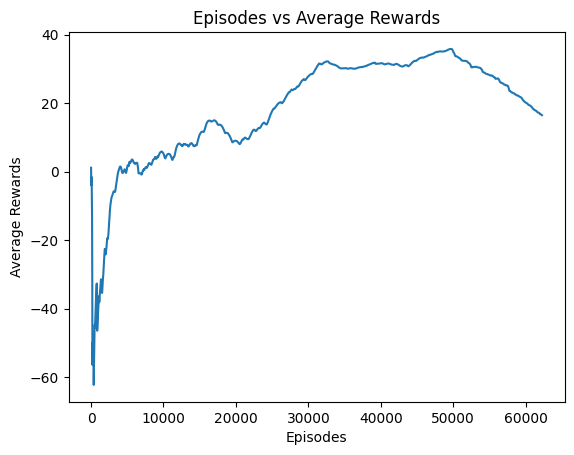

In [10]:
plt.plot(averageRewards)
plt.title('Episodes vs Average Rewards')
plt.xlabel('Episodes')
plt.ylabel('Average Rewards')

In [15]:
successCount

0

## Dueling Deep Q Network With Prioritized Experience Replay (DDQN-PER)

In [16]:
import numpy as np
import tensorflow as tf
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()

np.random.seed(1)
tf.set_random_seed(1)


class SumTree(object):
    """
    This SumTree code is modified version and the original code is from:
    https://github.com/jaara/AI-blog/blob/master/SumTree.py

    Story the data with it priority in tree and data frameworks.
    """
    data_pointer = 0

    def __init__(self, capacity):
        self.capacity = capacity  # for all priority values
        self.tree = np.zeros(2 * capacity - 1)
        # [--------------Parent nodes-------------][-------leaves to recode priority-------]
        #             size: capacity - 1                       size: capacity
        self.data = np.zeros(capacity, dtype=object)  # for all transitions
        # [--------------data frame-------------]
        #             size: capacity

    def add_new_priority(self, p, data):
        leaf_idx = self.data_pointer + self.capacity - 1

        self.data[self.data_pointer] = data  # update data_frame
        self.update(leaf_idx, p)  # update tree_frame
        self.data_pointer += 1
        if self.data_pointer >= self.capacity:  # replace when exceed the capacity
            self.data_pointer = 0

    def update(self, tree_idx, p):
        change = p - self.tree[tree_idx]

        self.tree[tree_idx] = p
        self._propagate_change(tree_idx, change)

    def _propagate_change(self, tree_idx, change):
        """change the sum of priority value in all parent nodes"""
        parent_idx = (tree_idx - 1) // 2
        self.tree[parent_idx] += change
        if parent_idx != 0:
            self._propagate_change(parent_idx, change)

    def get_leaf(self, lower_bound):
        leaf_idx = self._retrieve(lower_bound)  # search the max leaf priority based on the lower_bound
        data_idx = leaf_idx - self.capacity + 1
        return [leaf_idx, self.tree[leaf_idx], self.data[data_idx]]

    def _retrieve(self, lower_bound, parent_idx=0):
        """
        Tree structure and array storage:

        Tree index:
             0         -> storing priority sum
            / \
          1     2
         / \   / \
        3   4 5   6    -> storing priority for transitions

        Array type for storing:
        [0,1,2,3,4,5,6]
        """
        left_child_idx = 2 * parent_idx + 1
        right_child_idx = left_child_idx + 1

        if left_child_idx >= len(self.tree):  # end search when no more child
            return parent_idx

        if self.tree[left_child_idx] == self.tree[right_child_idx]:
            return self._retrieve(lower_bound, np.random.choice([left_child_idx, right_child_idx]))
        if lower_bound <= self.tree[left_child_idx]:  # downward search, always search for a higher priority node
            return self._retrieve(lower_bound, left_child_idx)
        else:
            return self._retrieve(lower_bound - self.tree[left_child_idx], right_child_idx)

    @property
    def root_priority(self):
        return self.tree[0]  # the root


class Memory(object):  # stored as ( s, a, r, s_ ) in SumTree
    """
    This SumTree code is modified version and the original code is from:
    https://github.com/jaara/AI-blog/blob/master/Seaquest-DDQN-PER.py
    """
    epsilon = 0.001  # small amount to avoid zero priority
    alpha = 0.6  # [0~1] convert the importance of TD error to priority
    beta = 0.4  # importance-sampling, from initial value increasing to 1
    beta_increment_per_sampling = 1e-4  # annealing the bias
    abs_err_upper = 1   # for stability refer to paper

    def __init__(self, capacity):
        self.tree = SumTree(capacity)

    def store(self, error, transition):
        p = self._get_priority(error)
        self.tree.add_new_priority(p, transition)

    def sample(self, n):
        batch_idx, batch_memory, ISWeights = [], [], []
        segment = self.tree.root_priority / n
        self.beta = np.min([1, self.beta + self.beta_increment_per_sampling])  # max = 1

        min_prob = np.min(self.tree.tree[-self.tree.capacity:]) / self.tree.root_priority
        maxiwi = np.power(self.tree.capacity * min_prob, -self.beta)  # for later normalizing ISWeights
        for i in range(n):
            a = segment * i
            b = segment * (i + 1)
            lower_bound = np.random.uniform(a, b)
            idx, p, data = self.tree.get_leaf(lower_bound)
            prob = p / self.tree.root_priority
            ISWeights.append(self.tree.capacity * prob)
            batch_idx.append(idx)
            batch_memory.append(data)

        ISWeights = np.vstack(ISWeights)
        ISWeights = np.power(ISWeights, -self.beta) / maxiwi  # normalize
        return batch_idx, np.vstack(batch_memory), ISWeights

    def update(self, idx, error):
        p = self._get_priority(error)
        self.tree.update(idx, p)

    def _get_priority(self, error):
        error += self.epsilon   # avoid 0
        clipped_error = np.clip(error, 0, self.abs_err_upper)
        return np.power(clipped_error, self.alpha)


class DuelingDQNPrioritizedReplay:
    def __init__(
            self,
            n_actions,
            n_features,
            learning_rate=0.005,
            reward_decay=0.9,
            e_greedy=0.9,
            replace_target_iter=500,
            memory_size=10000,
            batch_size=32,
            e_greedy_increment=None,
            hidden=[100, 50],
            output_graph=False,
            sess=None,
    ):
        self.n_actions = n_actions
        self.n_features = n_features
        self.lr = learning_rate
        self.gamma = reward_decay
        self.epsilon_max = e_greedy
        self.replace_target_iter = replace_target_iter
        self.memory_size = memory_size
        self.batch_size = batch_size
        self.hidden = hidden
        self.epsilon_increment = e_greedy_increment
        self.epsilon = 0.5 if e_greedy_increment is not None else self.epsilon_max

        self.learn_step_counter = 0
        self._build_net()
        self.memory = Memory(capacity=memory_size)

        if sess is None:
            self.sess = tf.Session()
            self.sess.run(tf.global_variables_initializer())
        else:
            self.sess = sess

        if output_graph:
            tf.summary.FileWriter("logs/", self.sess.graph)

        self.cost_his = []

    def _build_net(self):
        def build_layers(s, c_names, w_initializer, b_initializer):
            for i, h in enumerate(self.hidden):
                if i == 0:
                    in_units, out_units, inputs = self.n_features, self.hidden[i], s
                else:
                    in_units, out_units, inputs = self.hidden[i-1], self.hidden[i], l
                with tf.variable_scope('l%i' % i):
                    w = tf.get_variable('w', [in_units, out_units], initializer=w_initializer, collections=c_names)
                    b = tf.get_variable('b', [1, out_units], initializer=b_initializer, collections=c_names)
                    l = tf.nn.relu(tf.matmul(inputs, w) + b)

            with tf.variable_scope('Value'):
                w = tf.get_variable('w', [self.hidden[-1], 1], initializer=w_initializer, collections=c_names)
                b = tf.get_variable('b', [1, 1], initializer=b_initializer, collections=c_names)
                self.V = tf.matmul(l, w) + b

            with tf.variable_scope('Advantage'):
                w = tf.get_variable('w', [self.hidden[-1], self.n_actions], initializer=w_initializer, collections=c_names)
                b = tf.get_variable('b', [1, self.n_actions], initializer=b_initializer, collections=c_names)
                self.A = tf.matmul(l, w) + b

            with tf.variable_scope('Q'):
                out = self.V + (self.A - tf.reduce_mean(self.A, axis=1, keep_dims=True))  # Q = V(s) + A(s,a)

            return out

        # ------------------ build evaluate_net ------------------
        self.s = tf.placeholder(tf.float32, [None, self.n_features], name='s')  # input
        self.q_target = tf.placeholder(tf.float32, [None, self.n_actions], name='Q_target')  # for calculating loss
        self.ISWeights = tf.placeholder(tf.float32, [None, 1], name='IS_weights')
        with tf.variable_scope('eval_net'):
            c_names, w_initializer, b_initializer = \
                ['eval_net_params', tf.GraphKeys.GLOBAL_VARIABLES], \
                tf.random_normal_initializer(0., 0.01), tf.constant_initializer(0.01)  # config of layers

            self.q_eval = build_layers(self.s, c_names, w_initializer, b_initializer)

        with tf.variable_scope('loss'):
            self.abs_errors = tf.abs(tf.reduce_sum(self.q_target - self.q_eval, axis=1))  # for updating Sumtree
            self.loss = tf.reduce_mean(self.ISWeights * tf.squared_difference(self.q_target, self.q_eval))

        with tf.variable_scope('train'):
            self._train_op = tf.train.AdamOptimizer(self.lr).minimize(self.loss)

        # ------------------ build target_net ------------------
        self.s_ = tf.placeholder(tf.float32, [None, self.n_features], name='s_')  # input
        with tf.variable_scope('target_net'):
            c_names = ['target_net_params', tf.GraphKeys.GLOBAL_VARIABLES]
            self.q_next = build_layers(self.s_, c_names, w_initializer, b_initializer)

    def store_transition(self, s, a, r, s_):
        transition = np.hstack((s, [a, r], s_))
        max_p = np.max(self.memory.tree.tree[-self.memory.tree.capacity:])
        self.memory.store(max_p, transition)

    def choose_action(self, observation):
        observation = observation[np.newaxis, :]
        if np.random.uniform() < self.epsilon:
            actions_value = self.sess.run(self.q_eval, feed_dict={self.s: observation})
            action = np.argmax(actions_value)
        else:
            action = np.random.randint(0, self.n_actions)
        return action

    def _replace_target_params(self):
        t_params = tf.get_collection('target_net_params')
        e_params = tf.get_collection('eval_net_params')
        self.sess.run([tf.assign(t, e) for t, e in zip(t_params, e_params)])

    def learn(self):
        if self.learn_step_counter % self.replace_target_iter == 0:
            self._replace_target_params()

        tree_idx, batch_memory, ISWeights = self.memory.sample(self.batch_size)

        # double DQN
        q_next, q_eval4next = self.sess.run(
            [self.q_next, self.q_eval],
            feed_dict={self.s_: batch_memory[:, -self.n_features:],  # next observation
                       self.s: batch_memory[:, -self.n_features:]})  # next observation
        q_eval = self.sess.run(self.q_eval, {self.s: batch_memory[:, :self.n_features]})

        q_target = q_eval.copy()

        batch_index = np.arange(self.batch_size, dtype=np.int32)
        eval_act_index = batch_memory[:, self.n_features].astype(int)
        reward = batch_memory[:, self.n_features + 1]
        max_act4next = np.argmax(q_eval4next,
                                 axis=1)  # the action that brings the highest value is evaluated by q_eval
        selected_q_next = q_next[batch_index, max_act4next]  # Double DQN, select q_next depending on above actions

        q_target[batch_index, eval_act_index] = reward + self.gamma * selected_q_next
        _, abs_errors, self.cost = self.sess.run([self._train_op, self.abs_errors, self.loss],
                                                 feed_dict={self.s: batch_memory[:, :self.n_features],
                                                            self.q_target: q_target,
                                                            self.ISWeights: ISWeights})
        for i in range(len(tree_idx)):  # update priority
            idx = tree_idx[i]
            self.memory.update(idx, abs_errors[i])

        self.cost_his.append(self.cost)

        self.epsilon = self.epsilon + self.epsilon_increment if self.epsilon < self.epsilon_max else self.epsilon_max
        self.learn_step_counter += 1


import gym
from gym import wrappers

env = gym.make('LunarLander-v2')
# env = env.unwrapped
env.seed(1)

N_A = env.action_space.n
N_S = env.observation_space.shape[0]
MEMORY_CAPACITY = 50000
TARGET_REP_ITER = 2000
MAX_EPISODES = 900
E_GREEDY = 0.95
E_INCREMENT = 0.00001
GAMMA = 0.99
LR = 0.0001
BATCH_SIZE = 32
HIDDEN = [400, 400]
RENDER = True

RL = DuelingDQNPrioritizedReplay(
    n_actions=N_A, n_features=N_S, learning_rate=LR, e_greedy=E_GREEDY, reward_decay=GAMMA,
    hidden=HIDDEN, batch_size=BATCH_SIZE, replace_target_iter=TARGET_REP_ITER,
    memory_size=MEMORY_CAPACITY, e_greedy_increment=E_INCREMENT,)


total_steps = 0
running_r = 0
r_scale = 100
for i_episode in range(MAX_EPISODES):
    s = env.reset()  # (coord_x, coord_y, vel_x, vel_y, angle, angular_vel, l_leg_on_ground, r_leg_on_ground)
    ep_r = 0
    while True:
        if total_steps > MEMORY_CAPACITY: env.render()
        a = RL.choose_action(s)
        s_, r, done, _ = env.step(a)
        if r == -100: r = -30
        r /= r_scale

        ep_r += r
        RL.store_transition(s, a, r, s_)
        if total_steps > MEMORY_CAPACITY:
            RL.learn()
        if done:
            land = '| Landed' if r == 100/r_scale else '| ------'
            running_r = 0.99 * running_r + 0.01 * ep_r
            print('Epi: ', i_episode,
                  land,
                  '| Epi_R: ', round(ep_r, 2),
                  '| Running_R: ', round(running_r, 2),
                  '| Epsilon: ', round(RL.epsilon, 3))
            break

        s = s_
        total_steps += 1

Epi:  0 | ------ | Epi_R:  -1.61 | Running_R:  -0.02 | Epsilon:  0.5
Epi:  1 | ------ | Epi_R:  -4.99 | Running_R:  -0.07 | Epsilon:  0.5
Epi:  2 | ------ | Epi_R:  -1.36 | Running_R:  -0.08 | Epsilon:  0.5
Epi:  3 | ------ | Epi_R:  -2.44 | Running_R:  -0.1 | Epsilon:  0.5
Epi:  4 | ------ | Epi_R:  -3.02 | Running_R:  -0.13 | Epsilon:  0.5
Epi:  5 | ------ | Epi_R:  -4.79 | Running_R:  -0.18 | Epsilon:  0.5
Epi:  6 | ------ | Epi_R:  -3.68 | Running_R:  -0.21 | Epsilon:  0.5
Epi:  7 | ------ | Epi_R:  -4.75 | Running_R:  -0.26 | Epsilon:  0.5
Epi:  8 | ------ | Epi_R:  -2.68 | Running_R:  -0.28 | Epsilon:  0.5
Epi:  9 | ------ | Epi_R:  -5.99 | Running_R:  -0.34 | Epsilon:  0.5
Epi:  10 | ------ | Epi_R:  -3.18 | Running_R:  -0.37 | Epsilon:  0.5
Epi:  11 | ------ | Epi_R:  -2.11 | Running_R:  -0.39 | Epsilon:  0.5
Epi:  12 | ------ | Epi_R:  -2.61 | Running_R:  -0.41 | Epsilon:  0.5
Epi:  13 | ------ | Epi_R:  -0.6 | Running_R:  -0.41 | Epsilon:  0.5
Epi:  14 | ------ | Epi_R:  -2.9

Epi:  119 | ------ | Epi_R:  -5.52 | Running_R:  -2.42 | Epsilon:  0.5
Epi:  120 | ------ | Epi_R:  -3.51 | Running_R:  -2.43 | Epsilon:  0.5
Epi:  121 | ------ | Epi_R:  -4.86 | Running_R:  -2.45 | Epsilon:  0.5
Epi:  122 | ------ | Epi_R:  -3.6 | Running_R:  -2.46 | Epsilon:  0.5
Epi:  123 | ------ | Epi_R:  -2.27 | Running_R:  -2.46 | Epsilon:  0.5
Epi:  124 | ------ | Epi_R:  -1.8 | Running_R:  -2.45 | Epsilon:  0.5
Epi:  125 | ------ | Epi_R:  -3.14 | Running_R:  -2.46 | Epsilon:  0.5
Epi:  126 | ------ | Epi_R:  -6.21 | Running_R:  -2.5 | Epsilon:  0.5
Epi:  127 | ------ | Epi_R:  -1.5 | Running_R:  -2.49 | Epsilon:  0.5
Epi:  128 | ------ | Epi_R:  -2.6 | Running_R:  -2.49 | Epsilon:  0.5
Epi:  129 | ------ | Epi_R:  -2.13 | Running_R:  -2.49 | Epsilon:  0.5
Epi:  130 | ------ | Epi_R:  -3.66 | Running_R:  -2.5 | Epsilon:  0.5
Epi:  131 | ------ | Epi_R:  -3.9 | Running_R:  -2.51 | Epsilon:  0.5
Epi:  132 | ------ | Epi_R:  -2.02 | Running_R:  -2.51 | Epsilon:  0.5
Epi:  133 | -

Epi:  236 | ------ | Epi_R:  -2.58 | Running_R:  -3.24 | Epsilon:  0.5
Epi:  237 | ------ | Epi_R:  -4.65 | Running_R:  -3.25 | Epsilon:  0.5
Epi:  238 | ------ | Epi_R:  -9.43 | Running_R:  -3.32 | Epsilon:  0.5
Epi:  239 | ------ | Epi_R:  -7.5 | Running_R:  -3.36 | Epsilon:  0.5
Epi:  240 | ------ | Epi_R:  -4.91 | Running_R:  -3.37 | Epsilon:  0.5
Epi:  241 | ------ | Epi_R:  -3.77 | Running_R:  -3.38 | Epsilon:  0.5
Epi:  242 | ------ | Epi_R:  -7.11 | Running_R:  -3.41 | Epsilon:  0.5
Epi:  243 | ------ | Epi_R:  -4.03 | Running_R:  -3.42 | Epsilon:  0.5
Epi:  244 | ------ | Epi_R:  -3.6 | Running_R:  -3.42 | Epsilon:  0.5
Epi:  245 | ------ | Epi_R:  -3.09 | Running_R:  -3.42 | Epsilon:  0.5
Epi:  246 | ------ | Epi_R:  -3.62 | Running_R:  -3.42 | Epsilon:  0.5
Epi:  247 | ------ | Epi_R:  -4.3 | Running_R:  -3.43 | Epsilon:  0.5
Epi:  248 | ------ | Epi_R:  -2.31 | Running_R:  -3.42 | Epsilon:  0.5
Epi:  249 | ------ | Epi_R:  -6.36 | Running_R:  -3.45 | Epsilon:  0.5
Epi:  250

Epi:  354 | ------ | Epi_R:  -1.76 | Running_R:  -3.78 | Epsilon:  0.5
Epi:  355 | ------ | Epi_R:  -3.29 | Running_R:  -3.78 | Epsilon:  0.5
Epi:  356 | ------ | Epi_R:  -3.09 | Running_R:  -3.77 | Epsilon:  0.5
Epi:  357 | ------ | Epi_R:  -4.68 | Running_R:  -3.78 | Epsilon:  0.5
Epi:  358 | ------ | Epi_R:  -2.72 | Running_R:  -3.77 | Epsilon:  0.5
Epi:  359 | ------ | Epi_R:  0.38 | Running_R:  -3.73 | Epsilon:  0.5
Epi:  360 | ------ | Epi_R:  -3.04 | Running_R:  -3.72 | Epsilon:  0.5
Epi:  361 | ------ | Epi_R:  -3.83 | Running_R:  -3.72 | Epsilon:  0.5
Epi:  362 | ------ | Epi_R:  -3.94 | Running_R:  -3.72 | Epsilon:  0.5
Epi:  363 | ------ | Epi_R:  -2.64 | Running_R:  -3.71 | Epsilon:  0.5
Epi:  364 | ------ | Epi_R:  -3.43 | Running_R:  -3.71 | Epsilon:  0.5
Epi:  365 | ------ | Epi_R:  -2.94 | Running_R:  -3.7 | Epsilon:  0.5
Epi:  366 | ------ | Epi_R:  -4.15 | Running_R:  -3.71 | Epsilon:  0.5
Epi:  367 | ------ | Epi_R:  -3.07 | Running_R:  -3.7 | Epsilon:  0.5
Epi:  368

Epi:  468 | ------ | Epi_R:  -0.76 | Running_R:  -1.74 | Epsilon:  0.903
Epi:  469 | ------ | Epi_R:  -0.34 | Running_R:  -1.73 | Epsilon:  0.904
Epi:  470 | Landed | Epi_R:  2.21 | Running_R:  -1.69 | Epsilon:  0.909
Epi:  471 | Landed | Epi_R:  2.06 | Running_R:  -1.65 | Epsilon:  0.917
Epi:  472 | ------ | Epi_R:  1.19 | Running_R:  -1.62 | Epsilon:  0.927
Epi:  473 | ------ | Epi_R:  0.17 | Running_R:  -1.61 | Epsilon:  0.928
Epi:  474 | ------ | Epi_R:  0.21 | Running_R:  -1.59 | Epsilon:  0.931
Epi:  475 | ------ | Epi_R:  0.08 | Running_R:  -1.57 | Epsilon:  0.934
Epi:  476 | ------ | Epi_R:  0.17 | Running_R:  -1.55 | Epsilon:  0.936
Epi:  477 | ------ | Epi_R:  0.51 | Running_R:  -1.53 | Epsilon:  0.938
Epi:  478 | Landed | Epi_R:  2.34 | Running_R:  -1.49 | Epsilon:  0.942
Epi:  479 | ------ | Epi_R:  0.72 | Running_R:  -1.47 | Epsilon:  0.944
Epi:  480 | Landed | Epi_R:  2.22 | Running_R:  -1.44 | Epsilon:  0.948
Epi:  481 | Landed | Epi_R:  2.06 | Running_R:  -1.4 | Epsilon

Epi:  584 | ------ | Epi_R:  0.18 | Running_R:  0.16 | Epsilon:  0.95
Epi:  585 | Landed | Epi_R:  2.04 | Running_R:  0.18 | Epsilon:  0.95
Epi:  586 | ------ | Epi_R:  0.08 | Running_R:  0.18 | Epsilon:  0.95
Epi:  587 | Landed | Epi_R:  2.71 | Running_R:  0.2 | Epsilon:  0.95
Epi:  588 | Landed | Epi_R:  1.2 | Running_R:  0.21 | Epsilon:  0.95
Epi:  589 | Landed | Epi_R:  2.57 | Running_R:  0.24 | Epsilon:  0.95
Epi:  590 | ------ | Epi_R:  0.2 | Running_R:  0.24 | Epsilon:  0.95
Epi:  591 | ------ | Epi_R:  -0.38 | Running_R:  0.23 | Epsilon:  0.95
Epi:  592 | ------ | Epi_R:  -0.11 | Running_R:  0.23 | Epsilon:  0.95
Epi:  593 | ------ | Epi_R:  0.59 | Running_R:  0.23 | Epsilon:  0.95
Epi:  594 | Landed | Epi_R:  2.54 | Running_R:  0.25 | Epsilon:  0.95
Epi:  595 | Landed | Epi_R:  2.62 | Running_R:  0.28 | Epsilon:  0.95
Epi:  596 | ------ | Epi_R:  0.05 | Running_R:  0.28 | Epsilon:  0.95
Epi:  597 | ------ | Epi_R:  0.82 | Running_R:  0.28 | Epsilon:  0.95
Epi:  598 | ------ | 

Epi:  702 | Landed | Epi_R:  3.12 | Running_R:  1.33 | Epsilon:  0.95
Epi:  703 | Landed | Epi_R:  2.92 | Running_R:  1.34 | Epsilon:  0.95
Epi:  704 | Landed | Epi_R:  2.45 | Running_R:  1.36 | Epsilon:  0.95
Epi:  705 | Landed | Epi_R:  2.52 | Running_R:  1.37 | Epsilon:  0.95
Epi:  706 | Landed | Epi_R:  2.37 | Running_R:  1.38 | Epsilon:  0.95
Epi:  707 | ------ | Epi_R:  0.99 | Running_R:  1.37 | Epsilon:  0.95
Epi:  708 | Landed | Epi_R:  2.53 | Running_R:  1.39 | Epsilon:  0.95
Epi:  709 | Landed | Epi_R:  2.57 | Running_R:  1.4 | Epsilon:  0.95
Epi:  710 | ------ | Epi_R:  0.4 | Running_R:  1.39 | Epsilon:  0.95
Epi:  711 | ------ | Epi_R:  0.95 | Running_R:  1.38 | Epsilon:  0.95
Epi:  712 | ------ | Epi_R:  0.98 | Running_R:  1.38 | Epsilon:  0.95
Epi:  713 | ------ | Epi_R:  1.2 | Running_R:  1.38 | Epsilon:  0.95
Epi:  714 | ------ | Epi_R:  0.64 | Running_R:  1.37 | Epsilon:  0.95
Epi:  715 | Landed | Epi_R:  2.73 | Running_R:  1.38 | Epsilon:  0.95
Epi:  716 | ------ | Ep

Epi:  820 | ------ | Epi_R:  -0.38 | Running_R:  1.67 | Epsilon:  0.95
Epi:  821 | Landed | Epi_R:  2.42 | Running_R:  1.68 | Epsilon:  0.95
Epi:  822 | Landed | Epi_R:  2.46 | Running_R:  1.68 | Epsilon:  0.95
Epi:  823 | Landed | Epi_R:  2.64 | Running_R:  1.69 | Epsilon:  0.95
Epi:  824 | Landed | Epi_R:  3.07 | Running_R:  1.71 | Epsilon:  0.95
Epi:  825 | Landed | Epi_R:  2.69 | Running_R:  1.72 | Epsilon:  0.95
Epi:  826 | Landed | Epi_R:  2.77 | Running_R:  1.73 | Epsilon:  0.95
Epi:  827 | Landed | Epi_R:  2.6 | Running_R:  1.74 | Epsilon:  0.95
Epi:  828 | ------ | Epi_R:  1.3 | Running_R:  1.73 | Epsilon:  0.95
Epi:  829 | Landed | Epi_R:  2.7 | Running_R:  1.74 | Epsilon:  0.95
Epi:  830 | ------ | Epi_R:  1.26 | Running_R:  1.74 | Epsilon:  0.95
Epi:  831 | ------ | Epi_R:  1.05 | Running_R:  1.73 | Epsilon:  0.95
Epi:  832 | Landed | Epi_R:  2.65 | Running_R:  1.74 | Epsilon:  0.95
Epi:  833 | Landed | Epi_R:  2.56 | Running_R:  1.75 | Epsilon:  0.95
Epi:  834 | Landed | E

## Deep Deterministic Policy Gradient (DDPG)

In [ ]:
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
import gym
from tensorflow.keras.models import load_model
!pip3 install box2d-py

env= gym.make("LunarLanderContinuous-v2")
state_low = env.observation_space.low
state_high = env.observation_space.high
action_low = env.action_space.low 
action_high = env.action_space.high
print(state_low)
print(state_high)
print(action_low)
print(action_high)

class RBuffer():
    def __init__(self, maxsize, statedim, naction):
    self.cnt = 0
    self.maxsize = maxsize
    self.state_memory = np.zeros((maxsize, *statedim), dtype=np.float32)
    self.action_memory = np.zeros((maxsize, naction), dtype=np.float32)
    self.reward_memory = np.zeros((maxsize,), dtype=np.float32)
    self.next_state_memory = np.zeros((maxsize, *statedim), dtype=np.float32)
    self.done_memory = np.zeros((maxsize,), dtype= np.bool)

    def storexp(self, state, next_state, action, done, reward):
    index = self.cnt % self.maxsize
    self.state_memory[index] = state
    self.action_memory[index] = action
    self.reward_memory[index] = reward
    self.next_state_memory[index] = next_state
    self.done_memory[index] = 1- int(done)
    self.cnt += 1

    def sample(self, batch_size):
    max_mem = min(self.cnt, self.maxsize)
    batch = np.random.choice(max_mem, batch_size, replace= False)  
    states = self.state_memory[batch]
    next_states = self.next_state_memory[batch]
    rewards = self.reward_memory[batch]
    actions = self.action_memory[batch]
    dones = self.done_memory[batch]
    return states, next_states, rewards, actions, dones

class Critic(tf.keras.Model):
    def __init__(self):
    super(Critic, self).__init__()
    self.f1 = tf.keras.layers.Dense(512, activation='relu')
    self.f2 = tf.keras.layers.Dense(512, activation='relu')
    self.v =  tf.keras.layers.Dense(1, activation=None)

    def call(self, inputstate, action):
    x = self.f1(tf.concat([inputstate, action], axis=1))
    x = self.f2(x)
    x = self.v(x)
    return x


class Actor(tf.keras.Model):
    def __init__(self, no_action):
    super(Actor, self).__init__()    
    self.f1 = tf.keras.layers.Dense(512, activation='relu')
    self.f2 = tf.keras.layers.Dense(512, activation='relu')
    self.mu =  tf.keras.layers.Dense(no_action, activation='tanh')

    def call(self, state):
    x = self.f1(state)
    x = self.f2(x)
    x = self.mu(x)  
    return x

class Agent():
    def __init__(self, n_action= len(env.action_space.high)):
    self.actor_main = Actor(n_action)
    self.actor_target = Actor(n_action)
    self.critic_main = Critic()
    self.critic_target = Critic()
    self.batch_size = 64
    self.n_actions = len(env.action_space.high)
    self.a_opt = tf.keras.optimizers.Adam(1e-4)
    # self.actor_target = tf.keras.optimizers.Adam(.001)
    self.c_opt = tf.keras.optimizers.Adam(1e-4)
    # self.critic_target = tf.keras.optimizers.Adam(.002)
    self.memory = RBuffer(1_00_000, env.observation_space.shape, len(env.action_space.high))
    self.trainstep = 0
    self.replace = 5
    self.gamma = 0.99
    self.min_action = env.action_space.low[0]
    self.max_action = env.action_space.high[0]

    def act(self, state, evaluate=False):
        state = tf.convert_to_tensor([state], dtype=tf.float32)
        actions = self.actor_main(state)
        if not evaluate:
            actions += tf.random.normal(shape=[self.n_actions], mean=0.0, stddev=0.1)

        actions = self.max_action * (tf.clip_by_value(actions, self.min_action, self.max_action))
        #print(actions)
        return actions[0]


    def savexp(self,state, next_state, action, done, reward):
        self.memory.storexp(state, next_state, action, done, reward)

    def update_target(self):
    self.actor_target.set_weights(self.actor_main.get_weights())
    self.critic_target.set_weights(self.critic_main.get_weights())

    def train(self):
        if self.memory.cnt < self.batch_size:
            return 

        states, next_states, rewards, actions, dones = self.memory.sample(self.batch_size)
        
        states = tf.convert_to_tensor(states, dtype= tf.float32)
        next_states = tf.convert_to_tensor(next_states, dtype= tf.float32)
        rewards = tf.convert_to_tensor(rewards, dtype= tf.float32)
        actions = tf.convert_to_tensor(actions, dtype= tf.float32)
        #dones = tf.convert_to_tensor(dones, dtype= tf.bool)

        with tf.GradientTape() as tape1, tf.GradientTape() as tape2:
            target_actions = self.actor_target(next_states)
            target_next_state_values = tf.squeeze(self.critic_target(next_states, target_actions), 1)
            critic_value = tf.squeeze(self.critic_main(states, actions), 1)
            target_values = rewards + self.gamma * target_next_state_values * dones
            critic_loss = tf.keras.losses.MSE(target_values, critic_value)

            new_policy_actions = self.actor_main(states)
            actor_loss = -self.critic_main(states, new_policy_actions)
            actor_loss = tf.math.reduce_mean(actor_loss)

        grads1 = tape1.gradient(actor_loss, self.actor_main.trainable_variables)
        grads2 = tape2.gradient(critic_loss, self.critic_main.trainable_variables)
        self.a_opt.apply_gradients(zip(grads1, self.actor_main.trainable_variables))
        self.c_opt.apply_gradients(zip(grads2, self.critic_main.trainable_variables))

        if self.trainstep % self.replace == 0:
            self.update_target()
        
        self.trainstep +=1
    
agent = Agent(2)
tf.random.set_seed(336699)

episods = 2000
ep_reward = []
total_avgr = []
fuel_array = []
successCount = 0
target = False

for s in range(episods):
    if target == True:
        break
    total_reward = 0 
    state = env.reset()
    done = False

    while not done:
        action = agent.act(state)
        next_state, reward, done, _ = env.step(action)
        agent.savexp(state, next_state, action, done, reward)
        agent.train()
        state = next_state
        total_reward += reward
        if reward >= 200:
            sucessCount += 1
        fuel_used = env.env.init_fuel - state[2]
        fuel_array.append(fuel_used)
        if done:
            ep_reward.append(total_reward)
            avg_reward = np.mean(ep_reward[-100:])
            total_avgr.append(avg_reward)
            print("total reward after {} steps is {} and avg reward is {}".format(s, total_reward, avg_reward))
            
            if int(avg_reward) == 200:
                target = True

In [ ]:
plt.plot(total_avgr)

## Proximal Policy Optimization (PPO)

episode: 1/5000, score: -121.12615101272162, average: -121.13 
episode: 2/5000, score: -107.27077439785968, average: -114.20 
episode: 3/5000, score: -389.6270310281945, average: -206.01 
episode: 4/5000, score: -331.1656760132016, average: -237.30 
episode: 5/5000, score: -203.77802498923876, average: -230.59 
episode: 6/5000, score: -227.72195349027197, average: -230.11 
episode: 7/5000, score: -165.9542085172182, average: -220.95 
episode: 8/5000, score: -162.1251850134804, average: -213.60 
episode: 9/5000, score: -79.981229196343, average: -198.75 
episode: 10/5000, score: -188.07369298731254, average: -197.68 
episode: 11/5000, score: -244.64767772128408, average: -201.95 
episode: 12/5000, score: -84.6681901417084, average: -192.18 
episode: 13/5000, score: -90.13759811592134, average: -184.33 
episode: 14/5000, score: -76.76095216567992, average: -176.65 
episode: 15/5000, score: -45.43517276146932, average: -167.90 
episode: 16/5000, score: -317.34023735137384, average: -177.2

episode: 131/5000, score: -152.61263682970565, average: -80.18 
episode: 132/5000, score: -64.28191180485709, average: -75.63 
episode: 133/5000, score: 40.446575339529716, average: -72.68 
episode: 134/5000, score: -39.10030538563829, average: -71.53 
episode: 135/5000, score: -67.72882429125151, average: -70.47 
episode: 136/5000, score: -100.40206638988855, average: -68.71 
episode: 137/5000, score: -70.11976923412988, average: -65.28 
episode: 138/5000, score: -75.91679877206278, average: -66.76 
episode: 139/5000, score: -78.0100037218032, average: -67.01 
episode: 140/5000, score: 4.190308945979638, average: -64.42 
episode: 141/5000, score: -49.99779595479038, average: -62.99 
episode: 142/5000, score: 0.16329315310412085, average: -61.38 
episode: 143/5000, score: 135.48149600384144, average: -55.21 
episode: 144/5000, score: -8.432029984384059, average: -54.61 
episode: 145/5000, score: -26.43885722759437, average: -52.92 
episode: 146/5000, score: 4.372992700764399, average: 

episode: 260/5000, score: 101.30223150111823, average: -102.70 
episode: 261/5000, score: -37.967884725559415, average: -99.21 
episode: 262/5000, score: -92.68929193231006, average: -96.79 
episode: 263/5000, score: -192.02043638199365, average: -101.21 
episode: 264/5000, score: -106.13074297336895, average: -101.84 
episode: 265/5000, score: -31.295862274450666, average: -100.61 
episode: 266/5000, score: -101.61838477292703, average: -100.03 
episode: 267/5000, score: -138.45253768984503, average: -100.98 
episode: 268/5000, score: -49.87006356904676, average: -99.75 
episode: 269/5000, score: -102.91648208712004, average: -99.35 
episode: 270/5000, score: -108.99923847450783, average: -99.74 
episode: 271/5000, score: -89.4988748192857, average: -98.00 
episode: 272/5000, score: -97.03811403368536, average: -95.52 
episode: 273/5000, score: -117.49177378508219, average: -96.66 
episode: 274/5000, score: -110.27850147018592, average: -95.72 
episode: 275/5000, score: 58.65835740740

episode: 390/5000, score: -137.21950108656168, average: -53.33 
episode: 391/5000, score: 144.37078387379063, average: -48.54 
episode: 392/5000, score: -107.75358693565488, average: -48.54 
episode: 393/5000, score: -126.60304143020316, average: -49.97 
episode: 394/5000, score: -193.63578136663617, average: -52.35 
episode: 395/5000, score: -90.72813368295239, average: -52.99 
episode: 396/5000, score: -119.97855711512102, average: -52.57 
episode: 397/5000, score: -0.5732407610482522, average: -49.92 
episode: 398/5000, score: -108.47392591341892, average: -54.73 
episode: 399/5000, score: -111.23066621739008, average: -58.94 
episode: 400/5000, score: -73.85340315078543, average: -57.78 
episode: 401/5000, score: 145.69655411277307, average: -51.92 
episode: 402/5000, score: -70.74099559222229, average: -56.29 
episode: 403/5000, score: -89.68408192998722, average: -56.69 
episode: 404/5000, score: -192.42532959452245, average: -59.17 
episode: 405/5000, score: -107.19503035105906,

episode: 520/5000, score: -45.00054767590632, average: -11.23 
episode: 521/5000, score: -144.75418131061332, average: -12.37 
episode: 522/5000, score: 141.7051533258416, average: -7.68 
episode: 523/5000, score: 167.22421697930625, average: -2.95 
episode: 524/5000, score: -98.46638071509466, average: -3.31 
episode: 525/5000, score: -2.512119209364357, average: -1.47 
episode: 526/5000, score: 232.1304931674024, average: 0.37 SAVING
episode: 527/5000, score: -107.49084982261047, average: -0.68 
episode: 528/5000, score: -57.77179817286573, average: -5.78 
episode: 529/5000, score: -87.77507567183649, average: -5.57 
episode: 530/5000, score: 147.01066573343195, average: -1.40 
episode: 531/5000, score: -179.43012323026085, average: -4.41 
episode: 532/5000, score: 185.9086116764257, average: 0.50 SAVING
episode: 533/5000, score: 215.43332470806828, average: 6.45 SAVING
episode: 534/5000, score: 224.88953035388153, average: 9.21 SAVING
episode: 535/5000, score: -21.72393582163956, av

episode: 646/5000, score: 221.6585983777809, average: 113.38 
episode: 647/5000, score: 174.73793191602854, average: 116.93 
episode: 648/5000, score: 92.11342721832091, average: 115.10 
episode: 649/5000, score: 146.35317923489382, average: 114.41 
episode: 650/5000, score: 205.0478529905785, average: 114.00 
episode: 651/5000, score: 54.399257018479815, average: 113.00 
episode: 652/5000, score: 117.78646304623098, average: 112.99 
episode: 653/5000, score: 190.54431297706105, average: 112.85 
episode: 654/5000, score: 201.25844810230785, average: 112.43 
episode: 655/5000, score: 183.52639176032477, average: 117.55 
episode: 656/5000, score: 242.8375852135811, average: 118.28 
episode: 657/5000, score: 209.785327322468, average: 117.94 
episode: 658/5000, score: 135.1348416623577, average: 116.55 
episode: 659/5000, score: 219.13942171562462, average: 116.93 
episode: 660/5000, score: 221.1997273920669, average: 117.25 
episode: 661/5000, score: 160.06602568427468, average: 116.29 


episode: 777/5000, score: -8.806074334716982, average: 129.08 
episode: 778/5000, score: 214.1426775790898, average: 128.67 
episode: 779/5000, score: 270.6007237073903, average: 132.86 
episode: 780/5000, score: 242.89119946391946, average: 133.26 
episode: 781/5000, score: 188.6399469012059, average: 132.78 
episode: 782/5000, score: 204.91463529062375, average: 138.65 
episode: 783/5000, score: -55.143125084488275, average: 136.03 
episode: 784/5000, score: 176.81947357895228, average: 142.17 
episode: 785/5000, score: 45.77763846602095, average: 141.71 
episode: 786/5000, score: 7.963211360367197, average: 143.51 
episode: 787/5000, score: 49.53889396807322, average: 142.87 
episode: 788/5000, score: 138.24075460658634, average: 143.52 
episode: 789/5000, score: 163.12265376058483, average: 146.76 
episode: 790/5000, score: 212.85396813898052, average: 146.12 
episode: 791/5000, score: 243.82787182059917, average: 146.39 
episode: 792/5000, score: 197.91334158168553, average: 146.0

episode: 907/5000, score: 132.4466592704365, average: 155.64 
episode: 908/5000, score: 234.67931343286375, average: 155.68 
episode: 909/5000, score: 66.54395376269295, average: 155.77 
episode: 910/5000, score: 212.60463133795045, average: 155.90 
episode: 911/5000, score: 222.030682631614, average: 156.50 
episode: 912/5000, score: 207.97119359029048, average: 156.80 
episode: 913/5000, score: 243.0763206926905, average: 156.75 
episode: 914/5000, score: 201.2777234126968, average: 155.85 
episode: 915/5000, score: 218.18096559674626, average: 159.07 
episode: 916/5000, score: 201.77649678364799, average: 159.64 
episode: 917/5000, score: 272.89570219178694, average: 159.74 
episode: 918/5000, score: -32.01856309192256, average: 153.83 
episode: 919/5000, score: -48.3797984001323, average: 149.57 
episode: 920/5000, score: 198.99983229007745, average: 152.55 
episode: 921/5000, score: 186.90559204184385, average: 153.10 
episode: 922/5000, score: -22.31196974672116, average: 154.20 

episode: 1037/5000, score: 247.33855676751523, average: 147.18 
episode: 1038/5000, score: -62.547822702821705, average: 140.89 
episode: 1039/5000, score: 213.92365118873457, average: 140.82 
episode: 1040/5000, score: 24.070184796249194, average: 139.41 
episode: 1041/5000, score: 233.4012765844964, average: 144.80 
episode: 1042/5000, score: 46.711206330754955, average: 141.02 
episode: 1043/5000, score: 268.68956749831017, average: 142.38 
episode: 1044/5000, score: -96.3003422410392, average: 137.87 
episode: 1045/5000, score: 223.97966953635984, average: 139.66 
episode: 1046/5000, score: 191.23025616493177, average: 139.81 
episode: 1047/5000, score: -39.52121216428047, average: 139.55 
episode: 1048/5000, score: 2.3082743192979223, average: 140.35 
episode: 1049/5000, score: 173.8831753891385, average: 140.17 
episode: 1050/5000, score: 174.86767592275365, average: 140.95 
episode: 1051/5000, score: -3.9289527987682646, average: 138.15 
episode: 1052/5000, score: -9.29576042962

episode: 1166/5000, score: 94.67235040712734, average: 151.61 
episode: 1167/5000, score: 222.7165458340874, average: 151.62 
episode: 1168/5000, score: 233.8812815858314, average: 153.92 
episode: 1169/5000, score: 87.37529406183907, average: 151.66 
episode: 1170/5000, score: 126.9631257787787, average: 149.34 
episode: 1171/5000, score: 249.95006555256182, average: 149.89 
episode: 1172/5000, score: 230.36116342112086, average: 150.55 
episode: 1173/5000, score: 216.10933205857276, average: 154.85 
episode: 1174/5000, score: 215.39420571217914, average: 154.12 
episode: 1175/5000, score: 242.7292991393805, average: 156.17 
episode: 1176/5000, score: 242.66853283751612, average: 158.04 
episode: 1177/5000, score: -39.92345882808003, average: 152.48 
episode: 1178/5000, score: -10.972420615963287, average: 148.34 
episode: 1179/5000, score: 91.3288855334186, average: 145.47 
episode: 1180/5000, score: 243.51333600588868, average: 145.74 
episode: 1181/5000, score: 224.35471010052652, 

episode: 1295/5000, score: -16.647366906096337, average: 165.95 
episode: 1296/5000, score: 253.26483666843026, average: 166.11 
episode: 1297/5000, score: 239.64229337914264, average: 166.02 
episode: 1298/5000, score: 207.59170176522179, average: 164.94 
episode: 1299/5000, score: 223.295079779064, average: 165.21 
episode: 1300/5000, score: 259.56584058388387, average: 167.69 
episode: 1301/5000, score: 224.0056273691167, average: 170.65 SAVING
episode: 1302/5000, score: 249.65252787451993, average: 172.30 SAVING
episode: 1303/5000, score: 73.04319953660104, average: 173.00 SAVING
episode: 1304/5000, score: -63.72438167582878, average: 166.86 
episode: 1305/5000, score: -54.70945002452251, average: 161.06 
episode: 1306/5000, score: 213.10215749378955, average: 159.89 
episode: 1307/5000, score: 53.873180726100934, average: 159.32 
episode: 1308/5000, score: 85.53305200658777, average: 156.61 
episode: 1309/5000, score: -104.59684253766996, average: 149.69 
episode: 1310/5000, score

episode: 1424/5000, score: 230.35393629279957, average: 166.78 
episode: 1425/5000, score: 99.43267102244624, average: 164.17 
episode: 1426/5000, score: -2.602321720400525, average: 159.94 
episode: 1427/5000, score: 267.9373194657097, average: 162.33 
episode: 1428/5000, score: -18.685083498217082, average: 162.35 
episode: 1429/5000, score: 241.53207897485757, average: 161.68 
episode: 1430/5000, score: 104.883584533275, average: 163.36 
episode: 1431/5000, score: 234.18210901073454, average: 166.96 
episode: 1432/5000, score: 71.0501788087943, average: 164.45 
episode: 1433/5000, score: -35.91584139774454, average: 158.90 
episode: 1434/5000, score: 200.94923861576544, average: 163.01 
episode: 1435/5000, score: -2.9042992544701036, average: 163.38 
episode: 1436/5000, score: -59.98748232072613, average: 157.80 
episode: 1437/5000, score: 216.24723674577348, average: 157.00 
episode: 1438/5000, score: -55.50398508004744, average: 151.67 
episode: 1439/5000, score: 187.6849548885528

episode: 1553/5000, score: 266.25826234898284, average: 164.99 
episode: 1554/5000, score: 231.40208070835214, average: 167.92 
episode: 1555/5000, score: 261.50826233108467, average: 173.25 
episode: 1556/5000, score: 88.96064638524213, average: 172.82 
episode: 1557/5000, score: 220.84601527337912, average: 173.45 
episode: 1558/5000, score: 250.56175721121366, average: 173.96 
episode: 1559/5000, score: 34.793994377106316, average: 170.22 
episode: 1560/5000, score: 213.2477109566621, average: 168.99 
episode: 1561/5000, score: 256.2922908921544, average: 169.42 
episode: 1562/5000, score: 30.19554813107547, average: 166.72 
episode: 1563/5000, score: 255.32899136343076, average: 167.29 
episode: 1564/5000, score: 178.1989364352958, average: 168.02 
episode: 1565/5000, score: 235.44121192408076, average: 169.05 
episode: 1566/5000, score: 279.6312046484706, average: 170.14 
episode: 1567/5000, score: -75.48078442681714, average: 164.37 
episode: 1568/5000, score: 70.73423903422722, 

episode: 1682/5000, score: 226.70338083288172, average: 116.34 
episode: 1683/5000, score: -39.26509034841841, average: 116.30 
episode: 1684/5000, score: -29.357881967036406, average: 112.63 
episode: 1685/5000, score: 20.448862395559388, average: 115.07 
episode: 1686/5000, score: -31.5576773407505, average: 109.57 
episode: 1687/5000, score: 257.1749254762414, average: 110.51 
episode: 1688/5000, score: 238.7189253624402, average: 110.63 
episode: 1689/5000, score: -37.46221397254256, average: 105.63 
episode: 1690/5000, score: 244.73595821380678, average: 110.99 
episode: 1691/5000, score: 98.61032285670866, average: 109.32 
episode: 1692/5000, score: 184.31419414703967, average: 114.78 
episode: 1693/5000, score: 242.73136676616153, average: 114.75 
episode: 1694/5000, score: 213.86395273416875, average: 114.15 
episode: 1695/5000, score: 223.77927362904617, average: 114.16 
episode: 1696/5000, score: 196.06278434644594, average: 113.65 
episode: 1697/5000, score: -96.090061408345

episode: 1811/5000, score: 96.11357397102702, average: 167.60 
episode: 1812/5000, score: 35.94591705746629, average: 163.39 
episode: 1813/5000, score: 177.4760533097134, average: 162.72 
episode: 1814/5000, score: 258.2677567282715, average: 163.47 
episode: 1815/5000, score: 227.6738830912296, average: 169.10 
episode: 1816/5000, score: 236.28175500791747, average: 169.52 
episode: 1817/5000, score: 231.42692828627023, average: 170.39 
episode: 1818/5000, score: 260.01526765645235, average: 175.73 
episode: 1819/5000, score: 32.917495043376704, average: 171.02 
episode: 1820/5000, score: -3.678239190153363, average: 165.95 
episode: 1821/5000, score: 268.2726003643413, average: 165.50 
episode: 1822/5000, score: -45.69083450403102, average: 160.66 
episode: 1823/5000, score: 254.7864095818629, average: 166.47 
episode: 1824/5000, score: 229.44613811231667, average: 167.53 
episode: 1825/5000, score: 219.48595372208328, average: 167.38 
episode: 1826/5000, score: 27.7923533797331, av

episode: 1941/5000, score: 157.48351748208353, average: 103.59 
episode: 1942/5000, score: -80.67022483086122, average: 101.15 
episode: 1943/5000, score: -28.465874627949844, average: 95.40 
episode: 1944/5000, score: 186.81144174687552, average: 98.88 
episode: 1945/5000, score: 271.58091998367183, average: 99.54 
episode: 1946/5000, score: 198.1778143894444, average: 105.08 
episode: 1947/5000, score: 247.9162477938082, average: 105.52 
episode: 1948/5000, score: -78.35853016098883, average: 99.61 
episode: 1949/5000, score: 113.58823535045497, average: 102.14 
episode: 1950/5000, score: 4.27105273848008, average: 102.80 
episode: 1951/5000, score: -85.11731972197738, average: 96.37 
episode: 1952/5000, score: 226.9311029576807, average: 100.79 
episode: 1953/5000, score: 217.339465455165, average: 99.48 
episode: 1954/5000, score: -108.49193553380817, average: 99.08 
episode: 1955/5000, score: 253.3340323991933, average: 106.42 
episode: 1956/5000, score: 203.62738298302327, averag

episode: 2073/5000, score: 200.85534554050543, average: 102.55 
episode: 2074/5000, score: -21.708907387273428, average: 101.76 
episode: 2075/5000, score: 229.31034032909662, average: 108.82 
episode: 2076/5000, score: 237.6153730123467, average: 115.96 
episode: 2077/5000, score: -97.8635682555317, average: 115.17 
episode: 2078/5000, score: 245.37522389092996, average: 114.70 
episode: 2079/5000, score: 228.94882137809003, average: 115.12 
episode: 2080/5000, score: 192.22694969007472, average: 120.99 
episode: 2081/5000, score: 255.75395379611484, average: 122.28 
episode: 2082/5000, score: -38.397354012689576, average: 115.87 
episode: 2083/5000, score: 220.76408592456286, average: 115.17 
episode: 2084/5000, score: -92.81367399499894, average: 113.01 
episode: 2085/5000, score: 0.852906055398762, average: 109.15 
episode: 2086/5000, score: 7.644867698544829, average: 110.92 
episode: 2087/5000, score: 256.91817726224815, average: 118.02 
episode: 2088/5000, score: 254.44534474760

episode: 2202/5000, score: 146.33232778121703, average: 162.50 
episode: 2203/5000, score: 207.51308846062804, average: 164.91 
episode: 2204/5000, score: 218.95522546006382, average: 164.51 
episode: 2205/5000, score: -45.90687389427447, average: 162.40 
episode: 2206/5000, score: -50.27615826377669, average: 156.96 
episode: 2207/5000, score: 220.73123456346008, average: 157.30 
episode: 2208/5000, score: 262.99299111221944, average: 157.88 
episode: 2209/5000, score: -78.51997100196346, average: 151.94 
episode: 2210/5000, score: -15.727087390191315, average: 147.13 
episode: 2211/5000, score: 199.52600669832236, average: 146.53 
episode: 2212/5000, score: 257.19482597557237, average: 147.01 
episode: 2213/5000, score: 231.4872048531699, average: 147.72 
episode: 2214/5000, score: 181.68048653554672, average: 145.40 
episode: 2215/5000, score: 235.56334841543494, average: 145.13 
episode: 2216/5000, score: -58.482872726300045, average: 142.08 
episode: 2217/5000, score: 213.54013699

episode: 2331/5000, score: 259.11273939971716, average: 160.24 
episode: 2332/5000, score: 248.6680322168942, average: 160.71 
episode: 2333/5000, score: 170.97576584470153, average: 161.38 
episode: 2334/5000, score: 119.29768662331216, average: 159.20 
episode: 2335/5000, score: -31.297118865104977, average: 154.14 
episode: 2336/5000, score: 198.34811924058545, average: 153.51 
episode: 2337/5000, score: 110.3134625811194, average: 156.16 
episode: 2338/5000, score: 238.09540174821356, average: 155.78 
episode: 2339/5000, score: 210.30536126913051, average: 160.15 
episode: 2340/5000, score: -26.859434819571348, average: 155.38 
episode: 2341/5000, score: 217.35938720247736, average: 155.11 
episode: 2342/5000, score: 242.26193163683493, average: 155.58 
episode: 2343/5000, score: 278.40275666038895, average: 157.00 
episode: 2344/5000, score: 139.36713038961102, average: 154.54 
episode: 2345/5000, score: 230.17982566846229, average: 159.80 
episode: 2346/5000, score: 126.551004837

episode: 2460/5000, score: 215.0234572576118, average: 179.79 
episode: 2461/5000, score: 216.15102039656105, average: 180.28 
episode: 2462/5000, score: 239.7969143577816, average: 180.58 
episode: 2463/5000, score: 233.46189000962127, average: 183.39 SAVING
episode: 2464/5000, score: 80.75727619740486, average: 180.82 
episode: 2465/5000, score: 135.8348901150668, average: 181.73 
episode: 2466/5000, score: 244.08101043359815, average: 181.61 
episode: 2467/5000, score: 227.33483594812236, average: 181.92 
episode: 2468/5000, score: 163.32388437579988, average: 182.38 
episode: 2469/5000, score: 115.22540547091481, average: 179.52 
episode: 2470/5000, score: 118.8335873964124, average: 177.17 
episode: 2471/5000, score: 148.50104334794236, average: 176.81 
episode: 2472/5000, score: 16.493669408178448, average: 173.82 
episode: 2473/5000, score: 185.66188422960295, average: 172.84 
episode: 2474/5000, score: 241.73163443185302, average: 172.35 
episode: 2475/5000, score: 247.66220608

episode: 2588/5000, score: 120.52534966942135, average: 202.05 
episode: 2589/5000, score: 234.62394679969165, average: 202.02 
episode: 2590/5000, score: 182.91880015964978, average: 203.51 
episode: 2591/5000, score: 217.61537796745404, average: 202.35 
episode: 2592/5000, score: 135.5973523209875, average: 199.51 
episode: 2593/5000, score: 256.26960993110447, average: 199.99 
episode: 2594/5000, score: 270.3542089576815, average: 200.90 
episode: 2595/5000, score: 207.07139034509578, average: 201.04 
episode: 2596/5000, score: 245.07185228327845, average: 200.30 
episode: 2597/5000, score: 176.82704084579996, average: 198.10 
episode: 2598/5000, score: 236.13582197260632, average: 197.35 
episode: 2599/5000, score: 238.57352577663502, average: 196.99 
episode: 2600/5000, score: 37.367125228113025, average: 193.96 
episode: 2601/5000, score: 174.03195124929044, average: 193.26 
episode: 2602/5000, score: 252.57723598220863, average: 193.15 
episode: 2603/5000, score: 224.35802591569

episode: 2717/5000, score: 263.79839888387164, average: 174.92 
episode: 2718/5000, score: 305.1082944736154, average: 177.09 
episode: 2719/5000, score: 222.97364213054624, average: 177.74 
episode: 2720/5000, score: 236.5786947172638, average: 177.42 
episode: 2721/5000, score: -35.796538671863274, average: 172.32 
episode: 2722/5000, score: 38.67090253666419, average: 168.03 
episode: 2723/5000, score: 275.96278941021626, average: 168.85 
episode: 2724/5000, score: 126.62801503257475, average: 166.66 
episode: 2725/5000, score: 234.1780203468595, average: 170.53 
episode: 2726/5000, score: 216.9521579452454, average: 170.91 
episode: 2727/5000, score: 243.99934687998257, average: 170.84 
episode: 2728/5000, score: 281.5901579711791, average: 175.54 
episode: 2729/5000, score: 288.908575198431, average: 177.62 
episode: 2730/5000, score: 211.71572633014097, average: 177.70 
episode: 2731/5000, score: 236.94344736565333, average: 181.97 
episode: 2732/5000, score: -31.293811411614286,

episode: 2847/5000, score: -60.12352326855599, average: 170.51 
episode: 2848/5000, score: 15.394163734874269, average: 166.17 
episode: 2849/5000, score: 238.31746934211805, average: 166.94 
episode: 2850/5000, score: 17.413538334105695, average: 162.93 
episode: 2851/5000, score: 126.97343878641236, average: 160.20 
episode: 2852/5000, score: -2.494549062109158, average: 161.00 
episode: 2853/5000, score: 177.4269453170511, average: 160.62 
episode: 2854/5000, score: 9.906568194502938, average: 161.40 
episode: 2855/5000, score: -61.61773328151832, average: 161.34 
episode: 2856/5000, score: 209.90326031806416, average: 161.14 
episode: 2857/5000, score: -33.405898404184214, average: 156.35 
episode: 2858/5000, score: -81.00356476667011, average: 150.55 
episode: 2859/5000, score: -94.05576026590309, average: 143.01 
episode: 2860/5000, score: 218.53409878932626, average: 142.89 
episode: 2861/5000, score: 235.93514956018373, average: 142.82 
episode: 2862/5000, score: 226.7687064615

episode: 2976/5000, score: 198.55830696326228, average: 183.52 
episode: 2977/5000, score: 124.55467447417689, average: 181.33 
episode: 2978/5000, score: 41.559841214099265, average: 177.74 
episode: 2979/5000, score: -41.480777426486554, average: 171.35 
episode: 2980/5000, score: -62.8666459384824, average: 165.64 
episode: 2981/5000, score: 138.83323857856684, average: 168.33 
episode: 2982/5000, score: -51.36563524529737, average: 162.61 
episode: 2983/5000, score: -12.128275793468362, average: 158.12 
episode: 2984/5000, score: 228.70085459609615, average: 157.92 
episode: 2985/5000, score: 253.65707006377403, average: 158.41 
episode: 2986/5000, score: -22.64678251198849, average: 153.35 
episode: 2987/5000, score: 291.7575422707017, average: 158.74 
episode: 2988/5000, score: -30.82964890252748, average: 155.42 
episode: 2989/5000, score: 239.65800094694777, average: 155.33 
episode: 2990/5000, score: 230.91453163557813, average: 155.88 
episode: 2991/5000, score: -93.074522301

episode: 3106/5000, score: 253.3154135382431, average: 58.82 
episode: 3107/5000, score: 191.20227471152822, average: 58.13 
episode: 3108/5000, score: 9.484161885455393, average: 59.46 
episode: 3109/5000, score: 263.2390631836057, average: 64.89 
episode: 3110/5000, score: 250.9390382016818, average: 65.47 
episode: 3111/5000, score: -14.12041217903689, average: 64.31 
episode: 3112/5000, score: -99.20545418351158, average: 64.37 
episode: 3113/5000, score: -9.130528498598025, average: 58.93 
episode: 3114/5000, score: -10.753479980381101, average: 60.06 
episode: 3115/5000, score: 251.62273206616064, average: 59.57 
episode: 3116/5000, score: 246.95116425693297, average: 66.34 
episode: 3117/5000, score: -100.97794688432937, average: 64.33 
episode: 3118/5000, score: 251.7938233152465, average: 70.86 
episode: 3119/5000, score: 231.98814162074228, average: 70.94 
episode: 3120/5000, score: -80.2584379877774, average: 69.89 
episode: 3121/5000, score: 222.21399699833353, average: 69.

episode: 3239/5000, score: -29.131546587568863, average: 48.14 
episode: 3240/5000, score: 290.2246052966489, average: 54.72 
episode: 3241/5000, score: 27.25551251362934, average: 51.04 
episode: 3242/5000, score: 239.4230886212477, average: 56.92 
episode: 3243/5000, score: -62.771843103924496, average: 50.89 
episode: 3244/5000, score: 25.6215227482638, average: 46.75 
episode: 3245/5000, score: -65.5862907394675, average: 41.05 
episode: 3246/5000, score: -78.83267510688583, average: 34.06 
episode: 3247/5000, score: 253.0412345469521, average: 34.01 
episode: 3248/5000, score: -96.28142573799771, average: 26.88 
episode: 3249/5000, score: -83.9025346855772, average: 26.41 
episode: 3250/5000, score: -56.97743939780352, average: 26.15 
episode: 3251/5000, score: -86.68501694600127, average: 25.92 
episode: 3252/5000, score: -8.274844136283065, average: 27.46 
episode: 3253/5000, score: 272.5085078634551, average: 27.38 
episode: 3254/5000, score: 253.20535895525876, average: 28.55 

episode: 3370/5000, score: 283.8213300778017, average: 62.37 
episode: 3371/5000, score: -0.06372866479023287, average: 57.52 
episode: 3372/5000, score: -1.3553569351643517, average: 52.71 
episode: 3373/5000, score: 252.50423607393466, average: 59.87 
episode: 3374/5000, score: 120.81090219184335, average: 63.39 
episode: 3375/5000, score: 209.6535953017842, average: 67.64 
episode: 3376/5000, score: -17.451465812635888, average: 69.12 
episode: 3377/5000, score: -26.336958208202674, average: 63.05 
episode: 3378/5000, score: 101.30842874448135, average: 61.76 
episode: 3379/5000, score: -51.09065489644766, average: 62.34 
episode: 3380/5000, score: 10.585607994176186, average: 64.27 
episode: 3381/5000, score: 82.3516662752308, average: 65.43 
episode: 3382/5000, score: 263.2656128479729, average: 70.80 
episode: 3383/5000, score: 12.31540516925179, average: 73.32 
episode: 3384/5000, score: -49.67041122565702, average: 73.89 
episode: 3385/5000, score: -9.174048548850351, average: 

episode: 3500/5000, score: 254.919387149881, average: 118.57 
episode: 3501/5000, score: 142.93732631408986, average: 116.63 
episode: 3502/5000, score: 245.59765214738042, average: 116.78 
episode: 3503/5000, score: 246.3072932925422, average: 121.42 
episode: 3504/5000, score: 36.642346949754625, average: 119.28 
episode: 3505/5000, score: 120.21696044855068, average: 117.53 
episode: 3506/5000, score: 262.9279426939256, average: 119.49 
episode: 3507/5000, score: -15.152268859213677, average: 119.24 
episode: 3508/5000, score: 30.297088091852686, average: 114.21 
episode: 3509/5000, score: -8.77624373476334, average: 109.75 
episode: 3510/5000, score: 123.69080072686387, average: 107.42 
episode: 3511/5000, score: 97.13206538074805, average: 105.03 
episode: 3512/5000, score: -24.464727755032342, average: 104.45 
episode: 3513/5000, score: 276.6827602768237, average: 106.14 
episode: 3514/5000, score: 16.050895430756327, average: 107.48 
episode: 3515/5000, score: 250.0396639968525,

episode: 3630/5000, score: 219.58504239105457, average: 154.17 
episode: 3631/5000, score: 46.128598180583054, average: 152.61 
episode: 3632/5000, score: 271.7779230426029, average: 152.91 
episode: 3633/5000, score: 120.96686270353746, average: 154.92 
episode: 3634/5000, score: 243.62112514784133, average: 159.51 
episode: 3635/5000, score: 98.59859411046699, average: 160.57 
episode: 3636/5000, score: 211.71242098672639, average: 165.26 
episode: 3637/5000, score: 30.369276628952548, average: 160.96 
episode: 3638/5000, score: 259.5306373787297, average: 161.19 
episode: 3639/5000, score: 212.61467401436198, average: 160.92 
episode: 3640/5000, score: -31.4313011828675, average: 161.25 
episode: 3641/5000, score: 195.30858243586118, average: 163.76 
episode: 3642/5000, score: 212.4072904262947, average: 162.38 
episode: 3643/5000, score: -16.807873939689642, average: 156.78 
episode: 3644/5000, score: 276.92868734404976, average: 160.98 
episode: 3645/5000, score: 246.3334922951762

episode: 3759/5000, score: 249.4543387027, average: 171.55 
episode: 3760/5000, score: 243.6028603562757, average: 171.26 
episode: 3761/5000, score: 250.16290030649736, average: 174.50 
episode: 3762/5000, score: 195.22397148611753, average: 172.67 
episode: 3763/5000, score: 183.09815550294525, average: 178.85 
episode: 3764/5000, score: 224.41980111987215, average: 180.78 
episode: 3765/5000, score: -14.056059542935316, average: 176.44 
episode: 3766/5000, score: 262.8216739674825, average: 179.42 
episode: 3767/5000, score: -41.19010552702903, average: 173.03 
episode: 3768/5000, score: 207.92165812370646, average: 171.86 
episode: 3769/5000, score: 214.0163857147647, average: 171.34 
episode: 3770/5000, score: 184.24889988812495, average: 171.19 
episode: 3771/5000, score: 300.52609181753627, average: 172.65 
episode: 3772/5000, score: 216.23628198277675, average: 174.37 
episode: 3773/5000, score: 135.66934339380367, average: 176.82 
episode: 3774/5000, score: 104.01086646855883,

episode: 3888/5000, score: 90.77515617731504, average: 172.89 
episode: 3889/5000, score: 223.57356938790633, average: 172.03 
episode: 3890/5000, score: 241.986348845844, average: 172.14 
episode: 3891/5000, score: 208.7829925707917, average: 171.54 
episode: 3892/5000, score: -1.6961538214550274, average: 171.20 
episode: 3893/5000, score: 194.23821775740947, average: 170.17 
episode: 3894/5000, score: 285.240587058288, average: 171.42 
episode: 3895/5000, score: 247.94657203258117, average: 172.41 
episode: 3896/5000, score: 251.46367133594035, average: 172.82 
episode: 3897/5000, score: 227.5349671299582, average: 177.39 
episode: 3898/5000, score: 211.05102053071047, average: 179.88 
episode: 3899/5000, score: 217.64878910128692, average: 186.34 
episode: 3900/5000, score: 251.63952768622755, average: 191.44 
episode: 3901/5000, score: 199.48386172340565, average: 189.96 
episode: 3902/5000, score: 5.675827357832773, average: 185.06 
episode: 3903/5000, score: 240.04765005970694, 

episode: 4017/5000, score: 137.78294604122345, average: 167.15 
episode: 4018/5000, score: 280.67735456284663, average: 167.28 
episode: 4019/5000, score: 28.72838930833018, average: 162.90 
episode: 4020/5000, score: 16.684855377595696, average: 159.83 
episode: 4021/5000, score: -3.2561006779317836, average: 159.93 
episode: 4022/5000, score: 211.13772291789223, average: 159.37 
episode: 4023/5000, score: -6.598307091308385, average: 154.12 
episode: 4024/5000, score: 116.76647807070194, average: 156.08 
episode: 4025/5000, score: 247.79755983056037, average: 155.44 
episode: 4026/5000, score: 143.2537913828976, average: 154.26 
episode: 4027/5000, score: 16.540490063031882, average: 149.38 
episode: 4028/5000, score: 41.56980676261105, average: 145.15 
episode: 4029/5000, score: 280.46795849342357, average: 146.06 
episode: 4030/5000, score: 225.3280837442, average: 150.27 
episode: 4031/5000, score: 41.98002912126054, average: 146.24 
episode: 4032/5000, score: -10.421172815463052,

episode: 4146/5000, score: 191.71198331007707, average: 160.22 
episode: 4147/5000, score: 236.07426644438985, average: 160.90 
episode: 4148/5000, score: 3.565622224360297, average: 161.23 
episode: 4149/5000, score: 235.9735575919222, average: 165.75 
episode: 4150/5000, score: 16.933396735622722, average: 165.69 
episode: 4151/5000, score: 207.30048691157657, average: 166.35 
episode: 4152/5000, score: 267.9504716395021, average: 169.31 
episode: 4153/5000, score: 246.67846757133384, average: 171.52 
episode: 4154/5000, score: 250.93356610430513, average: 171.67 
episode: 4155/5000, score: 291.365855012661, average: 173.95 
episode: 4156/5000, score: 263.06255129350086, average: 176.95 
episode: 4157/5000, score: 236.4366515326738, average: 176.57 
episode: 4158/5000, score: 105.6075858211831, average: 174.55 
episode: 4159/5000, score: 236.6241180887528, average: 178.91 
episode: 4160/5000, score: 17.903236633878805, average: 176.85 
episode: 4161/5000, score: 284.7191963892792, av

episode: 4275/5000, score: 261.43682958042234, average: 183.51 
episode: 4276/5000, score: 232.9776613767959, average: 187.49 
episode: 4277/5000, score: 251.60897176160927, average: 187.33 
episode: 4278/5000, score: 298.96070008580176, average: 190.94 
episode: 4279/5000, score: 234.37990575457053, average: 194.70 
episode: 4280/5000, score: 228.6264169973998, average: 195.21 
episode: 4281/5000, score: 233.9697159067554, average: 194.48 
episode: 4282/5000, score: 260.7041788149744, average: 195.48 
episode: 4283/5000, score: 223.87203642824025, average: 194.26 
episode: 4284/5000, score: 15.401260282865834, average: 190.42 
episode: 4285/5000, score: 278.79363249036476, average: 190.96 
episode: 4286/5000, score: 268.1585136154729, average: 190.47 
episode: 4287/5000, score: 247.3885282566087, average: 194.92 
episode: 4288/5000, score: 15.633794960653617, average: 191.26 
episode: 4289/5000, score: 208.09636931053825, average: 195.50 
episode: 4290/5000, score: 55.505251468648936,

episode: 4404/5000, score: 280.2693697031185, average: 193.60 
episode: 4405/5000, score: 124.72621765695828, average: 191.77 
episode: 4406/5000, score: -4.352985160227988, average: 189.59 
episode: 4407/5000, score: 209.00410760313383, average: 188.85 
episode: 4408/5000, score: 27.563421756310802, average: 184.33 
episode: 4409/5000, score: 254.14926564627442, average: 184.06 
episode: 4410/5000, score: 131.11815258515264, average: 181.30 
episode: 4411/5000, score: 256.8994603941819, average: 180.42 
episode: 4412/5000, score: 36.26018880948146, average: 176.53 
episode: 4413/5000, score: 10.388049444147796, average: 171.62 
episode: 4414/5000, score: 269.70992582788426, average: 172.50 
episode: 4415/5000, score: 207.47129753965828, average: 171.23 
episode: 4416/5000, score: 265.7765542217811, average: 171.22 
episode: 4417/5000, score: 101.90013322523356, average: 168.54 
episode: 4418/5000, score: 44.36713168455714, average: 164.17 
episode: 4419/5000, score: 243.36623228266046

episode: 4533/5000, score: 245.52349317113567, average: 178.26 
episode: 4534/5000, score: 205.390236134289, average: 177.84 
episode: 4535/5000, score: 283.1448751349529, average: 178.61 
episode: 4536/5000, score: 267.02154824473286, average: 179.95 
episode: 4537/5000, score: 249.55552247821527, average: 179.90 
episode: 4538/5000, score: 262.8614060873218, average: 180.09 
episode: 4539/5000, score: 280.100513840854, average: 181.74 
episode: 4540/5000, score: 275.80059005280225, average: 183.95 
episode: 4541/5000, score: 43.303758920969074, average: 180.23 
episode: 4542/5000, score: 0.8241561223184135, average: 180.91 
episode: 4543/5000, score: 234.6785612554194, average: 180.78 
episode: 4544/5000, score: 277.1692382306113, average: 186.18 
episode: 4545/5000, score: 14.46262128764711, average: 183.78 
episode: 4546/5000, score: 277.12751942950973, average: 186.87 
episode: 4547/5000, score: 294.2827960118053, average: 187.64 
episode: 4548/5000, score: 253.82200079991748, ave

episode: 4663/5000, score: 251.73706110720852, average: 174.41 
episode: 4664/5000, score: 221.75373307889538, average: 175.97 
episode: 4665/5000, score: 0.920689720249726, average: 171.60 
episode: 4666/5000, score: 233.51269752474496, average: 176.01 
episode: 4667/5000, score: 210.78731793735392, average: 174.66 
episode: 4668/5000, score: 20.445750606677862, average: 170.02 
episode: 4669/5000, score: 230.82647192938802, average: 174.09 
episode: 4670/5000, score: 237.70090789242684, average: 176.78 
episode: 4671/5000, score: 36.334117217967076, average: 175.72 
episode: 4672/5000, score: 257.0023542175686, average: 175.79 
episode: 4673/5000, score: 240.6441268025065, average: 175.29 
episode: 4674/5000, score: 2.899740687379804, average: 170.30 
episode: 4675/5000, score: 239.01371267935104, average: 169.98 
episode: 4676/5000, score: 188.5660280667568, average: 169.11 
episode: 4677/5000, score: 275.79996732133145, average: 170.32 
episode: 4678/5000, score: 44.85881349652246,

episode: 4792/5000, score: 149.68128329354306, average: 184.30 
episode: 4793/5000, score: 235.87303534693132, average: 183.89 
episode: 4794/5000, score: 0.9711368004819576, average: 178.61 
episode: 4795/5000, score: -53.16110279065833, average: 172.61 
episode: 4796/5000, score: 164.29477239857442, average: 176.11 
episode: 4797/5000, score: 247.29654392131752, average: 181.24 
episode: 4798/5000, score: 291.53210575385674, average: 183.21 
episode: 4799/5000, score: 294.6629666131089, average: 184.09 
episode: 4800/5000, score: 264.4192774070526, average: 184.55 
episode: 4801/5000, score: 13.818255252917211, average: 184.72 
episode: 4802/5000, score: 205.22589867511337, average: 183.61 
episode: 4803/5000, score: 11.430709767070596, average: 183.31 
episode: 4804/5000, score: 245.26760901876378, average: 183.71 
episode: 4805/5000, score: -24.745302844367103, average: 178.61 
episode: 4806/5000, score: 266.0320654080674, average: 178.13 
episode: 4807/5000, score: 250.14763812873

episode: 4921/5000, score: 149.5770296107359, average: 167.48 
episode: 4922/5000, score: 25.110088970354695, average: 162.70 
episode: 4923/5000, score: -14.851608247626913, average: 156.90 
episode: 4924/5000, score: 229.26180489787242, average: 156.39 
episode: 4925/5000, score: 209.94321982759362, average: 160.40 
episode: 4926/5000, score: 239.8648844978274, average: 164.70 
episode: 4927/5000, score: 288.0184262605322, average: 168.23 
episode: 4928/5000, score: 277.4883267442662, average: 169.36 
episode: 4929/5000, score: 20.63496760248225, average: 169.74 
episode: 4930/5000, score: 122.0764052046512, average: 167.11 
episode: 4931/5000, score: 265.3834681256742, average: 168.11 
episode: 4932/5000, score: 244.41636886733846, average: 167.83 
episode: 4933/5000, score: 130.3776820372651, average: 165.38 
episode: 4934/5000, score: 229.96750486988932, average: 165.17 
episode: 4935/5000, score: 221.21429032849227, average: 164.48 
episode: 4936/5000, score: 0.8882171120805253, 

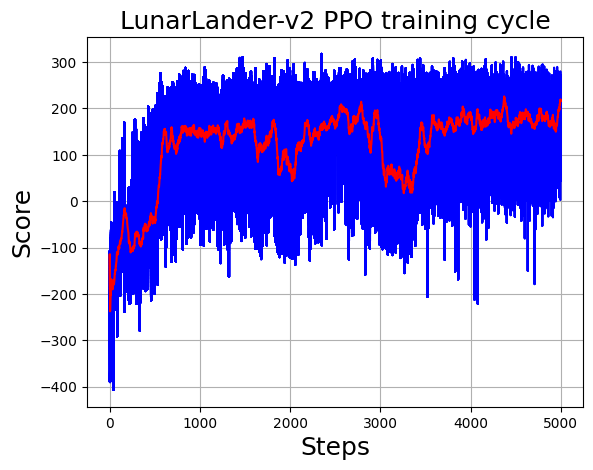

In [7]:
import random
import pylab
import numpy as np
import copy

import tensorflow as tf
from tensorboardX import SummaryWriter
tf.compat.v1.disable_eager_execution()
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras import backend as K

import gym

class actor_model:
    def __init__(self, input_shape, action_space, lr, optimizer):
        X_input = Input(input_shape)
        self.action_space = action_space

        X = Dense(512, activation="relu", kernel_initializer=tf.random_normal_initializer(stddev=0.01))(X_input)
        X = Dense(256, activation="relu", kernel_initializer=tf.random_normal_initializer(stddev=0.01))(X)
        X = Dense(64, activation="relu", kernel_initializer=tf.random_normal_initializer(stddev=0.01))(X)
        output = Dense(self.action_space, activation="softmax")(X)

        self.actor = Model(inputs = X_input, outputs = output)
        self.actor.compile(loss=self.ppo_loss, optimizer=optimizer(lr=lr))
    
    #Loss function
    def ppo_loss(self, y_true, y_pred):
        advantages, prediction_picks, actions = y_true[:, :1], y_true[:, 1:1+self.action_space], y_true[:, 1+self.action_space:]
        LOSS_CLIPPING = 0.2
        ENTROPY_LOSS = 0.001
        
        prob = actions * y_pred
        old_prob = actions * prediction_picks
        
        prob = K.clip(prob, 1e-10, 1.0)
        old_prob = K.clip(old_prob, 1e-10, 1.0)
        
        ratio = K.exp(K.log(prob) - K.log(old_prob))
        
        p1 = ratio * advantages
        p2 = K.clip(ratio, min_value = 1 - LOSS_CLIPPING, max_value = 1 + LOSS_CLIPPING) * advantages
        
        actor_loss = -K.mean(K.minimum(p1, p2))
        
        entropy = -(y_pred * K.log(y_pred + 1e-10))
        entropy = ENTROPY_LOSS * K.mean(entropy)
        
        total_loss = actor_loss - entropy
        
        return total_loss
    
    def predict(self, state):
        return self.actor.predict(state)


class critic_model:
    def __init__(self, input_shape, action_space, lr, optimizer):
        X_input = Input(input_shape)
        old_values = Input(shape=(1,))
        
        X = Dense(512, activation="relu", kernel_initializer="he_uniform")(X_input)
        X = Dense(256, activation="relu", kernel_initializer="he_uniform")(X)
        X = Dense(64, activation="relu", kernel_initializer="he_uniform")(X)
        value = Dense(1, activation=None)(X)
        
        self.critic = Model(inputs=[X_input, old_values], outputs = value)
        self.critic.compile(loss=[self.critic_PPO2_loss(old_values)], optimizer=optimizer(lr=lr))
    
    #Loss function
    def critic_PPO2_loss(self, values):
        def loss(y_true, y_pred):
            LOSS_CLIPPING = 0.2
            clipped_value_loss = values + K.clip(y_pred - values, -LOSS_CLIPPING, LOSS_CLIPPING)
            v_loss1 = (y_true - clipped_value_loss) ** 2
            v_loss2 = (y_true - y_pred) ** 2
            
            value_loss = 0.5 * K.mean(K.maximum(v_loss1, v_loss2))
            return value_loss
        return loss
    
    def predict(self, state):
        return self.critic.predict([state, np.zeros((state.shape[0], 1))])


class model:
    def __init__(self, env_name):
        # Initialization
        # Environment and PPO parameters
        self.env_name = env_name       
        self.env = gym.make(env_name)
        self.action_size = self.env.action_space.n
        self.state_size = self.env.observation_space.shape
        self.EPISODES = 5000 # total episodes to train through all environments
        self.episode = 0 # used to track the episodes total count of episodes played through all thread environments
        self.max_average = 0 # when average score is above 0 model will be saved
        self.lr = 0.00025
        self.epochs = 10 # training epochs
        self.shuffle=False
        self.training_batch = 1000
        self.optimizer = Adam

        self.replay_count = 0
        self.writer = SummaryWriter(comment="_"+self.env_name+"_"+self.optimizer.__name__+"_"+str(self.lr))
        
        # Instantiate plot memory
        self.scores_, self.episodes_, self.average_ = [], [], [] # used in matplotlib plots

        # Create Actor-Critic network models
        self.actor = actor_model(input_shape=self.state_size, action_space = self.action_size, lr=self.lr, optimizer = self.optimizer)
        self.critic = critic_model(input_shape=self.state_size, action_space = self.action_size, lr=self.lr, optimizer = self.optimizer)
        
        self.name = f"{self.env_name}_PPO"
        
    def act(self, state):
        #predict the next action to take, using the model
        prediction = self.actor.predict(state)[0]
        action = np.random.choice(self.action_size, p=prediction)
        action_onehot = np.zeros([self.action_size])
        action_onehot[action] = 1
        return action, action_onehot, prediction
    
    #Generalized Advantage Estimation
    def get_gaes(self, rewards, dones, values, next_values, gamma = 0.99, lamda = 0.9, normalize = True):
        deltas = [r + gamma * (1-d) * nv - v for r, d, nv, v in zip(rewards, dones, next_values, values)]
        deltas = np.stack(deltas)
        gaes = copy.deepcopy(deltas)
        for t in reversed(range(len(deltas)-1)):
            gaes[t] = gaes[t] + (1 - dones[t]) * gamma * lamda * gaes[t+1]

        target = gaes + values
        if normalize:
            gaes = (gaes - gaes.mean()) / (gaes.std() + 1e-8)
        return np.vstack(gaes), np.vstack(target)
    
    def replay(self, states, actions, rewards, predictions, dones, next_states):
        #Reshape memory to approproate shape for training
        states = np.vstack(states)
        next_states = np.vstack(next_states)
        actions = np.vstack(actions)
        predictions = np.vstack(predictions)

        #Get Critic network predictions
        values = self.critic.predict(states)
        next_values = self.critic.predict(next_states)

        #Compute discounted rewards and advantages
        advantages, target = self.get_gaes(rewards, dones, np.squeeze(values), np.squeeze(next_values))

        #Stack everything to numpy array
        #Pack all advantags, predictions, and action to y_true and when they are received in custom PPO loss function we unpack it
        y_true = np.hstack([advantages, predictions, actions])

        #Training actor and critic networks
        a_loss = self.actor.actor.fit(states, y_true, epochs=self.epochs, verbose=0, shuffle=self.shuffle)
        c_loss = self.critic.critic.fit([states, values], target, epochs=self.epochs, verbose=0, shuffle=self.shuffle)
    
    #Save weights to file
    def save(self, name):
        self.actor.actor.save_weights(name+"_Actor.h5")
        self.critic.critic.save_weights(name+"_Critic.h5")
    
    #Load weights from file
    def load(self, actor_weights_name, critic_weights_name):
        self.actor.actor.load_weights(actor_weights_name)
        self.critic.critic.load_weights(critic_weights_name)
    
    #Save the model when it performs the best
    def save_best(self, score, episode):
        self.scores_.append(score)
        self.episodes_.append(episode)
        self.average_.append(sum(self.scores_[-50:]) / len(self.scores_[-50:]))
        
        #Save and plot every 100 episodes
        if str(episode)[-2:] == "00":
            self.save(self.name+"_Episode"+str(episode))
            
            pylab.plot(self.episodes_, self.scores_, 'b')
            pylab.plot(self.episodes_, self.average_, 'r')
            pylab.title(self.env_name+" PPO training cycle", fontsize=18)
            pylab.ylabel('Score', fontsize=18)
            pylab.xlabel('Steps', fontsize=18)
            try:
                pylab.grid(True)
                pylab.savefig(self.env_name+".png")
            except OSError:
                pass
        
        #Save best models
        if self.average_[-1] >= self.max_average:
            self.max_average = self.average_[-1]
            
            self.save(self.name)
            SAVING = "SAVING"
            
            #Learning rate decay
            self.lr *= 0.95
            K.set_value(self.actor.actor.optimizer.learning_rate, self.lr)
            K.set_value(self.critic.critic.optimizer.learning_rate, self.lr)
        else:
            SAVING = ""
        
        return self.average_[-1], SAVING
    
    #Train the model
    def run_batch(self):
        score_array, avg_array, fuel_array = [], [], []
        successCount = 0
        state = self.env.reset()
        state = np.reshape(state, [1, self.state_size[0]])
        done, score, SAVING, = False, 0, ''

        while True:
            #Initialize or reset memory
            states, next_states, actions, rewards, predictions, dones = [], [], [], [], [], []
            timesteps = 0
            for t in range(self.training_batch):
                timesteps += 1
                #self.env.render()
                action, action_onehot, prediction = self.act(state)
                next_state, reward, done, _ = self.env.step(action)

                states.append(state)
                next_states.append(np.reshape(next_state, [1, self.state_size[0]]))
                actions.append(action_onehot)
                rewards.append(reward)
                dones.append(done)
                predictions.append(prediction)

                state = np.reshape(next_state, [1, self.state_size[0]])
                score += reward

                if done or timesteps > 1000:
                    timesteps = 0
                    self.episode += 1
                    average, SAVING = self.save_best(score, self.episode)
                    score_array.append(score)
                    avg_array.append(average)
                    if score >= 200:
                        successCount += 1
                    fuel_used = env.env.init_fuel - state[2]
                    fuel_array.append(fuel_used)
                    print("episode: {}/{}, score: {}, average: {:.2f} {}".format(self.episode, self.EPISODES, score, average, SAVING))

                    state, done, score, SAVING = self.env.reset(), False, 0, ''
                    state = np.reshape(state, [1, self.state_size[0]])

            self.replay(states, actions, rewards, predictions, dones, next_states)
            if self.episode == self.EPISODES:
                return score_array, avg_array fuel_array, successCount
    
    #Run the model
    def run(self, num):
        for i in range(num):
            state = self.env.reset()
            state=np.reshape(state, [1, self.state_size[0]])
            done = False
            score = 0
            
            for t in range(1000):
                self.env.render()
                action = np.argmax(self.actor.predict(state)[0])
                state, reward, done, _ = self.env.step(action)
                state = np.reshape(state, [1, self.state_size[0]])
                score += reward

                if done:
                    break
            
            print("Score:", score)
                    
        self.env.close()


#TRAIN THE MODEL
env = "LunarLander-v2"
agent = model(env)
score_array, avg_array, fuel_array, successCount = agent.run_batch()

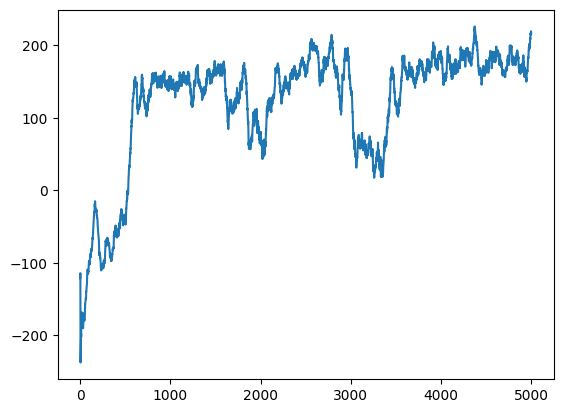

In [8]:
import matplotlib.pyplot as plt
plt.plot(avg_array)

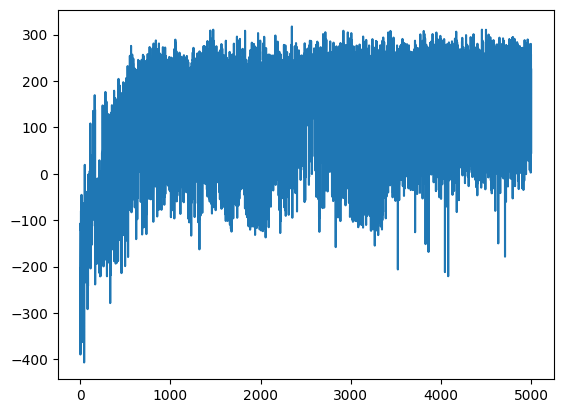

In [9]:
plt.plot(score_array)

## REINFORCE

In [ ]:
import gym
from gym import logger as gymlogger
from gym.wrappers import Monitor
gymlogger.set_level(40) #error only
import numpy as np
import random
import matplotlib.pyplot as plt
%matplotlib inline
import math
import glob
import logging
import io
import base64

from IPython import display as ipythondisplay
from IPython.display import HTML, clear_output

from matplotlib.animation import FuncAnimation
from pyvirtualdisplay import Display
from gym.envs.box2d.lunar_lander import heuristic
display = Display(visible=0, size=(1400, 900))
display.start()

import keras
import tensorflow as tf
# from tensorflow_probability.distributions import Beta
from keras.models import Sequential
from keras.layers import Dense, Lambda
from keras.optimizers import Adam
from keras import backend as K

# set the seed
sciper = {'student_1': 321957, # Riccardo Cadei
          'student_2': 321215  # Niccolò Polvani} 
seed = sciper['student_1']+sciper['student_2']

np.random.seed(seed)
tf.random.set_seed(seed*2)
          
gym.logger.setLevel(logging.ERROR)
discrete_env = gym.make('LunarLander-v2')
discrete_env._max_episode_steps = 500
discrete_env.seed(seed*3)
gym.logger.setLevel(logging.WARN)

%matplotlib inline
plt.rcParams['figure.figsize'] = 12, 8
plt.rcParams["animation.html"] = "jshtml"
          
def AddValue(output_size, value):
    return Lambda(lambda x: x + value, output_shape=(output_size,))

def render(episode, env):
    
    fig = plt.figure()
    img = plt.imshow(env.render(mode='rgb_array'))
    plt.axis('off')

    def animate(i):
        img.set_data(episode[i])
        return img,

    anim = FuncAnimation(fig, animate, frames=len(episode), interval=24, blit=True)
    html = HTML(anim.to_jshtml())
    
    plt.close(fig)
    !rm None0000000.png
    
    return html

class Results(dict):
    
    def __init__(self, *args, **kwargs):
        if 'filename' in kwargs:
            data = np.load(kwargs['filename'])
            super().__init__(data)
        else:
            super().__init__(*args, **kwargs)
        self.new_key = None
        self.plot_keys = None
        self.ylim = None
        
    def __setitem__(self, key, value):
        super().__setitem__(key, value)
        self.new_key = key

    def plot(self, window):
        clear_output(wait=True)
        for key in self:
            #Ensure latest results are plotted on top
            if self.plot_keys is not None and key not in self.plot_keys:
                continue
            elif key == self.new_key:
                continue
            self.plot_smooth(key, window)
        if self.new_key is not None:
            self.plot_smooth(self.new_key, window)
        plt.xlabel('Episode')
        plt.ylabel('Reward')
        plt.legend(loc='lower right')
        if self.ylim is not None:
            plt.ylim(self.ylim)
        plt.show()
        
    def plot_smooth(self, key, window):
        if len(self[key]) == 0:
            plt.plot([], [], label=key)
            return None
        y = np.convolve(self[key], np.ones((window,))/window, mode='valid')
        x = np.linspace(window/2, len(self[key]) - window/2, len(y))
        plt.plot(x, y, label=key)
        
    def save(self, filename='results'):
        np.savez(filename, **self)
          
def run_fixed_episode(env, policy):
    frames = []
    observation = env.reset()
    done = False
    while not done:
        frames.append(env.render(mode='rgb_array'))
        action = policy(env, observation)
        observation, reward, done, info = env.step(action)
    return frames
    
def random_policy(env, observation):
    return env.action_space.sample()

def heuristic_policy(env, observation):
    return heuristic(env.unwrapped, observation)
          
episode = run_fixed_episode(discrete_env, random_policy)
render(episode, discrete_env)
          

episode = run_fixed_episode(discrete_env, heuristic_policy)
render(episode, discrete_env)
          
num_episodes = 3000

def run_experiment(experiment_name, 
                   env, 
                   num_episodes, 
                   policy_learning_rate=0.001, 
                   value_learning_rate=0.001, 
                   baseline=None, 
                   num_layers=3):

    #Initiate the learning agent
    agent = RLAgent(n_obs=env.observation_space.shape[0], 
                    action_space=env.action_space,
                    policy_learning_rate=policy_learning_rate, 
                    value_learning_rate=value_learning_rate, 
                    discount=0.99, 
                    baseline=baseline, 
                    num_layers=num_layers)

    rewards = []
    all_episode_frames = []
    step = 0
    for episode in range(1, num_episodes+1):
    
        #Update results plot and occasionally store an episode movie
        episode_frames = None
        if episode % 10 == 0:
            results[experiment_name] = np.array(rewards)
            results.plot(10)
        if episode % 500 == 0:
            episode_frames = []
            
        #Reset the environment to a new episode
        observation = env.reset()
        episode_reward = 0

        while True:
        
            if episode_frames is not None:
                episode_frames.append(env.render(mode='rgb_array'))

            # 1. Decide on an action based on the observations
            action = agent.decide(observation)

            # 2. Take action in the environment
            next_observation, reward, done, info = env.step(action)
            episode_reward += reward

            # 3. Store the information returned from the environment for training
            agent.observe(observation, action, reward)

            # 4. When we reach a terminal state ("done"), use the observed episode to train the network
            if done:
                rewards.append(episode_reward)
                if episode_frames is not None:
                    all_episode_frames.append(episode_frames)
                agent.train()
                break

            # Reset for next step
            observation = next_observation
            step += 1
            
    return all_episode_frames, agent
          
class RLAgent(object):
    
    def __init__(self, n_obs, action_space, policy_learning_rate, value_learning_rate, 
                 discount, baseline = None, num_layers=3, ma_window_size=50):

        # input/output
        self.n_obs = n_obs  
        self.n_act = action_space.n
        
        # training parameters
        self.plr = policy_learning_rate
        self.vlr = value_learning_rate
        self.gamma = discount
        self.num_layers = num_layers
        self.ma_window_size = ma_window_size
    
        
        # lists to store the cumulative observations for an episode
        self.episode_observations, self.episode_actions, self.episode_rewards = [], [], []

        # set baseline
        self.use_simple_baseline = False
        self.use_adaptive_baseline = False

        if baseline == 'simple':
            self.use_simple_baseline = True
        elif baseline == 'adaptive':
            self.use_adaptive_baseline = True

        # build the keras network/s
        self._build_network()
        

    def observe(self, state, action, reward):
        """ This function takes the observations the agent received from the environment and stores them
            in the lists above."""

        self.episode_observations.append(state)
        self.episode_actions.append(action)
        self.episode_rewards.append(reward)
        
    def decide(self, state):
        """ This function feeds the observed state to the network, which returns a distribution
            over possible actions. Sample an action from the distribution and return it."""

        # get actions probabilities
        state = state.reshape([1, self.n_obs])
        action_probabilities = self.model(state).numpy().flatten()
        # sample an action
        action = np.random.choice(self.n_act, p=action_probabilities)

        return action

    def train(self):
        """ When this function is called, the accumulated episode observations, actions and discounted rewards
            should be fed into the network and used for training. Use the _get_returns function to first turn 
            the episode rewards into discounted returns. 
            Apply simple or adaptive baselines if needed, depending on parameters."""

        episode_length = len(self.episode_observations)

        # States
        states=np.array(self.episode_observations)

        # Actions (hot encoding)
        mask = np.eye(self.n_act)
        actions = mask[self.episode_actions]

        # Discounted Rewards
        discounted_rewards = np.array(self._get_returns())

        # update model_baseline parameters
        if self.use_adaptive_baseline:
            self.model_baseline.train_on_batch(x = states,
                                               y = discounted_rewards)

        # subtract Baseline
        if self.use_simple_baseline:
            if self.ma_window_size < episode_length:
              for i in range(episode_length):
                    l = max(0, i - self.ma_window_size)
                    u = min(episode_length, i + self.ma_window_size)
                    discounted_rewards[i] -= np.mean(discounted_rewards[l:u])
              else:
                 discounted_rewards = np.array(discounted_rewards) - np.mean(discounted_rewards) 
        elif self.use_adaptive_baseline:
            discounted_rewards -= self.model_baseline(states).numpy().flatten()
        
        # update model (policy) parameters
        self.model.train_on_batch(x = states, 
                                  y = actions,
                                  sample_weight = discounted_rewards)
        
        # reset cumulative lists
        self.episode_observations, self.episode_actions, self.episode_rewards = [], [], []


    def _get_returns(self):
        """ This function should process self.episode_rewards and return the discounted episode returns
            at each step in the episode. """ 
               
        discounted_rewards = []
        cumulative_total_return = 0
        for reward in self.episode_rewards[::-1]:      
           cumulative_total_return = (cumulative_total_return*self.gamma) + reward
           discounted_rewards.insert(0, cumulative_total_return) 
    
        return discounted_rewards


    def _build_network(self):
        """ This function should build the network that can then be called by decide and train. 
            The network takes observations as inputs and has a policy distribution as output."""

        model = Sequential()
        for i in range(self.num_layers):
            model.add(Dense(16, activation="relu"))
        model.add(Dense(self.n_act, activation="softmax")) 
        
        model.compile(loss = "categorical_crossentropy", optimizer = Adam(lr=self.plr))
        self.model = model

        if self.use_adaptive_baseline:
            model_baseline = Sequential()
            for i in range(self.num_layers):
                  model_baseline.add(Dense(16, activation="relu"))
            model_baseline.add(Dense(1)) 
        
            model_baseline.compile(loss = "mse", optimizer = Adam(lr=self.vlr))
            self.model_baseline = model_baseline
          
results = Results()
policy_learning_rate = 0.0025

# REINFORCE
episodes, model = run_experiment("REINFORCE", discrete_env, num_episodes, policy_learning_rate)

# REINFORCE + Simple Baseline
episodes, baseline_model = run_experiment("REINFORCE (with baseline)", discrete_env, num_episodes, policy_learning_rate, baseline='simple')

## SARSA

NOTES

models to be used:
- Deep Q Network (DQN)
- Double Deep Q Network
- Dueling Deep Q Network (allegedly trains faster than vanilla DQN)
- Deep Deterministic Policy Gradient (DDPG)
- SARSA
- other stuff idk 

## REFERENCES
##### ‎
#### Deep Q Network (DQN)
##### https://github.com/shivaverma/OpenAIGym/blob/master/lunar-lander/discrete/lunar_lander.py
### ‎

####  Deep Double Q Network
##### https://github.com/MohammadAsadolahi/DDQN_Deep-Double_Q-Learning-for-solving-OpenAi-Gym-LunarLander-v2-in-python/blob/main/Double_DQN_for_Gym_LunarLander.py
### ‎

#### Dueling Deep Q Network
##### https://github.com/MohammadAsadolahi/Dueling_Deep-Double_Q-Learning-for-solving-OpenAi-Gym-LunarLander-v2-in-python/blob/main/Dueling_DQN_for_Gym_LunarLander.ipynb
### ‎

#### Dueling Deep Q Network With Prioritized Experience Replay (DDQN-PER)
##### https://github.com/MorvanZhou/Reinforcement-learning-with-tensorflow/blob/master/experiments/Solve_LunarLander/DuelingDQNPrioritizedReplay.py
### ‎

#### Deep Deterministic Policy Gradient (DDPG)
##### https://towardsdatascience.com/deep-deterministic-and-twin-delayed-deep-deterministic-policy-gradient-with-tensorflow-2-x-43517b0e0185
##### https://github.com/abhisheksuran/Reinforcement_Learning/blob/master/DDPG.ipynb
### ‎

#### Proximal Policy Optimization Actor-Critic (PPO)
##### https://github.com/DennisChunikhin/Reinforcement-Learning-Lunar-Lander/blob/main/LunarLanderPPO.py
### ‎

#### REINFORCE
##### https://github.com/riccardocadei/LunarLander-v2-REINFORCE/blob/main/main.ipynb
### ‎

#### SARSA
##### https://github.com/mokeddembillel/Lunar-Lander-Deep-Expected-Sarsa/blob/main/EXPECTED_SARSA_LUNAR_LANDER.ipynb
### ‎

#### Additional References
##### https://github.com/topics/lunarlander-v2?o=desc&s=updated
##### https://xusophia.github.io/DataSciFinalProj/